In [1]:
"""
contents :blind source decorrelation on time independent signal(time-delayed decorrelation)
author   : liyunpeng  
e-mail   : liyp18@@mails.tsinghua.edu.cn

Speech can also be separated using second-order statistics (SOS) alone if the
source signals have unique temporal structures with distinct autocorrelation
functions.
Algorithms that employ
this criterion impose spatial decorrelation between the different outputs of
the separation system through simultaneous diagonalization of output corre-
lation matrices over multiple time-lags.
"""

'\ncontents :blind source decorrelation on time independent signal(time-delayed decorrelation)\nauthor   : liyunpeng  \ne-mail   : liyp18@@mails.tsinghua.edu.cn\n\nSpeech can also be separated using second-order statistics (SOS) alone if the\nsource signals have unique temporal structures with distinct autocorrelation\nfunctions.\nAlgorithms that employ\nthis criterion impose spatial decorrelation between the different outputs of\nthe separation system through simultaneous diagonalization of output corre-\nlation matrices over multiple time-lags.\n'

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import Latex
from scipy import stats 
from scipy import signal
from scipy import interpolate
from scipy.io import wavfile 
import seaborn as sns
import matplotlib as mpl
from matplotlib.font_manager import fontManager  
import os 
import lasio
from mpl_toolkits.mplot3d import Axes3D
import cv2
from scipy import io

In [2]:
"""
读取仿真数据
"""
data=io.loadmat('data.mat')['data']
label=io.loadmat('label.mat')['label']
slowness=io.loadmat('slowness.mat')['slowness']

sim=io.loadmat('sim_data.mat')['sim']
length=io.loadmat('sim_data_lens.mat')['length']
waves=io.loadmat('waves.mat')['wave']
dataS =io.loadmat('dataS.mat')['dataS']

In [3]:
#仿真有些地方找到了延时，是不是因为是设计用来仿真的波形比较特殊，许多地方为0？
#仿真波形，大部分为0,稀释了有用部分数据
#一些文章中的数据长度都是2w左右，虽然其tap数可能很小5，或9形式

n_samples =1000

s1 =sim[60,0,0:n_samples]
s2 =sim[30,2,0:n_samples]
s3 =sim[20,1,0:n_samples]

#s2 =np.zeros((n_samples,),dtype=float)
#s3 =np.zeros((n_samples,),dtype=float)
#s2[0:(n_samples//30)] =np.random.laplace(loc=0,scale=3.0,size=(n_samples//30,))
#s3[0:(n_samples//10)] =np.random.uniform(low=-4,high=4,size=(n_samples//10))

n_samples =8000
s1 =dataS[:,0]
s2 =dataS[:,1]
s3 =dataS[:,2]







time = np.linspace(0, 8, n_samples)

d1 =2
d2 =7
d3 =12

s1 =(s1-np.mean(s1))/np.std(s1)

s2 =(s2-np.mean(s2))/np.std(s2)
s3 =(s3-np.mean(s3))/np.std(s3)

x1 =np.zeros((100+n_samples,),dtype=float)
x2 =np.zeros((100+n_samples,),dtype=float)
x3 =np.zeros((100+n_samples,),dtype=float)

x11 =np.zeros((100+n_samples,),dtype=float)
x22 =np.zeros((100+n_samples,),dtype=float)
x33 =np.zeros((100+n_samples,),dtype=float)

ss1 =np.zeros((2*n_samples,),dtype=float)
ss2 =np.zeros((2*n_samples,),dtype=float)
ss3 =np.zeros((2*n_samples,),dtype=float)

x1[50:(n_samples+50)] =1.0*s1
x1[(30+d2):(30+d2+n_samples)] =0.6*s2 +x1[(30+d2):(30+d2+n_samples)]
x1[(70+d3):(70+d3+n_samples)] =0.7*s3 +x1[(70+d3):(70+d3+n_samples)]
x2[30:(n_samples+30)] =1.0*s2
x2[(50+d1):(50+d1+n_samples)]=0.6*s1 +x2[(50+d1):(50+d1+n_samples)]
x2[(70+2*d3):(70+2*d3+n_samples)] =0.7*s3 +x2[(70+2*d3):(70+2*d3+n_samples)]
x3[70:(n_samples+70)] =1.0*s3
x3[(50+2*d1):(50+2*d1+n_samples)]=0.6*s1 +x3[(50+2*d1):(50+2*d1+n_samples)]
x3[(30+2*d2):(30+2*d2+n_samples)] =0.7*s2 +x3[(30+2*d2):(30+2*d2+n_samples)]



x11[(50):(50+n_samples)]=s1
x22[(50+d1):(50+d1+n_samples)]=s2
x33[(50+2*d1):(50+2*d1+n_samples)]=s3 



X_sim =np.c_[x1,x2,x3].copy()
 
[N,p] =X_sim.shape

X=X_sim

"""
X_sim2 =np.c_[data[26,:,0],data[26,:,1],data[26,:,2]]
X_sim  =np.zeros((X_sim2.shape[0]//6,X_sim2.shape[1]),dtype=float)
for i in range(X_sim.shape[0]):
    X_sim[i,:]=X_sim2[i*6,:]
X_real =np.c_[waves[26,:,0],waves[26,:,1],waves[26,:,2]]  
#X =(X-np.mean(X,axis=0)[np.newaxis,:])/np.std(X,axis=0)[np.newaxis,:]
"""
X_real =np.zeros((750,3),dtype=float)
X_real[50:(50+660),:] =np.c_[waves[26,:,0],waves[26,:,1],waves[26,:,2]] 
#S =np.c_[s1,s2,s3]
#io.savemat('./dataS.mat', {'dataS':S})
S = np.c_[s1, s2, s3]
S += 0.2 * np.random.normal(size=S.shape)
S/= S.std(axis=0)

A= np.array([[1, 1, 1], [0.5, 2, 1.0], [1.5, 1.0, 2.0]])
X_ins= np.dot(S, A.T)

In [6]:
"""
读取真实信号
#数据量太大，内存溢出。
哪里找好点的测试数据？----->这么基础问题居然还能困扰我
这样的波形似乎不行啊？
"""
fs, x1 = wavfile.read('./audio source/Speech - Speech Separation in difficult environments/Microphone1.wav')
fs, x2 = wavfile.read('./audio source/Speech - Speech Separation in difficult environments/Microphone2.wav')
fs, s1 = wavfile.read('./audio source/Speech - Speech Separation in difficult environments/SeparatedSource1.wav')
fs, s2 = wavfile.read('./audio source/Speech - Speech Separation in difficult environments/SeparatedSource2.wav')
print('s1 shape , ',s1.shape,' s2 shape ',s2.shape)
X_real1 =np.c_[x1,x2].copy()
#s_real1 =np.c_[s1,s2].copy()
N=18000
#X_real =np.zeros((3000,3),dtype=float)
r =X_real1.shape[0]//N
X_real =np.zeros((N+800,2),dtype=float)
s_real =np.zeros((N+800,2),dtype=float)
for i in range(N):
    X_real[400+i,0] =X_real1[i*r,0]
    X_real[400+i,1] =X_real1[i*r,1]
    
    s_real[400+i,0] =s1[i*r]
    s_real[400+i,1] =s2[i*r]
    


s1 shape ,  (316384,)  s2 shape  (316384,)


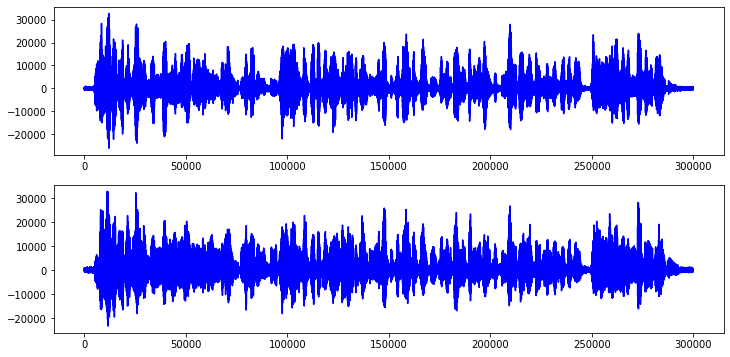

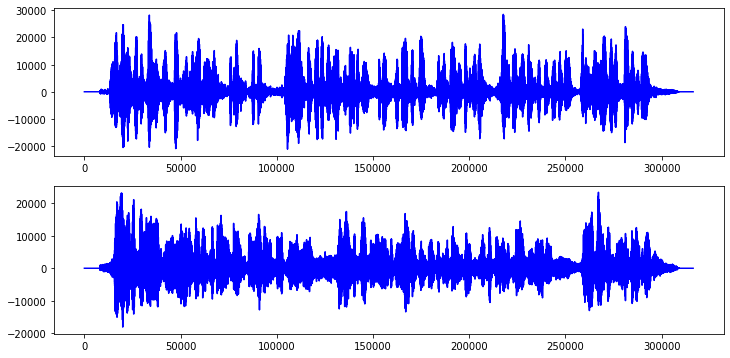

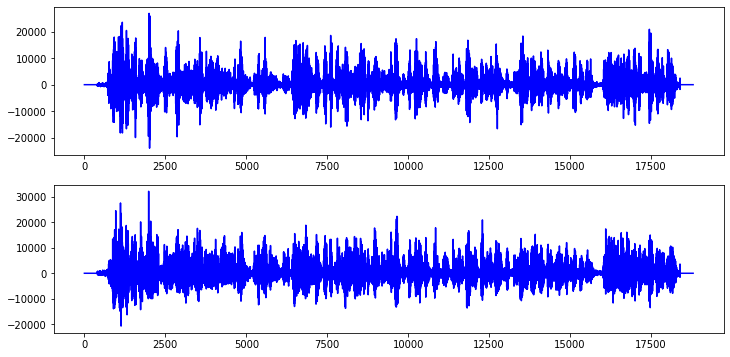

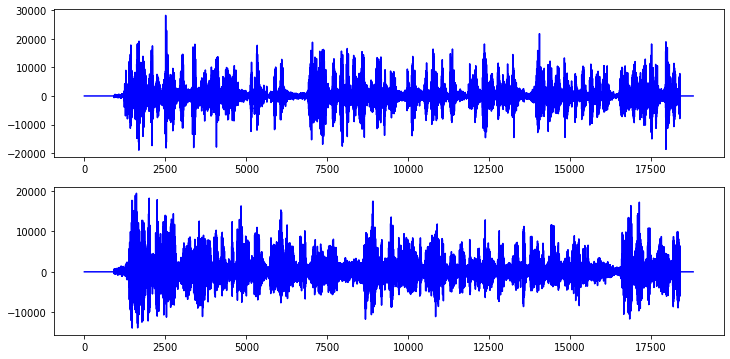

In [7]:
plt.subplots(figsize=(12,6))
plt.subplot(2,1,1)
plt.plot(np.linspace(0,x1.shape[0],x1.shape[0]),x1,'-b')
plt.subplot(2,1,2)
plt.plot(np.linspace(0,x2.shape[0],x2.shape[0]),x2,'-b')

plt.subplots(figsize=(12,6))
plt.subplot(2,1,1)
plt.plot(np.linspace(0,s1.shape[0],s1.shape[0]),s1,'-b')
plt.subplot(2,1,2)
plt.plot(np.linspace(0,s2.shape[0],s2.shape[0]),s2,'-b')

plt.subplots(figsize=(12,6))
plt.subplot(2,1,1)
plt.plot(np.linspace(0,X_real.shape[0],X_real.shape[0]),X_real[:,0],'-b')
plt.subplot(2,1,2)
plt.plot(np.linspace(0,X_real.shape[0],X_real.shape[0]),X_real[:,1],'-b')

plt.subplots(figsize=(12,6))
plt.subplot(2,1,1)
plt.plot(np.linspace(0,s_real.shape[0],s_real.shape[0]),s_real[:,0],'-b')
plt.subplot(2,1,2)
plt.plot(np.linspace(0,s_real.shape[0],s_real.shape[0]),s_real[:,1],'-b')

In [5]:
"""
辅助函数
"""
def sigmoid(x):
    return  np.exp(x)/(1.0+np.exp(x))
def tanh(x):
    a =np.exp(x)
    b =np.exp(-1.0*x)
    return ((a-b)/(a+b))
def cosh(x):
    a =np.exp(x)
    b =np.exp(-1.0*x)
    return (a+b)/2
def sign(x):
    if(x>0):
        return 1.0
    else:
        return -1.0

def removewave(X,ref,M=50,tol=1e-3):
    [N,p] =X.shape
    #print('N ',N,' p ',p )
    y =np.zeros((N+2*M,p),dtype=float)
    y[M:N+M,:] =X.copy()
    Xc =np.zeros((N+2*M,2*M+1),dtype=float)
    #print('Xc,shape ',Xc.shape)
    #print('ref.shape ',ref.shape)
    for i in range(2*M+1):
        Xc[i:N+i,i] =ref
    corrs =np.zeros((p,2*M+1),dtype=float)
    for i in range(p):
        corrs[i,:] =np.sum(np.multiply(Xc,y[:,i][:,np.newaxis]),axis=0)/np.sum(Xc*Xc,axis=0)
        max_val =np.max(abs(corrs[i,:]))
        #print('corrs max ',max_val)
        index   =np.argmax(abs(corrs[i,:]))
        while(max_val>tol):
            #print('max_val ',max_val)
            y[:,i] =y[:,i] -(corrs[i,index]*Xc[:,index])
            corrs[i,:] =np.sum(np.multiply(Xc,y[:,i][:,np.newaxis]),axis=0)/np.sum(Xc*Xc,axis=0)
            max_val =np.max(abs(corrs[i,:]))
            index   =np.argmax(abs(corrs[i,:]))
            break
    #plt.subplots(figsize=(12,6))
    #plt.plot(np.linspace(0,N,N),ref,'-b')
    #plt.subplots(figsize=(12,6))
    #for i in range(p):
    #    plt.subplot(p,2,i+1)
    #    plt.plot(np.linspace(0,N,N),X[:,i],'-b')
    #    plt.subplot(p,2,p+i+1)
    #    plt.plot(np.linspace(0,N,N),y[M:N+M,i],'-g')
    return y[M:N+M,:]


def whiten(X):  
    [N,p] =X.shape
    w,v =np.linalg.eig(X.T@X/N)
    B =np.diag(1.0/np.sqrt(w))@v.T
    X1 =(B@X.T).T
    #print(np.linalg.det(X1.T@X1/N))
    return X1

def g(x,choice,order,eps=1e-14):
    if(order==0):
        if(choice=="sup"):
            a2=1.000
            return (-1.0/a2)*np.exp(-1.0*a2*x*x/2)
        elif(choice=='sub'):
            t =x*x
            return (1.0/4)*t*t
        else:
            a1=1.5
            return (1.0/a1)*np.log(a1*x+eps)
    elif(order==1):
        if(choice=='sup'):
            a2 =1.000
            return x*np.exp(-1.0*a2*(x*x)/2)
        elif(choice=='sub'):
            return x*x*x
        else:
            a1=1.5
            return tanh(a1*x)
    elif(order==2):
        if(choice=='sup'):
            a2=1.005
            t =np.exp(-1.0*a2*(x*x)/2)
            return t-a2*x*x*t
        elif(choice=='sub'):
            return 3*x*x
        else:
            a1 =1.5
            return a1*(1-np.square(tanh(a1*x)))
    else:
        print('err')

In [6]:
#约束变成首1,不是之前的单位向量。单位向量编程实现效果也不好。到底是方法问题还是自己问题也不清楚。
#打概率是自己问题吧，困在这路。

def TimeDelayDecorrelation(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    #XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    for i in range(p):
        for j in range(p):
            W[j*M,i]=1.0
        
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*M+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*M+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-M,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =200
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    
    F  =np.zeros((p*M-2,p*M),dtype=float)     #使得权向量光滑曲率小
    Z  =np.zeros((p*M-1,p*M),dtype=float)
    for i in range(p*M-1):
        Z[i,i]=1.0;Z[i,i+1]=-1.0;
    for i in range(p*M-2):
        F[i,i]=1.0;F[i,i+1]=-2.0;F[i,i+2]=1.0;
    D  =np.zeros((N+2*R-1,N+2*R),dtype=float) #使输出信号光滑  lda=10,5,似乎得到结果不错 Q=50,R=50,不白化 
                                              #d1 =5  d2 =10  d3 =15
    for i in range(N-1+2*R):
        D[i,i]=-1.0;D[i,i+1]=1.0;
    D = D@XX

    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            G =np.zeros((p*M,p*M),dtype=float)+lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            for l in range(2*M+1):
                G =G +Rs[l,:,:]@Q@Rs[2*M-l,:,:]
            
            
            print('norm(G-G.T) ',np.linalg.norm(G-G.T))  #是对称矩阵
            mask[:]=True
            mask[i]=False
            Gaa =np.zeros(((p-1)*M,(p-1)*M),dtype=float)
            Gab =np.zeros(((p-1)*M,M),dtype=float)
            index_a =0
            index_b =0
            for m in range(p):
                for n in range(p):
                    if(m!=i and n!=i):
                        r =index_a//(p-1)
                        c =index_a%(p-1)
                        Gaa[r*M:(r+1)*M,c*M:(c+1)*M] =G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index_a =index_a +1
                    elif(m!=i and n==i):
                        r =index_b%(p-1)
                        Gab[r*M:(r+1)*M,:]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index_b =index_b +1
            y =np.zeros(((p-1)*M,1),dtype=float)
            
            y =-1.0*Gab@W[i*M:(i+1)*M,i][:,np.newaxis]
            
            #for j in range(p-1):
            #    y[j*M:(j+1)*M,0] =-1.0*(Gab[j*M:(j+1)*M,:]@W[i*M:(i+1)*M,i][:,np.newaxis])[:,0]
            
            ww =np.linalg.inv(Gaa)@y
            index_c =0
            print('shape(W) ',W.shape,' shape(ww) ',ww.shape)
            
            #q =3
            #indexs =np.argsort(abs(ww))
            #ww[indexs[q:(p-1)*M]]=0.0
            
            for j in range(p):
                if(j!=i):
                    r =index_c%(p-1)
                    W[j*M:(j+1)*M,i]=ww[r*M:(r+1)*M,0]
                    index_c =index_c +1
    
            
            for j in range(p*M):
                if(np.abs(W[j,i])>lda4):
                    W[j,i] =np.sign(W[j,i])*(np.abs(W[j,i]-lda4))
                else:
                    W[j,i]=0.0
            
            
          
            
        
            E[k,i] =(W[:,i][np.newaxis,:]@G@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        
        for j in range(p):
            E[k,j]=np.linalg.norm(W[:,j]-W_last[:,j])
        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='E')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@y
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    
    for m in range(20):
        W =Ws[maxiters-1-m,:,:]
        y =XX[R:N+R]@W
        plt.subplots(figsize=(12,6))
        for i in range(p):
            plt.subplot(p,1,i+1)
            plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
            plt.legend()
            
        
    
    return W

before rank(XX)  120
after  rank(XX)  120
k  0   3.0
norm(G-G.T)  6.897987569801084e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  8.565812123658714e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.5082527922933428e-12
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  1.4423715212780843
E  [ 2.35894217 12.54214948  3.22066121]
k  1   13.162172329500425
norm(G-G.T)  4.2991731600116335e-12
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  1.017740791445129e-12
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  1.0448035288686193e-12
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.43225543761554663
E  [1.88916867 8.44720353 1.33147462]
k  2   8.757684078023425
norm(G-G.T)  1.0950410148457783e-12
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  7.904246095861558e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.278288344489718e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.2560921978040299
E  [1.89520282 2.33505061 0.48460484]
k  3   3.0461610206565126
norm(G-G.T)  7.4

norm(G-G.T)  3.8211306865202886e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.9038122699822945e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.0768049852169e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.11733211082667767
E  [0.02006274 0.02391217 0.0251604 ]
k  29   0.04009178854443877
norm(G-G.T)  5.276744238377131e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.92145402831483e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.045072549042049e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.11565724346565537
E  [0.01935523 0.02272591 0.02495151]
k  30   0.03890590944660181
norm(G-G.T)  3.9446594511394956e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  4.199862350996934e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.690518337545938e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.1140417588289899
E  [0.01857334 0.02157094 0.02468447]
k  31   0.03767754758922901
norm(G-G.T)  4.545316730066481e-13
shape(W)  (120, 3)  shape(ww)  (8

norm(G-G.T)  3.101531090095963e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.484760159834625e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.08712468599082765
E  [0.00625637 0.0062706  0.01398976]
k  58   0.016558257702819292
norm(G-G.T)  3.811364219172191e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.0848852854227914e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.4737116764015387e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.08655177352393242
E  [0.00615278 0.00610495 0.01368167]
k  59   0.016196144524162428
norm(G-G.T)  3.514603097393243e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.7955858422488605e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.28901864407538e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.08599857612094208
E  [0.00605412 0.00595283 0.0133796 ]
k  60   0.01584620379197596
norm(G-G.T)  3.4525641123155774e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.068154270587324e-13
shape(W)  (120, 3)  shape(w

norm(G-G.T)  2.630750447803896e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.166014944266596e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.07654376600577675
E  [0.0041594  0.00410079 0.00730588]
k  86   0.009353766092023234
norm(G-G.T)  3.3685475978899495e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.345330311141977e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.086013905043429e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.07631203123709533
E  [0.00409809 0.00405651 0.00713111]
k  87   0.009170731548423808
norm(G-G.T)  3.1920247813227555e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.42313241181773e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.1820760642234848e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.07608688065142444
E  [0.00403735 0.00401261 0.00696005]
k  88   0.008991302315176175
norm(G-G.T)  3.1382550717005175e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.078121568851255e-13
shape(W)  (120, 3)  shape(

norm(G-G.T)  2.232596158012486e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.07212333976689539
E  [0.00274865 0.00312433 0.0038107 ]
k  112   0.005642507278731603
norm(G-G.T)  2.852081803702479e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.4563476989641135e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.3877519336428857e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.07200081112926653
E  [0.00270238 0.00309912 0.00371398]
k  113   0.005540853513778935
norm(G-G.T)  2.7004442353526837e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.365196282408867e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.810502749041165e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.07188061808123314
E  [0.00265677 0.00307532 0.00361973]
k  114   0.0054422848170060595
norm(G-G.T)  2.9740173505309773e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.8741345638356767e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  1.9594948299934774e-13
shape(W)  (120, 3) 

norm(G-G.T)  2.281565107884029e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  1.9738137839738466e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.3536157332631375e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.06924272354460287
E  [0.00170418 0.00303441 0.0020602 ]
k  141   0.004044291124455462
norm(G-G.T)  2.807064440162448e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.2521566701607106e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.4130611956583817e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.06915981119791806
E  [0.00168084 0.00305315 0.00204407]
k  142   0.004040441948793924
norm(G-G.T)  2.8467008371219643e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.38109875835444e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.836705793669271e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.0690775502668473
E  [0.0016585  0.0030729  0.00203125]
k  143   0.004039718700911786
norm(G-G.T)  3.3591685217807136e-13
shape(W)  (120, 3)  sh

norm(G-G.T)  3.68838491428131e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.06709650241206658
E  [0.00146002 0.00373225 0.00257458]
k  169   0.00476338589572556
norm(G-G.T)  2.6042880336676973e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.345573382964676e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.7576764322289127e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.06702468486114227
E  [0.0014667  0.00375509 0.00261334]
k  170   0.00480431219309431
norm(G-G.T)  2.4042322586579874e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.1786414731146178e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.304084534092815e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.06695313529513465
E  [0.00147425 0.00377717 0.00265222]
k  171   0.0048450628706061625
norm(G-G.T)  3.1156786656700825e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.3243819410468245e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.0292177633971523e-13
shape(W)  (120, 3)  s

norm(G-G.T)  3.1591873648280696e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.5638153536999593e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.7270918663986897e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.06520267811156816
E  [0.00180803 0.00397252 0.00340321]
k  197   0.005534599433578204
norm(G-G.T)  3.278689447235367e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.150961124989133e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.8055684216207173e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.06514064454502694
E  [0.0018194  0.00396425 0.00341341]
k  198   0.005538670760608821
norm(G-G.T)  2.6958299107160055e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  2.155668958967609e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
norm(G-G.T)  3.5685954335350563e-13
shape(W)  (120, 3)  shape(ww)  (80, 1)
H  0.0650791008523429
E  [0.00183019 0.00395497 0.00342186]
k  199   0.005540799114196644
norm(G-G.T)  2.6983842586576683e-13
shape(W)  (120, 3)  

/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:191: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly clos

w 0 0  max index :  0
w 0 1  max index :  10
w 0 2  max index :  5
w 1 0  max index :  5
w 1 1  max index :  0
w 1 2  max index :  29
w 2 0  max index :  10
w 2 1  max index :  5
w 2 2  max index :  0


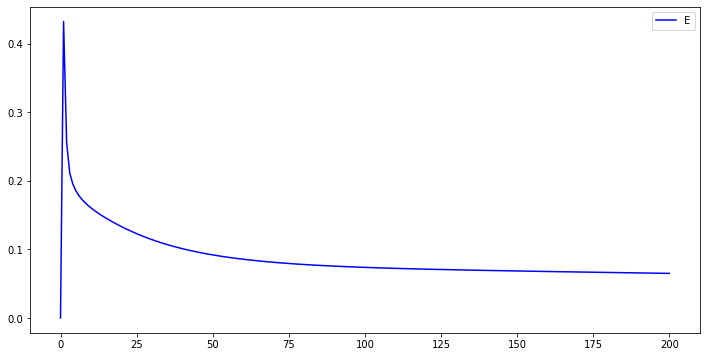

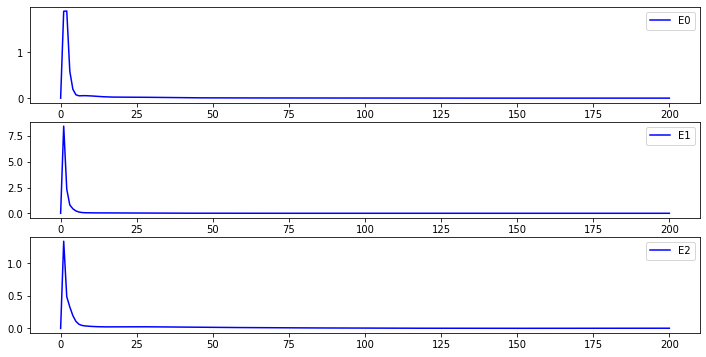

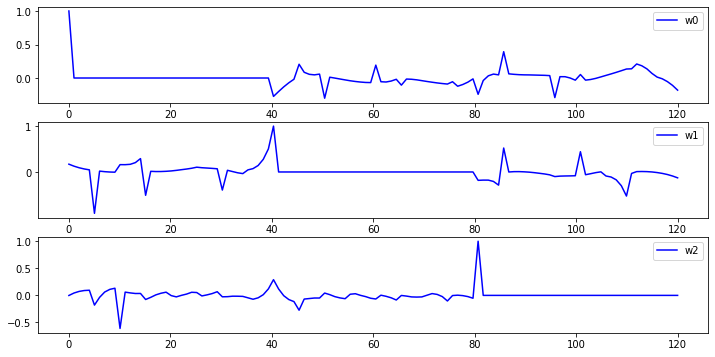

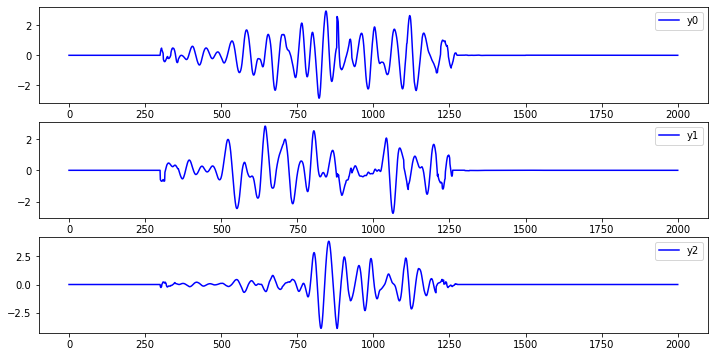

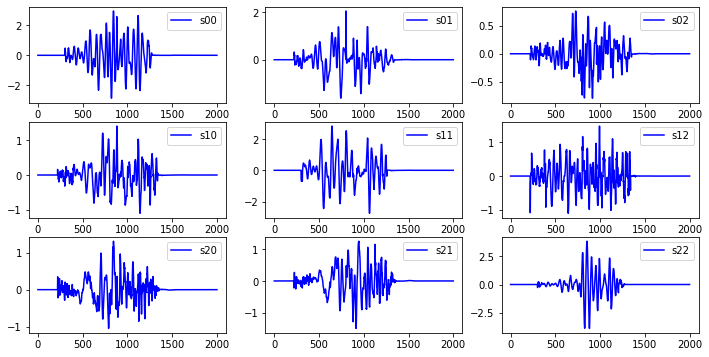

...

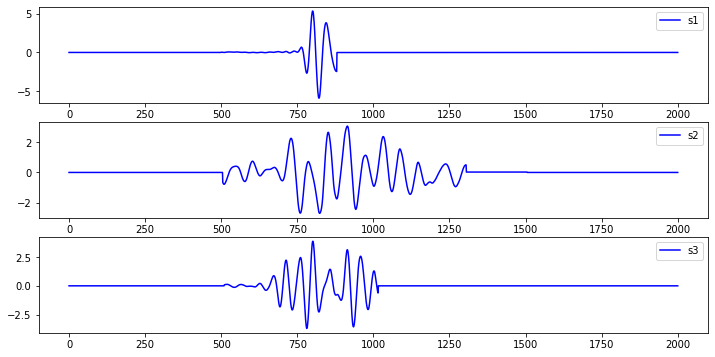

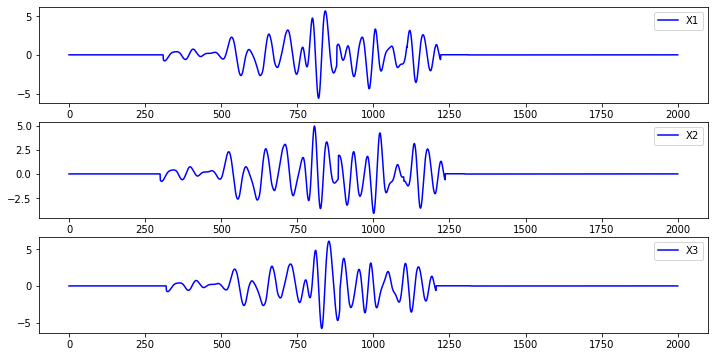

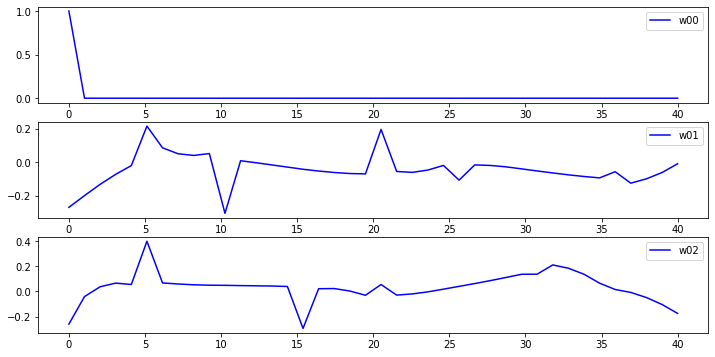

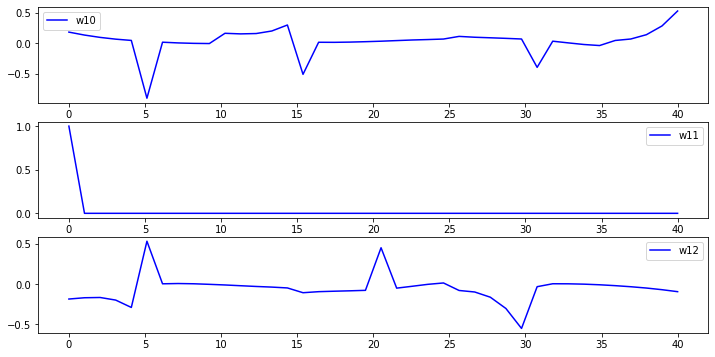

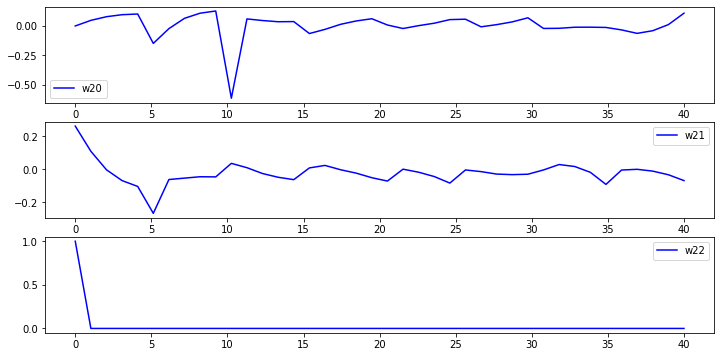

In [7]:
X =X_sim
R=40
M=40
lda1=0.001
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0

W=TimeDelayDecorrelation(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()

for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()
for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))

In [8]:
#这样得到的结果感觉和前面是一样的，这是怎么回事，难道是数据不行吗？
#这样做，取首1后似乎M取大取小，结果波形差别不大，而且是相当的稀疏？
#这儿获得的是滤波过的波形,直接和原始的波形比较是不是不合适？
#找延时似乎和理论上找的不错，是不是过一阵子有得不行了。但是波形很差劲。

def TimeDelayDecorrelation2(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    XX=whiten(XX)    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    for i in range(p):
        for j in range(p):
            W[j*M,i]=1.0
        
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*M+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*M+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-M,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =300
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    
    F  =np.zeros((p*M-2,p*M),dtype=float)     #使得权向量光滑曲率小
    Z  =np.zeros((p*M-1,p*M),dtype=float)
    for i in range(p*M-1):
        Z[i,i]=1.0;Z[i,i+1]=-1.0;
    for i in range(p*M-2):
        F[i,i]=1.0;F[i,i+1]=-2.0;F[i,i+2]=1.0;
    D  =np.zeros((N+2*R-1,N+2*R),dtype=float) #使输出信号光滑  lda=10,5,似乎得到结果不错 Q=50,R=50,不白化 
                                              #d1 =5  d2 =10  d3 =15
    for i in range(N-1+2*R):
        D[i,i]=-1.0;D[i,i+1]=1.0;
    D = D@XX

    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            G =np.zeros((p*M,p*M),dtype=float)+lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            for l in range(2*M+1):
                G =G +Rs[l,:,:]@Q@Rs[2*M-l,:,:]
            
            G =G+lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            print('norm(G-G.T) ',np.linalg.norm(G-G.T))  #是对称矩阵
            
            ww =np.zeros((p*M,1),dtype=float)
            ww[0,0]=1.0
            
            Gn =np.zeros((p*M,p*M),dtype=float)
            index12=0
            index21=0
            index22=0
            
            for m in range(p):
                for n in range(p):
                    if(m==i and n==i):
                        Gn[0:M,0:M] =G[m*M:(m+1)*M,n*M:(n+1)*M]
                    elif(m==i and n!=i):
                        c =index12%(p-1)
                        Gn[0:M,(c+1)*M:(c+2)*M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index12 =index12+1
                    elif(m!=i and n==i):
                        r =index21%(p-1)
                        Gn[(r+1)*M:(r+2)*M,0:M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index21 =index21+1
                    else:
                        r =index22//(p-1)
                        c =index22%(p-1)
                        Gn[(r+1)*M:(r+2)*M,(c+1)*M:(c+2)*M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index22 =index22+1
            
            G11=Gn[0,0]
            G12=Gn[0,1:p*M]
            G21=Gn[1:p*M,0]
            G22=Gn[1:p*M,1:p*M]
            ww[1:p*M,0] =(-1.0*np.linalg.inv(G22)@(G21[:,np.newaxis]))[:,0]
            index0 =0
            for j in range(p):
                if(j==i):
                    W[i*M:(i+1)*M,i]=ww[0:M,0]*1.0
                else:
                    W[j*M:(j+1)*M,i]=ww[(index0+1)*M:(index0+2)*M,0]*1.0
                    index0 =index0+1
                
                    
                        
            
            
          
            
        
            E[k,i] =(W[:,i][np.newaxis,:]@G@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        
        for j in range(p):
            E[k,j]=np.linalg.norm(W[:,j]-W_last[:,j])
        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='E')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@y
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    
    for m in range(20):
        W =Ws[maxiters-1-m,:,:]
        y =XX[R:N+R]@W
        plt.subplots(figsize=(12,6))
        for i in range(p):
            plt.subplot(p,1,i+1)
            plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
            plt.legend()
            
    
        
    
    return W

before rank(XX)  150
after  rank(XX)  150
k  0   3.0
norm(G-G.T)  1.5104598780882484e-13
norm(G-G.T)  1.5936686395530144e-13
norm(G-G.T)  1.564195255250725e-13
H  165.42801347577347
E  [1.45794015 1.99885068 1.57560645]
k  1   2.933177321664707
norm(G-G.T)  1.570021253130729e-13
norm(G-G.T)  1.511485607429542e-13
norm(G-G.T)  1.5800954606664854e-13
H  149.41089964901647
E  [0.1798348  0.19051438 0.10903802]
k  2   0.28377028119246406
norm(G-G.T)  1.57892725641094e-13
norm(G-G.T)  1.5178941547405223e-13
norm(G-G.T)  1.564757340122715e-13
H  149.41365337714126
E  [0.02976301 0.05603142 0.03729839]
k  3   0.07359705222131184
norm(G-G.T)  1.5848235644383448e-13
norm(G-G.T)  1.50100020389692e-13
norm(G-G.T)  1.577643577415155e-13
H  149.3981884755654
E  [0.01157407 0.03626385 0.02752816]
k  4   0.046976864231605686
norm(G-G.T)  1.572324063386803e-13
norm(G-G.T)  1.5330471649205273e-13
norm(G-G.T)  1.5576881100617926e-13
H  149.38723156987257
E  [0.00788696 0.02808927 0.02354325]
k  5   0.03

norm(G-G.T)  1.52031547342611e-13
norm(G-G.T)  1.5586089601358847e-13
H  149.35181652999566
E  [6.35024227e-05 3.31051744e-04 3.38804919e-04]
k  43   0.00047792948050067824
norm(G-G.T)  1.585782187734079e-13
norm(G-G.T)  1.5193405074405099e-13
norm(G-G.T)  1.571239245319196e-13
H  149.3518114756352
E  [5.70826491e-05 2.99325517e-04 3.06944372e-04]
k  44   0.0004325147880113804
norm(G-G.T)  1.5704559331571562e-13
norm(G-G.T)  1.5069548751088863e-13
norm(G-G.T)  1.5760788304129017e-13
H  149.3518070324475
E  [5.13362438e-05 2.70862183e-04 2.78337368e-04]
k  45   0.00039175684070485534
norm(G-G.T)  1.5578466911148312e-13
norm(G-G.T)  1.5325859695405004e-13
norm(G-G.T)  1.5559771328943828e-13
H  149.351803118947
E  [4.61926962e-05 2.45319420e-04 2.52637366e-04]
k  46   0.0003551633731614377
norm(G-G.T)  1.581028746011307e-13
norm(G-G.T)  1.5194759442171948e-13
norm(G-G.T)  1.5720026868282518e-13
H  149.35179966597795
E  [4.15888118e-05 2.22390610e-04 2.29535405e-04]
k  47   0.0003222944532

norm(G-G.T)  1.5053617435003614e-13
norm(G-G.T)  1.5792891149255866e-13
H  149.35177269658715
E  [1.99345467e-06 1.30987762e-05 1.36094541e-05]
k  83   1.899392109740716e-05
norm(G-G.T)  1.5733114759281173e-13
norm(G-G.T)  1.519449620591676e-13
norm(G-G.T)  1.5828182226820304e-13
H  149.35177265319578
E  [1.86603923e-06 1.22656597e-05 1.27259864e-05]
k  84   1.7772991862182802e-05
norm(G-G.T)  1.5585202054808915e-13
norm(G-G.T)  1.5143748008121984e-13
norm(G-G.T)  1.565263187467953e-13
H  149.35177261490787
E  [1.74744522e-06 1.14881078e-05 1.19027098e-05]
k  85   1.66344427860964e-05
norm(G-G.T)  1.5649931993632654e-13
norm(G-G.T)  1.5293338768999832e-13
norm(G-G.T)  1.5738487237879002e-13
H  149.3517725811558
E  [1.63695369e-06 1.07620084e-05 1.11351347e-05]
k  86   1.5572143900636916e-05
norm(G-G.T)  1.5745086308519822e-13
norm(G-G.T)  1.5259956959283137e-13
norm(G-G.T)  1.5994797630731774e-13
H  149.35177255143356
E  [1.53391855e-06 1.00836102e-05 1.04191556e-05]
k  87   1.45804974

norm(G-G.T)  1.5792152653198378e-13
H  149.35177236896536
E  [1.36303474e-08 8.71071285e-08 8.68962266e-08]
k  161   1.237917299362325e-07
norm(G-G.T)  1.5788767871642608e-13
norm(G-G.T)  1.5285946852094745e-13
norm(G-G.T)  1.5886419223570552e-13
H  149.35177236904696
E  [1.27815151e-08 8.16760229e-08 8.14730176e-08]
k  162   1.1606977401180836e-07
norm(G-G.T)  1.573801492751169e-13
norm(G-G.T)  1.5133852036716268e-13
norm(G-G.T)  1.5550686327063937e-13
H  149.35177236912384
E  [1.19854620e-08 7.65832938e-08 7.63882386e-08]
k  163   1.0882929377733654e-07
norm(G-G.T)  1.5671764557528773e-13
norm(G-G.T)  1.5092973579089036e-13
norm(G-G.T)  1.574447884180068e-13
H  149.35177236919623
E  [1.12389176e-08 7.18078866e-08 7.16207762e-08]
k  164   1.0204029313960549e-07
norm(G-G.T)  1.591120228678587e-13
norm(G-G.T)  1.5263127253362634e-13
norm(G-G.T)  1.579919974727749e-13
H  149.3517723692646
E  [1.05388077e-08 6.73300529e-08 6.71508275e-08]
k  165   9.567463676037625e-08
norm(G-G.T)  1.5683

norm(G-G.T)  1.5727706378868207e-13
norm(G-G.T)  1.4952559024318498e-13
norm(G-G.T)  1.5815920177494188e-13
H  149.35177237022998
E  [1.03778589e-09 6.62210859e-09 6.59801376e-09]
k  201   9.405482833811918e-09
norm(G-G.T)  1.585950470710971e-13
norm(G-G.T)  1.5324094759656479e-13
norm(G-G.T)  1.5765202200166569e-13
H  149.3517723702368
E  [9.73030797e-10 6.20882519e-09 6.18616977e-09]
k  202   8.818446322634168e-09
norm(G-G.T)  1.5779464879543071e-13
norm(G-G.T)  1.5201239974364015e-13
norm(G-G.T)  1.5590076707796285e-13
H  149.3517723702433
E  [9.12315875e-10 5.82133294e-09 5.80003158e-09]
k  203   8.268047158967013e-09
norm(G-G.T)  1.5642191679029705e-13
norm(G-G.T)  1.5192967194514508e-13
norm(G-G.T)  1.5576685077621104e-13
H  149.35177237024942
E  [8.55387694e-10 5.45802110e-09 5.43799660e-09]
k  204   7.75199906430313e-09
norm(G-G.T)  1.5697737306254757e-13
norm(G-G.T)  1.5209908439279802e-13
norm(G-G.T)  1.5671299956612411e-13
H  149.35177237025516
E  [8.02011902e-10 5.11737884e

norm(G-G.T)  1.5763105648882408e-13
norm(G-G.T)  1.5294806542540897e-13
norm(G-G.T)  1.5745381103106078e-13
H  149.35177237033253
E  [7.88181974e-11 5.02811555e-10 5.00881601e-10]
k  241   7.140827312365028e-10
norm(G-G.T)  1.5694552443947731e-13
norm(G-G.T)  1.5109487692022172e-13
norm(G-G.T)  1.59010837047622e-13
H  149.3517723703331
E  [7.38985951e-11 4.71426583e-10 4.69616393e-10]
k  242   6.69509956876773e-10
norm(G-G.T)  1.580277434870402e-13
norm(G-G.T)  1.5230254801179304e-13
norm(G-G.T)  1.5788883599873432e-13
H  149.35177237033363
E  [6.92857663e-11 4.42000879e-10 4.40301718e-10]
k  243   6.277188046831721e-10
norm(G-G.T)  1.5604513133851612e-13
norm(G-G.T)  1.5284228788654388e-13
norm(G-G.T)  1.5653643442347097e-13
H  149.35177237033403
E  [6.49614226e-11 4.14409481e-10 4.12817876e-10]
k  244   5.885353035396607e-10
norm(G-G.T)  1.552215954284591e-13
norm(G-G.T)  1.5044943237256498e-13
norm(G-G.T)  1.5710086984258036e-13
H  149.35177237033443
E  [6.09060165e-11 3.88543254e-1

norm(G-G.T)  1.5663483484091407e-13
norm(G-G.T)  1.5220803101080764e-13
norm(G-G.T)  1.5672662985867045e-13
H  149.35177237034046
E  [6.38261977e-12 4.07114399e-11 4.05534867e-11]
k  280   5.781647224132523e-11
norm(G-G.T)  1.56548943542235e-13
norm(G-G.T)  1.5115158162226035e-13
norm(G-G.T)  1.5765036528730957e-13
H  149.3517723703404
E  [5.98271144e-12 3.81703712e-11 3.80231211e-11]
k  281   5.420818955944313e-11
norm(G-G.T)  1.5489412874623583e-13
norm(G-G.T)  1.5186780351966336e-13
norm(G-G.T)  1.581170991144021e-13
H  149.35177237034048
E  [5.61014567e-12 3.57882179e-11 3.56480716e-11]
k  282   5.0823766926615084e-11
norm(G-G.T)  1.5724970051435222e-13
norm(G-G.T)  1.5164691033270945e-13
norm(G-G.T)  1.5699313036829204e-13
H  149.35177237034068
E  [5.26014478e-12 3.35536162e-11 3.34249362e-11]
k  283   4.765228892599136e-11
norm(G-G.T)  1.5772548991280077e-13
norm(G-G.T)  1.5164840399192646e-13
norm(G-G.T)  1.5663038888636496e-13
H  149.35177237034065
E  [4.93179384e-12 3.14601294

/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:192: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


W  [[ 1.00000000e+00  3.34365643e-02  1.70406583e-03]
 [ 6.72089831e-02 -1.32386959e-02 -1.37356411e-03]
 [ 1.72300939e-01 -5.31818864e-03  1.05199091e-03]
 [ 1.12691092e-02 -2.48710968e-02  5.25338246e-05]
 [-8.40383089e-02  3.10112349e-03 -9.35828669e-04]
 [-6.94222588e-03 -7.08665931e-03 -1.15535668e-03]
 [ 1.69374110e-02  1.36156990e-03  2.43057895e-03]
 [-4.58651453e-02 -6.53574866e-03 -1.09870542e-03]
 [-3.27847999e-03 -1.71795304e-02 -5.02208866e-03]
 [-3.37689526e-02  4.31242200e-02  7.23923889e-03]
 [ 5.79670157e-03  3.09704581e-02  9.13416500e-05]
 [-4.18150829e-03  1.77377646e-02  5.39603310e-03]
 [-4.54320378e-02  1.82123005e-02  4.40174942e-03]
 [ 2.14290691e-02 -1.95492001e-02  2.92486590e-03]
 [-9.06228691e-03 -7.60981467e-02 -1.99503954e-03]
 [ 2.49214845e-02 -1.83232056e-02  4.74683126e-03]
 [-1.72770610e-02 -6.96261976e-02 -2.16969999e-03]
 [-8.86028255e-03 -1.11334998e-01 -1.02932215e-03]
 [ 1.72373084e-02  6.67748266e-02  2.47113890e-03]
 [-4.42475812e-03  1.2679108

/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory.

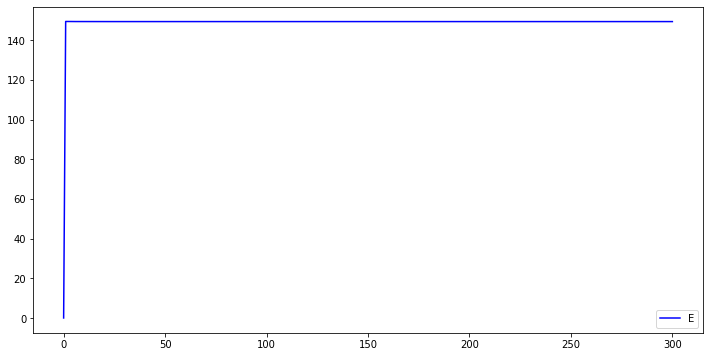

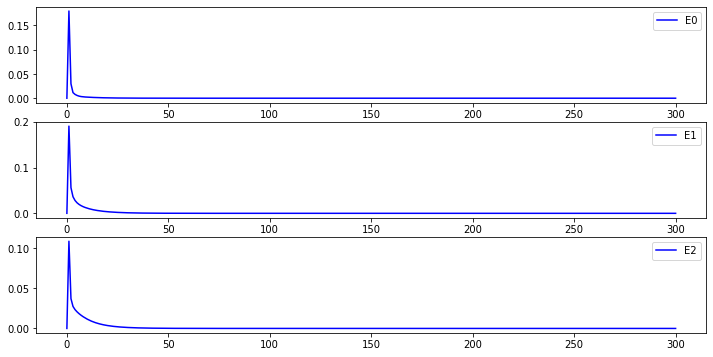

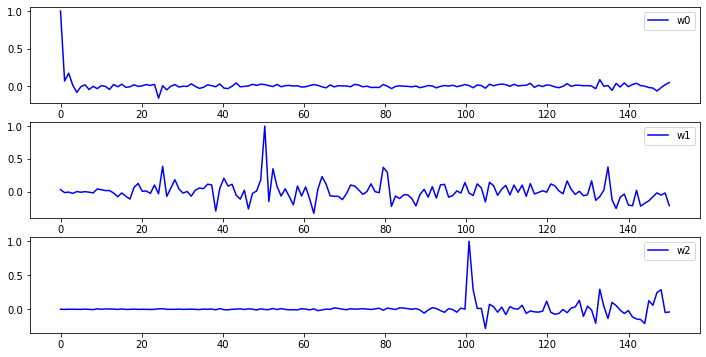

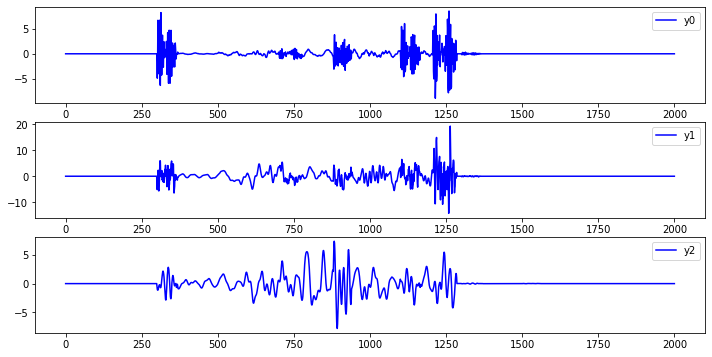

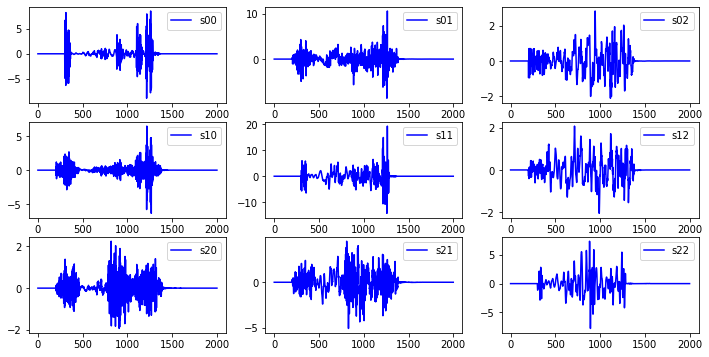

...

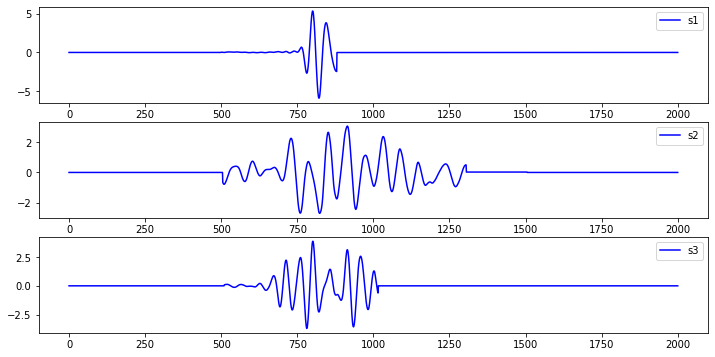

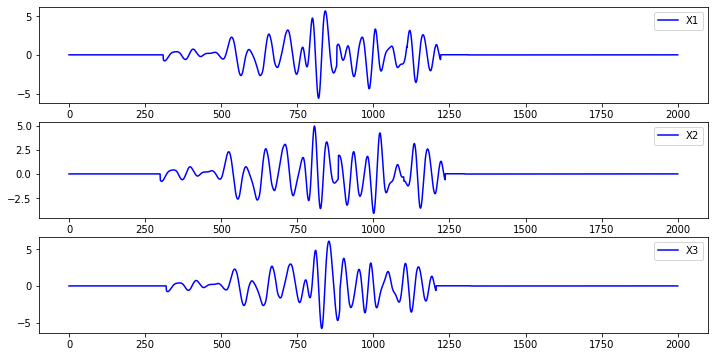

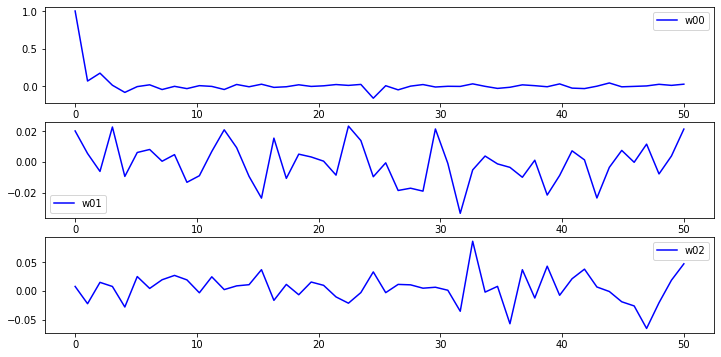

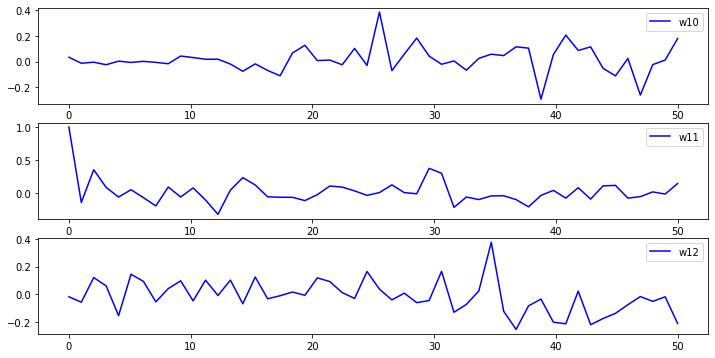

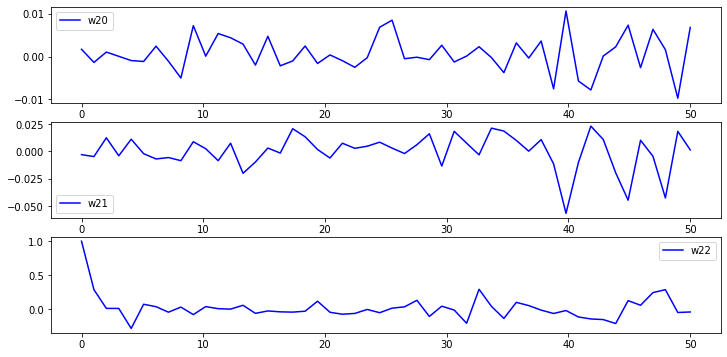

In [9]:
X =X_sim
R=50
M=50
lda1=0.01
lda2=0.02
lda3=0.0
lda4=0.000
K=1.0
W=TimeDelayDecorrelation2(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()
        

In [170]:
#由于前面的项太小，稀疏似乎没有必要，加在其前面的alpha几乎为0,并且梯度方法收敛差。
#也只是对部分数据有效，对于一般数据基本无效，这里到底怎么回事？
#在不表现为稀疏的时候计算很多就是不对的，稀疏部分是对的。不是稀疏部分是错的。-->给定信号是比较稀疏的那么结果比较好，但是在不是
#这样情况时候，一般计算都是出错的。
#不是稀疏的信号，可能不再是理想的答案比如(0,10,20)，一般是加上点偏移(0,14,24)，但是间隔是对的。
#两者之间的延时要相差的足够大。---->国真和波形有很大关系。
#为什么按照文章中方法弄，却没有别人文章中所说的效果？
#波形稍微换下位置整个都不行了，这里问题大了去。自己夸下海口，问题大了。基本上在糊弄。
#现在又开始出现可以和不可以，这样到底是没有解决问题，现象都不稳定，自己好多尝试都是特例，可笑.

def TimeDelayDecorrelation3(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0,alpha=1.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    #XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    for i in range(p):
        for j in range(p):
            W[j*M,i]=1.0
        
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*R+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*R+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-R,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =500
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    
    F  =np.zeros((p*M-2,p*M),dtype=float)     #使得权向量光滑曲率小
    Z  =np.zeros((p*M-1,p*M),dtype=float)
    for i in range(p*M-1):
        Z[i,i]=1.0;Z[i,i+1]=-1.0;
    for i in range(p*M-2):
        F[i,i]=1.0;F[i,i+1]=-2.0;F[i,i+2]=1.0;
    D  =np.zeros((N+2*R-1,N+2*R),dtype=float) #使输出信号光滑  lda=10,5,似乎得到结果不错 Q=50,R=50,不白化 
                                              #d1 =5  d2 =10  d3 =15
    for i in range(N-1+2*R):
        D[i,i]=-1.0;D[i,i+1]=1.0;
    D = D@XX

    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            G =np.zeros((p*M,p*M),dtype=float)+lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            for l in range(2*R+1):
                G =G +Rs[l,:,:]@Q@Rs[2*R-l,:,:]
            
            G =G+lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            print('norm(G-G.T) ',np.linalg.norm(G-G.T))  #是对称矩阵
            
            ww =np.zeros((p*M,1),dtype=float)
            ww[0,0]=1.0
            
            Gn =np.zeros((p*M,p*M),dtype=float)
            index12=0
            index21=0
            index22=0
            
            for m in range(p):
                for n in range(p):
                    if(m==i and n==i):
                        Gn[0:M,0:M] =G[m*M:(m+1)*M,n*M:(n+1)*M]
                    elif(m==i and n!=i):
                        c =index12%(p-1)
                        Gn[0:M,(c+1)*M:(c+2)*M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index12 =index12+1
                    elif(m!=i and n==i):
                        r =index21%(p-1)
                        Gn[(r+1)*M:(r+2)*M,0:M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index21 =index21+1
                    else:
                        r =index22//(p-1)
                        c =index22%(p-1)
                        Gn[(r+1)*M:(r+2)*M,(c+1)*M:(c+2)*M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index22 =index22+1
            
            G11=Gn[0,0]
            G12=Gn[0,1:p*M]
            G21=Gn[1:p*M,0]
            G22=Gn[1:p*M,1:p*M]
            
            
            """
            ww_last =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            ww_last[0,0]=1.0
            tol =1e-5
            eps =1e-16
            eta =0.0005  #学习率设置问题，太大太小，影响收敛
            b=0
            b0 =40
            mu =0.5*np.eye(p*M-1)
            while(np.linalg.norm(ww-ww_last)>tol):
                b =b +1
                print('norm(w-w_last) ',np.linalg.norm(ww-ww_last))
                ww_last[1:p*M,0]=ww[1:p*M,0].copy()
                dww =2*G21+(2*G22@(ww_last[1:p*M]))[:,0]+2*alpha*(np.linalg.norm(ww_last[1:p*M,0],ord=1)-1.0)*\
                (ww_last[1:p*M,0]/(eps+abs(ww_last[1:p*M,0])))
                ww[1:p*M,0] =ww_last[1:p*M,0]-eta*(1.0/(1+b/b0))*dww
                dww
            print('ww ',ww)
            """
            
                
                
            
            ww[1:p*M,0] =(-1.0*np.linalg.inv(G22)@(G21[:,np.newaxis]))[:,0]
            index0 =0
            for j in range(p):
                if(j==i):
                    W[i*M:(i+1)*M,i]=ww[0:M,0]*1.0
                else:
                    W[j*M:(j+1)*M,i]=ww[(index0+1)*M:(index0+2)*M,0]*1.0
                    index0 =index0+1
                
                    
                        
            
            
          
            
        
            E[k,i] =(W[:,i][np.newaxis,:]@G@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        
        for j in range(p):
            E[k,j]=np.linalg.norm(W[:,j]-W_last[:,j])
        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='E')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@y
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    
    for m in range(20):
        W =Ws[maxiters-1-m,:,:]
        y =XX[R:N+R]@W
        plt.subplots(figsize=(12,6))
        for i in range(p):
            plt.subplot(p,1,i+1)
            plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
            plt.legend()
            
    
        
    
    return W

before rank(XX)  84
after  rank(XX)  84
k  0   3.0
norm(G-G.T)  2.2192079246498736e-14
norm(G-G.T)  3.621792044989793e-14
norm(G-G.T)  1.3804147576737926e-14
H  0.7687016234275217
E  [2.33823966 2.09067566 1.31637786]
k  1   3.4016378545892465
norm(G-G.T)  1.1613317847282487e-14
norm(G-G.T)  1.1889571599078663e-14
norm(G-G.T)  1.1877609441507872e-14
H  0.18010760507299356
E  [0.72859947 0.50280529 0.37362507]
k  2   0.9608673364212347
norm(G-G.T)  6.648564652410565e-15
norm(G-G.T)  9.440030563605922e-15
norm(G-G.T)  1.245221131718166e-14
H  0.12435460482455629
E  [0.18370352 0.21466922 0.2069767 ]
k  3   0.3502416481157635
norm(G-G.T)  8.387866669052215e-15
norm(G-G.T)  8.664272794182337e-15
norm(G-G.T)  1.2599879866441848e-14
H  0.11397081222790166
E  [0.11800311 0.09614849 0.12014441]
k  4   0.1939173709868288
norm(G-G.T)  6.8536893554664815e-15
norm(G-G.T)  8.684400258780694e-15
norm(G-G.T)  9.578430822005387e-15
H  0.10948807379842486
E  [0.08530642 0.06832452 0.0754628 ]
k  5   0.

norm(G-G.T)  8.133946787661588e-15
norm(G-G.T)  1.0183884222191762e-14
H  0.10210741882423256
E  [0.0001769  0.00020845 0.00022306]
k  43   0.0003528484641612948
norm(G-G.T)  7.195597118041363e-15
norm(G-G.T)  8.662900960933851e-15
norm(G-G.T)  1.0124650658860908e-14
H  0.10210734881784689
E  [0.00015543 0.00018248 0.00019522]
k  44   0.00030913844846822597
norm(G-G.T)  7.062113472409643e-15
norm(G-G.T)  8.076711287800622e-15
norm(G-G.T)  9.608348741117878e-15
H  0.1021072902579505
E  [0.00013652 0.00015973 0.00017084]
k  45   0.0002708152633406234
norm(G-G.T)  6.742947717031428e-15
norm(G-G.T)  9.305099782094134e-15
norm(G-G.T)  9.737164737819797e-15
H  0.1021072410815039
E  [0.00011988 0.00013982 0.00014951]
k  46   0.0002372199691003958
norm(G-G.T)  6.860445806664892e-15
norm(G-G.T)  9.023342545903769e-15
norm(G-G.T)  1.0062046894740294e-14
H  0.10210719963204459
E  [0.00010523 0.00012238 0.00013084]
k  47   0.0002077733426124907
norm(G-G.T)  7.25414717972322e-15
norm(G-G.T)  1.0264

norm(G-G.T)  1.0508916334532112e-14
norm(G-G.T)  9.887285546548893e-15
H  0.10210695281379062
E  [8.86183856e-07 9.96252074e-07 1.06171294e-06]
k  83   1.7044278741557419e-06
norm(G-G.T)  6.914764944710419e-15
norm(G-G.T)  8.813311623766881e-15
norm(G-G.T)  1.134141320361354e-14
H  0.10210695259889108
E  [7.75294031e-07 8.71414344e-07 9.28651073e-07]
k  84   1.4909180425784435e-06
norm(G-G.T)  7.340991944722154e-15
norm(G-G.T)  9.686629030525178e-15
norm(G-G.T)  8.624318896301071e-15
H  0.10210695241100579
E  [6.78267475e-07 7.62215339e-07 8.12262006e-07]
k  85   1.3041428440703854e-06
norm(G-G.T)  7.53561160453778e-15
norm(G-G.T)  9.909737247832684e-15
norm(G-G.T)  9.456669985354187e-15
H  0.10210695224673177
E  [5.93373361e-07 6.66696747e-07 7.10457274e-07]
k  86   1.140756781864071e-06
norm(G-G.T)  7.772916417860765e-15
norm(G-G.T)  1.2071237634296639e-14
norm(G-G.T)  9.333469112069035e-15
H  0.10210695210309742
E  [5.19096391e-07 5.83145317e-07 6.21409857e-07]
k  87   9.97832517599

norm(G-G.T)  7.662488066923741e-15
norm(G-G.T)  8.559102925570228e-15
norm(G-G.T)  1.1457120546844967e-14
H  0.10210695110941623
E  [3.66292649e-09 4.10568213e-09 4.37393010e-09]
k  124   7.028863402544176e-09
norm(G-G.T)  7.059878357072341e-15
norm(G-G.T)  8.508019435164778e-15
norm(G-G.T)  1.0626566884975419e-14
H  0.1021069511085338
E  [3.20368771e-09 3.59089655e-09 3.82550949e-09]
k  125   6.147574797145023e-09
norm(G-G.T)  6.733339319461613e-15
norm(G-G.T)  8.890399321150959e-15
norm(G-G.T)  1.0101387796067663e-14
H  0.10210695110776388
E  [2.80204391e-09 3.14065254e-09 3.34584989e-09]
k  126   5.376789002220892e-09
norm(G-G.T)  8.116689162002317e-15
norm(G-G.T)  1.0270307671825077e-14
norm(G-G.T)  1.3297547184966415e-14
H  0.10210695110708827
E  [2.45075683e-09 2.74686088e-09 2.92633344e-09]
k  127   4.702646180551653e-09
norm(G-G.T)  7.203503418027028e-15
norm(G-G.T)  8.059864390016146e-15
norm(G-G.T)  1.0952269644781228e-14
H  0.10210695110649956
E  [2.14348538e-09 2.40246122e-

norm(G-G.T)  1.2934119234387912e-14
norm(G-G.T)  1.0031771289515574e-14
H  0.10210695110242038
E  [1.72415786e-11 1.93211734e-11 2.05849948e-11]
k  164   3.3080534893092466e-11
norm(G-G.T)  8.37252605476447e-15
norm(G-G.T)  9.582114269160728e-15
norm(G-G.T)  1.0727275982031645e-14
H  0.10210695110241426
E  [1.50971156e-11 1.68979153e-11 1.80058984e-11]
k  165   2.8942612529647053e-11
norm(G-G.T)  6.3893652674557484e-15
norm(G-G.T)  8.196319711557188e-15
norm(G-G.T)  1.071555136418772e-14
H  0.10210695110241297
E  [1.31900225e-11 1.47854976e-11 1.57393017e-11]
k  166   2.5304411660672906e-11
norm(G-G.T)  6.7003757386045455e-15
norm(G-G.T)  8.401405530124667e-15
norm(G-G.T)  9.749829600863227e-15
H  0.10210695110240874
E  [1.15316932e-11 1.29225638e-11 1.37774026e-11]
k  167   2.2131186762266992e-11
norm(G-G.T)  8.677486381096591e-15
norm(G-G.T)  1.0360845838816444e-14
norm(G-G.T)  8.348159825440821e-15
H  0.10210695110240575
E  [1.01093845e-11 1.13089248e-11 1.20388369e-11]
k  168   1.9

norm(G-G.T)  6.980945434627254e-15
norm(G-G.T)  9.184455041045682e-15
norm(G-G.T)  9.891899855233014e-15
H  0.1021069511023873
E  [6.90805156e-14 8.89915180e-14 9.30118137e-14]
k  205   1.4609177047767578e-13
norm(G-G.T)  7.34227236782824e-15
norm(G-G.T)  9.638949460159361e-15
norm(G-G.T)  1.0567064939560077e-14
H  0.10210695110238888
E  [6.70543624e-14 7.21760032e-14 8.38900012e-14]
k  206   1.2939549937354956e-13
norm(G-G.T)  8.322427717093139e-15
norm(G-G.T)  1.0756931208413422e-14
norm(G-G.T)  9.410907790627263e-15
H  0.1021069511023872
E  [6.82577225e-14 6.49875095e-14 7.15015192e-14]
k  207   1.1830029725703108e-13
norm(G-G.T)  8.508952816833735e-15
norm(G-G.T)  7.86804427068407e-15
norm(G-G.T)  9.685823390100283e-15
H  0.10210695110238818
E  [4.50397819e-14 5.44196398e-14 5.71038182e-14]
k  208   9.083460349310253e-14
norm(G-G.T)  7.159857594345395e-15
norm(G-G.T)  9.015072185516416e-15
norm(G-G.T)  1.1321613232998545e-14
H  0.1021069511023884
E  [4.24229846e-14 5.02909519e-14 4

norm(G-G.T)  9.055802050609938e-15
H  0.10210695110238865
E  [2.71358157e-14 1.86795891e-14 2.61129983e-14]
k  244   4.203770002684344e-14
norm(G-G.T)  8.157721978074633e-15
norm(G-G.T)  9.667880940230233e-15
norm(G-G.T)  1.0131448677871199e-14
H  0.10210695110238914
E  [1.12421399e-14 1.19583381e-14 2.93682817e-14]
k  245   3.36434768265153e-14
norm(G-G.T)  6.310247421427404e-15
norm(G-G.T)  1.0731048644807419e-14
norm(G-G.T)  9.707289097690456e-15
H  0.1021069511023894
E  [2.14441352e-14 1.74317210e-14 2.34637079e-14]
k  246   3.625274364890685e-14
norm(G-G.T)  6.755792790089177e-15
norm(G-G.T)  8.079542882116346e-15
norm(G-G.T)  9.143547789734816e-15
H  0.10210695110238849
E  [1.63223571e-14 2.44997558e-14 2.43487805e-14]
k  247   3.8203671121949413e-14
norm(G-G.T)  8.984372282224895e-15
norm(G-G.T)  8.630667414264434e-15
norm(G-G.T)  9.130767391446098e-15
H  0.10210695110238828
E  [1.44481547e-14 2.60880064e-14 2.55381644e-14]
k  248   3.9262336852448323e-14
norm(G-G.T)  7.34879936

norm(G-G.T)  1.1074695960865821e-14
H  0.10210695110238888
E  [4.98270381e-14 2.93455266e-14 3.39001397e-14]
k  284   6.703068790115586e-14
norm(G-G.T)  7.550782294747226e-15
norm(G-G.T)  9.349874599367149e-15
norm(G-G.T)  8.306465697003272e-15
H  0.10210695110238818
E  [2.85065417e-14 1.33927915e-14 2.32797202e-14]
k  285   3.916548423283039e-14
norm(G-G.T)  8.042778542283746e-15
norm(G-G.T)  9.809536363431347e-15
norm(G-G.T)  1.1913586123207136e-14
H  0.10210695110238617
E  [3.89671797e-14 1.51717055e-14 1.90250929e-14]
k  286   4.594100461334435e-14
norm(G-G.T)  9.047594958571844e-15
norm(G-G.T)  8.636281639196722e-15
norm(G-G.T)  1.0259300554824675e-14
H  0.1021069511023874
E  [1.32582054e-14 1.13344766e-14 1.61456738e-14]
k  287   2.376832248954467e-14
norm(G-G.T)  7.952281324259733e-15
norm(G-G.T)  1.2844755491437564e-14
norm(G-G.T)  9.065587795834523e-15
H  0.10210695110238774
E  [1.71040783e-14 1.18896125e-14 2.52001354e-14]
k  288   3.269494151636381e-14
norm(G-G.T)  6.5201233

norm(G-G.T)  9.626682727117916e-15
norm(G-G.T)  8.357470145145648e-15
H  0.1021069511023889
E  [1.35540343e-14 2.58827154e-14 1.55898491e-14]
k  324   3.3116011142561025e-14
norm(G-G.T)  7.662337313273583e-15
norm(G-G.T)  1.2114216743125727e-14
norm(G-G.T)  9.635476163030962e-15
H  0.10210695110238824
E  [1.81094852e-14 2.26932311e-14 2.59704985e-14]
k  325   3.895385712078494e-14
norm(G-G.T)  6.8138254496958095e-15
norm(G-G.T)  8.264889500276408e-15
norm(G-G.T)  1.1534189871551914e-14
H  0.102106951102386
E  [7.06139122e-14 2.34054520e-14 2.85092969e-14]
k  326   7.9667557971282e-14
norm(G-G.T)  6.552680265447901e-15
norm(G-G.T)  9.199325311907049e-15
norm(G-G.T)  9.588992488163751e-15
H  0.10210695110238792
E  [3.79954249e-14 2.63524629e-14 2.46915535e-14]
k  327   5.2419246764884547e-14
norm(G-G.T)  8.166911428047248e-15
norm(G-G.T)  1.2819657202993201e-14
norm(G-G.T)  9.146621292888115e-15
H  0.10210695110238617
E  [3.08366370e-14 3.09137257e-14 2.39800758e-14]
k  328   4.981566672

norm(G-G.T)  6.6211252522809144e-15
norm(G-G.T)  1.3328718085076134e-14
norm(G-G.T)  9.493870231279513e-15
H  0.10210695110238688
E  [3.09801920e-14 3.04605416e-14 2.64705884e-14]
k  364   5.0875425692635624e-14
norm(G-G.T)  7.556474826588879e-15
norm(G-G.T)  1.1243225425223783e-14
norm(G-G.T)  8.623907005178096e-15
H  0.10210695110238834
E  [6.71812158e-14 2.88625066e-14 2.54565074e-14]
k  365   7.742347073416141e-14
norm(G-G.T)  6.538035936667806e-15
norm(G-G.T)  1.065582338396806e-14
norm(G-G.T)  1.075934715024271e-14
H  0.10210695110238716
E  [6.54167146e-14 2.05038480e-14 2.88992679e-14]
k  366   7.439705649002451e-14
norm(G-G.T)  7.841043077309604e-15
norm(G-G.T)  8.61703208030939e-15
norm(G-G.T)  8.892448556463735e-15
H  0.10210695110238605
E  [1.50801594e-14 1.55985810e-14 2.52688802e-14]
k  367   3.3305303518361295e-14
norm(G-G.T)  7.345928622250225e-15
norm(G-G.T)  9.236922039970776e-15
norm(G-G.T)  9.590233018382782e-15
H  0.10210695110238675
E  [2.27028671e-14 1.80308517e-1

norm(G-G.T)  1.0970003381690222e-14
H  0.10210695110238732
E  [2.69066619e-14 2.22342604e-14 2.74961133e-14]
k  403   4.44338501297107e-14
norm(G-G.T)  7.862738235717875e-15
norm(G-G.T)  9.340461124472059e-15
norm(G-G.T)  1.0509808750461899e-14
H  0.10210695110238802
E  [2.81139425e-14 1.54713700e-14 2.27181127e-14]
k  404   3.9317549487298335e-14
norm(G-G.T)  7.3312114645771e-15
norm(G-G.T)  8.366915111614672e-15
norm(G-G.T)  1.1059795824553645e-14
H  0.1021069511023869
E  [4.46440271e-14 3.53331407e-14 2.41416160e-14]
k  405   6.18412290919932e-14
norm(G-G.T)  7.610998989729266e-15
norm(G-G.T)  9.395888620842036e-15
norm(G-G.T)  8.462938896140028e-15
H  0.10210695110238677
E  [1.96288330e-14 1.87259522e-14 3.69297164e-14]
k  406   4.5823098197012475e-14
norm(G-G.T)  7.273091267504512e-15
norm(G-G.T)  8.01008224393814e-15
norm(G-G.T)  9.003574327350382e-15
H  0.10210695110238724
E  [3.46368217e-14 3.11867537e-14 1.79879512e-14]
k  407   4.995887720303521e-14
norm(G-G.T)  7.99572586105

norm(G-G.T)  1.0128411020252673e-14
norm(G-G.T)  1.0588393012326e-14
H  0.10210695110238653
E  [2.49945576e-14 2.25819767e-14 1.50996602e-14]
k  443   3.6914405297327506e-14
norm(G-G.T)  7.997010700988608e-15
norm(G-G.T)  9.699543850739689e-15
norm(G-G.T)  9.07223880439358e-15
H  0.10210695110238645
E  [1.85024620e-14 1.81545892e-14 2.41974309e-14]
k  444   3.546048328525378e-14
norm(G-G.T)  6.9753656445895844e-15
norm(G-G.T)  1.1903824466754963e-14
norm(G-G.T)  1.2568528149146713e-14
H  0.1021069511023878
E  [2.38082927e-14 1.15561841e-14 2.59429705e-14]
k  445   3.705965344004484e-14
norm(G-G.T)  7.84122451633433e-15
norm(G-G.T)  9.113701934946755e-15
norm(G-G.T)  1.0253448622673427e-14
H  0.10210695110238605
E  [8.36660058e-14 2.61264525e-14 1.89789547e-14]
k  446   8.968161891585605e-14
norm(G-G.T)  7.477602045897397e-15
norm(G-G.T)  8.49288964228371e-15
norm(G-G.T)  9.494990662999153e-15
H  0.10210695110238682
E  [6.31561905e-14 2.59040956e-14 1.32938673e-14]
k  447   6.9544615000

norm(G-G.T)  7.386464580363813e-15
norm(G-G.T)  1.0352587238484934e-14
norm(G-G.T)  1.094155077142386e-14
H  0.10210695110238849
E  [3.57053108e-14 2.77652851e-14 2.82048795e-14]
k  483   5.3303803812010244e-14
norm(G-G.T)  6.669905377627889e-15
norm(G-G.T)  9.770103431417357e-15
norm(G-G.T)  8.626368550502542e-15
H  0.10210695110238699
E  [3.29529343e-14 1.55190984e-14 2.45556478e-14]
k  484   4.39285570923656e-14
norm(G-G.T)  7.401818046220299e-15
norm(G-G.T)  8.903491599509587e-15
norm(G-G.T)  1.0680953127135037e-14
H  0.10210695110238692
E  [1.49894218e-14 2.59427615e-14 2.38125097e-14]
k  485   3.8271990518926044e-14
norm(G-G.T)  6.562460171070355e-15
norm(G-G.T)  9.221392178381831e-15
norm(G-G.T)  1.0335369066634207e-14
H  0.10210695110238782
E  [1.27518290e-14 2.19142782e-14 2.47673554e-14]
k  486   3.5443851722259934e-14
norm(G-G.T)  9.562858915242596e-15
norm(G-G.T)  9.596851298259049e-15
norm(G-G.T)  1.1854043365150226e-14
H  0.10210695110238778
E  [3.46036492e-14 2.01057872e

/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:221: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


W  [[ 1.00000000e+00 -1.47526101e-02 -9.31235638e-03]
 [ 6.19200959e-02  8.02233917e-02  3.12145314e-02]
 [ 5.14347027e-02 -5.45326025e-01 -6.73983380e-03]
 [ 2.73885168e-01 -4.27964069e-02 -5.89907119e-02]
 [ 2.53699135e-01 -8.31581928e-03 -4.73876234e-01]
 [ 2.84077475e-01 -2.62317698e-02  2.68901756e-02]
 [ 2.01993946e-01 -5.61738854e-02  6.54018265e-02]
 [ 1.42062446e-01  3.14855908e-02 -1.57263632e-01]
 [ 1.85437075e-01 -7.17830197e-02 -2.52375832e-02]
 [ 7.42479303e-02  7.06461112e-03  1.86611654e-02]
 [-4.11554445e-03  4.98458544e-02  2.78927432e-02]
 [-9.44349857e-02 -1.94905183e-02  6.70310073e-02]
 [-3.81067521e-02 -2.94294621e-01 -9.82686143e-02]
 [-3.72247327e-02  6.10303120e-02 -1.45689930e-01]
 [ 3.46428834e-03  4.81471424e-02  3.74128882e-02]
 [ 1.97612089e-02 -6.79903011e-02 -4.28392521e-02]
 [ 1.00407821e-01 -4.96669935e-02  1.88032063e-01]
 [ 2.32617604e-02  8.08150721e-02 -2.46064668e-02]
 [ 2.50345087e-02 -1.94121883e-01 -7.28936705e-02]
 [ 5.68616679e-01 -7.4702790

/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To c

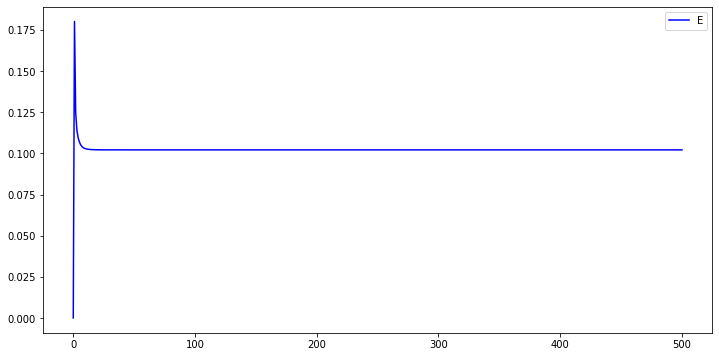

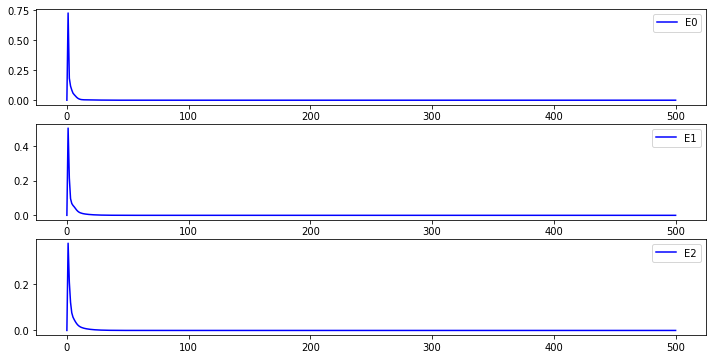

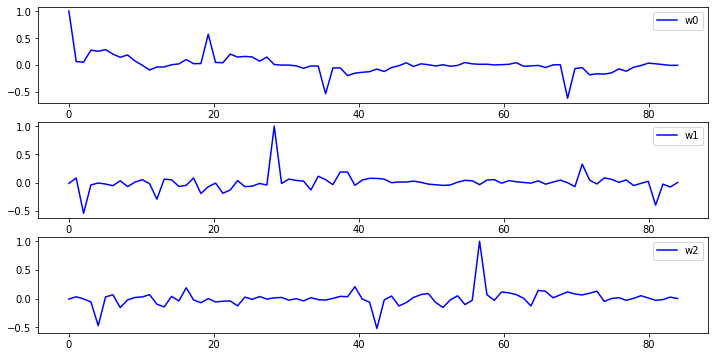

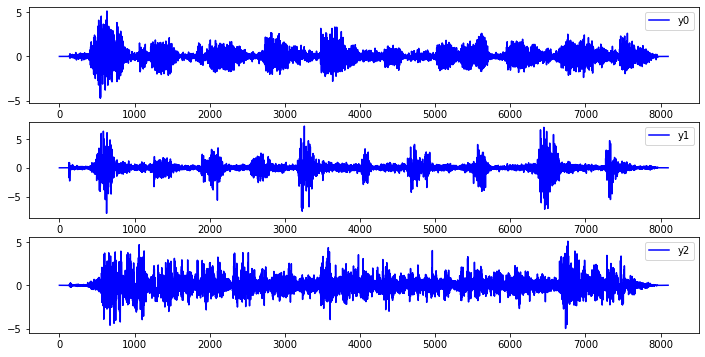

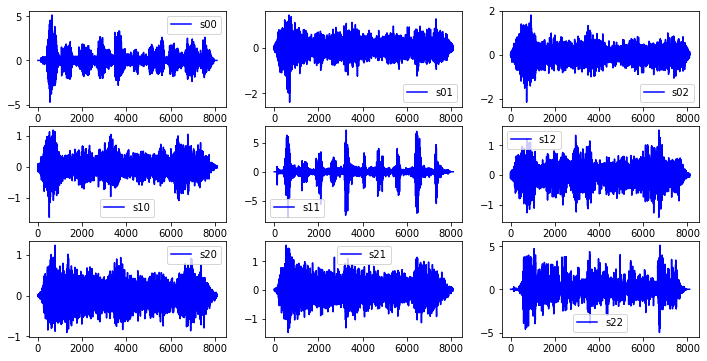

...

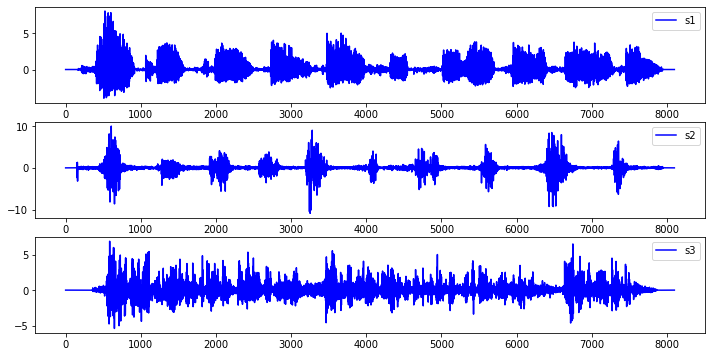

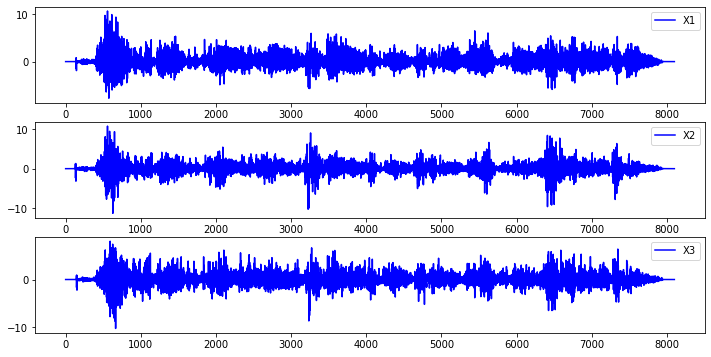

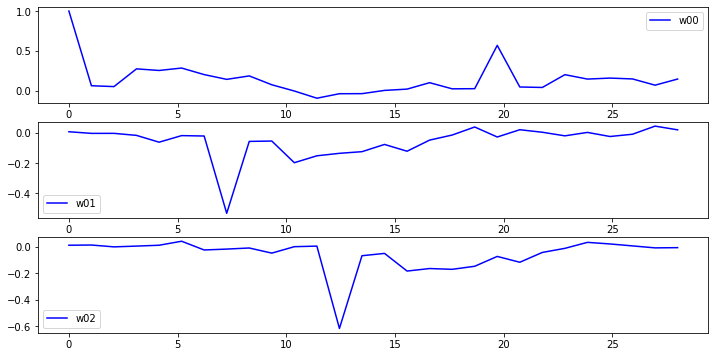

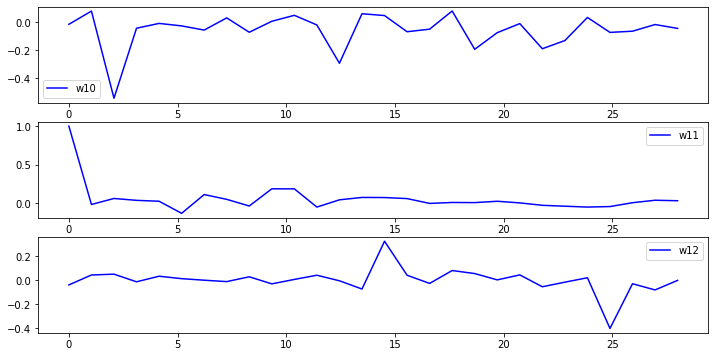

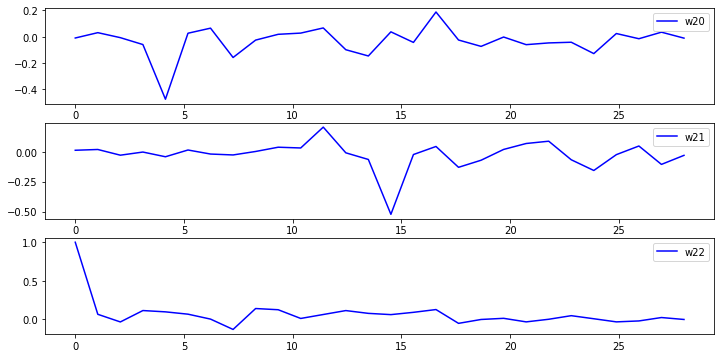

In [216]:
#d1=2,d2=7,d3=5  这儿可以写一篇短文 试水。

X =X_sim
R=200
M=28
lda1=0.00
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0
alpha=1.0
W=TimeDelayDecorrelation3(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K,alpha=alpha)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()
        

In [217]:
for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))


w 0 0  max index :  0
w 0 1  max index :  7
w 0 2  max index :  12
w 1 0  max index :  2
w 1 1  max index :  0
w 1 2  max index :  24
w 2 0  max index :  4
w 2 1  max index :  14
w 2 2  max index :  0


In [329]:
def wave_generate1(poles,p,padding_n):
    """
    AR模型生成波形用于测试,效果不是很好。
    """
    m =poles.shape[0]
    N =p.shape[0]
    y =np.zeros((N+2*padding_n,),dtype=float)
    print('shape(y) ',y.shape)
    for i in range(padding_n,N+padding_n):
        y[i]=np.sum(poles*y[i-m:i])+p[i-padding_n]
        print('y[',i,'] ',y[i],' p[',i,'] ',p[i-padding_n])
    
    return y
    

In [365]:
#fs, x1 = wavfile.read('./audio source/Speech - Speech Separation in difficult environments/Microphone1.wav')
#fs, x2 = wavfile.read('./audio source/Speech - Speech Separation in difficult environments/Microphone2.wav')
#fs, s11 = wavfile.read('./audio source/Speech - Speech Separation in difficult environments/SeparatedSource1.wav')
#fs, s21 = wavfile.read('./audio source/Speech - Speech Separation in difficult environments/SeparatedSource2.wav')

In [366]:
def wave_generate2(X,N=800,padding_n=100):
    N1 =X.shape[0]
    r =N1//N
    y =np.zeros((N+2*padding_n,),dtype=float)
    for i in range(N):
        y[padding_n+i] =X[r*i]
    return y

In [258]:
"""
阵列声波慢度估计，首1位置需要变化。--->这样的话就不再能区分信号？因为首1位置相同。--->按照不相关性质应该不会出现找出相同波形。
效果不好，所以至少在某些数据上效果好点这样才能发文章？-->现在到头来连测试数据都没有，可笑。
总是找到同一个波形。--->即使两个波形之间相关很小。-->应该是相关系数很小才合适，或者限制下w的值得.:相关很小但是相关系数很大。
--->原因是太多的零填充，导致实际数据变的不再重要。
"""
def TimeDelayDecorrelation4(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0,alpha=1.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    #XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    for i in range(p):
        for j in range(p):
            if(j==i):
                W[j*M,i]=1.0
    W =np.random.normal(loc=0,scale=1.0,size=(p*M,p))    
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*R+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*R+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-R,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =50
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    
    F  =np.zeros((p*M-2,p*M),dtype=float)     #使得权向量光滑曲率小
    Z  =np.zeros((p*M-1,p*M),dtype=float)
    for i in range(p*M-1):
        Z[i,i]=1.0;Z[i,i+1]=-1.0;
    for i in range(p*M-2):
        F[i,i]=1.0;F[i,i+1]=-2.0;F[i,i+2]=1.0;
    
    #D可以修改
    D  =np.zeros((N+2*R-1,N+2*R),dtype=float) #使输出信号光滑  lda=10,5,似乎得到结果不错 Q=50,R=50,不白化 
                                              #d1 =5  d2 =10  d3 =15
    for i in range(N-1+2*R):
        D[i,i]=-1.0;D[i,i+1]=1.0;
    D = D@XX

    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            G =np.zeros((p*M,p*M),dtype=float)
            for l in range(2*R+1):
                G =G +Rs[l,:,:]@Q@Rs[2*R-l,:,:]
                print('R[',l-M,'] ',W[:,i][np.newaxis,:]@(Rs[l,:,:]@Q@Rs[2*R-l,:,:])@W[:,i][:,np.newaxis])
            
            #G =G+lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            #print('norm(G-G.T) ',np.linalg.norm(G-G.T))  #是对称矩阵
            
            ww =np.zeros((p*M,1),dtype=float)
            ww[0,0]=1.0
            
            Gn =np.zeros((p*M,p*M),dtype=float)
            index12=0
            index21=0
            index22=0
            
            """
            for m in range(p):
                for n in range(p):
                    if(m==i and n==i):
                        Gn[0:M,0:M] =G[m*M:(m+1)*M,n*M:(n+1)*M]
                    elif(m==i and n!=i):
                        c =index12%(p-1)
                        Gn[0:M,(c+1)*M:(c+2)*M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index12 =index12+1
                    elif(m!=i and n==i):
                        r =index21%(p-1)
                        Gn[(r+1)*M:(r+2)*M,0:M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index21 =index21+1
                    else:
                        r =index22//(p-1)
                        c =index22%(p-1)
                        Gn[(r+1)*M:(r+2)*M,(c+1)*M:(c+2)*M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index22 =index22+1
            """
            Gn =G
            
            G11=Gn[0,0]
            G12=Gn[0,1:p*M]
            G21=Gn[1:p*M,0]
            G22=Gn[1:p*M,1:p*M]
            
            """
            ww_last =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            ww_last[0,0]=1.0
            tol =1e-5
            eps =1e-16
            eta =0.00005  #学习率设置问题，太大太小，影响收敛
            while(np.linalg.norm(ww-ww_last)>tol):
                print('norm(w-w_last) ',np.linalg.norm(ww-ww_last))
                ww_last[1:p*M,0]=ww[1:p*M,0].copy()
                dww =2*G21+(2*G22@(ww_last[1:p*M]))[:,0]+alpha*(ww_last[1:p*M,0]/(eps+abs(ww_last[1:p*M,0])))
                ww[1:p*M,0] =ww_last[1:p*M,0]-eta*dww
            print('ww ',ww)
            """
                
                
            
            ww[1:p*M,0] =(-1.0*np.linalg.inv(G22)@(G21[:,np.newaxis]))[:,0]
            
            W[:,i]=ww[:,0].copy() 
            """
            index0 =0
            for j in range(p):
                if(j==i):
                    W[i*M:(i+1)*M,i]=ww[0:M,0]*1.0
                else:
                    W[j*M:(j+1)*M,i]=ww[(index0+1)*M:(index0+2)*M,0]*1.0
                    index0 =index0+1
                
            """      
                        
            
            
          
            
        
            E[k,i] =(W[:,i][np.newaxis,:]@G@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        

        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0.0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='E')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    print('w.T@R0@w ',np.square(np.mean(y[:,0]*y[:,1]))+np.square(np.mean(y[:,0]*y[:,2])))
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    
    for i in range(p):
        for j in range(i+1,p):
            print('corr[',i,',',j,'] ',np.sum(y[:,i]*y[:,j])/(np.linalg.norm(y[:,i])*np.linalg.norm(y[:,j])))
        
    #这段代码什么意思，都忘了。
    
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@X
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    

    
        
    
    return W

before rank(XX)  90
after  rank(XX)  90
det(Rr)  -3.187929367801132e-119
k  0   1.7320508075688776
R[ -200 ]  [[0.00015472]]
R[ -199 ]  [[0.00012149]]
R[ -198 ]  [[0.00040886]]
R[ -197 ]  [[6.35084818e-06]]
R[ -196 ]  [[9.68983236e-05]]
R[ -195 ]  [[4.48069227e-05]]
R[ -194 ]  [[0.00143836]]
R[ -193 ]  [[9.27942722e-05]]
R[ -192 ]  [[0.00024736]]
R[ -191 ]  [[0.0001335]]
R[ -190 ]  [[3.94075459e-05]]
R[ -189 ]  [[4.93715043e-06]]
R[ -188 ]  [[1.6780418e-05]]
R[ -187 ]  [[0.00068115]]
R[ -186 ]  [[0.00010419]]
R[ -185 ]  [[0.00021558]]
R[ -184 ]  [[0.00021964]]
R[ -183 ]  [[6.16027854e-05]]
R[ -182 ]  [[0.00059916]]
R[ -181 ]  [[9.78037099e-05]]
R[ -180 ]  [[5.02760941e-05]]
R[ -179 ]  [[0.00133989]]
R[ -178 ]  [[0.00024672]]
R[ -177 ]  [[3.2311636e-05]]
R[ -176 ]  [[4.71917783e-05]]
R[ -175 ]  [[2.98137297e-06]]
R[ -174 ]  [[0.00021053]]
R[ -173 ]  [[3.26205265e-05]]
R[ -172 ]  [[4.90244901e-06]]
R[ -171 ]  [[2.19308196e-07]]
R[ -170 ]  [[0.0015162]]
R[ -169 ]  [[0.00019599]]
R[ -168 ]

R[ 122 ]  [[4.07706689e-05]]
R[ 123 ]  [[0.00114387]]
R[ 124 ]  [[0.00074741]]
R[ 125 ]  [[0.0002308]]
R[ 126 ]  [[0.00130675]]
R[ 127 ]  [[1.77609607e-05]]
R[ 128 ]  [[0.00054025]]
R[ 129 ]  [[0.00373641]]
R[ 130 ]  [[0.00032812]]
R[ 131 ]  [[0.00289953]]
R[ 132 ]  [[3.61455714e-05]]
R[ 133 ]  [[9.54823642e-05]]
R[ 134 ]  [[0.00017806]]
R[ 135 ]  [[2.24524072e-05]]
R[ 136 ]  [[0.00101554]]
R[ 137 ]  [[0.00032981]]
R[ 138 ]  [[1.347797e-06]]
R[ 139 ]  [[1.21437747e-05]]
R[ 140 ]  [[1.34095561e-06]]
R[ 141 ]  [[0.00055984]]
R[ 142 ]  [[4.62747566e-05]]
R[ 143 ]  [[0.00202594]]
R[ 144 ]  [[0.00016885]]
R[ 145 ]  [[0.00034668]]
R[ 146 ]  [[6.7781944e-05]]
R[ 147 ]  [[0.00016851]]
R[ 148 ]  [[0.00022685]]
R[ 149 ]  [[0.00034522]]
R[ 150 ]  [[7.49911836e-05]]
R[ 151 ]  [[0.00014465]]
R[ 152 ]  [[0.00064591]]
R[ 153 ]  [[7.23294474e-05]]
R[ 154 ]  [[0.00021012]]
R[ 155 ]  [[0.00037139]]
R[ 156 ]  [[9.00587346e-06]]
R[ 157 ]  [[0.00013298]]
R[ 158 ]  [[0.00011564]]
R[ 159 ]  [[0.00063974]]
R[

R[ -1 ]  [[9.9429904e-05]]
R[ 0 ]  [[0.86019418]]
R[ 1 ]  [[6.9121439e-05]]
R[ 2 ]  [[0.01624767]]
R[ 3 ]  [[0.0047216]]
R[ 4 ]  [[0.00270188]]
R[ 5 ]  [[0.0180946]]
R[ 6 ]  [[0.01690099]]
R[ 7 ]  [[0.00593668]]
R[ 8 ]  [[0.00498535]]
R[ 9 ]  [[0.00423637]]
R[ 10 ]  [[0.00439879]]
R[ 11 ]  [[0.00859545]]
R[ 12 ]  [[0.08065419]]
R[ 13 ]  [[0.00117608]]
R[ 14 ]  [[0.01412548]]
R[ 15 ]  [[0.00679306]]
R[ 16 ]  [[0.00224818]]
R[ 17 ]  [[0.01119798]]
R[ 18 ]  [[0.00741548]]
R[ 19 ]  [[0.00599155]]
R[ 20 ]  [[0.00019784]]
R[ 21 ]  [[0.00059679]]
R[ 22 ]  [[0.00356051]]
R[ 23 ]  [[0.01125269]]
R[ 24 ]  [[0.03539874]]
R[ 25 ]  [[0.00118324]]
R[ 26 ]  [[1.91945106e-05]]
R[ 27 ]  [[0.00306152]]
R[ 28 ]  [[0.0025425]]
R[ 29 ]  [[0.00981657]]
R[ 30 ]  [[0.00018503]]
R[ 31 ]  [[0.0010952]]
R[ 32 ]  [[0.00014925]]
R[ 33 ]  [[0.00054237]]
R[ 34 ]  [[0.00545286]]
R[ 35 ]  [[0.00183759]]
R[ 36 ]  [[0.0015576]]
R[ 37 ]  [[0.00326174]]
R[ 38 ]  [[1.1769422e-05]]
R[ 39 ]  [[0.00247411]]
R[ 40 ]  [[0.00029

R[ -114 ]  [[1.649565e-06]]
R[ -113 ]  [[1.43317754e-05]]
R[ -112 ]  [[3.24248852e-05]]
R[ -111 ]  [[5.32359587e-06]]
R[ -110 ]  [[8.23426062e-07]]
R[ -109 ]  [[1.43671194e-05]]
R[ -108 ]  [[5.55893908e-06]]
R[ -107 ]  [[7.19992783e-06]]
R[ -106 ]  [[6.4797676e-07]]
R[ -105 ]  [[5.70077801e-07]]
R[ -104 ]  [[1.15684828e-05]]
R[ -103 ]  [[2.01778803e-06]]
R[ -102 ]  [[8.55048227e-06]]
R[ -101 ]  [[2.27286598e-06]]
R[ -100 ]  [[2.76745712e-06]]
R[ -99 ]  [[2.60935992e-06]]
R[ -98 ]  [[1.07132415e-05]]
R[ -97 ]  [[9.47457991e-06]]
R[ -96 ]  [[9.35843634e-06]]
R[ -95 ]  [[2.51684895e-05]]
R[ -94 ]  [[3.41339047e-06]]
R[ -93 ]  [[2.71757241e-06]]
R[ -92 ]  [[3.37165271e-05]]
R[ -91 ]  [[3.09679966e-06]]
R[ -90 ]  [[1.26698683e-05]]
R[ -89 ]  [[2.28080865e-05]]
R[ -88 ]  [[3.06827281e-05]]
R[ -87 ]  [[3.21911416e-06]]
R[ -86 ]  [[1.16869248e-06]]
R[ -85 ]  [[1.69130064e-05]]
R[ -84 ]  [[1.92062367e-05]]
R[ -83 ]  [[3.05298279e-06]]
R[ -82 ]  [[7.00504992e-07]]
R[ -81 ]  [[5.42295725e-06]]
R[

R[ -133 ]  [[9.06671478e-08]]
R[ -132 ]  [[1.36941539e-06]]
R[ -131 ]  [[5.3807196e-08]]
R[ -130 ]  [[1.31865864e-07]]
R[ -129 ]  [[5.51871946e-08]]
R[ -128 ]  [[3.47002773e-08]]
R[ -127 ]  [[3.30758624e-07]]
R[ -126 ]  [[5.98698663e-07]]
R[ -125 ]  [[1.12209431e-07]]
R[ -124 ]  [[9.80482381e-07]]
R[ -123 ]  [[9.67349316e-07]]
R[ -122 ]  [[3.53691783e-07]]
R[ -121 ]  [[4.49307342e-07]]
R[ -120 ]  [[3.36480147e-07]]
R[ -119 ]  [[3.22247662e-07]]
R[ -118 ]  [[8.59957098e-07]]
R[ -117 ]  [[2.26807157e-07]]
R[ -116 ]  [[2.70456202e-08]]
R[ -115 ]  [[1.02126226e-06]]
R[ -114 ]  [[7.13331312e-07]]
R[ -113 ]  [[9.52098493e-07]]
R[ -112 ]  [[8.80141813e-07]]
R[ -111 ]  [[3.97988486e-08]]
R[ -110 ]  [[1.23565661e-06]]
R[ -109 ]  [[5.64685747e-07]]
R[ -108 ]  [[1.61875672e-07]]
R[ -107 ]  [[8.65700665e-07]]
R[ -106 ]  [[1.22953734e-06]]
R[ -105 ]  [[8.41180444e-07]]
R[ -104 ]  [[1.35064195e-07]]
R[ -103 ]  [[7.45258352e-07]]
R[ -102 ]  [[4.27016023e-07]]
R[ -101 ]  [[1.12060504e-06]]
R[ -100 ]  

R[ -92 ]  [[2.2016366e-07]]
R[ -91 ]  [[9.78041649e-08]]
R[ -90 ]  [[3.77728527e-08]]
R[ -89 ]  [[4.87225013e-07]]
R[ -88 ]  [[1.54130408e-06]]
R[ -87 ]  [[9.64810289e-07]]
R[ -86 ]  [[2.79640018e-06]]
R[ -85 ]  [[4.13323504e-07]]
R[ -84 ]  [[2.21312714e-06]]
R[ -83 ]  [[2.72251113e-06]]
R[ -82 ]  [[2.49682772e-06]]
R[ -81 ]  [[4.6692316e-06]]
R[ -80 ]  [[9.2889032e-07]]
R[ -79 ]  [[1.60130201e-06]]
R[ -78 ]  [[2.29131107e-06]]
R[ -77 ]  [[2.21603814e-06]]
R[ -76 ]  [[3.62967232e-06]]
R[ -75 ]  [[2.73656254e-06]]
R[ -74 ]  [[1.09896218e-06]]
R[ -73 ]  [[3.85566496e-07]]
R[ -72 ]  [[2.84701534e-06]]
R[ -71 ]  [[4.82498222e-07]]
R[ -70 ]  [[2.27822207e-06]]
R[ -69 ]  [[2.61359602e-07]]
R[ -68 ]  [[6.24878012e-08]]
R[ -67 ]  [[1.23286044e-06]]
R[ -66 ]  [[4.49941408e-07]]
R[ -65 ]  [[1.98925687e-06]]
R[ -64 ]  [[4.51340172e-07]]
R[ -63 ]  [[4.55283277e-08]]
R[ -62 ]  [[6.25212144e-07]]
R[ -61 ]  [[5.43961227e-07]]
R[ -60 ]  [[3.46518536e-07]]
R[ -59 ]  [[1.99714292e-06]]
R[ -58 ]  [[3.790

R[ -80 ]  [[1.11181571e-07]]
R[ -79 ]  [[3.18583525e-07]]
R[ -78 ]  [[2.69738541e-06]]
R[ -77 ]  [[2.20620701e-07]]
R[ -76 ]  [[7.44182172e-07]]
R[ -75 ]  [[1.25922853e-06]]
R[ -74 ]  [[8.3728318e-07]]
R[ -73 ]  [[9.7001631e-07]]
R[ -72 ]  [[1.44526297e-07]]
R[ -71 ]  [[4.1135749e-07]]
R[ -70 ]  [[8.35044277e-07]]
R[ -69 ]  [[1.24313566e-06]]
R[ -68 ]  [[1.58760665e-07]]
R[ -67 ]  [[4.6273625e-08]]
R[ -66 ]  [[8.14879401e-08]]
R[ -65 ]  [[4.99169881e-07]]
R[ -64 ]  [[6.27486615e-07]]
R[ -63 ]  [[2.40021624e-06]]
R[ -62 ]  [[3.74529663e-06]]
R[ -61 ]  [[8.43544668e-08]]
R[ -60 ]  [[9.36749468e-07]]
R[ -59 ]  [[1.97539883e-06]]
R[ -58 ]  [[1.63837908e-06]]
R[ -57 ]  [[7.06175324e-07]]
R[ -56 ]  [[5.9660265e-07]]
R[ -55 ]  [[2.18683399e-07]]
R[ -54 ]  [[1.07145214e-07]]
R[ -53 ]  [[2.03455781e-08]]
R[ -52 ]  [[5.3423673e-07]]
R[ -51 ]  [[3.04705275e-06]]
R[ -50 ]  [[3.98652456e-06]]
R[ -49 ]  [[3.24385775e-07]]
R[ -48 ]  [[1.06612991e-05]]
R[ -47 ]  [[3.14249307e-06]]
R[ -46 ]  [[5.461199

R[ -48 ]  [[9.16285378e-08]]
R[ -47 ]  [[2.42129576e-07]]
R[ -46 ]  [[2.40922496e-07]]
R[ -45 ]  [[3.82158336e-07]]
R[ -44 ]  [[7.11478554e-07]]
R[ -43 ]  [[5.07389293e-07]]
R[ -42 ]  [[4.09403308e-07]]
R[ -41 ]  [[1.19704171e-07]]
R[ -40 ]  [[7.38824894e-07]]
R[ -39 ]  [[5.02092624e-07]]
R[ -38 ]  [[3.66387477e-07]]
R[ -37 ]  [[2.88664224e-07]]
R[ -36 ]  [[3.31783416e-07]]
R[ -35 ]  [[4.35266739e-07]]
R[ -34 ]  [[7.08591003e-07]]
R[ -33 ]  [[1.16174945e-06]]
R[ -32 ]  [[5.60974066e-07]]
R[ -31 ]  [[3.04634029e-07]]
R[ -30 ]  [[5.75022999e-07]]
R[ -29 ]  [[5.26798216e-07]]
R[ -28 ]  [[1.37045618e-06]]
R[ -27 ]  [[1.1633144e-06]]
R[ -26 ]  [[2.90538958e-07]]
R[ -25 ]  [[5.81621473e-07]]
R[ -24 ]  [[6.14653233e-08]]
R[ -23 ]  [[7.91497142e-08]]
R[ -22 ]  [[8.81594779e-07]]
R[ -21 ]  [[6.07092983e-07]]
R[ -20 ]  [[6.42276343e-07]]
R[ -19 ]  [[1.4731868e-06]]
R[ -18 ]  [[3.25436388e-08]]
R[ -17 ]  [[3.26025314e-07]]
R[ -16 ]  [[4.88079287e-08]]
R[ -15 ]  [[1.15761247e-07]]
R[ -14 ]  [[6.62

R[ -39 ]  [[5.0438111e-09]]
R[ -38 ]  [[2.16112422e-07]]
R[ -37 ]  [[9.3419416e-08]]
R[ -36 ]  [[2.28102896e-07]]
R[ -35 ]  [[1.05545925e-07]]
R[ -34 ]  [[1.19959564e-07]]
R[ -33 ]  [[1.56376459e-07]]
R[ -32 ]  [[3.61740918e-08]]
R[ -31 ]  [[3.4927293e-08]]
R[ -30 ]  [[1.69596073e-07]]
R[ -29 ]  [[7.00474003e-08]]
R[ -28 ]  [[1.33040451e-07]]
R[ -27 ]  [[2.44794118e-07]]
R[ -26 ]  [[1.85671956e-07]]
R[ -25 ]  [[7.5226738e-08]]
R[ -24 ]  [[8.76830043e-08]]
R[ -23 ]  [[6.44125117e-08]]
R[ -22 ]  [[5.74963285e-08]]
R[ -21 ]  [[3.67901588e-08]]
R[ -20 ]  [[7.71846171e-08]]
R[ -19 ]  [[4.70712529e-09]]
R[ -18 ]  [[8.64497197e-08]]
R[ -17 ]  [[6.80409773e-08]]
R[ -16 ]  [[4.41787112e-08]]
R[ -15 ]  [[1.64136929e-07]]
R[ -14 ]  [[1.30398591e-08]]
R[ -13 ]  [[1.91889119e-07]]
R[ -12 ]  [[3.6954485e-07]]
R[ -11 ]  [[9.14925634e-08]]
R[ -10 ]  [[2.98870813e-07]]
R[ -9 ]  [[2.2674695e-07]]
R[ -8 ]  [[6.23720757e-09]]
R[ -7 ]  [[1.74787358e-07]]
R[ -6 ]  [[9.19444733e-09]]
R[ -5 ]  [[1.60648911e-0

R[ -13 ]  [[7.12635865e-09]]
R[ -12 ]  [[4.34491622e-08]]
R[ -11 ]  [[1.84670017e-09]]
R[ -10 ]  [[3.37155228e-08]]
R[ -9 ]  [[1.45241686e-09]]
R[ -8 ]  [[9.51337759e-09]]
R[ -7 ]  [[2.22730291e-08]]
R[ -6 ]  [[2.81369715e-08]]
R[ -5 ]  [[9.29915933e-09]]
R[ -4 ]  [[1.69874332e-08]]
R[ -3 ]  [[2.50096348e-08]]
R[ -2 ]  [[1.81594369e-08]]
R[ -1 ]  [[7.9642814e-08]]
R[ 0 ]  [[3.52585821e-08]]
R[ 1 ]  [[3.67340434e-08]]
R[ 2 ]  [[4.19502617e-09]]
R[ 3 ]  [[8.24080506e-09]]
R[ 4 ]  [[7.75433131e-09]]
R[ 5 ]  [[2.61164947e-08]]
R[ 6 ]  [[5.03042025e-10]]
R[ 7 ]  [[2.69004436e-09]]
R[ 8 ]  [[5.52905877e-09]]
R[ 9 ]  [[7.40944349e-09]]
R[ 10 ]  [[1.70300953e-09]]
R[ 11 ]  [[9.70014942e-10]]
R[ 12 ]  [[5.85309567e-09]]
R[ 13 ]  [[2.71373e-09]]
R[ 14 ]  [[9.70763907e-09]]
R[ 15 ]  [[1.13346897e-09]]
R[ 16 ]  [[2.05031877e-08]]
R[ 17 ]  [[1.30260696e-08]]
R[ 18 ]  [[1.08299059e-08]]
R[ 19 ]  [[1.3964221e-08]]
R[ 20 ]  [[4.57434724e-09]]
R[ 21 ]  [[8.09384963e-09]]
R[ 22 ]  [[5.44208539e-09]]
R[ 

R[ -33 ]  [[1.73426308e-09]]
R[ -32 ]  [[2.25203047e-09]]
R[ -31 ]  [[1.15665045e-09]]
R[ -30 ]  [[4.07103697e-11]]
R[ -29 ]  [[3.78482281e-10]]
R[ -28 ]  [[1.68196935e-09]]
R[ -27 ]  [[3.20894708e-09]]
R[ -26 ]  [[1.63304322e-09]]
R[ -25 ]  [[1.08924638e-09]]
R[ -24 ]  [[1.48817293e-10]]
R[ -23 ]  [[2.85740451e-10]]
R[ -22 ]  [[1.07965556e-10]]
R[ -21 ]  [[3.0207328e-09]]
R[ -20 ]  [[4.78785986e-09]]
R[ -19 ]  [[2.46456175e-09]]
R[ -18 ]  [[4.87401256e-09]]
R[ -17 ]  [[8.66680637e-09]]
R[ -16 ]  [[7.97880156e-09]]
R[ -15 ]  [[4.28335648e-09]]
R[ -14 ]  [[2.93078429e-10]]
R[ -13 ]  [[1.80627755e-10]]
R[ -12 ]  [[4.62731246e-10]]
R[ -11 ]  [[4.19647042e-10]]
R[ -10 ]  [[1.61742234e-10]]
R[ -9 ]  [[1.14360006e-09]]
R[ -8 ]  [[6.5984924e-10]]
R[ -7 ]  [[1.12935003e-08]]
R[ -6 ]  [[4.80895778e-09]]
R[ -5 ]  [[3.81145536e-09]]
R[ -4 ]  [[1.97683341e-08]]
R[ -3 ]  [[5.48460412e-09]]
R[ -2 ]  [[9.65659629e-09]]
R[ -1 ]  [[1.2059161e-08]]
R[ 0 ]  [[3.412125e-09]]
R[ 1 ]  [[1.37804239e-08]]
R[ 

R[ -37 ]  [[4.87419188e-10]]
R[ -36 ]  [[1.27126764e-09]]
R[ -35 ]  [[1.27482066e-09]]
R[ -34 ]  [[6.9097634e-10]]
R[ -33 ]  [[8.99744249e-10]]
R[ -32 ]  [[1.35495906e-09]]
R[ -31 ]  [[2.285469e-09]]
R[ -30 ]  [[1.10056227e-09]]
R[ -29 ]  [[2.61081173e-10]]
R[ -28 ]  [[9.35619193e-10]]
R[ -27 ]  [[7.20651743e-10]]
R[ -26 ]  [[3.34026199e-09]]
R[ -25 ]  [[3.75270863e-09]]
R[ -24 ]  [[3.63365179e-10]]
R[ -23 ]  [[6.18233635e-10]]
R[ -22 ]  [[1.61607205e-09]]
R[ -21 ]  [[6.31879359e-10]]
R[ -20 ]  [[1.2242136e-09]]
R[ -19 ]  [[1.29150693e-09]]
R[ -18 ]  [[1.50608074e-09]]
R[ -17 ]  [[2.89152838e-09]]
R[ -16 ]  [[2.59268059e-09]]
R[ -15 ]  [[6.32419498e-10]]
R[ -14 ]  [[8.85367579e-10]]
R[ -13 ]  [[3.65176104e-10]]
R[ -12 ]  [[6.20132022e-10]]
R[ -11 ]  [[9.75358739e-10]]
R[ -10 ]  [[4.20659337e-10]]
R[ -9 ]  [[7.56271384e-10]]
R[ -8 ]  [[4.9470793e-09]]
R[ -7 ]  [[4.6454116e-10]]
R[ -6 ]  [[5.77874679e-10]]
R[ -5 ]  [[1.85130849e-09]]
R[ -4 ]  [[1.93367795e-09]]
R[ -3 ]  [[4.00586756e-09]

R[ -24 ]  [[1.54109379e-10]]
R[ -23 ]  [[8.61866733e-10]]
R[ -22 ]  [[2.04327731e-10]]
R[ -21 ]  [[6.65428758e-10]]
R[ -20 ]  [[3.3638641e-10]]
R[ -19 ]  [[1.15721631e-10]]
R[ -18 ]  [[7.51663895e-11]]
R[ -17 ]  [[8.1911944e-11]]
R[ -16 ]  [[3.20857452e-10]]
R[ -15 ]  [[3.87655267e-10]]
R[ -14 ]  [[6.67726937e-10]]
R[ -13 ]  [[1.1923545e-09]]
R[ -12 ]  [[1.9121463e-10]]
R[ -11 ]  [[1.19766717e-09]]
R[ -10 ]  [[6.00226332e-12]]
R[ -9 ]  [[3.09549385e-10]]
R[ -8 ]  [[1.01394138e-11]]
R[ -7 ]  [[8.02622416e-11]]
R[ -6 ]  [[3.52546505e-10]]
R[ -5 ]  [[3.24649061e-10]]
R[ -4 ]  [[1.19462042e-09]]
R[ -3 ]  [[5.64575311e-10]]
R[ -2 ]  [[5.63085604e-10]]
R[ -1 ]  [[3.76584009e-10]]
R[ 0 ]  [[1.14517347e-11]]
R[ 1 ]  [[9.71856126e-11]]
R[ 2 ]  [[1.18588786e-10]]
R[ 3 ]  [[7.91899719e-11]]
R[ 4 ]  [[4.7652894e-10]]
R[ 5 ]  [[1.44619287e-10]]
R[ 6 ]  [[2.31784052e-12]]
R[ 7 ]  [[7.94359603e-10]]
R[ 8 ]  [[3.12516271e-10]]
R[ 9 ]  [[3.41060296e-10]]
R[ 10 ]  [[8.14057743e-11]]
R[ 11 ]  [[1.5890174

R[ -11 ]  [[6.39973182e-10]]
R[ -10 ]  [[7.7701875e-10]]
R[ -9 ]  [[4.67440678e-10]]
R[ -8 ]  [[6.21429291e-10]]
R[ -7 ]  [[6.41717079e-10]]
R[ -6 ]  [[7.23578341e-10]]
R[ -5 ]  [[2.77740424e-10]]
R[ -4 ]  [[7.97279687e-11]]
R[ -3 ]  [[1.42154171e-10]]
R[ -2 ]  [[1.25794439e-11]]
R[ -1 ]  [[2.74934821e-11]]
R[ 0 ]  [[6.83579384e-10]]
R[ 1 ]  [[7.75022424e-10]]
R[ 2 ]  [[6.92434227e-10]]
R[ 3 ]  [[6.48690123e-11]]
R[ 4 ]  [[3.72449351e-11]]
R[ 5 ]  [[9.36083314e-11]]
R[ 6 ]  [[7.20622626e-10]]
R[ 7 ]  [[1.06383622e-09]]
R[ 8 ]  [[7.67106675e-10]]
R[ 9 ]  [[9.42039248e-10]]
R[ 10 ]  [[1.67948289e-09]]
R[ 11 ]  [[1.48103165e-09]]
R[ 12 ]  [[9.94178684e-10]]
R[ 13 ]  [[1.22548554e-09]]
R[ 14 ]  [[6.64956247e-10]]
R[ 15 ]  [[9.15744534e-11]]
R[ 16 ]  [[8.82154827e-12]]
R[ 17 ]  [[1.30680669e-10]]
R[ 18 ]  [[2.90556355e-10]]
R[ 19 ]  [[5.24719258e-10]]
R[ 20 ]  [[8.69387231e-10]]
R[ 21 ]  [[6.55654489e-10]]
R[ 22 ]  [[1.62283839e-10]]
R[ 23 ]  [[1.4934941e-10]]
R[ 24 ]  [[4.02459024e-11]]
R[

R[ -6 ]  [[5.06001025e-12]]
R[ -5 ]  [[1.15347256e-10]]
R[ -4 ]  [[2.41216948e-10]]
R[ -3 ]  [[1.21357962e-10]]
R[ -2 ]  [[4.81980393e-10]]
R[ -1 ]  [[4.92414204e-10]]
R[ 0 ]  [[1.23095923e-12]]
R[ 1 ]  [[1.90841527e-10]]
R[ 2 ]  [[7.19776037e-11]]
R[ 3 ]  [[8.01459811e-12]]
R[ 4 ]  [[7.70074803e-12]]
R[ 5 ]  [[3.25241184e-11]]
R[ 6 ]  [[3.80247574e-11]]
R[ 7 ]  [[5.69660026e-11]]
R[ 8 ]  [[3.03974664e-11]]
R[ 9 ]  [[7.1103977e-12]]
R[ 10 ]  [[1.16990213e-10]]
R[ 11 ]  [[3.04721312e-11]]
R[ 12 ]  [[4.60159521e-11]]
R[ 13 ]  [[1.4484316e-10]]
R[ 14 ]  [[3.24167376e-11]]
R[ 15 ]  [[5.21110488e-12]]
R[ 16 ]  [[9.43577305e-12]]
R[ 17 ]  [[4.6805413e-11]]
R[ 18 ]  [[1.790974e-10]]
R[ 19 ]  [[6.96079666e-11]]
R[ 20 ]  [[5.09010621e-11]]
R[ 21 ]  [[5.46373435e-12]]
R[ 22 ]  [[1.72523013e-10]]
R[ 23 ]  [[4.66223439e-12]]
R[ 24 ]  [[5.71169711e-10]]
R[ 25 ]  [[2.69042326e-11]]
R[ 26 ]  [[3.35086137e-10]]
R[ 27 ]  [[1.88840036e-10]]
R[ 28 ]  [[3.84809896e-11]]
R[ 29 ]  [[1.65001226e-10]]
R[ 30 ]

R[ 2 ]  [[8.43357742e-12]]
R[ 3 ]  [[7.68715377e-12]]
R[ 4 ]  [[1.23992558e-11]]
R[ 5 ]  [[2.69784389e-11]]
R[ 6 ]  [[2.1902271e-11]]
R[ 7 ]  [[3.16992313e-12]]
R[ 8 ]  [[5.53175231e-12]]
R[ 9 ]  [[2.15311847e-11]]
R[ 10 ]  [[4.667807e-12]]
R[ 11 ]  [[2.36812783e-12]]
R[ 12 ]  [[1.30716627e-11]]
R[ 13 ]  [[1.37250328e-11]]
R[ 14 ]  [[4.45581574e-12]]
R[ 15 ]  [[5.0186713e-12]]
R[ 16 ]  [[3.09876274e-12]]
R[ 17 ]  [[1.29594196e-11]]
R[ 18 ]  [[4.69914387e-11]]
R[ 19 ]  [[3.14030432e-11]]
R[ 20 ]  [[1.43266877e-11]]
R[ 21 ]  [[1.14551462e-11]]
R[ 22 ]  [[7.29942316e-12]]
R[ 23 ]  [[3.01509452e-12]]
R[ 24 ]  [[7.44347045e-12]]
R[ 25 ]  [[2.62811121e-11]]
R[ 26 ]  [[2.75235078e-11]]
R[ 27 ]  [[9.52401421e-12]]
R[ 28 ]  [[7.71953865e-12]]
R[ 29 ]  [[9.83249738e-11]]
R[ 30 ]  [[1.58741993e-10]]
R[ 31 ]  [[7.48044931e-11]]
R[ 32 ]  [[4.8310015e-12]]
R[ 33 ]  [[7.01893124e-12]]
R[ 34 ]  [[1.01907615e-11]]
R[ 35 ]  [[1.8291933e-12]]
R[ 36 ]  [[1.94178958e-11]]
R[ 37 ]  [[3.0816015e-11]]
R[ 38 ]

R[ 0 ]  [[3.42326767e-11]]
R[ 1 ]  [[5.65272511e-11]]
R[ 2 ]  [[8.98395595e-11]]
R[ 3 ]  [[7.05437514e-11]]
R[ 4 ]  [[9.92354462e-11]]
R[ 5 ]  [[1.12135523e-10]]
R[ 6 ]  [[7.17101058e-11]]
R[ 7 ]  [[5.88400426e-11]]
R[ 8 ]  [[1.14047334e-11]]
R[ 9 ]  [[1.23399521e-11]]
R[ 10 ]  [[1.29115896e-11]]
R[ 11 ]  [[9.49170953e-12]]
R[ 12 ]  [[1.64298967e-11]]
R[ 13 ]  [[7.64586108e-14]]
R[ 14 ]  [[5.3039353e-12]]
R[ 15 ]  [[2.08236061e-11]]
R[ 16 ]  [[3.59856327e-11]]
R[ 17 ]  [[2.45867628e-12]]
R[ 18 ]  [[6.35013656e-12]]
R[ 19 ]  [[2.35348051e-11]]
R[ 20 ]  [[6.83892008e-11]]
R[ 21 ]  [[3.68819029e-11]]
R[ 22 ]  [[6.79143742e-12]]
R[ 23 ]  [[1.1479916e-11]]
R[ 24 ]  [[2.18946996e-11]]
R[ 25 ]  [[4.09673286e-12]]
R[ 26 ]  [[4.19126936e-12]]
R[ 27 ]  [[7.84956652e-13]]
R[ 28 ]  [[1.01066847e-14]]
R[ 29 ]  [[1.34914277e-12]]
R[ 30 ]  [[2.40261971e-11]]
R[ 31 ]  [[5.84931777e-11]]
R[ 32 ]  [[8.80503841e-12]]
R[ 33 ]  [[2.69118548e-11]]
R[ 34 ]  [[7.61645454e-11]]
R[ 35 ]  [[3.16559717e-11]]
R[ 3

R[ 10 ]  [[1.51967216e-12]]
R[ 11 ]  [[1.4859566e-12]]
R[ 12 ]  [[6.10043254e-12]]
R[ 13 ]  [[3.36762877e-12]]
R[ 14 ]  [[2.29608472e-12]]
R[ 15 ]  [[8.21399377e-13]]
R[ 16 ]  [[2.49290915e-12]]
R[ 17 ]  [[3.24069891e-13]]
R[ 18 ]  [[1.64638631e-12]]
R[ 19 ]  [[7.21401445e-13]]
R[ 20 ]  [[5.85488963e-12]]
R[ 21 ]  [[2.67226868e-13]]
R[ 22 ]  [[3.70542756e-12]]
R[ 23 ]  [[4.88155547e-13]]
R[ 24 ]  [[1.99705607e-12]]
R[ 25 ]  [[1.96383252e-12]]
R[ 26 ]  [[6.87499189e-12]]
R[ 27 ]  [[7.37847647e-12]]
R[ 28 ]  [[2.59088272e-13]]
R[ 29 ]  [[1.05184033e-11]]
R[ 30 ]  [[7.53979542e-12]]
R[ 31 ]  [[5.86615208e-12]]
R[ 32 ]  [[1.54618103e-11]]
R[ 33 ]  [[7.93673218e-13]]
R[ 34 ]  [[4.57366875e-12]]
R[ 35 ]  [[1.48018302e-12]]
R[ 36 ]  [[2.317357e-12]]
R[ 37 ]  [[1.35464984e-11]]
R[ 38 ]  [[9.80713377e-12]]
R[ 39 ]  [[1.70871637e-11]]
R[ 40 ]  [[1.88607829e-11]]
R[ 41 ]  [[2.7929361e-12]]
R[ 42 ]  [[2.08640936e-12]]
R[ 43 ]  [[4.76772252e-12]]
R[ 44 ]  [[1.10485921e-11]]
R[ 45 ]  [[1.60304922e-1

R[ -3 ]  [[7.02697318e-12]]
R[ -2 ]  [[3.63442135e-13]]
R[ -1 ]  [[3.14891959e-12]]
R[ 0 ]  [[7.62518947e-12]]
R[ 1 ]  [[1.45101735e-12]]
R[ 2 ]  [[1.25814378e-12]]
R[ 3 ]  [[4.84873957e-12]]
R[ 4 ]  [[1.61755324e-13]]
R[ 5 ]  [[8.78147353e-12]]
R[ 6 ]  [[8.43916633e-12]]
R[ 7 ]  [[8.79019989e-13]]
R[ 8 ]  [[4.29759699e-12]]
R[ 9 ]  [[2.98577632e-12]]
R[ 10 ]  [[2.2765209e-13]]
R[ 11 ]  [[3.93974855e-13]]
R[ 12 ]  [[4.01495793e-12]]
R[ 13 ]  [[3.02438399e-12]]
R[ 14 ]  [[6.06745747e-13]]
R[ 15 ]  [[3.50091626e-12]]
R[ 16 ]  [[6.03453329e-13]]
R[ 17 ]  [[3.03352027e-14]]
R[ 18 ]  [[1.61461659e-13]]
R[ 19 ]  [[6.6192263e-13]]
R[ 20 ]  [[6.51607532e-13]]
R[ 21 ]  [[7.89326745e-12]]
R[ 22 ]  [[1.86761387e-12]]
R[ 23 ]  [[2.67248972e-12]]
R[ 24 ]  [[1.00485727e-12]]
R[ 25 ]  [[3.98435458e-13]]
R[ 26 ]  [[3.11100816e-12]]
R[ 27 ]  [[4.32770235e-13]]
R[ 28 ]  [[7.17015466e-13]]
R[ 29 ]  [[1.09671921e-13]]
R[ 30 ]  [[5.10111063e-12]]
R[ 31 ]  [[2.39070882e-12]]
R[ 32 ]  [[1.44657857e-13]]
R[ 3

R[ -68 ]  [[6.32413934e-13]]
R[ -67 ]  [[3.26538079e-12]]
R[ -66 ]  [[5.32431994e-12]]
R[ -65 ]  [[1.24646093e-12]]
R[ -64 ]  [[2.26065414e-13]]
R[ -63 ]  [[7.49089583e-14]]
R[ -62 ]  [[5.69763978e-14]]
R[ -61 ]  [[9.08173547e-14]]
R[ -60 ]  [[7.90695685e-14]]
R[ -59 ]  [[1.2087654e-13]]
R[ -58 ]  [[2.92374883e-13]]
R[ -57 ]  [[1.80426864e-13]]
R[ -56 ]  [[1.96491457e-13]]
R[ -55 ]  [[1.21704215e-12]]
R[ -54 ]  [[8.59198772e-13]]
R[ -53 ]  [[1.94343025e-13]]
R[ -52 ]  [[7.26038566e-13]]
R[ -51 ]  [[1.80490253e-12]]
R[ -50 ]  [[5.66492295e-12]]
R[ -49 ]  [[2.374514e-12]]
R[ -48 ]  [[6.10768766e-13]]
R[ -47 ]  [[6.89339629e-13]]
R[ -46 ]  [[6.57386978e-13]]
R[ -45 ]  [[7.3274439e-14]]
R[ -44 ]  [[2.08557806e-12]]
R[ -43 ]  [[2.61499037e-13]]
R[ -42 ]  [[2.35640488e-12]]
R[ -41 ]  [[3.85077769e-12]]
R[ -40 ]  [[6.40762724e-12]]
R[ -39 ]  [[5.38953766e-12]]
R[ -38 ]  [[1.0863849e-13]]
R[ -37 ]  [[7.52852183e-13]]
R[ -36 ]  [[5.88880555e-13]]
R[ -35 ]  [[5.51319841e-13]]
R[ -34 ]  [[1.24196

R[ -112 ]  [[1.81129766e-12]]
R[ -111 ]  [[2.4602181e-13]]
R[ -110 ]  [[7.15784574e-14]]
R[ -109 ]  [[2.09102514e-13]]
R[ -108 ]  [[1.16938086e-13]]
R[ -107 ]  [[5.09729517e-13]]
R[ -106 ]  [[1.63306305e-13]]
R[ -105 ]  [[2.29902369e-13]]
R[ -104 ]  [[2.31583229e-14]]
R[ -103 ]  [[4.668107e-13]]
R[ -102 ]  [[1.20514992e-14]]
R[ -101 ]  [[2.431783e-13]]
R[ -100 ]  [[2.45946984e-13]]
R[ -99 ]  [[9.61237256e-14]]
R[ -98 ]  [[2.67672975e-14]]
R[ -97 ]  [[2.62749743e-13]]
R[ -96 ]  [[5.66974328e-14]]
R[ -95 ]  [[4.22539456e-14]]
R[ -94 ]  [[1.5497934e-13]]
R[ -93 ]  [[1.62532634e-14]]
R[ -92 ]  [[1.02369536e-13]]
R[ -91 ]  [[1.57709776e-13]]
R[ -90 ]  [[5.64871625e-13]]
R[ -89 ]  [[4.40329015e-13]]
R[ -88 ]  [[4.50515132e-14]]
R[ -87 ]  [[9.80260368e-14]]
R[ -86 ]  [[2.66181095e-14]]
R[ -85 ]  [[9.03501216e-16]]
R[ -84 ]  [[4.48483115e-14]]
R[ -83 ]  [[7.9112435e-14]]
R[ -82 ]  [[1.98782271e-13]]
R[ -81 ]  [[2.42068854e-13]]
R[ -80 ]  [[2.82584612e-13]]
R[ -79 ]  [[6.39031404e-13]]
R[ -78 ]

R[ -146 ]  [[5.86157579e-15]]
R[ -145 ]  [[2.73236944e-13]]
R[ -144 ]  [[1.1845374e-13]]
R[ -143 ]  [[2.16231528e-13]]
R[ -142 ]  [[9.64085672e-14]]
R[ -141 ]  [[4.01990307e-14]]
R[ -140 ]  [[5.83219988e-14]]
R[ -139 ]  [[5.25059056e-15]]
R[ -138 ]  [[4.58807307e-14]]
R[ -137 ]  [[4.1215939e-14]]
R[ -136 ]  [[4.75799681e-14]]
R[ -135 ]  [[1.03159394e-13]]
R[ -134 ]  [[2.84244992e-14]]
R[ -133 ]  [[1.03302045e-13]]
R[ -132 ]  [[2.11111575e-14]]
R[ -131 ]  [[2.38305979e-15]]
R[ -130 ]  [[7.55148909e-14]]
R[ -129 ]  [[1.29487569e-15]]
R[ -128 ]  [[2.57838808e-13]]
R[ -127 ]  [[1.74664989e-14]]
R[ -126 ]  [[1.00396846e-13]]
R[ -125 ]  [[1.34108512e-14]]
R[ -124 ]  [[1.23829884e-13]]
R[ -123 ]  [[3.26006412e-13]]
R[ -122 ]  [[3.53721088e-14]]
R[ -121 ]  [[7.02179976e-14]]
R[ -120 ]  [[3.39715024e-14]]
R[ -119 ]  [[7.48749758e-14]]
R[ -118 ]  [[2.11974296e-14]]
R[ -117 ]  [[1.60728786e-13]]
R[ -116 ]  [[1.51809546e-13]]
R[ -115 ]  [[5.73351612e-13]]
R[ -114 ]  [[7.08094285e-14]]
R[ -113 ]  [

R[ -176 ]  [[9.52587883e-14]]
R[ -175 ]  [[1.35107933e-13]]
R[ -174 ]  [[1.14194879e-13]]
R[ -173 ]  [[1.48545548e-13]]
R[ -172 ]  [[8.15772599e-14]]
R[ -171 ]  [[1.1939944e-13]]
R[ -170 ]  [[5.59236238e-14]]
R[ -169 ]  [[2.53358185e-13]]
R[ -168 ]  [[3.29173212e-13]]
R[ -167 ]  [[7.0738081e-14]]
R[ -166 ]  [[3.39860818e-13]]
R[ -165 ]  [[1.45708496e-13]]
R[ -164 ]  [[1.39801672e-14]]
R[ -163 ]  [[1.7849347e-14]]
R[ -162 ]  [[1.10801507e-13]]
R[ -161 ]  [[1.80323308e-13]]
R[ -160 ]  [[3.86726511e-14]]
R[ -159 ]  [[2.30111466e-14]]
R[ -158 ]  [[2.07620601e-13]]
R[ -157 ]  [[2.28180211e-13]]
R[ -156 ]  [[4.09903489e-13]]
R[ -155 ]  [[1.8853775e-13]]
R[ -154 ]  [[1.13800369e-13]]
R[ -153 ]  [[1.86245981e-13]]
R[ -152 ]  [[5.69978773e-14]]
R[ -151 ]  [[8.38192996e-14]]
R[ -150 ]  [[3.63687721e-13]]
R[ -149 ]  [[6.41748625e-13]]
R[ -148 ]  [[4.21107796e-13]]
R[ -147 ]  [[1.6236018e-13]]
R[ -146 ]  [[4.94833073e-14]]
R[ -145 ]  [[1.80801217e-13]]
R[ -144 ]  [[2.75303281e-13]]
R[ -143 ]  [[2.

R[ 116 ]  [[1.20577854e-13]]
R[ 117 ]  [[9.09827575e-15]]
R[ 118 ]  [[7.78123731e-14]]
R[ 119 ]  [[4.35790046e-14]]
R[ 120 ]  [[2.72579165e-13]]
R[ 121 ]  [[3.01756406e-13]]
R[ 122 ]  [[1.34652948e-13]]
R[ 123 ]  [[2.15500009e-13]]
R[ 124 ]  [[1.74962961e-13]]
R[ 125 ]  [[1.67438943e-13]]
R[ 126 ]  [[1.55352113e-13]]
R[ 127 ]  [[2.2095967e-14]]
R[ 128 ]  [[7.05583308e-14]]
R[ 129 ]  [[1.25723638e-13]]
R[ 130 ]  [[9.74426731e-14]]
R[ 131 ]  [[2.82133386e-14]]
R[ 132 ]  [[1.36992762e-13]]
R[ 133 ]  [[5.20447954e-14]]
R[ 134 ]  [[1.35354466e-13]]
R[ 135 ]  [[2.41420403e-13]]
R[ 136 ]  [[7.94208827e-14]]
R[ 137 ]  [[1.64222336e-13]]
R[ 138 ]  [[2.47021322e-13]]
R[ 139 ]  [[6.7330319e-14]]
R[ 140 ]  [[4.57812829e-13]]
R[ 141 ]  [[6.70683654e-14]]
R[ 142 ]  [[2.38682755e-15]]
R[ 143 ]  [[4.61954834e-14]]
R[ 144 ]  [[1.2185236e-13]]
R[ 145 ]  [[6.26206442e-14]]
R[ 146 ]  [[2.72086175e-14]]
R[ 147 ]  [[8.07047099e-14]]
R[ 148 ]  [[4.52889941e-13]]
R[ 149 ]  [[3.5542518e-13]]
R[ 150 ]  [[1.1704

R[ 108 ]  [[2.53281204e-14]]
R[ 109 ]  [[7.98168688e-14]]
R[ 110 ]  [[2.00847274e-13]]
R[ 111 ]  [[1.02027018e-14]]
R[ 112 ]  [[2.13047963e-13]]
R[ 113 ]  [[9.82364489e-15]]
R[ 114 ]  [[1.36920923e-13]]
R[ 115 ]  [[1.9997159e-14]]
R[ 116 ]  [[1.2545591e-15]]
R[ 117 ]  [[2.28250579e-14]]
R[ 118 ]  [[5.21427866e-14]]
R[ 119 ]  [[3.60845511e-13]]
R[ 120 ]  [[1.27024801e-13]]
R[ 121 ]  [[7.12235626e-14]]
R[ 122 ]  [[9.12604629e-14]]
R[ 123 ]  [[8.86577388e-14]]
R[ 124 ]  [[3.29236485e-13]]
R[ 125 ]  [[6.14369318e-15]]
R[ 126 ]  [[1.83908149e-13]]
R[ 127 ]  [[1.26778669e-13]]
R[ 128 ]  [[1.27035378e-13]]
R[ 129 ]  [[2.72802524e-13]]
R[ 130 ]  [[7.93253624e-14]]
R[ 131 ]  [[9.11844476e-14]]
R[ 132 ]  [[5.57238191e-14]]
R[ 133 ]  [[1.20227654e-14]]
R[ 134 ]  [[3.00867883e-14]]
R[ 135 ]  [[4.3349906e-16]]
R[ 136 ]  [[5.90994157e-14]]
R[ 137 ]  [[6.1758479e-14]]
R[ 138 ]  [[8.14504021e-14]]
R[ 139 ]  [[1.24169854e-13]]
R[ 140 ]  [[8.83325147e-14]]
R[ 141 ]  [[1.91484673e-14]]
R[ 142 ]  [[6.0293

R[ 30 ]  [[3.1506249e-14]]
R[ 31 ]  [[1.78912156e-15]]
R[ 32 ]  [[2.65761577e-14]]
R[ 33 ]  [[3.42600586e-14]]
R[ 34 ]  [[1.36113849e-14]]
R[ 35 ]  [[3.39475112e-14]]
R[ 36 ]  [[6.79191664e-15]]
R[ 37 ]  [[4.19801595e-15]]
R[ 38 ]  [[6.60375367e-14]]
R[ 39 ]  [[5.68497779e-14]]
R[ 40 ]  [[7.85681484e-14]]
R[ 41 ]  [[4.52736787e-14]]
R[ 42 ]  [[3.58865634e-14]]
R[ 43 ]  [[3.06033075e-14]]
R[ 44 ]  [[1.2180709e-14]]
R[ 45 ]  [[1.5659925e-14]]
R[ 46 ]  [[5.54537289e-14]]
R[ 47 ]  [[1.59692237e-14]]
R[ 48 ]  [[1.84745381e-14]]
R[ 49 ]  [[3.89285477e-14]]
R[ 50 ]  [[1.08959922e-13]]
R[ 51 ]  [[6.86677417e-14]]
R[ 52 ]  [[3.18175878e-14]]
R[ 53 ]  [[1.06530698e-13]]
R[ 54 ]  [[6.19169879e-15]]
R[ 55 ]  [[9.43521205e-14]]
R[ 56 ]  [[1.22590477e-14]]
R[ 57 ]  [[2.52316595e-14]]
R[ 58 ]  [[3.20731122e-14]]
R[ 59 ]  [[2.83185677e-15]]
R[ 60 ]  [[2.11638945e-14]]
R[ 61 ]  [[1.90136808e-14]]
R[ 62 ]  [[1.36733513e-15]]
R[ 63 ]  [[9.22086742e-16]]
R[ 64 ]  [[2.32179727e-15]]
R[ 65 ]  [[1.39176667e-

R[ -82 ]  [[1.18313069e-14]]
R[ -81 ]  [[3.02099521e-13]]
R[ -80 ]  [[1.04448847e-13]]
R[ -79 ]  [[3.53318454e-15]]
R[ -78 ]  [[9.17961768e-14]]
R[ -77 ]  [[2.40605584e-13]]
R[ -76 ]  [[2.37671039e-13]]
R[ -75 ]  [[5.28003882e-14]]
R[ -74 ]  [[3.63948948e-14]]
R[ -73 ]  [[4.09518448e-14]]
R[ -72 ]  [[7.17865353e-14]]
R[ -71 ]  [[8.99123676e-14]]
R[ -70 ]  [[5.84739317e-14]]
R[ -69 ]  [[2.60360249e-15]]
R[ -68 ]  [[1.48571818e-14]]
R[ -67 ]  [[2.00891944e-13]]
R[ -66 ]  [[4.13142768e-13]]
R[ -65 ]  [[2.50833862e-14]]
R[ -64 ]  [[8.81373146e-14]]
R[ -63 ]  [[1.13884683e-14]]
R[ -62 ]  [[3.63823179e-14]]
R[ -61 ]  [[5.85474863e-14]]
R[ -60 ]  [[1.12246028e-13]]
R[ -59 ]  [[6.87167321e-14]]
R[ -58 ]  [[7.99778152e-14]]
R[ -57 ]  [[1.27912281e-13]]
R[ -56 ]  [[1.7509322e-14]]
R[ -55 ]  [[9.29220566e-14]]
R[ -54 ]  [[2.88300042e-14]]
R[ -53 ]  [[4.37462598e-14]]
R[ -52 ]  [[9.3240922e-15]]
R[ -51 ]  [[2.36977268e-14]]
R[ -50 ]  [[5.25800304e-14]]
R[ -49 ]  [[2.30786009e-13]]
R[ -48 ]  [[2.62

R[ 82 ]  [[1.98952885e-14]]
R[ 83 ]  [[3.69312855e-13]]
R[ 84 ]  [[1.26880939e-13]]
R[ 85 ]  [[3.00304719e-15]]
R[ 86 ]  [[1.43581812e-15]]
R[ 87 ]  [[9.53730453e-16]]
R[ 88 ]  [[9.74298466e-15]]
R[ 89 ]  [[1.57411488e-14]]
R[ 90 ]  [[1.25922697e-14]]
R[ 91 ]  [[1.4522572e-13]]
R[ 92 ]  [[2.2329661e-13]]
R[ 93 ]  [[3.11951828e-14]]
R[ 94 ]  [[4.36877778e-14]]
R[ 95 ]  [[1.10625336e-13]]
R[ 96 ]  [[5.8973378e-14]]
R[ 97 ]  [[2.39541059e-13]]
R[ 98 ]  [[2.75969424e-14]]
R[ 99 ]  [[9.22626105e-15]]
R[ 100 ]  [[5.11811206e-16]]
R[ 101 ]  [[2.00865027e-14]]
R[ 102 ]  [[9.87586365e-14]]
R[ 103 ]  [[1.93635675e-14]]
R[ 104 ]  [[4.58295381e-15]]
R[ 105 ]  [[2.80211088e-14]]
R[ 106 ]  [[6.17656537e-14]]
R[ 107 ]  [[1.84043539e-14]]
R[ 108 ]  [[4.48855633e-14]]
R[ 109 ]  [[2.21725983e-14]]
R[ 110 ]  [[2.45802185e-14]]
R[ 111 ]  [[4.53278109e-14]]
R[ 112 ]  [[6.95882579e-14]]
R[ 113 ]  [[1.88550154e-14]]
R[ 114 ]  [[1.08598961e-13]]
R[ 115 ]  [[2.30802587e-14]]
R[ 116 ]  [[2.07325358e-15]]
R[ 117

R[ -37 ]  [[8.98852359e-15]]
R[ -36 ]  [[2.46313272e-15]]
R[ -35 ]  [[9.63126235e-15]]
R[ -34 ]  [[1.03293232e-14]]
R[ -33 ]  [[1.21376523e-14]]
R[ -32 ]  [[9.85147832e-15]]
R[ -31 ]  [[1.44032811e-14]]
R[ -30 ]  [[2.30194917e-15]]
R[ -29 ]  [[1.44754358e-14]]
R[ -28 ]  [[8.1515294e-15]]
R[ -27 ]  [[1.72777321e-14]]
R[ -26 ]  [[6.0352674e-15]]
R[ -25 ]  [[2.92559375e-14]]
R[ -24 ]  [[5.93177054e-14]]
R[ -23 ]  [[2.53546059e-14]]
R[ -22 ]  [[2.58592836e-15]]
R[ -21 ]  [[1.50915197e-15]]
R[ -20 ]  [[6.99316758e-15]]
R[ -19 ]  [[1.05113354e-15]]
R[ -18 ]  [[2.35116653e-14]]
R[ -17 ]  [[2.92896103e-14]]
R[ -16 ]  [[1.23885486e-14]]
R[ -15 ]  [[6.35930432e-15]]
R[ -14 ]  [[2.3649146e-15]]
R[ -13 ]  [[1.6845946e-14]]
R[ -12 ]  [[1.89512375e-14]]
R[ -11 ]  [[8.42571316e-15]]
R[ -10 ]  [[1.74011828e-14]]
R[ -9 ]  [[3.71280995e-14]]
R[ -8 ]  [[3.23994084e-14]]
R[ -7 ]  [[4.28167845e-14]]
R[ -6 ]  [[4.39231763e-14]]
R[ -5 ]  [[1.41884208e-14]]
R[ -4 ]  [[2.44389668e-14]]
R[ -3 ]  [[3.17503244e-1

E  [2.44831796e-11 1.96262917e-11 2.94560027e-12]
k  9   0.0945410268084612
R[ -200 ]  [[2.13706674e-15]]
R[ -199 ]  [[3.8509908e-15]]
R[ -198 ]  [[1.89354874e-14]]
R[ -197 ]  [[3.31657291e-14]]
R[ -196 ]  [[6.89353343e-15]]
R[ -195 ]  [[2.19708862e-14]]
R[ -194 ]  [[4.40927853e-14]]
R[ -193 ]  [[5.16797326e-15]]
R[ -192 ]  [[4.46279716e-15]]
R[ -191 ]  [[6.36787858e-15]]
R[ -190 ]  [[2.56942305e-14]]
R[ -189 ]  [[3.3354867e-14]]
R[ -188 ]  [[2.19505711e-14]]
R[ -187 ]  [[2.29505225e-13]]
R[ -186 ]  [[2.96880486e-14]]
R[ -185 ]  [[1.2542679e-13]]
R[ -184 ]  [[5.88536866e-14]]
R[ -183 ]  [[9.01063778e-15]]
R[ -182 ]  [[3.3504399e-14]]
R[ -181 ]  [[2.98251405e-14]]
R[ -180 ]  [[1.08918357e-14]]
R[ -179 ]  [[1.83583291e-14]]
R[ -178 ]  [[9.24083318e-14]]
R[ -177 ]  [[3.67670394e-14]]
R[ -176 ]  [[1.5584651e-14]]
R[ -175 ]  [[3.3732556e-14]]
R[ -174 ]  [[6.29638622e-15]]
R[ -173 ]  [[5.1822142e-15]]
R[ -172 ]  [[8.71132337e-15]]
R[ -171 ]  [[3.02373875e-14]]
R[ -170 ]  [[1.22972116e-14]]
R

R[ 166 ]  [[4.14892582e-14]]
R[ 167 ]  [[5.13204171e-14]]
R[ 168 ]  [[3.95294422e-15]]
R[ 169 ]  [[3.52424207e-14]]
R[ 170 ]  [[7.0771303e-15]]
R[ 171 ]  [[5.99550737e-14]]
R[ 172 ]  [[7.37707593e-15]]
R[ 173 ]  [[2.96606695e-15]]
R[ 174 ]  [[6.00870237e-14]]
R[ 175 ]  [[3.00324914e-14]]
R[ 176 ]  [[3.12957424e-15]]
R[ 177 ]  [[2.6368127e-14]]
R[ 178 ]  [[1.64100975e-13]]
R[ 179 ]  [[1.32487983e-14]]
R[ 180 ]  [[6.1868415e-14]]
R[ 181 ]  [[2.37676096e-14]]
R[ 182 ]  [[2.7688857e-14]]
R[ 183 ]  [[2.31984623e-13]]
R[ 184 ]  [[2.09080444e-13]]
R[ 185 ]  [[7.13288519e-16]]
R[ 186 ]  [[2.03817863e-14]]
R[ 187 ]  [[3.11657234e-14]]
R[ 188 ]  [[5.27029542e-14]]
R[ 189 ]  [[6.72552518e-14]]
R[ 190 ]  [[1.3448444e-13]]
R[ 191 ]  [[1.78596938e-14]]
R[ 192 ]  [[3.78723641e-14]]
R[ 193 ]  [[1.12153894e-13]]
R[ 194 ]  [[3.84334039e-14]]
R[ 195 ]  [[2.9804039e-14]]
R[ 196 ]  [[1.17839053e-13]]
R[ 197 ]  [[7.64050006e-14]]
R[ 198 ]  [[2.67722583e-15]]
R[ 199 ]  [[1.60214061e-14]]
R[ 200 ]  [[3.217286

R[ 5 ]  [[5.47107399e-15]]
R[ 6 ]  [[4.27103081e-15]]
R[ 7 ]  [[1.00690634e-14]]
R[ 8 ]  [[4.40528357e-14]]
R[ 9 ]  [[3.00975441e-14]]
R[ 10 ]  [[7.24965092e-15]]
R[ 11 ]  [[6.68382735e-16]]
R[ 12 ]  [[4.23838361e-16]]
R[ 13 ]  [[5.48933457e-16]]
R[ 14 ]  [[1.38346724e-15]]
R[ 15 ]  [[2.22592905e-14]]
R[ 16 ]  [[1.64187159e-14]]
R[ 17 ]  [[2.35387918e-15]]
R[ 18 ]  [[3.54994592e-14]]
R[ 19 ]  [[3.34817942e-14]]
R[ 20 ]  [[2.14276706e-14]]
R[ 21 ]  [[8.10817982e-14]]
R[ 22 ]  [[7.82941232e-15]]
R[ 23 ]  [[3.67759194e-14]]
R[ 24 ]  [[1.16745392e-13]]
R[ 25 ]  [[2.96429708e-15]]
R[ 26 ]  [[1.13934857e-13]]
R[ 27 ]  [[7.81239795e-14]]
R[ 28 ]  [[8.69428138e-15]]
R[ 29 ]  [[2.27462376e-14]]
R[ 30 ]  [[3.07360116e-14]]
R[ 31 ]  [[7.1876444e-15]]
R[ 32 ]  [[6.2341214e-15]]
R[ 33 ]  [[7.27992142e-15]]
R[ 34 ]  [[2.2813657e-15]]
R[ 35 ]  [[6.65481179e-15]]
R[ 36 ]  [[2.81165389e-14]]
R[ 37 ]  [[6.43263112e-14]]
R[ 38 ]  [[5.8279768e-15]]
R[ 39 ]  [[1.50094376e-15]]
R[ 40 ]  [[2.7457083e-14]]
R[

R[ -92 ]  [[1.4634871e-16]]
R[ -91 ]  [[1.24516464e-15]]
R[ -90 ]  [[1.3255229e-15]]
R[ -89 ]  [[7.82386982e-16]]
R[ -88 ]  [[1.35667316e-15]]
R[ -87 ]  [[2.24971835e-15]]
R[ -86 ]  [[1.52647736e-14]]
R[ -85 ]  [[1.4873201e-14]]
R[ -84 ]  [[2.98565524e-15]]
R[ -83 ]  [[6.84659966e-16]]
R[ -82 ]  [[1.02414312e-14]]
R[ -81 ]  [[5.96549493e-15]]
R[ -80 ]  [[4.63742704e-15]]
R[ -79 ]  [[1.35084865e-14]]
R[ -78 ]  [[3.20620423e-14]]
R[ -77 ]  [[1.97748109e-14]]
R[ -76 ]  [[4.30958923e-15]]
R[ -75 ]  [[2.97828995e-15]]
R[ -74 ]  [[4.32408059e-15]]
R[ -73 ]  [[6.40682679e-15]]
R[ -72 ]  [[2.13859529e-15]]
R[ -71 ]  [[2.5082583e-14]]
R[ -70 ]  [[1.99118977e-15]]
R[ -69 ]  [[2.62684641e-14]]
R[ -68 ]  [[4.0397891e-15]]
R[ -67 ]  [[8.69157518e-15]]
R[ -66 ]  [[4.60886151e-15]]
R[ -65 ]  [[1.68187807e-15]]
R[ -64 ]  [[3.1672944e-15]]
R[ -63 ]  [[2.12442718e-15]]
R[ -62 ]  [[7.00768401e-15]]
R[ -61 ]  [[2.57563001e-15]]
R[ -60 ]  [[1.70697678e-15]]
R[ -59 ]  [[2.08793087e-15]]
R[ -58 ]  [[3.003428

R[ -39 ]  [[2.81696118e-14]]
R[ -38 ]  [[4.39092131e-15]]
R[ -37 ]  [[1.59991467e-14]]
R[ -36 ]  [[7.60019473e-15]]
R[ -35 ]  [[7.15736336e-16]]
R[ -34 ]  [[1.65256976e-15]]
R[ -33 ]  [[1.76354395e-16]]
R[ -32 ]  [[1.1368274e-14]]
R[ -31 ]  [[1.98233492e-14]]
R[ -30 ]  [[1.17811537e-16]]
R[ -29 ]  [[8.21182694e-15]]
R[ -28 ]  [[3.96327178e-14]]
R[ -27 ]  [[4.15783586e-14]]
R[ -26 ]  [[1.20902315e-14]]
R[ -25 ]  [[1.68569011e-14]]
R[ -24 ]  [[7.14775669e-14]]
R[ -23 ]  [[2.65851692e-14]]
R[ -22 ]  [[9.46800681e-15]]
R[ -21 ]  [[1.5537763e-14]]
R[ -20 ]  [[3.7102841e-15]]
R[ -19 ]  [[8.85555745e-15]]
R[ -18 ]  [[3.44102047e-15]]
R[ -17 ]  [[1.34415482e-14]]
R[ -16 ]  [[2.25728074e-15]]
R[ -15 ]  [[1.88868118e-14]]
R[ -14 ]  [[1.03855089e-14]]
R[ -13 ]  [[2.47093843e-14]]
R[ -12 ]  [[4.72696144e-14]]
R[ -11 ]  [[1.06485737e-14]]
R[ -10 ]  [[1.05954898e-15]]
R[ -9 ]  [[3.28907731e-16]]
R[ -8 ]  [[1.61360312e-15]]
R[ -7 ]  [[9.03399948e-15]]
R[ -6 ]  [[1.19528499e-14]]
R[ -5 ]  [[1.41552416

R[ -137 ]  [[9.09506921e-15]]
R[ -136 ]  [[2.27799741e-15]]
R[ -135 ]  [[2.48528793e-14]]
R[ -134 ]  [[4.45953727e-15]]
R[ -133 ]  [[1.53283116e-14]]
R[ -132 ]  [[3.76708034e-15]]
R[ -131 ]  [[3.65486268e-14]]
R[ -130 ]  [[1.83550052e-15]]
R[ -129 ]  [[7.54129833e-15]]
R[ -128 ]  [[5.09799832e-15]]
R[ -127 ]  [[3.9502664e-15]]
R[ -126 ]  [[3.8866053e-15]]
R[ -125 ]  [[5.79684946e-15]]
R[ -124 ]  [[1.44642771e-14]]
R[ -123 ]  [[6.95336552e-15]]
R[ -122 ]  [[8.29892484e-15]]
R[ -121 ]  [[5.08498294e-15]]
R[ -120 ]  [[3.62680018e-14]]
R[ -119 ]  [[3.82976708e-15]]
R[ -118 ]  [[4.14771382e-14]]
R[ -117 ]  [[4.62315082e-15]]
R[ -116 ]  [[4.00441605e-15]]
R[ -115 ]  [[2.78267432e-15]]
R[ -114 ]  [[3.77872122e-14]]
R[ -113 ]  [[5.24821752e-15]]
R[ -112 ]  [[6.44886866e-14]]
R[ -111 ]  [[8.01731137e-16]]
R[ -110 ]  [[3.24057185e-14]]
R[ -109 ]  [[1.6379566e-15]]
R[ -108 ]  [[3.26990819e-14]]
R[ -107 ]  [[8.50019676e-15]]
R[ -106 ]  [[5.88988246e-15]]
R[ -105 ]  [[6.83358516e-16]]
R[ -104 ]  [[

R[ 154 ]  [[7.78952686e-15]]
R[ 155 ]  [[7.36686082e-15]]
R[ 156 ]  [[3.42585921e-15]]
R[ 157 ]  [[3.5600434e-15]]
R[ 158 ]  [[1.79085823e-15]]
R[ 159 ]  [[2.67117831e-14]]
R[ 160 ]  [[4.70011047e-15]]
R[ 161 ]  [[2.25992487e-14]]
R[ 162 ]  [[2.02533985e-15]]
R[ 163 ]  [[1.55063178e-14]]
R[ 164 ]  [[2.6691998e-15]]
R[ 165 ]  [[4.15867464e-15]]
R[ 166 ]  [[1.47567368e-14]]
R[ 167 ]  [[1.22048565e-14]]
R[ 168 ]  [[5.73494668e-14]]
R[ 169 ]  [[4.09905712e-15]]
R[ 170 ]  [[2.78332185e-14]]
R[ 171 ]  [[1.67919866e-14]]
R[ 172 ]  [[4.8888643e-15]]
R[ 173 ]  [[3.91244295e-17]]
R[ 174 ]  [[8.81996796e-15]]
R[ 175 ]  [[4.73228581e-15]]
R[ 176 ]  [[1.42689992e-15]]
R[ 177 ]  [[1.91721221e-14]]
R[ 178 ]  [[4.6530685e-16]]
R[ 179 ]  [[1.19833075e-14]]
R[ 180 ]  [[1.62320062e-15]]
R[ 181 ]  [[2.71259039e-15]]
R[ 182 ]  [[1.11230222e-14]]
R[ 183 ]  [[4.7933106e-16]]
R[ 184 ]  [[3.26080458e-14]]
R[ 185 ]  [[6.78300329e-17]]
R[ 186 ]  [[8.53244065e-14]]
R[ 187 ]  [[1.88851856e-14]]
R[ 188 ]  [[2.14697

R[ 43 ]  [[3.81943728e-15]]
R[ 44 ]  [[1.42846464e-15]]
R[ 45 ]  [[1.41981273e-14]]
R[ 46 ]  [[2.9659406e-14]]
R[ 47 ]  [[1.18633229e-14]]
R[ 48 ]  [[4.85385689e-15]]
R[ 49 ]  [[1.70459692e-15]]
R[ 50 ]  [[6.2249661e-15]]
R[ 51 ]  [[1.60164596e-14]]
R[ 52 ]  [[4.77151377e-15]]
R[ 53 ]  [[7.90108189e-15]]
R[ 54 ]  [[2.24015419e-15]]
R[ 55 ]  [[1.06639131e-14]]
R[ 56 ]  [[1.34617294e-14]]
R[ 57 ]  [[5.06004565e-15]]
R[ 58 ]  [[7.58474656e-16]]
R[ 59 ]  [[3.53071804e-16]]
R[ 60 ]  [[1.71114485e-15]]
R[ 61 ]  [[4.56233867e-15]]
R[ 62 ]  [[9.43935842e-15]]
R[ 63 ]  [[1.59091077e-14]]
R[ 64 ]  [[1.57849247e-14]]
R[ 65 ]  [[7.10335702e-15]]
R[ 66 ]  [[6.91388188e-16]]
R[ 67 ]  [[5.9057343e-15]]
R[ 68 ]  [[4.24043006e-17]]
R[ 69 ]  [[1.73496568e-15]]
R[ 70 ]  [[9.58164485e-16]]
R[ 71 ]  [[3.59069966e-15]]
R[ 72 ]  [[3.63825871e-16]]
R[ 73 ]  [[1.32494019e-15]]
R[ 74 ]  [[4.72645214e-15]]
R[ 75 ]  [[1.18460029e-14]]
R[ 76 ]  [[2.23499665e-15]]
R[ 77 ]  [[2.92671056e-16]]
R[ 78 ]  [[6.19334037e-

R[ -66 ]  [[7.35953899e-15]]
R[ -65 ]  [[8.87815341e-15]]
R[ -64 ]  [[2.69698949e-14]]
R[ -63 ]  [[1.29709224e-14]]
R[ -62 ]  [[1.24127868e-14]]
R[ -61 ]  [[1.42216428e-14]]
R[ -60 ]  [[6.94559217e-15]]
R[ -59 ]  [[1.51532548e-15]]
R[ -58 ]  [[1.72733107e-15]]
R[ -57 ]  [[1.32988355e-14]]
R[ -56 ]  [[1.17726821e-14]]
R[ -55 ]  [[5.77876025e-15]]
R[ -54 ]  [[6.25146942e-15]]
R[ -53 ]  [[7.86927958e-15]]
R[ -52 ]  [[4.30071595e-15]]
R[ -51 ]  [[7.83667192e-15]]
R[ -50 ]  [[1.36340525e-14]]
R[ -49 ]  [[1.29143156e-14]]
R[ -48 ]  [[2.8581133e-14]]
R[ -47 ]  [[5.2230867e-14]]
R[ -46 ]  [[2.58626372e-14]]
R[ -45 ]  [[7.5973474e-15]]
R[ -44 ]  [[5.2850291e-15]]
R[ -43 ]  [[2.00694507e-14]]
R[ -42 ]  [[1.05070937e-14]]
R[ -41 ]  [[1.35370723e-15]]
R[ -40 ]  [[3.01421209e-14]]
R[ -39 ]  [[7.24418478e-14]]
R[ -38 ]  [[3.15619355e-14]]
R[ -37 ]  [[1.25950195e-15]]
R[ -36 ]  [[7.8631046e-15]]
R[ -35 ]  [[1.38626853e-15]]
R[ -34 ]  [[1.25871443e-15]]
R[ -33 ]  [[1.25304193e-15]]
R[ -32 ]  [[1.12512

R[ -166 ]  [[4.83109645e-15]]
R[ -165 ]  [[3.30135109e-17]]
R[ -164 ]  [[1.53286178e-15]]
R[ -163 ]  [[1.66147485e-15]]
R[ -162 ]  [[2.16637597e-15]]
R[ -161 ]  [[9.48267826e-16]]
R[ -160 ]  [[1.24904613e-14]]
R[ -159 ]  [[1.47199003e-15]]
R[ -158 ]  [[4.08565529e-15]]
R[ -157 ]  [[8.19504592e-16]]
R[ -156 ]  [[2.93428193e-15]]
R[ -155 ]  [[1.19048474e-15]]
R[ -154 ]  [[1.68994714e-15]]
R[ -153 ]  [[1.85271719e-15]]
R[ -152 ]  [[4.64053156e-16]]
R[ -151 ]  [[2.62342613e-15]]
R[ -150 ]  [[8.92979056e-16]]
R[ -149 ]  [[4.97356925e-15]]
R[ -148 ]  [[9.5441113e-16]]
R[ -147 ]  [[3.18113095e-15]]
R[ -146 ]  [[1.06756335e-15]]
R[ -145 ]  [[6.89210003e-16]]
R[ -144 ]  [[5.15401609e-15]]
R[ -143 ]  [[2.39827393e-15]]
R[ -142 ]  [[4.30944755e-15]]
R[ -141 ]  [[6.76836042e-15]]
R[ -140 ]  [[5.13706516e-16]]
R[ -139 ]  [[1.30742891e-15]]
R[ -138 ]  [[8.06647612e-16]]
R[ -137 ]  [[8.80377645e-16]]
R[ -136 ]  [[3.84465735e-16]]
R[ -135 ]  [[1.13050118e-15]]
R[ -134 ]  [[2.42707817e-16]]
R[ -133 ]  

R[ 167 ]  [[1.30012893e-15]]
R[ 168 ]  [[9.23079697e-15]]
R[ 169 ]  [[2.31763755e-16]]
R[ 170 ]  [[1.55058824e-14]]
R[ 171 ]  [[4.33993907e-15]]
R[ 172 ]  [[2.55092368e-15]]
R[ 173 ]  [[1.17518268e-16]]
R[ 174 ]  [[4.39270415e-15]]
R[ 175 ]  [[4.56295719e-16]]
R[ 176 ]  [[6.44966419e-17]]
R[ 177 ]  [[2.41724817e-15]]
R[ 178 ]  [[8.88438386e-17]]
R[ 179 ]  [[2.56528828e-15]]
R[ 180 ]  [[1.15726832e-15]]
R[ 181 ]  [[1.9650438e-15]]
R[ 182 ]  [[5.20933625e-16]]
R[ 183 ]  [[4.90407245e-15]]
R[ 184 ]  [[9.36448549e-15]]
R[ 185 ]  [[5.32051301e-16]]
R[ 186 ]  [[1.49632454e-14]]
R[ 187 ]  [[6.06047942e-15]]
R[ 188 ]  [[4.35571259e-16]]
R[ 189 ]  [[7.1325945e-16]]
R[ 190 ]  [[2.46468774e-15]]
R[ 191 ]  [[1.75629381e-15]]
R[ 192 ]  [[3.17501463e-16]]
R[ 193 ]  [[8.84479152e-17]]
R[ 194 ]  [[4.19278968e-17]]
R[ 195 ]  [[4.63430165e-16]]
R[ 196 ]  [[3.35581005e-16]]
R[ 197 ]  [[1.51436522e-15]]
R[ 198 ]  [[1.07779503e-15]]
R[ 199 ]  [[3.97464766e-15]]
R[ 200 ]  [[4.53767632e-17]]
rank(Rr_inv)@G  

R[ 82 ]  [[5.35892092e-15]]
R[ 83 ]  [[7.56019204e-16]]
R[ 84 ]  [[2.15293393e-15]]
R[ 85 ]  [[8.42458972e-17]]
R[ 86 ]  [[6.86742898e-15]]
R[ 87 ]  [[2.45772622e-15]]
R[ 88 ]  [[7.47058354e-16]]
R[ 89 ]  [[6.8867573e-16]]
R[ 90 ]  [[7.21361156e-16]]
R[ 91 ]  [[4.56458586e-16]]
R[ 92 ]  [[2.68024141e-15]]
R[ 93 ]  [[4.44939254e-15]]
R[ 94 ]  [[6.28492007e-16]]
R[ 95 ]  [[4.73982367e-15]]
R[ 96 ]  [[2.34075856e-15]]
R[ 97 ]  [[1.7726847e-15]]
R[ 98 ]  [[2.15582175e-15]]
R[ 99 ]  [[1.06215185e-16]]
R[ 100 ]  [[3.63911258e-15]]
R[ 101 ]  [[1.26415363e-15]]
R[ 102 ]  [[2.57477735e-15]]
R[ 103 ]  [[1.18565402e-15]]
R[ 104 ]  [[2.7561583e-16]]
R[ 105 ]  [[1.74134515e-15]]
R[ 106 ]  [[6.47367587e-16]]
R[ 107 ]  [[4.66737995e-17]]
R[ 108 ]  [[3.78951034e-16]]
R[ 109 ]  [[2.18605136e-15]]
R[ 110 ]  [[1.47400145e-15]]
R[ 111 ]  [[5.05349441e-15]]
R[ 112 ]  [[1.18038439e-14]]
R[ 113 ]  [[1.01316384e-15]]
R[ 114 ]  [[4.92198908e-15]]
R[ 115 ]  [[7.27037392e-15]]
R[ 116 ]  [[8.29379501e-16]]
R[ 117

R[ -16 ]  [[2.51278952e-15]]
R[ -15 ]  [[7.52424684e-15]]
R[ -14 ]  [[3.26200493e-15]]
R[ -13 ]  [[2.81206422e-15]]
R[ -12 ]  [[1.5926381e-15]]
R[ -11 ]  [[3.25020364e-17]]
R[ -10 ]  [[3.46159993e-16]]
R[ -9 ]  [[1.08068517e-15]]
R[ -8 ]  [[7.7204602e-16]]
R[ -7 ]  [[3.47325231e-15]]
R[ -6 ]  [[2.31581056e-15]]
R[ -5 ]  [[1.35385534e-15]]
R[ -4 ]  [[1.31133073e-15]]
R[ -3 ]  [[2.11215958e-15]]
R[ -2 ]  [[2.70713608e-15]]
R[ -1 ]  [[5.51638504e-16]]
R[ 0 ]  [[4.83988052e-17]]
R[ 1 ]  [[9.84751204e-16]]
R[ 2 ]  [[8.05389977e-16]]
R[ 3 ]  [[5.02534353e-16]]
R[ 4 ]  [[4.8203051e-16]]
R[ 5 ]  [[1.30923935e-15]]
R[ 6 ]  [[1.58722452e-15]]
R[ 7 ]  [[8.56787369e-16]]
R[ 8 ]  [[2.32735316e-15]]
R[ 9 ]  [[2.42794924e-15]]
R[ 10 ]  [[2.22337669e-15]]
R[ 11 ]  [[2.85189005e-16]]
R[ 12 ]  [[7.3516349e-16]]
R[ 13 ]  [[7.3210272e-16]]
R[ 14 ]  [[5.62784039e-15]]
R[ 15 ]  [[3.48269637e-15]]
R[ 16 ]  [[7.81236378e-16]]
R[ 17 ]  [[7.07873757e-17]]
R[ 18 ]  [[3.90193481e-15]]
R[ 19 ]  [[7.4830474e-15]]
R

R[ -105 ]  [[8.47686079e-17]]
R[ -104 ]  [[5.85900855e-16]]
R[ -103 ]  [[4.7669031e-16]]
R[ -102 ]  [[7.06223368e-16]]
R[ -101 ]  [[1.29375419e-18]]
R[ -100 ]  [[1.19234268e-15]]
R[ -99 ]  [[2.98066769e-16]]
R[ -98 ]  [[3.61416804e-16]]
R[ -97 ]  [[2.08614473e-15]]
R[ -96 ]  [[1.42873564e-15]]
R[ -95 ]  [[6.85441528e-15]]
R[ -94 ]  [[3.2863752e-15]]
R[ -93 ]  [[1.49882071e-15]]
R[ -92 ]  [[4.47121283e-16]]
R[ -91 ]  [[3.64387362e-16]]
R[ -90 ]  [[3.97107068e-15]]
R[ -89 ]  [[9.55800288e-16]]
R[ -88 ]  [[3.8830935e-15]]
R[ -87 ]  [[1.38974043e-15]]
R[ -86 ]  [[3.97098184e-15]]
R[ -85 ]  [[8.66807216e-17]]
R[ -84 ]  [[1.25005403e-16]]
R[ -83 ]  [[2.33032413e-16]]
R[ -82 ]  [[1.26841988e-15]]
R[ -81 ]  [[3.54162685e-15]]
R[ -80 ]  [[7.99166059e-16]]
R[ -79 ]  [[2.46317515e-15]]
R[ -78 ]  [[1.34362683e-15]]
R[ -77 ]  [[1.20413986e-16]]
R[ -76 ]  [[7.03631193e-17]]
R[ -75 ]  [[3.11941311e-15]]
R[ -74 ]  [[5.36701021e-15]]
R[ -73 ]  [[5.21769134e-16]]
R[ -72 ]  [[3.51412586e-16]]
R[ -71 ]  [

R[ -194 ]  [[3.66577509e-16]]
R[ -193 ]  [[1.88738295e-16]]
R[ -192 ]  [[2.26932936e-16]]
R[ -191 ]  [[6.88392804e-16]]
R[ -190 ]  [[1.22000596e-15]]
R[ -189 ]  [[4.65566649e-16]]
R[ -188 ]  [[1.52268398e-15]]
R[ -187 ]  [[7.01056635e-17]]
R[ -186 ]  [[6.18228255e-16]]
R[ -185 ]  [[1.83002616e-17]]
R[ -184 ]  [[2.45865527e-15]]
R[ -183 ]  [[1.38899641e-15]]
R[ -182 ]  [[1.45945401e-16]]
R[ -181 ]  [[2.82355878e-16]]
R[ -180 ]  [[8.27333367e-17]]
R[ -179 ]  [[4.6763329e-15]]
R[ -178 ]  [[9.80900547e-16]]
R[ -177 ]  [[9.83958395e-16]]
R[ -176 ]  [[8.43033326e-16]]
R[ -175 ]  [[1.99698252e-15]]
R[ -174 ]  [[3.86388897e-17]]
R[ -173 ]  [[9.5143399e-16]]
R[ -172 ]  [[3.67093029e-15]]
R[ -171 ]  [[8.86939445e-16]]
R[ -170 ]  [[6.15836349e-15]]
R[ -169 ]  [[3.51515911e-15]]
R[ -168 ]  [[1.87111416e-15]]
R[ -167 ]  [[9.36577829e-16]]
R[ -166 ]  [[1.03552947e-15]]
R[ -165 ]  [[7.3745814e-16]]
R[ -164 ]  [[1.43581415e-16]]
R[ -163 ]  [[8.75745237e-16]]
R[ -162 ]  [[4.7195085e-16]]
R[ -161 ]  [[1

R[ 138 ]  [[2.63031235e-16]]
R[ 139 ]  [[3.0964155e-15]]
R[ 140 ]  [[2.22608568e-16]]
R[ 141 ]  [[7.2911182e-16]]
R[ 142 ]  [[1.54458311e-15]]
R[ 143 ]  [[3.89221283e-16]]
R[ 144 ]  [[7.20024569e-16]]
R[ 145 ]  [[5.23384992e-16]]
R[ 146 ]  [[2.2012741e-16]]
R[ 147 ]  [[2.0608161e-16]]
R[ 148 ]  [[2.88131596e-15]]
R[ 149 ]  [[3.36085908e-15]]
R[ 150 ]  [[1.07465545e-15]]
R[ 151 ]  [[3.73287545e-16]]
R[ 152 ]  [[2.74367941e-16]]
R[ 153 ]  [[3.50666053e-16]]
R[ 154 ]  [[7.56236014e-16]]
R[ 155 ]  [[2.10022302e-16]]
R[ 156 ]  [[1.23416595e-17]]
R[ 157 ]  [[2.03282301e-18]]
R[ 158 ]  [[1.79438042e-15]]
R[ 159 ]  [[1.29974097e-15]]
R[ 160 ]  [[1.36690291e-15]]
R[ 161 ]  [[8.36247626e-16]]
R[ 162 ]  [[1.12197009e-15]]
R[ 163 ]  [[1.2111095e-16]]
R[ 164 ]  [[8.48637126e-16]]
R[ 165 ]  [[3.15317649e-17]]
R[ 166 ]  [[1.47130512e-16]]
R[ 167 ]  [[5.47869716e-17]]
R[ 168 ]  [[7.75783301e-17]]
R[ 169 ]  [[5.85396398e-17]]
R[ 170 ]  [[1.81787475e-15]]
R[ 171 ]  [[2.38524196e-16]]
R[ 172 ]  [[1.70846

R[ 37 ]  [[1.26695426e-15]]
R[ 38 ]  [[1.42237472e-15]]
R[ 39 ]  [[8.80775708e-16]]
R[ 40 ]  [[4.27442468e-15]]
R[ 41 ]  [[8.47038856e-15]]
R[ 42 ]  [[5.36542772e-15]]
R[ 43 ]  [[2.11402405e-15]]
R[ 44 ]  [[1.0172126e-15]]
R[ 45 ]  [[3.15273973e-16]]
R[ 46 ]  [[1.01610487e-16]]
R[ 47 ]  [[3.38636051e-15]]
R[ 48 ]  [[4.65125242e-15]]
R[ 49 ]  [[1.0548673e-15]]
R[ 50 ]  [[1.05230544e-15]]
R[ 51 ]  [[2.26533784e-15]]
R[ 52 ]  [[8.53151231e-16]]
R[ 53 ]  [[1.74971785e-16]]
R[ 54 ]  [[9.60352262e-16]]
R[ 55 ]  [[2.82368e-16]]
R[ 56 ]  [[1.45031073e-15]]
R[ 57 ]  [[2.08668137e-15]]
R[ 58 ]  [[2.89702444e-15]]
R[ 59 ]  [[7.63181073e-16]]
R[ 60 ]  [[2.62936549e-16]]
R[ 61 ]  [[5.18875195e-16]]
R[ 62 ]  [[1.38735719e-15]]
R[ 63 ]  [[1.20962865e-15]]
R[ 64 ]  [[7.8385892e-15]]
R[ 65 ]  [[9.77369399e-15]]
R[ 66 ]  [[9.79968492e-16]]
R[ 67 ]  [[4.38241977e-16]]
R[ 68 ]  [[3.031618e-15]]
R[ 69 ]  [[4.069739e-15]]
R[ 70 ]  [[8.07155656e-15]]
R[ 71 ]  [[5.21304039e-15]]
R[ 72 ]  [[1.11115345e-17]]
R[

R[ -55 ]  [[1.73806885e-15]]
R[ -54 ]  [[4.12518017e-17]]
R[ -53 ]  [[1.18804469e-15]]
R[ -52 ]  [[3.54877499e-16]]
R[ -51 ]  [[1.87799207e-15]]
R[ -50 ]  [[7.0578932e-16]]
R[ -49 ]  [[3.90094267e-16]]
R[ -48 ]  [[4.04426728e-15]]
R[ -47 ]  [[2.06782994e-15]]
R[ -46 ]  [[8.66655401e-16]]
R[ -45 ]  [[1.02140182e-15]]
R[ -44 ]  [[3.80621597e-16]]
R[ -43 ]  [[1.6464905e-15]]
R[ -42 ]  [[4.01717968e-15]]
R[ -41 ]  [[7.03698246e-15]]
R[ -40 ]  [[3.38182532e-15]]
R[ -39 ]  [[2.10716008e-16]]
R[ -38 ]  [[1.44248558e-17]]
R[ -37 ]  [[9.27256552e-17]]
R[ -36 ]  [[2.48463578e-16]]
R[ -35 ]  [[3.74916425e-16]]
R[ -34 ]  [[1.11680949e-15]]
R[ -33 ]  [[1.7809653e-17]]
R[ -32 ]  [[4.95791002e-15]]
R[ -31 ]  [[5.33985698e-15]]
R[ -30 ]  [[5.67156715e-16]]
R[ -29 ]  [[2.60653261e-16]]
R[ -28 ]  [[2.97601297e-15]]
R[ -27 ]  [[2.0125881e-15]]
R[ -26 ]  [[6.24000297e-16]]
R[ -25 ]  [[3.94874832e-15]]
R[ -24 ]  [[5.12582282e-15]]
R[ -23 ]  [[3.89070577e-15]]
R[ -22 ]  [[7.09310109e-17]]
R[ -21 ]  [[1.8792

R[ -141 ]  [[2.28236866e-16]]
R[ -140 ]  [[5.57586151e-16]]
R[ -139 ]  [[4.03747403e-15]]
R[ -138 ]  [[4.2914504e-15]]
R[ -137 ]  [[1.24221137e-15]]
R[ -136 ]  [[6.31507416e-17]]
R[ -135 ]  [[2.28878799e-16]]
R[ -134 ]  [[9.51558049e-18]]
R[ -133 ]  [[1.70894941e-17]]
R[ -132 ]  [[1.49126209e-16]]
R[ -131 ]  [[4.19007862e-16]]
R[ -130 ]  [[1.78542328e-15]]
R[ -129 ]  [[1.58237725e-15]]
R[ -128 ]  [[2.47833798e-16]]
R[ -127 ]  [[7.4884242e-16]]
R[ -126 ]  [[6.62618024e-17]]
R[ -125 ]  [[2.80472478e-17]]
R[ -124 ]  [[1.88035013e-16]]
R[ -123 ]  [[8.6411949e-16]]
R[ -122 ]  [[1.24498934e-15]]
R[ -121 ]  [[4.86328733e-16]]
R[ -120 ]  [[1.37549172e-16]]
R[ -119 ]  [[1.10707323e-15]]
R[ -118 ]  [[1.03394611e-15]]
R[ -117 ]  [[1.22800865e-15]]
R[ -116 ]  [[1.16274737e-15]]
R[ -115 ]  [[2.29661937e-16]]
R[ -114 ]  [[1.44308012e-15]]
R[ -113 ]  [[2.07307723e-15]]
R[ -112 ]  [[5.46122957e-17]]
R[ -111 ]  [[1.43886061e-15]]
R[ -110 ]  [[3.9310532e-16]]
R[ -109 ]  [[9.62114802e-16]]
R[ -108 ]  [[1

R[ 199 ]  [[2.45943423e-15]]
R[ 200 ]  [[9.33036442e-16]]
rank(Rr_inv)@G  86
det(Rr_inv)@G  -4.071057816342854e-167
[2.99195635e-13 2.37904764e-12 4.73609810e-12 1.79956332e-11
 7.65690904e-11 8.89177267e-11 5.63598390e-10 1.13341866e-09
 1.68126433e-09 4.99262578e-09 9.03590573e-09 1.55924553e-08
 3.09209810e-08 8.11763681e-08 1.24924387e-07 2.05805766e-07
 8.11120374e-07 1.40434672e-06 2.98738877e-06 6.32374948e-06
 1.19243733e-05 1.83375017e-05 2.59120386e-05 4.38173389e-05
 5.17988017e-05 7.01435911e-05 9.34996995e-05 1.04102819e-04
 1.24954003e-04 2.64399913e-04 3.54660971e-04 4.18072008e-04
 5.48986325e-04 5.74718723e-04 9.07671587e-04 1.10565438e-03
 1.54962880e-03 1.81224505e-03 3.26602858e-03 4.87017865e-03
 5.48255141e-03 5.73740039e-03 7.00981367e-03 7.12378341e-03
 8.44855844e-03 1.07090631e-02 1.13806701e-02 1.28886732e-02
 1.72657829e-02 1.85050312e-02 1.88521787e-02 2.62536532e-02
 3.17533980e-02 3.76898821e-02 4.14674940e-02 4.28381895e-02
 4.59801479e-02 4.95580522e-02

R[ -125 ]  [[2.04065999e-15]]
R[ -124 ]  [[5.32094849e-17]]
R[ -123 ]  [[8.37134744e-16]]
R[ -122 ]  [[4.90844344e-16]]
R[ -121 ]  [[3.66850482e-16]]
R[ -120 ]  [[2.35907179e-16]]
R[ -119 ]  [[1.63595956e-16]]
R[ -118 ]  [[1.21594116e-15]]
R[ -117 ]  [[9.72579677e-16]]
R[ -116 ]  [[9.76245716e-16]]
R[ -115 ]  [[4.22001496e-17]]
R[ -114 ]  [[3.46013736e-15]]
R[ -113 ]  [[6.51179181e-15]]
R[ -112 ]  [[4.65611264e-17]]
R[ -111 ]  [[1.77991387e-15]]
R[ -110 ]  [[1.65242976e-16]]
R[ -109 ]  [[9.65842182e-17]]
R[ -108 ]  [[3.44292556e-15]]
R[ -107 ]  [[2.15947904e-15]]
R[ -106 ]  [[9.14374745e-17]]
R[ -105 ]  [[3.5590142e-16]]
R[ -104 ]  [[6.88819617e-16]]
R[ -103 ]  [[1.05546458e-16]]
R[ -102 ]  [[4.18943247e-16]]
R[ -101 ]  [[1.14074095e-17]]
R[ -100 ]  [[1.32413766e-15]]
R[ -99 ]  [[1.60293679e-16]]
R[ -98 ]  [[3.41937538e-16]]
R[ -97 ]  [[4.77871489e-16]]
R[ -96 ]  [[1.58676767e-16]]
R[ -95 ]  [[3.30806884e-15]]
R[ -94 ]  [[1.51356435e-15]]
R[ -93 ]  [[4.20674625e-16]]
R[ -92 ]  [[5.2496

R[ -185 ]  [[1.2687053e-16]]
R[ -184 ]  [[3.01991849e-15]]
R[ -183 ]  [[1.56423869e-15]]
R[ -182 ]  [[1.78574484e-16]]
R[ -181 ]  [[1.09751605e-16]]
R[ -180 ]  [[2.22758266e-16]]
R[ -179 ]  [[3.73533254e-15]]
R[ -178 ]  [[5.39985291e-16]]
R[ -177 ]  [[1.20425564e-15]]
R[ -176 ]  [[4.96127758e-17]]
R[ -175 ]  [[1.04282681e-15]]
R[ -174 ]  [[3.51439588e-17]]
R[ -173 ]  [[1.10999592e-16]]
R[ -172 ]  [[1.49157674e-15]]
R[ -171 ]  [[1.3346378e-15]]
R[ -170 ]  [[7.50065565e-16]]
R[ -169 ]  [[8.18111837e-16]]
R[ -168 ]  [[2.13263637e-16]]
R[ -167 ]  [[2.07317199e-16]]
R[ -166 ]  [[9.46880544e-16]]
R[ -165 ]  [[1.33304017e-16]]
R[ -164 ]  [[3.5870898e-16]]
R[ -163 ]  [[8.84187628e-16]]
R[ -162 ]  [[5.53974034e-16]]
R[ -161 ]  [[4.5940085e-17]]
R[ -160 ]  [[8.04675627e-17]]
R[ -159 ]  [[1.55662096e-16]]
R[ -158 ]  [[1.97930993e-16]]
R[ -157 ]  [[3.14160799e-16]]
R[ -156 ]  [[1.54240635e-15]]
R[ -155 ]  [[2.92700332e-16]]
R[ -154 ]  [[2.50097033e-16]]
R[ -153 ]  [[4.98150341e-16]]
R[ -152 ]  [[5

R[ 178 ]  [[4.10701397e-16]]
R[ 179 ]  [[2.82807143e-16]]
R[ 180 ]  [[7.04241599e-16]]
R[ 181 ]  [[7.18927784e-16]]
R[ 182 ]  [[8.26980181e-16]]
R[ 183 ]  [[5.22404498e-16]]
R[ 184 ]  [[3.4702182e-17]]
R[ 185 ]  [[1.09779326e-15]]
R[ 186 ]  [[4.09957688e-16]]
R[ 187 ]  [[1.01964756e-16]]
R[ 188 ]  [[2.77991659e-16]]
R[ 189 ]  [[6.16338904e-16]]
R[ 190 ]  [[9.81088831e-16]]
R[ 191 ]  [[8.59821923e-16]]
R[ 192 ]  [[3.84814002e-16]]
R[ 193 ]  [[3.2387565e-16]]
R[ 194 ]  [[1.20353861e-16]]
R[ 195 ]  [[6.83144851e-16]]
R[ 196 ]  [[5.79961024e-16]]
R[ 197 ]  [[1.28573531e-15]]
R[ 198 ]  [[1.36777201e-15]]
R[ 199 ]  [[2.59673659e-15]]
R[ 200 ]  [[1.01093451e-15]]
rank(Rr_inv)@G  86
det(Rr_inv)@G  -1.1000467239325227e-167
[2.60250598e-13 2.05156547e-12 4.08155816e-12 1.54125901e-11
 6.51356663e-11 8.24918395e-11 5.21676154e-10 9.55200500e-10
 1.37419679e-09 4.22769879e-09 8.84575305e-09 1.30583352e-08
 2.93799439e-08 8.82192967e-08 1.24484645e-07 1.79930933e-07
 7.82436005e-07 1.04033107e-06 2

R[ 15 ]  [[2.76709349e-15]]
R[ 16 ]  [[6.07193406e-16]]
R[ 17 ]  [[5.86496366e-17]]
R[ 18 ]  [[8.66131405e-16]]
R[ 19 ]  [[2.66488259e-15]]
R[ 20 ]  [[9.89933944e-16]]
R[ 21 ]  [[5.40713065e-16]]
R[ 22 ]  [[3.08125097e-16]]
R[ 23 ]  [[2.56846269e-15]]
R[ 24 ]  [[5.29268042e-15]]
R[ 25 ]  [[3.00584669e-15]]
R[ 26 ]  [[1.02508956e-16]]
R[ 27 ]  [[9.99553021e-16]]
R[ 28 ]  [[1.49105176e-15]]
R[ 29 ]  [[2.16685115e-16]]
R[ 30 ]  [[2.70802996e-16]]
R[ 31 ]  [[2.16652987e-15]]
R[ 32 ]  [[2.6212841e-15]]
R[ 33 ]  [[1.96838788e-15]]
R[ 34 ]  [[8.87274069e-16]]
R[ 35 ]  [[5.37541392e-16]]
R[ 36 ]  [[6.78150142e-16]]
R[ 37 ]  [[6.2208738e-16]]
R[ 38 ]  [[2.34189835e-15]]
R[ 39 ]  [[4.20802659e-16]]
R[ 40 ]  [[4.28184469e-15]]
R[ 41 ]  [[6.6757378e-15]]
R[ 42 ]  [[5.14716522e-15]]
R[ 43 ]  [[2.08537818e-15]]
R[ 44 ]  [[5.05357216e-16]]
R[ 45 ]  [[2.29899215e-16]]
R[ 46 ]  [[1.0837197e-17]]
R[ 47 ]  [[2.77740891e-15]]
R[ 48 ]  [[3.46965926e-15]]
R[ 49 ]  [[8.62218544e-16]]
R[ 50 ]  [[6.93762543e-1

R[ -99 ]  [[1.58501152e-16]]
R[ -98 ]  [[6.31120969e-16]]
R[ -97 ]  [[3.76101224e-16]]
R[ -96 ]  [[2.04949778e-16]]
R[ -95 ]  [[2.63803079e-15]]
R[ -94 ]  [[1.15421773e-15]]
R[ -93 ]  [[3.64053711e-16]]
R[ -92 ]  [[4.01312251e-16]]
R[ -91 ]  [[5.84217425e-16]]
R[ -90 ]  [[7.60243067e-16]]
R[ -89 ]  [[1.25513317e-15]]
R[ -88 ]  [[2.43305533e-15]]
R[ -87 ]  [[2.58959046e-16]]
R[ -86 ]  [[1.63061373e-15]]
R[ -85 ]  [[3.00886157e-16]]
R[ -84 ]  [[2.78014775e-16]]
R[ -83 ]  [[2.72481918e-16]]
R[ -82 ]  [[7.41293233e-16]]
R[ -81 ]  [[4.02977049e-15]]
R[ -80 ]  [[2.50275612e-15]]
R[ -79 ]  [[2.16329499e-16]]
R[ -78 ]  [[3.1608631e-15]]
R[ -77 ]  [[1.99423048e-15]]
R[ -76 ]  [[5.92084064e-17]]
R[ -75 ]  [[1.32867744e-15]]
R[ -74 ]  [[3.94624088e-15]]
R[ -73 ]  [[1.93847064e-15]]
R[ -72 ]  [[5.55527173e-16]]
R[ -71 ]  [[1.93483072e-15]]
R[ -70 ]  [[1.95563985e-15]]
R[ -69 ]  [[3.88668213e-17]]
R[ -68 ]  [[4.1020293e-16]]
R[ -67 ]  [[7.40472256e-17]]
R[ -66 ]  [[4.32866703e-16]]
R[ -65 ]  [[7.19

R[ -200 ]  [[6.30836653e-17]]
R[ -199 ]  [[3.67878243e-17]]
R[ -198 ]  [[9.33105187e-16]]
R[ -197 ]  [[1.66897327e-15]]
R[ -196 ]  [[1.52936197e-16]]
R[ -195 ]  [[9.51629519e-19]]
R[ -194 ]  [[1.43642338e-16]]
R[ -193 ]  [[1.39444211e-16]]
R[ -192 ]  [[3.11974862e-16]]
R[ -191 ]  [[9.36296927e-17]]
R[ -190 ]  [[2.39639896e-16]]
R[ -189 ]  [[2.665855e-16]]
R[ -188 ]  [[3.70699195e-16]]
R[ -187 ]  [[1.0854544e-16]]
R[ -186 ]  [[2.65992675e-16]]
R[ -185 ]  [[1.36353266e-16]]
R[ -184 ]  [[1.90115315e-15]]
R[ -183 ]  [[8.41856645e-16]]
R[ -182 ]  [[2.35591015e-16]]
R[ -181 ]  [[1.1560695e-16]]
R[ -180 ]  [[1.26254639e-16]]
R[ -179 ]  [[2.67736803e-15]]
R[ -178 ]  [[5.09190612e-16]]
R[ -177 ]  [[7.50266269e-16]]
R[ -176 ]  [[6.19745569e-17]]
R[ -175 ]  [[6.50265013e-16]]
R[ -174 ]  [[1.3556129e-18]]
R[ -173 ]  [[1.24566036e-16]]
R[ -172 ]  [[6.68167919e-16]]
R[ -171 ]  [[4.85021927e-16]]
R[ -170 ]  [[6.14947595e-16]]
R[ -169 ]  [[2.57191987e-16]]
R[ -168 ]  [[4.48611217e-16]]
R[ -167 ]  [[1.

R[ 117 ]  [[2.6354658e-16]]
R[ 118 ]  [[1.57540925e-15]]
R[ 119 ]  [[1.98522321e-15]]
R[ 120 ]  [[8.22699197e-17]]
R[ 121 ]  [[5.38946995e-16]]
R[ 122 ]  [[2.09908768e-16]]
R[ 123 ]  [[5.70115953e-17]]
R[ 124 ]  [[6.62930119e-17]]
R[ 125 ]  [[2.4802291e-17]]
R[ 126 ]  [[3.9523862e-17]]
R[ 127 ]  [[4.81515562e-16]]
R[ 128 ]  [[1.15297803e-15]]
R[ 129 ]  [[2.46033185e-16]]
R[ 130 ]  [[1.43070126e-15]]
R[ 131 ]  [[1.0281591e-16]]
R[ 132 ]  [[1.34589178e-16]]
R[ 133 ]  [[1.03589135e-15]]
R[ 134 ]  [[5.04998587e-16]]
R[ 135 ]  [[3.61260003e-18]]
R[ 136 ]  [[2.9103851e-16]]
R[ 137 ]  [[1.60548394e-16]]
R[ 138 ]  [[1.03608602e-15]]
R[ 139 ]  [[1.9814525e-15]]
R[ 140 ]  [[7.40834616e-17]]
R[ 141 ]  [[3.38712912e-16]]
R[ 142 ]  [[7.97443729e-16]]
R[ 143 ]  [[2.09774009e-16]]
R[ 144 ]  [[3.77938462e-16]]
R[ 145 ]  [[4.05417822e-16]]
R[ 146 ]  [[5.01840933e-17]]
R[ 147 ]  [[4.67253775e-16]]
R[ 148 ]  [[8.82560157e-16]]
R[ 149 ]  [[1.15266668e-15]]
R[ 150 ]  [[8.87187894e-16]]
R[ 151 ]  [[2.589614

R[ -10 ]  [[5.94514615e-16]]
R[ -9 ]  [[3.25660138e-17]]
R[ -8 ]  [[3.38961514e-16]]
R[ -7 ]  [[5.14568358e-16]]
R[ -6 ]  [[5.85579308e-16]]
R[ -5 ]  [[9.65794605e-16]]
R[ -4 ]  [[1.03306421e-15]]
R[ -3 ]  [[1.17572287e-16]]
R[ -2 ]  [[5.14977214e-16]]
R[ -1 ]  [[4.85862264e-16]]
R[ 0 ]  [[8.56602422e-16]]
R[ 1 ]  [[1.00144287e-16]]
R[ 2 ]  [[1.99705829e-16]]
R[ 3 ]  [[4.48306204e-16]]
R[ 4 ]  [[1.57288555e-15]]
R[ 5 ]  [[5.17985183e-16]]
R[ 6 ]  [[1.82573202e-16]]
R[ 7 ]  [[1.68488226e-16]]
R[ 8 ]  [[2.87326533e-16]]
R[ 9 ]  [[8.0340744e-17]]
R[ 10 ]  [[4.36781391e-16]]
R[ 11 ]  [[9.46376975e-17]]
R[ 12 ]  [[3.27130851e-16]]
R[ 13 ]  [[7.08247128e-17]]
R[ 14 ]  [[1.64237815e-15]]
R[ 15 ]  [[1.53741155e-15]]
R[ 16 ]  [[6.19717045e-16]]
R[ 17 ]  [[7.65939181e-17]]
R[ 18 ]  [[1.01633048e-15]]
R[ 19 ]  [[1.66892751e-15]]
R[ 20 ]  [[8.36101256e-16]]
R[ 21 ]  [[5.23396081e-16]]
R[ 22 ]  [[2.42909566e-16]]
R[ 23 ]  [[2.41883047e-15]]
R[ 24 ]  [[3.9402445e-15]]
R[ 25 ]  [[2.7907128e-15]]
R[ 2

R[ -135 ]  [[4.28813705e-15]]
R[ -134 ]  [[1.4665392e-15]]
R[ -133 ]  [[1.78852927e-16]]
R[ -132 ]  [[1.3238109e-16]]
R[ -131 ]  [[5.88491439e-17]]
R[ -130 ]  [[4.47130743e-16]]
R[ -129 ]  [[2.66328771e-15]]
R[ -128 ]  [[1.86565769e-15]]
R[ -127 ]  [[4.00761468e-16]]
R[ -126 ]  [[8.61334291e-16]]
R[ -125 ]  [[1.23488909e-15]]
R[ -124 ]  [[1.17601633e-17]]
R[ -123 ]  [[6.23464935e-16]]
R[ -122 ]  [[2.8927018e-16]]
R[ -121 ]  [[1.32459786e-16]]
R[ -120 ]  [[1.19986424e-16]]
R[ -119 ]  [[1.59152906e-18]]
R[ -118 ]  [[3.49727382e-16]]
R[ -117 ]  [[7.50429233e-16]]
R[ -116 ]  [[1.43263057e-15]]
R[ -115 ]  [[4.94595068e-16]]
R[ -114 ]  [[1.89919781e-15]]
R[ -113 ]  [[7.90169233e-15]]
R[ -112 ]  [[7.80126693e-16]]
R[ -111 ]  [[1.44117447e-15]]
R[ -110 ]  [[1.84669955e-16]]
R[ -109 ]  [[1.24849361e-16]]
R[ -108 ]  [[3.98321544e-15]]
R[ -107 ]  [[2.89462528e-15]]
R[ -106 ]  [[1.24677956e-17]]
R[ -105 ]  [[1.21117457e-16]]
R[ -104 ]  [[4.78502794e-16]]
R[ -103 ]  [[6.7469082e-17]]
R[ -102 ]  [[6

R[ 192 ]  [[8.69966528e-16]]
R[ 193 ]  [[1.52496051e-15]]
R[ 194 ]  [[1.17740094e-15]]
R[ 195 ]  [[5.2618851e-16]]
R[ 196 ]  [[5.92502936e-15]]
R[ 197 ]  [[2.12920461e-15]]
R[ 198 ]  [[1.27949496e-15]]
R[ 199 ]  [[5.27439428e-15]]
R[ 200 ]  [[1.7221446e-15]]
rank(Rr_inv)@G  87
det(Rr_inv)@G  -1.2304125506555338e-158
[4.38804759e-13 3.33106339e-12 9.47025881e-12 2.39866321e-11
 3.85585644e-11 1.09937519e-10 5.66987387e-10 1.23522230e-09
 2.16391483e-09 1.06157473e-08 1.85775595e-08 2.99260749e-08
 1.08626385e-07 2.70907430e-07 4.44696317e-07 1.31355736e-06
 2.79250585e-06 4.66711234e-06 1.02446319e-05 1.26754065e-05
 1.72789687e-05 2.89257465e-05 3.60002934e-05 4.08600652e-05
 5.11669247e-05 6.37473348e-05 8.96909484e-05 9.67026431e-05
 1.38276274e-04 2.10981882e-04 2.89740430e-04 4.42411221e-04
 5.77644238e-04 7.65832937e-04 8.22052513e-04 8.92928850e-04
 1.26993205e-03 1.65519814e-03 1.93840142e-03 2.48821348e-03
 3.97606169e-03 5.51873919e-03 5.85006470e-03 6.62456900e-03
 7.31024625

R[ 51 ]  [[6.18108679e-16]]
R[ 52 ]  [[2.92696127e-15]]
R[ 53 ]  [[8.53045527e-16]]
R[ 54 ]  [[9.7406312e-16]]
R[ 55 ]  [[1.17946565e-15]]
R[ 56 ]  [[1.86195563e-16]]
R[ 57 ]  [[4.00877042e-16]]
R[ 58 ]  [[1.65094763e-16]]
R[ 59 ]  [[1.01220781e-17]]
R[ 60 ]  [[2.11853652e-16]]
R[ 61 ]  [[9.28711401e-17]]
R[ 62 ]  [[5.45663688e-16]]
R[ 63 ]  [[9.40672741e-16]]
R[ 64 ]  [[5.54266609e-16]]
R[ 65 ]  [[1.56942007e-16]]
R[ 66 ]  [[1.05263459e-16]]
R[ 67 ]  [[5.40610732e-16]]
R[ 68 ]  [[1.27082197e-16]]
R[ 69 ]  [[2.64409605e-16]]
R[ 70 ]  [[1.9213725e-17]]
R[ 71 ]  [[5.19971649e-16]]
R[ 72 ]  [[9.93229427e-17]]
R[ 73 ]  [[1.92151773e-16]]
R[ 74 ]  [[1.14615334e-16]]
R[ 75 ]  [[6.96663639e-17]]
R[ 76 ]  [[1.51108281e-17]]
R[ 77 ]  [[4.67255141e-17]]
R[ 78 ]  [[9.31314092e-16]]
R[ 79 ]  [[5.21120328e-16]]
R[ 80 ]  [[4.61184793e-16]]
R[ 81 ]  [[1.71959207e-16]]
R[ 82 ]  [[8.22097726e-16]]
R[ 83 ]  [[4.43504326e-16]]
R[ 84 ]  [[1.79080405e-17]]
R[ 85 ]  [[9.5017996e-18]]
R[ 86 ]  [[2.47491143e-

R[ 180 ]  [[2.96141983e-16]]
R[ 181 ]  [[2.57503305e-16]]
R[ 182 ]  [[7.5062772e-16]]
R[ 183 ]  [[2.53071745e-16]]
R[ 184 ]  [[1.26838941e-15]]
R[ 185 ]  [[2.09920048e-15]]
R[ 186 ]  [[9.06815896e-16]]
R[ 187 ]  [[3.17827775e-16]]
R[ 188 ]  [[8.6266369e-16]]
R[ 189 ]  [[2.79415601e-16]]
R[ 190 ]  [[8.88895048e-16]]
R[ 191 ]  [[1.56943683e-15]]
R[ 192 ]  [[8.94877747e-16]]
R[ 193 ]  [[3.31299672e-16]]
R[ 194 ]  [[4.91220901e-17]]
R[ 195 ]  [[6.67888547e-16]]
R[ 196 ]  [[3.45769036e-16]]
R[ 197 ]  [[2.88594019e-15]]
R[ 198 ]  [[2.37303949e-15]]
R[ 199 ]  [[1.44075552e-15]]
R[ 200 ]  [[3.40275173e-15]]
rank(Rr_inv)@G  86
det(Rr_inv)@G  -1.9382400086605001e-268
[4.48088761e-13 8.86075149e-13 3.66552196e-12 4.37788821e-12
 7.49808345e-12 8.18142609e-12 2.69337311e-11 3.08419347e-11
 7.88829882e-11 9.48397741e-11 1.42888226e-10 1.95880512e-10
 6.89271255e-10 7.39854870e-10 1.32401309e-09 1.71940522e-09
 3.68857654e-09 5.49184178e-09 1.00194687e-08 1.13283740e-08
 2.00922119e-08 2.17762818e-0

R[ 78 ]  [[1.7905745e-15]]
R[ 79 ]  [[2.4131371e-16]]
R[ 80 ]  [[9.46017884e-17]]
R[ 81 ]  [[7.78662863e-18]]
R[ 82 ]  [[3.36124255e-15]]
R[ 83 ]  [[2.70717854e-15]]
R[ 84 ]  [[1.17995404e-15]]
R[ 85 ]  [[5.95079357e-15]]
R[ 86 ]  [[1.46128247e-15]]
R[ 87 ]  [[3.46907475e-16]]
R[ 88 ]  [[4.44018702e-16]]
R[ 89 ]  [[6.13878054e-16]]
R[ 90 ]  [[1.55276628e-15]]
R[ 91 ]  [[1.72602336e-16]]
R[ 92 ]  [[3.69030242e-15]]
R[ 93 ]  [[2.02971906e-15]]
R[ 94 ]  [[2.4218261e-16]]
R[ 95 ]  [[8.08373001e-16]]
R[ 96 ]  [[1.3174694e-15]]
R[ 97 ]  [[8.79611485e-16]]
R[ 98 ]  [[3.47283491e-16]]
R[ 99 ]  [[1.05519819e-15]]
R[ 100 ]  [[1.82699384e-16]]
R[ 101 ]  [[6.23972548e-16]]
R[ 102 ]  [[4.43621896e-16]]
R[ 103 ]  [[9.66895195e-17]]
R[ 104 ]  [[3.65663294e-16]]
R[ 105 ]  [[2.02519282e-16]]
R[ 106 ]  [[2.16644337e-16]]
R[ 107 ]  [[7.90379659e-17]]
R[ 108 ]  [[7.46115943e-16]]
R[ 109 ]  [[2.7083968e-15]]
R[ 110 ]  [[3.78118223e-16]]
R[ 111 ]  [[6.41897567e-15]]
R[ 112 ]  [[1.48697412e-15]]
R[ 113 ]  [[

R[ -1 ]  [[5.42215894e-16]]
R[ 0 ]  [[5.24355169e-16]]
R[ 1 ]  [[3.00623961e-16]]
R[ 2 ]  [[1.8053471e-15]]
R[ 3 ]  [[3.65067295e-16]]
R[ 4 ]  [[3.65686383e-16]]
R[ 5 ]  [[7.64040244e-16]]
R[ 6 ]  [[5.45210886e-16]]
R[ 7 ]  [[1.10885165e-16]]
R[ 8 ]  [[1.50118027e-16]]
R[ 9 ]  [[5.68878066e-16]]
R[ 10 ]  [[3.80563026e-16]]
R[ 11 ]  [[4.00337528e-16]]
R[ 12 ]  [[7.4022222e-17]]
R[ 13 ]  [[1.36958002e-15]]
R[ 14 ]  [[1.57768296e-16]]
R[ 15 ]  [[3.55244829e-16]]
R[ 16 ]  [[1.87041013e-16]]
R[ 17 ]  [[2.02297921e-15]]
R[ 18 ]  [[9.3299951e-17]]
R[ 19 ]  [[3.35486616e-17]]
R[ 20 ]  [[2.48996794e-16]]
R[ 21 ]  [[1.95163632e-15]]
R[ 22 ]  [[3.31091053e-17]]
R[ 23 ]  [[3.67151515e-16]]
R[ 24 ]  [[6.68258524e-19]]
R[ 25 ]  [[1.82114364e-16]]
R[ 26 ]  [[2.35826528e-16]]
R[ 27 ]  [[2.47473677e-16]]
R[ 28 ]  [[7.19521014e-16]]
R[ 29 ]  [[7.25629487e-16]]
R[ 30 ]  [[1.18703358e-17]]
R[ 31 ]  [[3.10404063e-17]]
R[ 32 ]  [[5.09351882e-16]]
R[ 33 ]  [[4.63011978e-17]]
R[ 34 ]  [[4.50887784e-16]]
R[ 35

R[ -112 ]  [[2.20237608e-15]]
R[ -111 ]  [[4.69671167e-15]]
R[ -110 ]  [[1.49048402e-16]]
R[ -109 ]  [[1.78710865e-15]]
R[ -108 ]  [[5.35334022e-16]]
R[ -107 ]  [[4.4081575e-16]]
R[ -106 ]  [[6.70903919e-17]]
R[ -105 ]  [[4.16762854e-16]]
R[ -104 ]  [[1.14741434e-16]]
R[ -103 ]  [[1.54724865e-16]]
R[ -102 ]  [[4.35379713e-16]]
R[ -101 ]  [[1.24706003e-15]]
R[ -100 ]  [[3.15858657e-16]]
R[ -99 ]  [[6.63177568e-16]]
R[ -98 ]  [[9.19440404e-16]]
R[ -97 ]  [[2.82345767e-16]]
R[ -96 ]  [[1.37461954e-15]]
R[ -95 ]  [[1.82679993e-15]]
R[ -94 ]  [[1.41607895e-16]]
R[ -93 ]  [[1.29670521e-15]]
R[ -92 ]  [[2.46151463e-15]]
R[ -91 ]  [[2.51382034e-16]]
R[ -90 ]  [[8.2909829e-16]]
R[ -89 ]  [[3.76915621e-17]]
R[ -88 ]  [[1.77785456e-16]]
R[ -87 ]  [[5.05354151e-16]]
R[ -86 ]  [[1.31697852e-15]]
R[ -85 ]  [[2.81653521e-15]]
R[ -84 ]  [[5.44412437e-16]]
R[ -83 ]  [[2.12793561e-15]]
R[ -82 ]  [[2.82987332e-15]]
R[ -81 ]  [[1.25555563e-16]]
R[ -80 ]  [[1.0969515e-16]]
R[ -79 ]  [[5.31387259e-16]]
R[ -

rank(Rr_inv)@G  86
det(Rr_inv)@G  -1.5555319930943284e-267
[3.56819305e-13 7.20487509e-13 2.89594368e-12 3.24297681e-12
 6.49986365e-12 7.05799003e-12 2.37467325e-11 3.04543194e-11
 6.71822501e-11 7.70380498e-11 1.41049924e-10 1.91708532e-10
 5.59438128e-10 7.52071443e-10 1.25207456e-09 1.64448445e-09
 3.29713831e-09 5.00177381e-09 1.02547610e-08 1.06647001e-08
 1.88459495e-08 2.59192110e-08 5.15834572e-08 8.79508305e-08
 1.25167483e-07 1.75165760e-07 3.35239527e-07 3.50932929e-07
 6.86999794e-07 9.16506734e-07 2.03928873e-06 2.35719079e-06
 2.84658261e-06 3.77454156e-06 5.39758378e-06 7.75348284e-06
 1.57793340e-05 2.18442130e-05 3.58774675e-05 4.01638854e-05
 6.62612623e-05 6.80629349e-05 1.36455115e-04 2.08876068e-04
 2.37811738e-04 4.63517401e-04 5.31080159e-04 6.90150204e-04
 1.02955319e-03 1.38718860e-03 1.63546740e-03 2.90133111e-03
 4.72860958e-03 5.59542889e-03 6.96496762e-03 7.31249797e-03
 9.47058897e-03 1.67974851e-02 1.79392597e-02 2.03465236e-02
 2.57386045e-02 3.88459444

R[ -81 ]  [[1.01098566e-16]]
R[ -80 ]  [[4.8856351e-17]]
R[ -79 ]  [[4.75891351e-16]]
R[ -78 ]  [[8.3805651e-16]]
R[ -77 ]  [[3.84699283e-16]]
R[ -76 ]  [[8.21798241e-16]]
R[ -75 ]  [[1.08829588e-15]]
R[ -74 ]  [[3.37028533e-16]]
R[ -73 ]  [[4.66815373e-17]]
R[ -72 ]  [[4.51024267e-17]]
R[ -71 ]  [[3.00056988e-16]]
R[ -70 ]  [[3.2564301e-16]]
R[ -69 ]  [[6.14386648e-16]]
R[ -68 ]  [[5.22082136e-16]]
R[ -67 ]  [[6.93362218e-17]]
R[ -66 ]  [[6.94043325e-16]]
R[ -65 ]  [[1.39899177e-16]]
R[ -64 ]  [[7.16957976e-16]]
R[ -63 ]  [[2.56633775e-16]]
R[ -62 ]  [[2.44445454e-16]]
R[ -61 ]  [[5.67281754e-16]]
R[ -60 ]  [[2.59420472e-17]]
R[ -59 ]  [[2.66168331e-16]]
R[ -58 ]  [[2.3059381e-16]]
R[ -57 ]  [[3.29447051e-16]]
R[ -56 ]  [[2.41419806e-16]]
R[ -55 ]  [[1.02947811e-15]]
R[ -54 ]  [[9.51117015e-17]]
R[ -53 ]  [[3.61018979e-16]]
R[ -52 ]  [[1.07612675e-16]]
R[ -51 ]  [[8.70352291e-17]]
R[ -50 ]  [[8.13696966e-17]]
R[ -49 ]  [[1.28373976e-15]]
R[ -48 ]  [[7.44664851e-18]]
R[ -47 ]  [[8.2239

R[ -191 ]  [[8.00816424e-16]]
R[ -190 ]  [[2.85533212e-17]]
R[ -189 ]  [[9.50313835e-16]]
R[ -188 ]  [[1.67871136e-15]]
R[ -187 ]  [[9.9510988e-16]]
R[ -186 ]  [[5.10176197e-16]]
R[ -185 ]  [[8.17220638e-16]]
R[ -184 ]  [[4.29174454e-16]]
R[ -183 ]  [[8.69272868e-17]]
R[ -182 ]  [[6.72554162e-16]]
R[ -181 ]  [[5.463241e-16]]
R[ -180 ]  [[7.92202592e-16]]
R[ -179 ]  [[1.11602061e-15]]
R[ -178 ]  [[3.13446934e-16]]
R[ -177 ]  [[3.87505483e-17]]
R[ -176 ]  [[9.00665365e-17]]
R[ -175 ]  [[4.59471309e-16]]
R[ -174 ]  [[8.75820178e-16]]
R[ -173 ]  [[1.52855105e-16]]
R[ -172 ]  [[7.2391255e-16]]
R[ -171 ]  [[1.1764269e-15]]
R[ -170 ]  [[1.12320945e-15]]
R[ -169 ]  [[9.81171755e-16]]
R[ -168 ]  [[4.23748603e-16]]
R[ -167 ]  [[4.51154334e-16]]
R[ -166 ]  [[1.64665804e-15]]
R[ -165 ]  [[1.99238835e-15]]
R[ -164 ]  [[1.04176386e-15]]
R[ -163 ]  [[7.40213983e-17]]
R[ -162 ]  [[6.00955531e-16]]
R[ -161 ]  [[1.56611399e-16]]
R[ -160 ]  [[4.11627567e-16]]
R[ -159 ]  [[9.33576898e-16]]
R[ -158 ]  [[9.

R[ -37 ]  [[1.96619337e-17]]
R[ -36 ]  [[2.28698936e-16]]
R[ -35 ]  [[8.80856029e-16]]
R[ -34 ]  [[2.12228915e-16]]
R[ -33 ]  [[1.19222642e-16]]
R[ -32 ]  [[3.18320996e-16]]
R[ -31 ]  [[4.27842019e-16]]
R[ -30 ]  [[1.45009016e-15]]
R[ -29 ]  [[2.20684699e-17]]
R[ -28 ]  [[3.6793734e-16]]
R[ -27 ]  [[5.37757491e-16]]
R[ -26 ]  [[9.28931829e-16]]
R[ -25 ]  [[2.51310318e-16]]
R[ -24 ]  [[1.1842165e-15]]
R[ -23 ]  [[4.2970133e-16]]
R[ -22 ]  [[2.28955162e-16]]
R[ -21 ]  [[8.15522639e-16]]
R[ -20 ]  [[1.03141702e-16]]
R[ -19 ]  [[4.30890402e-16]]
R[ -18 ]  [[6.38057111e-16]]
R[ -17 ]  [[1.17466109e-15]]
R[ -16 ]  [[1.16481357e-16]]
R[ -15 ]  [[7.84797736e-16]]
R[ -14 ]  [[8.59170748e-16]]
R[ -13 ]  [[9.60442156e-16]]
R[ -12 ]  [[5.70312399e-17]]
R[ -11 ]  [[9.3140182e-16]]
R[ -10 ]  [[4.18459129e-17]]
R[ -9 ]  [[5.01097959e-16]]
R[ -8 ]  [[1.83601339e-17]]
R[ -7 ]  [[6.04247724e-16]]
R[ -6 ]  [[4.79482604e-17]]
R[ -5 ]  [[1.01959712e-16]]
R[ -4 ]  [[3.71776728e-16]]
R[ -3 ]  [[4.30636936e-1

R[ -189 ]  [[5.26841787e-17]]
R[ -188 ]  [[1.19912386e-16]]
R[ -187 ]  [[7.87248087e-17]]
R[ -186 ]  [[1.70123533e-16]]
R[ -185 ]  [[2.99123106e-17]]
R[ -184 ]  [[4.43775033e-17]]
R[ -183 ]  [[4.98507116e-17]]
R[ -182 ]  [[8.44938946e-17]]
R[ -181 ]  [[3.02411969e-16]]
R[ -180 ]  [[2.78677307e-16]]
R[ -179 ]  [[6.47015147e-16]]
R[ -178 ]  [[7.44351217e-16]]
R[ -177 ]  [[2.18983529e-17]]
R[ -176 ]  [[6.10108036e-17]]
R[ -175 ]  [[1.20871813e-16]]
R[ -174 ]  [[7.61582974e-17]]
R[ -173 ]  [[1.32026032e-16]]
R[ -172 ]  [[1.15556182e-16]]
R[ -171 ]  [[6.84748863e-18]]
R[ -170 ]  [[3.3693115e-16]]
R[ -169 ]  [[3.08034721e-17]]
R[ -168 ]  [[3.92484156e-16]]
R[ -167 ]  [[1.86927427e-17]]
R[ -166 ]  [[3.78866217e-16]]
R[ -165 ]  [[5.40154811e-17]]
R[ -164 ]  [[3.46495366e-17]]
R[ -163 ]  [[1.15540717e-17]]
R[ -162 ]  [[3.24599611e-17]]
R[ -161 ]  [[6.24944385e-17]]
R[ -160 ]  [[3.37559471e-17]]
R[ -159 ]  [[1.79115694e-16]]
R[ -158 ]  [[4.79132196e-17]]
R[ -157 ]  [[7.26008984e-17]]
R[ -156 ]  

R[ 122 ]  [[1.66826554e-17]]
R[ 123 ]  [[4.22636592e-17]]
R[ 124 ]  [[1.57027908e-16]]
R[ 125 ]  [[1.48941952e-16]]
R[ 126 ]  [[3.27528084e-17]]
R[ 127 ]  [[1.5706385e-16]]
R[ 128 ]  [[4.9780475e-17]]
R[ 129 ]  [[2.70465369e-16]]
R[ 130 ]  [[1.92997793e-16]]
R[ 131 ]  [[2.34393338e-16]]
R[ 132 ]  [[3.63114759e-17]]
R[ 133 ]  [[5.7251081e-16]]
R[ 134 ]  [[7.88459249e-16]]
R[ 135 ]  [[2.58355492e-16]]
R[ 136 ]  [[4.49881087e-17]]
R[ 137 ]  [[4.05657404e-16]]
R[ 138 ]  [[9.77438948e-18]]
R[ 139 ]  [[1.81522769e-16]]
R[ 140 ]  [[1.60386428e-16]]
R[ 141 ]  [[9.53331476e-17]]
R[ 142 ]  [[3.3067635e-16]]
R[ 143 ]  [[3.7694341e-16]]
R[ 144 ]  [[9.94195227e-17]]
R[ 145 ]  [[5.63159291e-17]]
R[ 146 ]  [[2.08816693e-17]]
R[ 147 ]  [[2.6279519e-16]]
R[ 148 ]  [[1.75970549e-16]]
R[ 149 ]  [[1.7833901e-16]]
R[ 150 ]  [[1.10262833e-16]]
R[ 151 ]  [[1.159411e-16]]
R[ 152 ]  [[4.7466227e-17]]
R[ 153 ]  [[4.03250385e-16]]
R[ 154 ]  [[1.48725951e-16]]
R[ 155 ]  [[1.20017978e-16]]
R[ 156 ]  [[1.64935054e-

R[ -41 ]  [[5.00305076e-16]]
R[ -40 ]  [[3.15814992e-16]]
R[ -39 ]  [[7.18912709e-16]]
R[ -38 ]  [[1.16426312e-15]]
R[ -37 ]  [[1.98335444e-15]]
R[ -36 ]  [[1.29837709e-15]]
R[ -35 ]  [[7.99854056e-17]]
R[ -34 ]  [[2.73920093e-16]]
R[ -33 ]  [[2.92123647e-16]]
R[ -32 ]  [[1.61472596e-16]]
R[ -31 ]  [[1.32896313e-16]]
R[ -30 ]  [[4.97079104e-16]]
R[ -29 ]  [[4.06201701e-16]]
R[ -28 ]  [[6.05302898e-16]]
R[ -27 ]  [[9.54831181e-18]]
R[ -26 ]  [[5.62028424e-16]]
R[ -25 ]  [[5.94046651e-17]]
R[ -24 ]  [[6.69909597e-16]]
R[ -23 ]  [[4.2358671e-16]]
R[ -22 ]  [[5.82174854e-16]]
R[ -21 ]  [[8.59406396e-16]]
R[ -20 ]  [[4.9149794e-17]]
R[ -19 ]  [[2.12289791e-16]]
R[ -18 ]  [[8.4090373e-17]]
R[ -17 ]  [[4.88869449e-16]]
R[ -16 ]  [[3.16089853e-16]]
R[ -15 ]  [[8.87820087e-17]]
R[ -14 ]  [[4.91726863e-16]]
R[ -13 ]  [[6.28226836e-16]]
R[ -12 ]  [[6.44002559e-16]]
R[ -11 ]  [[6.71608949e-16]]
R[ -10 ]  [[9.65376328e-17]]
R[ -9 ]  [[8.96456717e-17]]
R[ -8 ]  [[1.5262647e-16]]
R[ -7 ]  [[1.6646185

R[ -152 ]  [[5.80482404e-16]]
R[ -151 ]  [[1.84061212e-16]]
R[ -150 ]  [[5.02907583e-16]]
R[ -149 ]  [[1.31510852e-16]]
R[ -148 ]  [[3.21290576e-17]]
R[ -147 ]  [[3.61543805e-17]]
R[ -146 ]  [[2.5948811e-16]]
R[ -145 ]  [[2.09020895e-18]]
R[ -144 ]  [[2.34265191e-16]]
R[ -143 ]  [[5.14861544e-16]]
R[ -142 ]  [[1.41113554e-15]]
R[ -141 ]  [[1.08874331e-16]]
R[ -140 ]  [[2.87267373e-17]]
R[ -139 ]  [[6.5931553e-17]]
R[ -138 ]  [[4.68868138e-16]]
R[ -137 ]  [[3.1346421e-17]]
R[ -136 ]  [[1.28205643e-15]]
R[ -135 ]  [[2.78265962e-15]]
R[ -134 ]  [[1.48703369e-15]]
R[ -133 ]  [[2.01554304e-16]]
R[ -132 ]  [[3.63225233e-17]]
R[ -131 ]  [[6.03684497e-17]]
R[ -130 ]  [[2.6062932e-16]]
R[ -129 ]  [[2.44475712e-15]]
R[ -128 ]  [[2.00825469e-15]]
R[ -127 ]  [[5.76352268e-16]]
R[ -126 ]  [[1.44998409e-16]]
R[ -125 ]  [[4.39546539e-17]]
R[ -124 ]  [[1.19393445e-16]]
R[ -123 ]  [[7.03794992e-17]]
R[ -122 ]  [[6.08879813e-17]]
R[ -121 ]  [[2.22828187e-16]]
R[ -120 ]  [[4.92059555e-17]]
R[ -119 ]  [[1

R[ 161 ]  [[1.78854906e-16]]
R[ 162 ]  [[3.2012121e-16]]
R[ 163 ]  [[1.31603304e-16]]
R[ 164 ]  [[1.58558354e-16]]
R[ 165 ]  [[9.8107687e-16]]
R[ 166 ]  [[1.07743e-15]]
R[ 167 ]  [[1.16145469e-16]]
R[ 168 ]  [[2.33897578e-16]]
R[ 169 ]  [[2.09350187e-16]]
R[ 170 ]  [[3.0365802e-16]]
R[ 171 ]  [[2.88757116e-16]]
R[ 172 ]  [[1.46084006e-16]]
R[ 173 ]  [[3.54390798e-17]]
R[ 174 ]  [[3.00987349e-16]]
R[ 175 ]  [[1.39105688e-16]]
R[ 176 ]  [[2.07198839e-17]]
R[ 177 ]  [[8.2024776e-17]]
R[ 178 ]  [[1.81038206e-17]]
R[ 179 ]  [[4.76063133e-16]]
R[ 180 ]  [[2.47273264e-16]]
R[ 181 ]  [[1.63229219e-16]]
R[ 182 ]  [[3.67346378e-16]]
R[ 183 ]  [[1.14118532e-16]]
R[ 184 ]  [[1.04285844e-16]]
R[ 185 ]  [[1.44685898e-16]]
R[ 186 ]  [[2.99189039e-16]]
R[ 187 ]  [[6.53146727e-16]]
R[ 188 ]  [[1.64614237e-15]]
R[ 189 ]  [[1.14356159e-15]]
R[ 190 ]  [[2.8613715e-17]]
R[ 191 ]  [[2.291256e-16]]
R[ 192 ]  [[2.36874739e-16]]
R[ 193 ]  [[1.7376033e-15]]
R[ 194 ]  [[2.55600203e-15]]
R[ 195 ]  [[8.08268543e-1

R[ 55 ]  [[3.16736818e-16]]
R[ 56 ]  [[6.49295849e-17]]
R[ 57 ]  [[8.88610814e-17]]
R[ 58 ]  [[7.82039101e-17]]
R[ 59 ]  [[1.89654513e-16]]
R[ 60 ]  [[1.33326124e-16]]
R[ 61 ]  [[1.51003689e-17]]
R[ 62 ]  [[3.61299685e-17]]
R[ 63 ]  [[1.9788452e-16]]
R[ 64 ]  [[7.11112258e-17]]
R[ 65 ]  [[8.97532169e-17]]
R[ 66 ]  [[2.76455114e-17]]
R[ 67 ]  [[2.00349187e-16]]
R[ 68 ]  [[1.12546169e-17]]
R[ 69 ]  [[5.96525418e-16]]
R[ 70 ]  [[7.21840085e-18]]
R[ 71 ]  [[4.64472046e-16]]
R[ 72 ]  [[7.12378372e-17]]
R[ 73 ]  [[3.16758329e-18]]
R[ 74 ]  [[1.31982989e-17]]
R[ 75 ]  [[1.30537443e-16]]
R[ 76 ]  [[2.90920632e-16]]
R[ 77 ]  [[2.51349067e-16]]
R[ 78 ]  [[3.7150661e-16]]
R[ 79 ]  [[5.46182644e-16]]
R[ 80 ]  [[3.72581146e-16]]
R[ 81 ]  [[3.40754858e-16]]
R[ 82 ]  [[1.25768875e-16]]
R[ 83 ]  [[1.65754046e-16]]
R[ 84 ]  [[2.64947783e-16]]
R[ 85 ]  [[8.58097705e-18]]
R[ 86 ]  [[3.94533463e-16]]
R[ 87 ]  [[4.0550646e-16]]
R[ 88 ]  [[3.64888627e-17]]
R[ 89 ]  [[1.89114943e-18]]
R[ 90 ]  [[2.16402497e-

R[ -116 ]  [[1.89342568e-16]]
R[ -115 ]  [[1.69345143e-15]]
R[ -114 ]  [[4.12355065e-15]]
R[ -113 ]  [[1.18256109e-15]]
R[ -112 ]  [[1.43277146e-15]]
R[ -111 ]  [[1.44748075e-15]]
R[ -110 ]  [[2.84930314e-16]]
R[ -109 ]  [[1.89533561e-15]]
R[ -108 ]  [[7.11032084e-17]]
R[ -107 ]  [[7.10525273e-16]]
R[ -106 ]  [[1.10694135e-16]]
R[ -105 ]  [[2.10061396e-16]]
R[ -104 ]  [[1.43782536e-16]]
R[ -103 ]  [[1.71319315e-16]]
R[ -102 ]  [[7.39832022e-17]]
R[ -101 ]  [[9.7915481e-16]]
R[ -100 ]  [[6.38246036e-16]]
R[ -99 ]  [[1.68348227e-16]]
R[ -98 ]  [[5.72781729e-16]]
R[ -97 ]  [[1.93038266e-17]]
R[ -96 ]  [[4.08881552e-16]]
R[ -95 ]  [[6.8389602e-16]]
R[ -94 ]  [[6.34019283e-17]]
R[ -93 ]  [[5.38756687e-16]]
R[ -92 ]  [[2.06141303e-16]]
R[ -91 ]  [[3.68772145e-16]]
R[ -90 ]  [[1.30986264e-16]]
R[ -89 ]  [[5.51885194e-16]]
R[ -88 ]  [[2.35311162e-16]]
R[ -87 ]  [[4.19128846e-16]]
R[ -86 ]  [[4.22084639e-16]]
R[ -85 ]  [[2.05954064e-16]]
R[ -84 ]  [[2.96139007e-16]]
R[ -83 ]  [[1.20181755e-15]]

R[ -197 ]  [[1.67075853e-15]]
R[ -196 ]  [[8.24671777e-16]]
R[ -195 ]  [[5.16930344e-16]]
R[ -194 ]  [[6.53607863e-16]]
R[ -193 ]  [[1.46487389e-16]]
R[ -192 ]  [[9.92003017e-19]]
R[ -191 ]  [[4.7195903e-16]]
R[ -190 ]  [[5.21942626e-16]]
R[ -189 ]  [[1.54358583e-17]]
R[ -188 ]  [[2.10145936e-16]]
R[ -187 ]  [[1.56322442e-16]]
R[ -186 ]  [[2.85309377e-16]]
R[ -185 ]  [[8.03938806e-16]]
R[ -184 ]  [[9.6865512e-16]]
R[ -183 ]  [[1.86676118e-16]]
R[ -182 ]  [[5.99284301e-18]]
R[ -181 ]  [[3.79682512e-17]]
R[ -180 ]  [[7.11221423e-17]]
R[ -179 ]  [[3.38588222e-16]]
R[ -178 ]  [[1.37146195e-16]]
R[ -177 ]  [[1.16826239e-15]]
R[ -176 ]  [[5.60426267e-18]]
R[ -175 ]  [[2.44736524e-16]]
R[ -174 ]  [[6.49015404e-16]]
R[ -173 ]  [[7.58885337e-16]]
R[ -172 ]  [[8.68338226e-17]]
R[ -171 ]  [[6.38032015e-17]]
R[ -170 ]  [[2.92000038e-16]]
R[ -169 ]  [[5.1859927e-16]]
R[ -168 ]  [[3.22946406e-15]]
R[ -167 ]  [[2.69579444e-17]]
R[ -166 ]  [[4.67538311e-15]]
R[ -165 ]  [[1.59710403e-16]]
R[ -164 ]  [[

R[ -127 ]  [[2.87815078e-16]]
R[ -126 ]  [[4.46522635e-16]]
R[ -125 ]  [[1.58848724e-17]]
R[ -124 ]  [[2.11958122e-16]]
R[ -123 ]  [[1.21232303e-16]]
R[ -122 ]  [[6.00019156e-17]]
R[ -121 ]  [[2.0007068e-16]]
R[ -120 ]  [[1.8709073e-16]]
R[ -119 ]  [[7.00898131e-17]]
R[ -118 ]  [[6.40536342e-17]]
R[ -117 ]  [[8.34128314e-16]]
R[ -116 ]  [[1.77966322e-16]]
R[ -115 ]  [[2.06320974e-16]]
R[ -114 ]  [[3.25356592e-16]]
R[ -113 ]  [[3.7516401e-16]]
R[ -112 ]  [[5.97175953e-17]]
R[ -111 ]  [[7.27717854e-16]]
R[ -110 ]  [[1.10300625e-16]]
R[ -109 ]  [[6.43859108e-16]]
R[ -108 ]  [[2.88537781e-17]]
R[ -107 ]  [[7.09167522e-17]]
R[ -106 ]  [[9.8543666e-18]]
R[ -105 ]  [[9.16727197e-17]]
R[ -104 ]  [[1.07247566e-16]]
R[ -103 ]  [[1.70020886e-16]]
R[ -102 ]  [[1.37137211e-17]]
R[ -101 ]  [[3.01889277e-17]]
R[ -100 ]  [[6.03641902e-17]]
R[ -99 ]  [[1.54554349e-16]]
R[ -98 ]  [[9.35010429e-17]]
R[ -97 ]  [[3.25820123e-16]]
R[ -96 ]  [[2.14634197e-16]]
R[ -95 ]  [[2.46229108e-16]]
R[ -94 ]  [[1.68714

R[ 180 ]  [[2.67006563e-17]]
R[ 181 ]  [[3.79902507e-17]]
R[ 182 ]  [[3.50572099e-16]]
R[ 183 ]  [[1.07462652e-16]]
R[ 184 ]  [[1.2780717e-17]]
R[ 185 ]  [[1.54758083e-16]]
R[ 186 ]  [[2.8991571e-17]]
R[ 187 ]  [[1.05987713e-16]]
R[ 188 ]  [[3.91001192e-17]]
R[ 189 ]  [[1.32411335e-17]]
R[ 190 ]  [[3.43298522e-17]]
R[ 191 ]  [[4.43024334e-16]]
R[ 192 ]  [[1.06121489e-17]]
R[ 193 ]  [[7.71472335e-16]]
R[ 194 ]  [[3.06643401e-16]]
R[ 195 ]  [[5.19886216e-16]]
R[ 196 ]  [[5.68273198e-16]]
R[ 197 ]  [[8.47028677e-16]]
R[ 198 ]  [[1.8067398e-15]]
R[ 199 ]  [[1.22886806e-15]]
R[ 200 ]  [[1.8553148e-15]]
rank(Rr_inv)@G  85
det(Rr_inv)@G  -1.2821359322854381e-161
[1.01119857e-13 7.03868440e-13 1.35801974e-12 7.53498208e-12
 2.45018792e-11 2.86801304e-11 1.88374523e-10 2.77569193e-10
 4.74366468e-10 1.36864190e-09 4.26249364e-09 6.72549733e-09
 1.82231377e-08 5.88528570e-08 8.51056055e-08 2.46126216e-07
 6.18925009e-07 1.19695094e-06 3.49920901e-06 5.36422791e-06
 1.24797406e-05 2.91328291e-05 

R[ 64 ]  [[1.36217405e-15]]
R[ 65 ]  [[2.58346002e-15]]
R[ 66 ]  [[1.58245795e-16]]
R[ 67 ]  [[2.41478418e-16]]
R[ 68 ]  [[4.9031866e-16]]
R[ 69 ]  [[3.52155587e-16]]
R[ 70 ]  [[4.00685193e-17]]
R[ 71 ]  [[9.89004947e-17]]
R[ 72 ]  [[2.19417101e-16]]
R[ 73 ]  [[8.4945118e-16]]
R[ 74 ]  [[2.12904011e-15]]
R[ 75 ]  [[2.93046917e-15]]
R[ 76 ]  [[4.52257744e-16]]
R[ 77 ]  [[1.74498616e-15]]
R[ 78 ]  [[2.70036959e-15]]
R[ 79 ]  [[2.55634426e-16]]
R[ 80 ]  [[4.46616259e-16]]
R[ 81 ]  [[7.88276995e-16]]
R[ 82 ]  [[1.5493898e-16]]
R[ 83 ]  [[2.10448553e-16]]
R[ 84 ]  [[3.50972409e-16]]
R[ 85 ]  [[3.7201534e-16]]
R[ 86 ]  [[5.64252209e-16]]
R[ 87 ]  [[1.36691299e-16]]
R[ 88 ]  [[5.13327474e-16]]
R[ 89 ]  [[8.48308959e-16]]
R[ 90 ]  [[4.82757194e-16]]
R[ 91 ]  [[2.66397918e-16]]
R[ 92 ]  [[1.60417857e-16]]
R[ 93 ]  [[3.11837267e-16]]
R[ 94 ]  [[1.14756024e-16]]
R[ 95 ]  [[7.12046256e-16]]
R[ 96 ]  [[9.5708497e-17]]
R[ 97 ]  [[1.9747728e-16]]
R[ 98 ]  [[1.78715635e-15]]
R[ 99 ]  [[4.26772805e-16]

R[ -44 ]  [[7.57872379e-16]]
R[ -43 ]  [[3.92315617e-16]]
R[ -42 ]  [[3.88022844e-16]]
R[ -41 ]  [[8.64677268e-16]]
R[ -40 ]  [[1.34923229e-15]]
R[ -39 ]  [[7.73801692e-17]]
R[ -38 ]  [[3.10440344e-16]]
R[ -37 ]  [[1.82078007e-16]]
R[ -36 ]  [[1.18729729e-16]]
R[ -35 ]  [[1.01826997e-15]]
R[ -34 ]  [[5.33059529e-16]]
R[ -33 ]  [[3.44944546e-17]]
R[ -32 ]  [[2.30400146e-16]]
R[ -31 ]  [[4.34351245e-16]]
R[ -30 ]  [[1.12922149e-15]]
R[ -29 ]  [[1.00470581e-16]]
R[ -28 ]  [[1.93495815e-16]]
R[ -27 ]  [[4.8360433e-16]]
R[ -26 ]  [[5.55354295e-16]]
R[ -25 ]  [[5.06820836e-16]]
R[ -24 ]  [[5.57222885e-16]]
R[ -23 ]  [[1.56915717e-17]]
R[ -22 ]  [[2.37488742e-17]]
R[ -21 ]  [[5.21005436e-16]]
R[ -20 ]  [[4.55384369e-19]]
R[ -19 ]  [[4.50942847e-16]]
R[ -18 ]  [[2.25668321e-16]]
R[ -17 ]  [[4.17167623e-16]]
R[ -16 ]  [[4.64712748e-17]]
R[ -15 ]  [[7.52701357e-16]]
R[ -14 ]  [[1.1658481e-16]]
R[ -13 ]  [[1.79965363e-16]]
R[ -12 ]  [[4.07159399e-18]]
R[ -11 ]  [[9.22868946e-16]]
R[ -10 ]  [[3.21

R[ -150 ]  [[3.69290709e-16]]
R[ -149 ]  [[2.82207947e-16]]
R[ -148 ]  [[1.81048597e-15]]
R[ -147 ]  [[3.82188639e-16]]
R[ -146 ]  [[2.45929241e-16]]
R[ -145 ]  [[2.22878625e-16]]
R[ -144 ]  [[2.9215252e-17]]
R[ -143 ]  [[2.11018198e-16]]
R[ -142 ]  [[2.06960898e-17]]
R[ -141 ]  [[3.54005139e-16]]
R[ -140 ]  [[6.42413373e-17]]
R[ -139 ]  [[3.56405222e-16]]
R[ -138 ]  [[4.85618721e-16]]
R[ -137 ]  [[6.57533606e-17]]
R[ -136 ]  [[7.18476327e-17]]
R[ -135 ]  [[1.95900595e-16]]
R[ -134 ]  [[4.91645509e-16]]
R[ -133 ]  [[6.20831016e-16]]
R[ -132 ]  [[5.285458e-17]]
R[ -131 ]  [[1.75786398e-16]]
R[ -130 ]  [[1.0682126e-16]]
R[ -129 ]  [[1.51328561e-18]]
R[ -128 ]  [[3.34773174e-17]]
R[ -127 ]  [[3.08399212e-16]]
R[ -126 ]  [[4.89163446e-16]]
R[ -125 ]  [[1.31145693e-17]]
R[ -124 ]  [[2.07312025e-16]]
R[ -123 ]  [[1.28044233e-16]]
R[ -122 ]  [[5.9422355e-17]]
R[ -121 ]  [[1.93028445e-16]]
R[ -120 ]  [[1.86048145e-16]]
R[ -119 ]  [[6.69399348e-17]]
R[ -118 ]  [[5.68306333e-17]]
R[ -117 ]  [[7.

R[ 168 ]  [[2.27658684e-16]]
R[ 169 ]  [[1.24307433e-16]]
R[ 170 ]  [[1.11705919e-17]]
R[ 171 ]  [[4.10994921e-16]]
R[ 172 ]  [[4.96217432e-16]]
R[ 173 ]  [[3.44982674e-17]]
R[ 174 ]  [[4.67279247e-16]]
R[ 175 ]  [[1.39491827e-16]]
R[ 176 ]  [[4.35941523e-18]]
R[ 177 ]  [[1.26068431e-16]]
R[ 178 ]  [[2.0385287e-16]]
R[ 179 ]  [[1.8316217e-17]]
R[ 180 ]  [[2.56312998e-17]]
R[ 181 ]  [[3.60458778e-17]]
R[ 182 ]  [[3.54497398e-16]]
R[ 183 ]  [[1.01936889e-16]]
R[ 184 ]  [[1.8301815e-17]]
R[ 185 ]  [[1.17998645e-16]]
R[ 186 ]  [[2.69317323e-17]]
R[ 187 ]  [[9.98646559e-17]]
R[ 188 ]  [[3.86197773e-17]]
R[ 189 ]  [[1.60148456e-17]]
R[ 190 ]  [[3.52292214e-17]]
R[ 191 ]  [[4.35838233e-16]]
R[ 192 ]  [[1.24390761e-17]]
R[ 193 ]  [[7.78139603e-16]]
R[ 194 ]  [[3.36961432e-16]]
R[ 195 ]  [[5.07683716e-16]]
R[ 196 ]  [[5.72239813e-16]]
R[ 197 ]  [[8.36217379e-16]]
R[ 198 ]  [[1.84234362e-15]]
R[ 199 ]  [[1.25072264e-15]]
R[ 200 ]  [[1.87238301e-15]]
rank(Rr_inv)@G  85
det(Rr_inv)@G  -2.031381039

R[ 65 ]  [[2.83097429e-15]]
R[ 66 ]  [[1.48551053e-16]]
R[ 67 ]  [[2.66702393e-16]]
R[ 68 ]  [[5.30899138e-16]]
R[ 69 ]  [[2.9964092e-16]]
R[ 70 ]  [[2.06037717e-17]]
R[ 71 ]  [[6.01599196e-17]]
R[ 72 ]  [[1.94660243e-16]]
R[ 73 ]  [[7.60443726e-16]]
R[ 74 ]  [[1.87442681e-15]]
R[ 75 ]  [[2.86119244e-15]]
R[ 76 ]  [[4.789348e-16]]
R[ 77 ]  [[1.79636871e-15]]
R[ 78 ]  [[2.78794682e-15]]
R[ 79 ]  [[2.45742643e-16]]
R[ 80 ]  [[4.60897411e-16]]
R[ 81 ]  [[8.59520393e-16]]
R[ 82 ]  [[1.85966959e-16]]
R[ 83 ]  [[2.2277425e-16]]
R[ 84 ]  [[3.47890381e-16]]
R[ 85 ]  [[3.49975597e-16]]
R[ 86 ]  [[6.30021485e-16]]
R[ 87 ]  [[2.12293585e-16]]
R[ 88 ]  [[4.44289487e-16]]
R[ 89 ]  [[8.06861569e-16]]
R[ 90 ]  [[5.14824082e-16]]
R[ 91 ]  [[2.57836742e-16]]
R[ 92 ]  [[1.21884088e-16]]
R[ 93 ]  [[2.95227859e-16]]
R[ 94 ]  [[9.27319428e-17]]
R[ 95 ]  [[5.97760803e-16]]
R[ 96 ]  [[6.84851916e-17]]
R[ 97 ]  [[1.70768122e-16]]
R[ 98 ]  [[1.93343138e-15]]
R[ 99 ]  [[5.13482304e-16]]
R[ 100 ]  [[1.31986009e-

R[ -57 ]  [[1.5756399e-15]]
R[ -56 ]  [[4.54272063e-16]]
R[ -55 ]  [[2.4197628e-16]]
R[ -54 ]  [[7.1022435e-16]]
R[ -53 ]  [[8.88361245e-16]]
R[ -52 ]  [[4.6706566e-17]]
R[ -51 ]  [[1.9252421e-16]]
R[ -50 ]  [[3.04608476e-16]]
R[ -49 ]  [[1.30098604e-16]]
R[ -48 ]  [[4.53309537e-16]]
R[ -47 ]  [[9.53752375e-17]]
R[ -46 ]  [[9.96976827e-16]]
R[ -45 ]  [[1.45812526e-16]]
R[ -44 ]  [[7.36684612e-16]]
R[ -43 ]  [[3.7495272e-16]]
R[ -42 ]  [[3.5717553e-16]]
R[ -41 ]  [[8.39496739e-16]]
R[ -40 ]  [[1.28228909e-15]]
R[ -39 ]  [[1.07008098e-16]]
R[ -38 ]  [[2.16302747e-16]]
R[ -37 ]  [[1.83005384e-16]]
R[ -36 ]  [[1.0166877e-16]]
R[ -35 ]  [[9.92918087e-16]]
R[ -34 ]  [[5.7168586e-16]]
R[ -33 ]  [[5.5646553e-17]]
R[ -32 ]  [[2.16660519e-16]]
R[ -31 ]  [[4.29675721e-16]]
R[ -30 ]  [[1.08092226e-15]]
R[ -29 ]  [[1.26369268e-16]]
R[ -28 ]  [[1.82805404e-16]]
R[ -27 ]  [[4.61146035e-16]]
R[ -26 ]  [[4.86375764e-16]]
R[ -25 ]  [[5.24513976e-16]]
R[ -24 ]  [[5.02674278e-16]]
R[ -23 ]  [[3.13725008e-

R[ -7 ]  [[2.1484898e-16]]
R[ -6 ]  [[3.66321077e-17]]
R[ -5 ]  [[5.04765965e-17]]
R[ -4 ]  [[7.92941277e-17]]
R[ -3 ]  [[1.34877201e-16]]
R[ -2 ]  [[1.82423414e-16]]
R[ -1 ]  [[1.30203356e-16]]
R[ 0 ]  [[5.19498242e-18]]
R[ 1 ]  [[5.72748393e-17]]
R[ 2 ]  [[2.02094193e-16]]
R[ 3 ]  [[2.08119717e-16]]
R[ 4 ]  [[5.12123944e-17]]
R[ 5 ]  [[7.55805985e-17]]
R[ 6 ]  [[2.97227921e-17]]
R[ 7 ]  [[4.95503931e-16]]
R[ 8 ]  [[1.25840885e-16]]
R[ 9 ]  [[2.60655979e-17]]
R[ 10 ]  [[1.46342619e-18]]
R[ 11 ]  [[7.55104615e-16]]
R[ 12 ]  [[1.81134478e-16]]
R[ 13 ]  [[8.68768058e-17]]
R[ 14 ]  [[5.31932992e-17]]
R[ 15 ]  [[7.73700519e-16]]
R[ 16 ]  [[7.37984942e-17]]
R[ 17 ]  [[2.37963421e-16]]
R[ 18 ]  [[5.47278007e-18]]
R[ 19 ]  [[5.44333683e-16]]
R[ 20 ]  [[7.82000945e-18]]
R[ 21 ]  [[5.26988908e-16]]
R[ 22 ]  [[5.01253261e-17]]
R[ 23 ]  [[4.62209457e-17]]
R[ 24 ]  [[6.95715518e-17]]
R[ 25 ]  [[7.08265967e-17]]
R[ 26 ]  [[3.37880289e-16]]
R[ 27 ]  [[7.56685814e-17]]
R[ 28 ]  [[5.37579393e-16]]
R[ 

R[ -128 ]  [[3.71457096e-17]]
R[ -127 ]  [[1.20380092e-16]]
R[ -126 ]  [[1.18064689e-15]]
R[ -125 ]  [[7.6497372e-16]]
R[ -124 ]  [[2.46406795e-16]]
R[ -123 ]  [[8.46329411e-16]]
R[ -122 ]  [[4.04119257e-16]]
R[ -121 ]  [[4.13985525e-16]]
R[ -120 ]  [[1.17933536e-15]]
R[ -119 ]  [[9.30789417e-16]]
R[ -118 ]  [[1.60389859e-16]]
R[ -117 ]  [[4.10525884e-16]]
R[ -116 ]  [[1.91600114e-16]]
R[ -115 ]  [[1.9348987e-15]]
R[ -114 ]  [[4.41078865e-15]]
R[ -113 ]  [[1.2208297e-15]]
R[ -112 ]  [[1.01569805e-15]]
R[ -111 ]  [[9.0719127e-16]]
R[ -110 ]  [[5.68883474e-16]]
R[ -109 ]  [[2.29420962e-15]]
R[ -108 ]  [[3.63558017e-17]]
R[ -107 ]  [[7.69325922e-16]]
R[ -106 ]  [[1.46565884e-16]]
R[ -105 ]  [[1.23979723e-16]]
R[ -104 ]  [[1.39750898e-16]]
R[ -103 ]  [[1.56998534e-16]]
R[ -102 ]  [[1.612383e-18]]
R[ -101 ]  [[7.53226344e-16]]
R[ -100 ]  [[4.00428806e-16]]
R[ -99 ]  [[1.29170004e-16]]
R[ -98 ]  [[3.7030861e-16]]
R[ -97 ]  [[3.67833743e-17]]
R[ -96 ]  [[3.20477664e-16]]
R[ -95 ]  [[3.8584285

R[ 21 ]  [[7.38070058e-16]]
R[ 22 ]  [[4.89066046e-16]]
R[ 23 ]  [[1.87714177e-16]]
R[ 24 ]  [[4.10033454e-16]]
R[ 25 ]  [[4.31522402e-17]]
R[ 26 ]  [[7.42123001e-17]]
R[ 27 ]  [[6.18461033e-17]]
R[ 28 ]  [[4.37773841e-17]]
R[ 29 ]  [[5.6594005e-17]]
R[ 30 ]  [[3.36749091e-16]]
R[ 31 ]  [[2.03803083e-16]]
R[ 32 ]  [[4.05398236e-16]]
R[ 33 ]  [[6.90478481e-16]]
R[ 34 ]  [[1.12470479e-16]]
R[ 35 ]  [[4.88032014e-16]]
R[ 36 ]  [[4.77348737e-16]]
R[ 37 ]  [[1.18856152e-15]]
R[ 38 ]  [[9.55556857e-16]]
R[ 39 ]  [[1.04632563e-15]]
R[ 40 ]  [[4.85077971e-16]]
R[ 41 ]  [[9.25194709e-17]]
R[ 42 ]  [[2.3691996e-16]]
R[ 43 ]  [[3.06922456e-16]]
R[ 44 ]  [[1.32136823e-15]]
R[ 45 ]  [[7.9010273e-16]]
R[ 46 ]  [[1.71200539e-17]]
R[ 47 ]  [[5.19845993e-16]]
R[ 48 ]  [[4.10376019e-16]]
R[ 49 ]  [[3.06315927e-16]]
R[ 50 ]  [[2.07553271e-18]]
R[ 51 ]  [[4.88225666e-17]]
R[ 52 ]  [[1.32173306e-17]]
R[ 53 ]  [[4.22044362e-16]]
R[ 54 ]  [[6.49312831e-17]]
R[ 55 ]  [[8.64479725e-16]]
R[ 56 ]  [[2.64243645e-

R[ -93 ]  [[1.98982141e-16]]
R[ -92 ]  [[3.15389233e-17]]
R[ -91 ]  [[2.78299116e-16]]
R[ -90 ]  [[5.80701069e-16]]
R[ -89 ]  [[7.72457098e-17]]
R[ -88 ]  [[1.47052935e-16]]
R[ -87 ]  [[8.05744968e-17]]
R[ -86 ]  [[1.33933605e-16]]
R[ -85 ]  [[2.10129682e-16]]
R[ -84 ]  [[1.34302061e-16]]
R[ -83 ]  [[1.53446629e-16]]
R[ -82 ]  [[2.32495937e-18]]
R[ -81 ]  [[1.58543273e-16]]
R[ -80 ]  [[1.71128121e-18]]
R[ -79 ]  [[2.12755927e-16]]
R[ -78 ]  [[9.5386805e-16]]
R[ -77 ]  [[4.97666943e-16]]
R[ -76 ]  [[6.05369232e-16]]
R[ -75 ]  [[6.82721615e-16]]
R[ -74 ]  [[1.80872486e-16]]
R[ -73 ]  [[4.56918716e-17]]
R[ -72 ]  [[1.01658005e-16]]
R[ -71 ]  [[1.22888324e-16]]
R[ -70 ]  [[2.07965499e-18]]
R[ -69 ]  [[2.13774589e-16]]
R[ -68 ]  [[3.43466871e-16]]
R[ -67 ]  [[3.83812679e-18]]
R[ -66 ]  [[1.05727198e-16]]
R[ -65 ]  [[5.41970472e-16]]
R[ -64 ]  [[6.243379e-16]]
R[ -63 ]  [[3.75322823e-16]]
R[ -62 ]  [[5.02450492e-16]]
R[ -61 ]  [[3.71933848e-16]]
R[ -60 ]  [[6.91106897e-17]]
R[ -59 ]  [[7.886

R[ 45 ]  [[6.49897242e-18]]
R[ 46 ]  [[1.47341704e-16]]
R[ 47 ]  [[7.95304801e-16]]
R[ 48 ]  [[2.16389043e-16]]
R[ 49 ]  [[7.131687e-16]]
R[ 50 ]  [[3.56731165e-16]]
R[ 51 ]  [[9.46042592e-17]]
R[ 52 ]  [[1.94093765e-16]]
R[ 53 ]  [[5.27333739e-16]]
R[ 54 ]  [[9.19559054e-16]]
R[ 55 ]  [[6.68257413e-17]]
R[ 56 ]  [[4.28290888e-16]]
R[ 57 ]  [[1.59605503e-15]]
R[ 58 ]  [[9.32527188e-16]]
R[ 59 ]  [[4.15238572e-16]]
R[ 60 ]  [[1.12904189e-15]]
R[ 61 ]  [[1.68507173e-16]]
R[ 62 ]  [[1.240039e-16]]
R[ 63 ]  [[3.25159181e-16]]
R[ 64 ]  [[1.56434652e-15]]
R[ 65 ]  [[2.98868374e-15]]
R[ 66 ]  [[1.45952585e-16]]
R[ 67 ]  [[2.50025622e-16]]
R[ 68 ]  [[5.22358447e-16]]
R[ 69 ]  [[2.36528466e-16]]
R[ 70 ]  [[1.05974813e-17]]
R[ 71 ]  [[2.21437426e-17]]
R[ 72 ]  [[1.67838234e-16]]
R[ 73 ]  [[6.51324154e-16]]
R[ 74 ]  [[1.53797508e-15]]
R[ 75 ]  [[2.83705532e-15]]
R[ 76 ]  [[5.53407655e-16]]
R[ 77 ]  [[1.81890065e-15]]
R[ 78 ]  [[2.82488779e-15]]
R[ 79 ]  [[2.4026616e-16]]
R[ 80 ]  [[4.41656087e-16

R[ -73 ]  [[5.93548303e-16]]
R[ -72 ]  [[8.91053385e-17]]
R[ -71 ]  [[8.16556187e-17]]
R[ -70 ]  [[3.00262533e-17]]
R[ -69 ]  [[1.68828259e-16]]
R[ -68 ]  [[1.51131189e-16]]
R[ -67 ]  [[2.72677444e-16]]
R[ -66 ]  [[1.68471217e-16]]
R[ -65 ]  [[2.5817735e-15]]
R[ -64 ]  [[1.50639402e-15]]
R[ -63 ]  [[7.50613887e-17]]
R[ -62 ]  [[1.33539083e-16]]
R[ -61 ]  [[5.32398469e-17]]
R[ -60 ]  [[1.15183036e-15]]
R[ -59 ]  [[4.03871356e-16]]
R[ -58 ]  [[9.87102785e-16]]
R[ -57 ]  [[1.43797726e-15]]
R[ -56 ]  [[4.12331313e-16]]
R[ -55 ]  [[2.20848188e-16]]
R[ -54 ]  [[6.34143792e-16]]
R[ -53 ]  [[8.2224357e-16]]
R[ -52 ]  [[2.76179764e-17]]
R[ -51 ]  [[2.47679416e-16]]
R[ -50 ]  [[3.34510295e-16]]
R[ -49 ]  [[1.65400936e-16]]
R[ -48 ]  [[4.83999e-16]]
R[ -47 ]  [[1.27950748e-16]]
R[ -46 ]  [[9.0277862e-16]]
R[ -45 ]  [[1.12310463e-16]]
R[ -44 ]  [[6.10883507e-16]]
R[ -43 ]  [[3.22803487e-16]]
R[ -42 ]  [[3.20970184e-16]]
R[ -41 ]  [[8.82928626e-16]]
R[ -40 ]  [[1.20573456e-15]]
R[ -39 ]  [[1.461227

R[ -183 ]  [[2.89488173e-17]]
R[ -182 ]  [[2.60969922e-17]]
R[ -181 ]  [[1.36955379e-16]]
R[ -180 ]  [[4.02285334e-17]]
R[ -179 ]  [[6.91270931e-16]]
R[ -178 ]  [[5.64286861e-16]]
R[ -177 ]  [[2.76560155e-17]]
R[ -176 ]  [[1.78878323e-17]]
R[ -175 ]  [[3.63876997e-17]]
R[ -174 ]  [[7.02889944e-17]]
R[ -173 ]  [[7.32957096e-17]]
R[ -172 ]  [[3.93654837e-17]]
R[ -171 ]  [[6.67887008e-17]]
R[ -170 ]  [[4.20025641e-16]]
R[ -169 ]  [[1.30042486e-17]]
R[ -168 ]  [[5.58863655e-16]]
R[ -167 ]  [[1.00259513e-16]]
R[ -166 ]  [[2.2384756e-16]]
R[ -165 ]  [[4.33773363e-17]]
R[ -164 ]  [[8.98654966e-17]]
R[ -163 ]  [[1.07712633e-16]]
R[ -162 ]  [[5.83965886e-17]]
R[ -161 ]  [[1.06756725e-16]]
R[ -160 ]  [[5.89577194e-17]]
R[ -159 ]  [[2.87275304e-16]]
R[ -158 ]  [[1.05904273e-17]]
R[ -157 ]  [[8.18287965e-17]]
R[ -156 ]  [[1.87669891e-17]]
R[ -155 ]  [[1.06126195e-17]]
R[ -154 ]  [[4.61160252e-17]]
R[ -153 ]  [[8.17990508e-18]]
R[ -152 ]  [[2.30001059e-16]]
R[ -151 ]  [[8.41001016e-17]]
R[ -150 ]  

R[ 123 ]  [[9.99546006e-19]]
R[ 124 ]  [[1.02198416e-16]]
R[ 125 ]  [[1.17142364e-16]]
R[ 126 ]  [[1.65824424e-18]]
R[ 127 ]  [[1.22268545e-16]]
R[ 128 ]  [[3.077714e-17]]
R[ 129 ]  [[5.52199155e-16]]
R[ 130 ]  [[2.79155945e-16]]
R[ 131 ]  [[2.33934405e-16]]
R[ 132 ]  [[1.12736897e-16]]
R[ 133 ]  [[1.59293683e-16]]
R[ 134 ]  [[4.30024995e-16]]
R[ 135 ]  [[2.87977306e-16]]
R[ 136 ]  [[1.10988335e-17]]
R[ 137 ]  [[2.25187313e-16]]
R[ 138 ]  [[1.26872986e-17]]
R[ 139 ]  [[7.00002235e-17]]
R[ 140 ]  [[3.042459e-16]]
R[ 141 ]  [[2.27888101e-16]]
R[ 142 ]  [[4.2713999e-16]]
R[ 143 ]  [[5.28706406e-16]]
R[ 144 ]  [[1.47664506e-16]]
R[ 145 ]  [[4.21685396e-17]]
R[ 146 ]  [[7.53004268e-17]]
R[ 147 ]  [[3.46174914e-16]]
R[ 148 ]  [[2.19742253e-16]]
R[ 149 ]  [[2.71192471e-17]]
R[ 150 ]  [[1.73472846e-17]]
R[ 151 ]  [[1.05280253e-16]]
R[ 152 ]  [[6.4380704e-17]]
R[ 153 ]  [[4.69750888e-16]]
R[ 154 ]  [[1.95881615e-16]]
R[ 155 ]  [[1.24600419e-16]]
R[ 156 ]  [[1.88354707e-16]]
R[ 157 ]  [[1.314344

R[ 9 ]  [[2.1436385e-16]]
R[ 10 ]  [[2.89242741e-17]]
R[ 11 ]  [[6.54476125e-17]]
R[ 12 ]  [[3.86550627e-17]]
R[ 13 ]  [[1.4463793e-16]]
R[ 14 ]  [[8.8339787e-17]]
R[ 15 ]  [[3.34994676e-17]]
R[ 16 ]  [[1.39355469e-17]]
R[ 17 ]  [[2.40099893e-16]]
R[ 18 ]  [[2.22103976e-16]]
R[ 19 ]  [[8.4439541e-17]]
R[ 20 ]  [[1.25671864e-16]]
R[ 21 ]  [[1.23390142e-16]]
R[ 22 ]  [[2.24270021e-17]]
R[ 23 ]  [[2.01610624e-17]]
R[ 24 ]  [[3.98687634e-16]]
R[ 25 ]  [[3.1743437e-16]]
R[ 26 ]  [[1.72589475e-16]]
R[ 27 ]  [[3.60194283e-16]]
R[ 28 ]  [[5.5876906e-17]]
R[ 29 ]  [[1.01459322e-16]]
R[ 30 ]  [[8.56422187e-16]]
R[ 31 ]  [[3.69313089e-16]]
R[ 32 ]  [[5.61913166e-19]]
R[ 33 ]  [[2.04557931e-16]]
R[ 34 ]  [[7.22920693e-16]]
R[ 35 ]  [[7.44648417e-16]]
R[ 36 ]  [[1.75533958e-16]]
R[ 37 ]  [[1.39257175e-16]]
R[ 38 ]  [[5.45284729e-16]]
R[ 39 ]  [[2.83827071e-16]]
R[ 40 ]  [[1.60963881e-15]]
R[ 41 ]  [[8.45949067e-16]]
R[ 42 ]  [[3.01539229e-16]]
R[ 43 ]  [[6.93963705e-17]]
R[ 44 ]  [[5.68678972e-17]]

R[ -98 ]  [[2.02418997e-15]]
R[ -97 ]  [[5.20841305e-17]]
R[ -96 ]  [[1.44379068e-16]]
R[ -95 ]  [[4.37573584e-16]]
R[ -94 ]  [[1.04529183e-16]]
R[ -93 ]  [[1.4087752e-16]]
R[ -92 ]  [[5.5514292e-17]]
R[ -91 ]  [[5.38970891e-17]]
R[ -90 ]  [[1.88802958e-16]]
R[ -89 ]  [[7.31713509e-16]]
R[ -88 ]  [[2.7447202e-16]]
R[ -87 ]  [[3.21038944e-16]]
R[ -86 ]  [[4.77878568e-16]]
R[ -85 ]  [[7.53440281e-17]]
R[ -84 ]  [[2.63335699e-16]]
R[ -83 ]  [[2.14333239e-16]]
R[ -82 ]  [[2.70416796e-16]]
R[ -81 ]  [[8.39969185e-16]]
R[ -80 ]  [[6.03623539e-16]]
R[ -79 ]  [[2.78496028e-17]]
R[ -78 ]  [[2.01263988e-15]]
R[ -77 ]  [[1.49391926e-15]]
R[ -76 ]  [[3.73715431e-16]]
R[ -75 ]  [[2.39221455e-15]]
R[ -74 ]  [[1.35315057e-15]]
R[ -73 ]  [[5.62369696e-16]]
R[ -72 ]  [[9.01118228e-17]]
R[ -71 ]  [[8.1078913e-17]]
R[ -70 ]  [[3.66532099e-17]]
R[ -69 ]  [[1.95449452e-16]]
R[ -68 ]  [[1.55130483e-16]]
R[ -67 ]  [[2.51072826e-16]]
R[ -66 ]  [[1.78025457e-16]]
R[ -65 ]  [[2.58187801e-15]]
R[ -64 ]  [[1.4668

rank(Rr_inv)@G  86
det(Rr_inv)@G  -5.79604410667936e-150
[1.89645226e-13 1.32685278e-12 4.23680190e-12 1.30937629e-11
 2.90836761e-11 3.99665327e-11 4.50394594e-10 1.00373986e-09
 1.21162634e-09 1.11468525e-08 2.78441158e-08 3.91457590e-08
 1.71935765e-07 4.62724462e-07 8.14142205e-07 2.22373522e-06
 4.92346666e-06 9.55269811e-06 1.98424872e-05 3.54181372e-05
 4.20445953e-05 5.11300812e-05 6.62997484e-05 8.49045265e-05
 1.36390976e-04 1.54760367e-04 1.79533749e-04 2.22866539e-04
 3.21185670e-04 4.10580352e-04 4.62446019e-04 5.88611067e-04
 8.14157736e-04 1.10532888e-03 1.18191401e-03 1.51818849e-03
 2.06311442e-03 2.35008964e-03 3.95880597e-03 4.75800913e-03
 5.13322023e-03 6.25177005e-03 6.53241543e-03 8.16008040e-03
 8.27586940e-03 1.26060302e-02 1.68783069e-02 1.86816469e-02
 2.06863429e-02 2.30946288e-02 3.07654463e-02 3.22683371e-02
 3.70338532e-02 3.80596654e-02 5.34308927e-02 5.79653354e-02
 5.89164681e-02 6.07969993e-02 6.37367495e-02 7.41453906e-02
 1.08960800e-01 1.13891383e-

R[ 90 ]  [[1.82987963e-16]]
R[ 91 ]  [[6.18731307e-17]]
R[ 92 ]  [[2.55957124e-17]]
R[ 93 ]  [[3.98696101e-16]]
R[ 94 ]  [[1.78612503e-16]]
R[ 95 ]  [[2.99712437e-16]]
R[ 96 ]  [[3.52715225e-16]]
R[ 97 ]  [[2.01983231e-17]]
R[ 98 ]  [[2.35973326e-16]]
R[ 99 ]  [[1.78531408e-16]]
R[ 100 ]  [[3.58913301e-16]]
R[ 101 ]  [[7.4417038e-16]]
R[ 102 ]  [[9.23431336e-17]]
R[ 103 ]  [[1.67967039e-16]]
R[ 104 ]  [[1.87960495e-16]]
R[ 105 ]  [[2.12205749e-16]]
R[ 106 ]  [[1.44052636e-16]]
R[ 107 ]  [[5.33006385e-16]]
R[ 108 ]  [[7.76016892e-17]]
R[ 109 ]  [[1.46426288e-16]]
R[ 110 ]  [[2.57056442e-17]]
R[ 111 ]  [[2.80034862e-16]]
R[ 112 ]  [[3.55439291e-16]]
R[ 113 ]  [[4.59880008e-17]]
R[ 114 ]  [[9.97716606e-16]]
R[ 115 ]  [[5.2080571e-16]]
R[ 116 ]  [[6.86643414e-17]]
R[ 117 ]  [[4.96031912e-16]]
R[ 118 ]  [[3.27509634e-17]]
R[ 119 ]  [[5.20676449e-16]]
R[ 120 ]  [[8.27810245e-16]]
R[ 121 ]  [[1.14876876e-16]]
R[ 122 ]  [[6.82762793e-18]]
R[ 123 ]  [[4.2560513e-18]]
R[ 124 ]  [[9.14415886e-17]

R[ -21 ]  [[1.51034608e-16]]
R[ -20 ]  [[2.61980029e-17]]
R[ -19 ]  [[2.6292691e-16]]
R[ -18 ]  [[6.71842296e-17]]
R[ -17 ]  [[5.4006866e-17]]
R[ -16 ]  [[5.17155997e-18]]
R[ -15 ]  [[1.13450828e-16]]
R[ -14 ]  [[5.72526202e-17]]
R[ -13 ]  [[9.52652829e-17]]
R[ -12 ]  [[4.34447762e-17]]
R[ -11 ]  [[1.26650966e-16]]
R[ -10 ]  [[8.45532262e-17]]
R[ -9 ]  [[6.72670708e-18]]
R[ -8 ]  [[1.82728628e-16]]
R[ -7 ]  [[3.03807958e-16]]
R[ -6 ]  [[1.49047199e-17]]
R[ -5 ]  [[1.44113185e-16]]
R[ -4 ]  [[1.17850995e-16]]
R[ -3 ]  [[3.01315564e-17]]
R[ -2 ]  [[2.18252932e-17]]
R[ -1 ]  [[4.92930429e-17]]
R[ 0 ]  [[2.73631786e-17]]
R[ 1 ]  [[5.93527703e-17]]
R[ 2 ]  [[9.55750046e-17]]
R[ 3 ]  [[4.32348761e-17]]
R[ 4 ]  [[1.09133773e-16]]
R[ 5 ]  [[4.91178895e-17]]
R[ 6 ]  [[7.03468966e-17]]
R[ 7 ]  [[4.0558875e-17]]
R[ 8 ]  [[5.24346974e-17]]
R[ 9 ]  [[1.82004102e-16]]
R[ 10 ]  [[3.42799529e-17]]
R[ 11 ]  [[6.24368749e-17]]
R[ 12 ]  [[4.20254079e-17]]
R[ 13 ]  [[1.21772593e-16]]
R[ 14 ]  [[1.00554344

R[ -118 ]  [[1.06504357e-15]]
R[ -117 ]  [[5.81924049e-17]]
R[ -116 ]  [[7.30173726e-16]]
R[ -115 ]  [[1.07050747e-15]]
R[ -114 ]  [[5.22154898e-18]]
R[ -113 ]  [[1.26674552e-15]]
R[ -112 ]  [[1.85191848e-16]]
R[ -111 ]  [[4.99615368e-16]]
R[ -110 ]  [[2.57297716e-18]]
R[ -109 ]  [[3.09806046e-16]]
R[ -108 ]  [[4.44790774e-16]]
R[ -107 ]  [[1.09136578e-15]]
R[ -106 ]  [[3.57945955e-16]]
R[ -105 ]  [[7.7094871e-16]]
R[ -104 ]  [[3.91745389e-16]]
R[ -103 ]  [[1.48602907e-17]]
R[ -102 ]  [[8.39644566e-17]]
R[ -101 ]  [[6.53097818e-16]]
R[ -100 ]  [[1.3957866e-15]]
R[ -99 ]  [[5.07229431e-16]]
R[ -98 ]  [[2.02965888e-15]]
R[ -97 ]  [[5.53278608e-17]]
R[ -96 ]  [[1.2390392e-16]]
R[ -95 ]  [[4.05042877e-16]]
R[ -94 ]  [[9.97317401e-17]]
R[ -93 ]  [[1.32838162e-16]]
R[ -92 ]  [[4.59382411e-17]]
R[ -91 ]  [[4.48792707e-17]]
R[ -90 ]  [[1.65086559e-16]]
R[ -89 ]  [[7.31193098e-16]]
R[ -88 ]  [[2.55624027e-16]]
R[ -87 ]  [[3.35717888e-16]]
R[ -86 ]  [[4.29731323e-16]]
R[ -85 ]  [[6.75245452e-17]

rank(Rr_inv)@G  86
det(Rr_inv)@G  -1.1230559479571443e-149
[1.87435667e-13 1.31029777e-12 4.25082365e-12 1.30256674e-11
 2.90915800e-11 3.97378664e-11 4.46658328e-10 1.01281599e-09
 1.19725003e-09 1.11731083e-08 2.76079364e-08 3.98792954e-08
 1.71206022e-07 4.59183577e-07 8.19586164e-07 2.22705232e-06
 4.93751922e-06 9.52067350e-06 1.98293712e-05 3.63939416e-05
 4.41478113e-05 5.15283261e-05 6.74540575e-05 9.02462569e-05
 1.46722428e-04 1.59736180e-04 1.83883243e-04 2.32589450e-04
 3.36488722e-04 4.19717051e-04 4.82070360e-04 6.01804224e-04
 8.26697722e-04 1.09227375e-03 1.22602710e-03 1.56603629e-03
 2.07295853e-03 2.42316819e-03 4.05578333e-03 4.92850782e-03
 5.18236706e-03 6.20390385e-03 6.47575440e-03 8.14903407e-03
 8.31753446e-03 1.27212934e-02 1.68789343e-02 1.88659167e-02
 2.06492159e-02 2.32960321e-02 3.08332678e-02 3.26879771e-02
 3.69144046e-02 3.75235082e-02 5.39458611e-02 5.81867078e-02
 5.91073920e-02 6.08577868e-02 6.47337706e-02 7.44943471e-02
 1.09292343e-01 1.13007987

R[ 43 ]  [[1.73623476e-16]]
R[ 44 ]  [[3.91163227e-16]]
R[ 45 ]  [[1.63225681e-16]]
R[ 46 ]  [[1.4306263e-15]]
R[ 47 ]  [[3.93649664e-17]]
R[ 48 ]  [[7.88933703e-16]]
R[ 49 ]  [[1.49057672e-16]]
R[ 50 ]  [[5.936015e-17]]
R[ 51 ]  [[4.82733944e-16]]
R[ 52 ]  [[7.4480099e-16]]
R[ 53 ]  [[3.14564363e-16]]
R[ 54 ]  [[3.41573467e-16]]
R[ 55 ]  [[1.65199353e-16]]
R[ 56 ]  [[5.63877592e-17]]
R[ 57 ]  [[1.00944078e-17]]
R[ 58 ]  [[4.82271269e-17]]
R[ 59 ]  [[4.45230596e-16]]
R[ 60 ]  [[1.32556053e-16]]
R[ 61 ]  [[1.83550354e-16]]
R[ 62 ]  [[1.51804757e-16]]
R[ 63 ]  [[5.24339537e-17]]
R[ 64 ]  [[6.41309017e-17]]
R[ 65 ]  [[1.01046921e-16]]
R[ 66 ]  [[8.49247584e-17]]
R[ 67 ]  [[1.5735246e-16]]
R[ 68 ]  [[3.40264915e-18]]
R[ 69 ]  [[6.88223345e-16]]
R[ 70 ]  [[8.44351337e-17]]
R[ 71 ]  [[3.49749672e-16]]
R[ 72 ]  [[1.02927944e-16]]
R[ 73 ]  [[2.97656222e-18]]
R[ 74 ]  [[1.31058892e-17]]
R[ 75 ]  [[8.46358995e-17]]
R[ 76 ]  [[2.25602941e-16]]
R[ 77 ]  [[3.02688299e-16]]
R[ 78 ]  [[1.66707549e-16

R[ -122 ]  [[4.43466467e-16]]
R[ -121 ]  [[2.98481184e-16]]
R[ -120 ]  [[6.95165135e-16]]
R[ -119 ]  [[5.1585469e-16]]
R[ -118 ]  [[1.21465435e-16]]
R[ -117 ]  [[4.00175834e-16]]
R[ -116 ]  [[1.21700374e-16]]
R[ -115 ]  [[1.8614197e-15]]
R[ -114 ]  [[4.35440734e-15]]
R[ -113 ]  [[1.44014442e-15]]
R[ -112 ]  [[7.93446646e-16]]
R[ -111 ]  [[5.80990055e-16]]
R[ -110 ]  [[6.05101007e-16]]
R[ -109 ]  [[2.21876822e-15]]
R[ -108 ]  [[1.72079232e-17]]
R[ -107 ]  [[6.63163729e-16]]
R[ -106 ]  [[8.42270843e-17]]
R[ -105 ]  [[1.15158123e-16]]
R[ -104 ]  [[1.68636218e-16]]
R[ -103 ]  [[1.71468288e-16]]
R[ -102 ]  [[2.82546889e-18]]
R[ -101 ]  [[5.86002918e-16]]
R[ -100 ]  [[3.08598697e-16]]
R[ -99 ]  [[9.38787411e-17]]
R[ -98 ]  [[2.71497062e-16]]
R[ -97 ]  [[9.60014009e-18]]
R[ -96 ]  [[3.06567453e-16]]
R[ -95 ]  [[2.24313612e-16]]
R[ -94 ]  [[1.33134024e-16]]
R[ -93 ]  [[4.49378134e-16]]
R[ -92 ]  [[2.68488251e-17]]
R[ -91 ]  [[2.26802416e-16]]
R[ -90 ]  [[1.08261365e-16]]
R[ -89 ]  [[2.26323749

R[ 184 ]  [[7.22869891e-16]]
R[ 185 ]  [[1.06935885e-15]]
R[ 186 ]  [[3.54686363e-16]]
R[ 187 ]  [[1.399085e-16]]
R[ 188 ]  [[1.37608576e-16]]
R[ 189 ]  [[1.66742187e-16]]
R[ 190 ]  [[6.3893137e-16]]
R[ 191 ]  [[1.75186327e-16]]
R[ 192 ]  [[8.01712857e-16]]
R[ 193 ]  [[1.38274932e-15]]
R[ 194 ]  [[8.80499183e-16]]
R[ 195 ]  [[3.58024505e-17]]
R[ 196 ]  [[5.33253092e-16]]
R[ 197 ]  [[7.14242636e-16]]
R[ 198 ]  [[1.63872386e-15]]
R[ 199 ]  [[3.12178112e-16]]
R[ 200 ]  [[1.7074046e-15]]
rank(Rr_inv)@G  84
det(Rr_inv)@G  -1.1572985295077311e-261
[2.03359261e-13 3.64304509e-13 1.65170076e-12 1.93549315e-12
 4.01721483e-12 4.27260460e-12 1.12807359e-11 2.22617277e-11
 4.30632480e-11 5.33118788e-11 6.49464701e-11 1.43770235e-10
 3.60022652e-10 6.97778445e-10 1.49326185e-09 1.72759060e-09
 2.27641569e-09 5.06993657e-09 9.32896030e-09 1.20824367e-08
 3.64704076e-08 3.78192524e-08 6.39077290e-08 7.28294332e-08
 2.28111680e-07 2.75020555e-07 4.77870868e-07 6.15511218e-07
 1.05954646e-06 1.3213989

R[ 26 ]  [[3.86631269e-17]]
R[ 27 ]  [[1.34662365e-16]]
R[ 28 ]  [[5.66827304e-17]]
R[ 29 ]  [[7.14399598e-17]]
R[ 30 ]  [[2.72254312e-16]]
R[ 31 ]  [[1.47671387e-16]]
R[ 32 ]  [[4.20847071e-16]]
R[ 33 ]  [[7.43653005e-16]]
R[ 34 ]  [[7.11027688e-17]]
R[ 35 ]  [[3.87805886e-16]]
R[ 36 ]  [[3.87036693e-16]]
R[ 37 ]  [[1.08638451e-15]]
R[ 38 ]  [[6.71069394e-16]]
R[ 39 ]  [[8.01389698e-16]]
R[ 40 ]  [[4.53730463e-16]]
R[ 41 ]  [[1.59097282e-16]]
R[ 42 ]  [[3.94199496e-16]]
R[ 43 ]  [[4.31367386e-16]]
R[ 44 ]  [[1.50679789e-15]]
R[ 45 ]  [[9.39720833e-16]]
R[ 46 ]  [[1.51724699e-17]]
R[ 47 ]  [[5.03853803e-16]]
R[ 48 ]  [[4.75961609e-16]]
R[ 49 ]  [[4.13696166e-16]]
R[ 50 ]  [[2.32407984e-17]]
R[ 51 ]  [[9.09543466e-17]]
R[ 52 ]  [[2.2867306e-17]]
R[ 53 ]  [[5.18673501e-16]]
R[ 54 ]  [[1.98459416e-16]]
R[ 55 ]  [[9.40180452e-16]]
R[ 56 ]  [[4.24213549e-16]]
R[ 57 ]  [[2.23697484e-16]]
R[ 58 ]  [[3.2714061e-16]]
R[ 59 ]  [[2.3982261e-16]]
R[ 60 ]  [[1.45101399e-16]]
R[ 61 ]  [[4.80409895e-

R[ -82 ]  [[3.60825109e-17]]
R[ -81 ]  [[2.15597601e-16]]
R[ -80 ]  [[5.76258487e-18]]
R[ -79 ]  [[1.789722e-16]]
R[ -78 ]  [[7.7496562e-16]]
R[ -77 ]  [[3.27241459e-16]]
R[ -76 ]  [[5.80103588e-16]]
R[ -75 ]  [[6.39785313e-16]]
R[ -74 ]  [[2.16516495e-16]]
R[ -73 ]  [[3.91488868e-17]]
R[ -72 ]  [[8.2681733e-17]]
R[ -71 ]  [[6.4771142e-17]]
R[ -70 ]  [[3.43113323e-17]]
R[ -69 ]  [[1.48404517e-16]]
R[ -68 ]  [[2.72662064e-16]]
R[ -67 ]  [[6.79032033e-19]]
R[ -66 ]  [[8.01321859e-17]]
R[ -65 ]  [[4.59377594e-16]]
R[ -64 ]  [[4.07241817e-16]]
R[ -63 ]  [[3.54513215e-16]]
R[ -62 ]  [[4.58163256e-16]]
R[ -61 ]  [[4.27874545e-16]]
R[ -60 ]  [[1.12316438e-16]]
R[ -59 ]  [[1.04147179e-16]]
R[ -58 ]  [[3.44872124e-17]]
R[ -57 ]  [[2.65488664e-16]]
R[ -56 ]  [[2.39488606e-16]]
R[ -55 ]  [[8.03497e-16]]
R[ -54 ]  [[3.94612434e-16]]
R[ -53 ]  [[3.7759191e-16]]
R[ -52 ]  [[1.39860924e-16]]
R[ -51 ]  [[2.92653418e-17]]
R[ -50 ]  [[1.30903992e-17]]
R[ -49 ]  [[4.98677325e-16]]
R[ -48 ]  [[1.0675424e-

R[ -191 ]  [[4.69790644e-16]]
R[ -190 ]  [[2.39227492e-17]]
R[ -189 ]  [[4.14645988e-16]]
R[ -188 ]  [[1.38349448e-15]]
R[ -187 ]  [[1.15535192e-15]]
R[ -186 ]  [[2.76172209e-16]]
R[ -185 ]  [[8.64913984e-17]]
R[ -184 ]  [[1.20869227e-16]]
R[ -183 ]  [[2.32225709e-16]]
R[ -182 ]  [[8.6182153e-16]]
R[ -181 ]  [[1.39839755e-16]]
R[ -180 ]  [[1.93956433e-16]]
R[ -179 ]  [[2.7690317e-16]]
R[ -178 ]  [[1.27242184e-16]]
R[ -177 ]  [[4.42299748e-16]]
R[ -176 ]  [[1.35605411e-16]]
R[ -175 ]  [[1.78325367e-17]]
R[ -174 ]  [[2.31841291e-16]]
R[ -173 ]  [[4.44626501e-17]]
R[ -172 ]  [[2.66221786e-16]]
R[ -171 ]  [[1.012555e-16]]
R[ -170 ]  [[9.76820231e-18]]
R[ -169 ]  [[6.89177724e-18]]
R[ -168 ]  [[2.30345913e-16]]
R[ -167 ]  [[2.10216918e-16]]
R[ -166 ]  [[3.26840471e-16]]
R[ -165 ]  [[1.16600604e-15]]
R[ -164 ]  [[5.08779092e-16]]
R[ -163 ]  [[9.23582925e-17]]
R[ -162 ]  [[3.41414259e-16]]
R[ -161 ]  [[6.03269019e-16]]
R[ -160 ]  [[9.58234447e-16]]
R[ -159 ]  [[9.12854342e-16]]
R[ -158 ]  [[7

R[ -190 ]  [[3.64283387e-16]]
R[ -189 ]  [[1.96292013e-17]]
R[ -188 ]  [[1.47680223e-16]]
R[ -187 ]  [[1.57352027e-16]]
R[ -186 ]  [[4.89214616e-16]]
R[ -185 ]  [[1.15312878e-15]]
R[ -184 ]  [[6.33545967e-16]]
R[ -183 ]  [[3.63560763e-17]]
R[ -182 ]  [[3.00228771e-17]]
R[ -181 ]  [[1.27301354e-16]]
R[ -180 ]  [[1.25049309e-16]]
R[ -179 ]  [[5.80424986e-16]]
R[ -178 ]  [[1.42160844e-16]]
R[ -177 ]  [[1.32493337e-15]]
R[ -176 ]  [[1.8227578e-17]]
R[ -175 ]  [[5.31908784e-16]]
R[ -174 ]  [[7.65948316e-16]]
R[ -173 ]  [[1.41175645e-15]]
R[ -172 ]  [[7.23530911e-17]]
R[ -171 ]  [[1.47908202e-16]]
R[ -170 ]  [[2.39516839e-16]]
R[ -169 ]  [[5.71663982e-16]]
R[ -168 ]  [[3.36730477e-15]]
R[ -167 ]  [[5.27647928e-17]]
R[ -166 ]  [[5.13469952e-15]]
R[ -165 ]  [[2.31418231e-16]]
R[ -164 ]  [[2.93021883e-15]]
R[ -163 ]  [[1.2612367e-16]]
R[ -162 ]  [[9.10757338e-16]]
R[ -161 ]  [[1.0559502e-16]]
R[ -160 ]  [[2.63085461e-16]]
R[ -159 ]  [[6.39430864e-16]]
R[ -158 ]  [[2.51988425e-16]]
R[ -157 ]  [[

R[ 131 ]  [[3.73843879e-17]]
R[ 132 ]  [[2.61914974e-16]]
R[ 133 ]  [[2.26494493e-16]]
R[ 134 ]  [[3.04125443e-16]]
R[ 135 ]  [[1.71224254e-15]]
R[ 136 ]  [[3.22503772e-16]]
R[ 137 ]  [[2.29381931e-16]]
R[ 138 ]  [[2.52088327e-16]]
R[ 139 ]  [[6.510119e-16]]
R[ 140 ]  [[2.04697805e-15]]
R[ 141 ]  [[4.34712401e-16]]
R[ 142 ]  [[1.97064133e-16]]
R[ 143 ]  [[1.79791075e-16]]
R[ 144 ]  [[1.71943945e-17]]
R[ 145 ]  [[1.60319643e-16]]
R[ 146 ]  [[1.62911987e-16]]
R[ 147 ]  [[6.20025414e-16]]
R[ 148 ]  [[5.2436889e-16]]
R[ 149 ]  [[1.51760061e-16]]
R[ 150 ]  [[3.17419964e-16]]
R[ 151 ]  [[3.02076486e-16]]
R[ 152 ]  [[2.15126513e-16]]
R[ 153 ]  [[5.64371063e-17]]
R[ 154 ]  [[3.64761287e-16]]
R[ 155 ]  [[3.94292095e-16]]
R[ 156 ]  [[3.37439617e-17]]
R[ 157 ]  [[2.16191287e-16]]
R[ 158 ]  [[6.16183806e-16]]
R[ 159 ]  [[9.49281985e-16]]
R[ 160 ]  [[9.50376504e-16]]
R[ 161 ]  [[6.94718869e-16]]
R[ 162 ]  [[6.34895775e-17]]
R[ 163 ]  [[6.29133198e-17]]
R[ 164 ]  [[4.53230257e-16]]
R[ 165 ]  [[1.254

R[ 7 ]  [[5.81659819e-16]]
R[ 8 ]  [[2.36887149e-17]]
R[ 9 ]  [[2.92297352e-17]]
R[ 10 ]  [[2.15805386e-17]]
R[ 11 ]  [[7.40643872e-16]]
R[ 12 ]  [[2.41437466e-17]]
R[ 13 ]  [[3.52637202e-17]]
R[ 14 ]  [[6.54003764e-17]]
R[ 15 ]  [[7.98190874e-16]]
R[ 16 ]  [[6.88770659e-17]]
R[ 17 ]  [[2.3900248e-16]]
R[ 18 ]  [[1.64961425e-18]]
R[ 19 ]  [[5.14226893e-16]]
R[ 20 ]  [[1.77247151e-17]]
R[ 21 ]  [[5.10491878e-16]]
R[ 22 ]  [[2.46977586e-17]]
R[ 23 ]  [[4.08743825e-17]]
R[ 24 ]  [[1.48987727e-16]]
R[ 25 ]  [[9.31279879e-17]]
R[ 26 ]  [[2.22186504e-16]]
R[ 27 ]  [[6.15319124e-18]]
R[ 28 ]  [[2.23768232e-16]]
R[ 29 ]  [[1.17111379e-16]]
R[ 30 ]  [[1.96801569e-16]]
R[ 31 ]  [[1.29277827e-16]]
R[ 32 ]  [[1.99678469e-16]]
R[ 33 ]  [[1.61190588e-16]]
R[ 34 ]  [[1.67813048e-16]]
R[ 35 ]  [[3.3656105e-16]]
R[ 36 ]  [[8.31678155e-17]]
R[ 37 ]  [[7.98383147e-19]]
R[ 38 ]  [[3.31340053e-18]]
R[ 39 ]  [[1.78615857e-16]]
R[ 40 ]  [[6.07016355e-17]]
R[ 41 ]  [[2.90549259e-16]]
R[ 42 ]  [[1.33102311e-16

R[ -122 ]  [[4.57223747e-16]]
R[ -121 ]  [[2.52375107e-16]]
R[ -120 ]  [[5.53723782e-16]]
R[ -119 ]  [[4.56679366e-16]]
R[ -118 ]  [[9.74913652e-17]]
R[ -117 ]  [[3.52633231e-16]]
R[ -116 ]  [[1.02179808e-16]]
R[ -115 ]  [[1.76440073e-15]]
R[ -114 ]  [[4.2212458e-15]]
R[ -113 ]  [[1.50438302e-15]]
R[ -112 ]  [[7.59776683e-16]]
R[ -111 ]  [[5.16864899e-16]]
R[ -110 ]  [[6.14738177e-16]]
R[ -109 ]  [[2.16470133e-15]]
R[ -108 ]  [[1.15256839e-17]]
R[ -107 ]  [[6.48013854e-16]]
R[ -106 ]  [[6.58432729e-17]]
R[ -105 ]  [[1.21146212e-16]]
R[ -104 ]  [[1.91600226e-16]]
R[ -103 ]  [[2.10414672e-16]]
R[ -102 ]  [[8.0098974e-18]]
R[ -101 ]  [[5.01857348e-16]]
R[ -100 ]  [[2.83132694e-16]]
R[ -99 ]  [[6.72709285e-17]]
R[ -98 ]  [[2.31533581e-16]]
R[ -97 ]  [[5.10593552e-18]]
R[ -96 ]  [[3.06926104e-16]]
R[ -95 ]  [[2.15743248e-16]]
R[ -94 ]  [[1.34037803e-16]]
R[ -93 ]  [[4.34459421e-16]]
R[ -92 ]  [[3.48179615e-17]]
R[ -91 ]  [[1.99908654e-16]]
R[ -90 ]  [[9.5440264e-17]]
R[ -89 ]  [[2.24798932e

R[ 24 ]  [[1.65274242e-16]]
R[ 25 ]  [[1.84078451e-18]]
R[ 26 ]  [[3.17776003e-17]]
R[ 27 ]  [[1.70667947e-16]]
R[ 28 ]  [[6.97870433e-17]]
R[ 29 ]  [[1.07198041e-16]]
R[ 30 ]  [[2.75078125e-16]]
R[ 31 ]  [[1.32895586e-16]]
R[ 32 ]  [[4.32453197e-16]]
R[ 33 ]  [[7.34132252e-16]]
R[ 34 ]  [[5.19431433e-17]]
R[ 35 ]  [[3.24293571e-16]]
R[ 36 ]  [[3.66370163e-16]]
R[ 37 ]  [[1.00917782e-15]]
R[ 38 ]  [[5.83384225e-16]]
R[ 39 ]  [[7.51122281e-16]]
R[ 40 ]  [[5.25275232e-16]]
R[ 41 ]  [[2.52567937e-16]]
R[ 42 ]  [[5.36299037e-16]]
R[ 43 ]  [[5.3033363e-16]]
R[ 44 ]  [[1.57679896e-15]]
R[ 45 ]  [[9.83722456e-16]]
R[ 46 ]  [[1.20760486e-17]]
R[ 47 ]  [[5.07450969e-16]]
R[ 48 ]  [[5.28064275e-16]]
R[ 49 ]  [[4.31520754e-16]]
R[ 50 ]  [[2.90028277e-17]]
R[ 51 ]  [[8.9628348e-17]]
R[ 52 ]  [[4.15373066e-17]]
R[ 53 ]  [[5.70012767e-16]]
R[ 54 ]  [[2.59694708e-16]]
R[ 55 ]  [[9.03114988e-16]]
R[ 56 ]  [[4.44855676e-16]]
R[ 57 ]  [[1.71906261e-16]]
R[ 58 ]  [[3.07751986e-16]]
R[ 59 ]  [[2.59048569e

R[ -79 ]  [[1.50697333e-16]]
R[ -78 ]  [[6.32187024e-16]]
R[ -77 ]  [[2.25247868e-16]]
R[ -76 ]  [[5.58119676e-16]]
R[ -75 ]  [[5.84605017e-16]]
R[ -74 ]  [[2.09821383e-16]]
R[ -73 ]  [[5.53351349e-17]]
R[ -72 ]  [[8.28988919e-17]]
R[ -71 ]  [[3.99954841e-17]]
R[ -70 ]  [[3.89710592e-17]]
R[ -69 ]  [[1.50495619e-16]]
R[ -68 ]  [[2.79125232e-16]]
R[ -67 ]  [[4.28317793e-18]]
R[ -66 ]  [[8.97524978e-17]]
R[ -65 ]  [[3.46930034e-16]]
R[ -64 ]  [[3.24446082e-16]]
R[ -63 ]  [[3.3223424e-16]]
R[ -62 ]  [[3.77233947e-16]]
R[ -61 ]  [[4.32909667e-16]]
R[ -60 ]  [[1.14946677e-16]]
R[ -59 ]  [[1.16959171e-16]]
R[ -58 ]  [[2.39226236e-17]]
R[ -57 ]  [[2.51618933e-16]]
R[ -56 ]  [[2.16581417e-16]]
R[ -55 ]  [[7.51085252e-16]]
R[ -54 ]  [[3.78467493e-16]]
R[ -53 ]  [[3.92380276e-16]]
R[ -52 ]  [[1.573421e-16]]
R[ -51 ]  [[2.02916763e-17]]
R[ -50 ]  [[1.24009923e-17]]
R[ -49 ]  [[3.61591263e-16]]
R[ -48 ]  [[1.82543723e-16]]
R[ -47 ]  [[4.87118143e-16]]
R[ -46 ]  [[1.04768703e-17]]
R[ -45 ]  [[1.874

R[ -126 ]  [[1.07534553e-15]]
R[ -125 ]  [[8.3915629e-16]]
R[ -124 ]  [[1.25375535e-16]]
R[ -123 ]  [[7.94618669e-16]]
R[ -122 ]  [[4.62531655e-16]]
R[ -121 ]  [[2.30979891e-16]]
R[ -120 ]  [[4.87857688e-16]]
R[ -119 ]  [[4.37241241e-16]]
R[ -118 ]  [[8.78413974e-17]]
R[ -117 ]  [[3.21808415e-16]]
R[ -116 ]  [[9.58601774e-17]]
R[ -115 ]  [[1.70210366e-15]]
R[ -114 ]  [[4.13558139e-15]]
R[ -113 ]  [[1.527125e-15]]
R[ -112 ]  [[7.28144256e-16]]
R[ -111 ]  [[4.84263774e-16]]
R[ -110 ]  [[6.23234175e-16]]
R[ -109 ]  [[2.14597499e-15]]
R[ -108 ]  [[7.70105648e-18]]
R[ -107 ]  [[6.4205714e-16]]
R[ -106 ]  [[5.90540429e-17]]
R[ -105 ]  [[1.12792024e-16]]
R[ -104 ]  [[1.91590368e-16]]
R[ -103 ]  [[2.28038035e-16]]
R[ -102 ]  [[1.45446085e-17]]
R[ -101 ]  [[4.61752459e-16]]
R[ -100 ]  [[2.73885595e-16]]
R[ -99 ]  [[4.90923846e-17]]
R[ -98 ]  [[2.09515404e-16]]
R[ -97 ]  [[4.04642767e-18]]
R[ -96 ]  [[2.96185562e-16]]
R[ -95 ]  [[2.13530048e-16]]
R[ -94 ]  [[1.27448921e-16]]
R[ -93 ]  [[4.215519

R[ -25 ]  [[4.08225565e-16]]
R[ -24 ]  [[4.26532486e-16]]
R[ -23 ]  [[3.05028105e-18]]
R[ -22 ]  [[7.60285112e-18]]
R[ -21 ]  [[5.20099989e-16]]
R[ -20 ]  [[2.06787772e-17]]
R[ -19 ]  [[3.21152314e-16]]
R[ -18 ]  [[1.69798176e-16]]
R[ -17 ]  [[3.44604483e-16]]
R[ -16 ]  [[1.01127858e-16]]
R[ -15 ]  [[6.9627434e-16]]
R[ -14 ]  [[1.10603321e-16]]
R[ -13 ]  [[4.48416034e-17]]
R[ -12 ]  [[3.09254673e-17]]
R[ -11 ]  [[8.4872527e-16]]
R[ -10 ]  [[4.41589141e-17]]
R[ -9 ]  [[4.72955139e-17]]
R[ -8 ]  [[1.13246418e-17]]
R[ -7 ]  [[6.41793851e-16]]
R[ -6 ]  [[3.28178125e-17]]
R[ -5 ]  [[1.74981184e-16]]
R[ -4 ]  [[8.41311504e-17]]
R[ -3 ]  [[3.86658627e-16]]
R[ -2 ]  [[2.653308e-17]]
R[ -1 ]  [[2.92112809e-16]]
R[ 0 ]  [[5.56548852e-17]]
R[ 1 ]  [[1.81996232e-16]]
R[ 2 ]  [[6.53369739e-17]]
R[ 3 ]  [[2.43011275e-16]]
R[ 4 ]  [[1.66498902e-16]]
R[ 5 ]  [[5.35275594e-17]]
R[ 6 ]  [[2.21670174e-17]]
R[ 7 ]  [[3.51094804e-16]]
R[ 8 ]  [[2.20305936e-16]]
R[ 9 ]  [[1.58391475e-16]]
R[ 10 ]  [[6.36106

R[ -162 ]  [[1.30310236e-17]]
R[ -161 ]  [[7.88811088e-17]]
R[ -160 ]  [[1.25370533e-16]]
R[ -159 ]  [[4.29906062e-16]]
R[ -158 ]  [[1.83144995e-17]]
R[ -157 ]  [[2.65553979e-16]]
R[ -156 ]  [[1.87697121e-17]]
R[ -155 ]  [[3.06053162e-17]]
R[ -154 ]  [[5.68047155e-17]]
R[ -153 ]  [[6.19701927e-18]]
R[ -152 ]  [[1.3688383e-16]]
R[ -151 ]  [[3.22367549e-17]]
R[ -150 ]  [[1.09714316e-16]]
R[ -149 ]  [[2.98108417e-16]]
R[ -148 ]  [[1.30391337e-15]]
R[ -147 ]  [[2.6051162e-16]]
R[ -146 ]  [[2.9717252e-16]]
R[ -145 ]  [[2.66306051e-16]]
R[ -144 ]  [[3.52644833e-17]]
R[ -143 ]  [[2.12071846e-16]]
R[ -142 ]  [[4.06688482e-17]]
R[ -141 ]  [[5.71880598e-16]]
R[ -140 ]  [[1.86183724e-16]]
R[ -139 ]  [[2.40954238e-16]]
R[ -138 ]  [[4.45126823e-16]]
R[ -137 ]  [[1.19121837e-16]]
R[ -136 ]  [[1.00035816e-17]]
R[ -135 ]  [[2.05342997e-16]]
R[ -134 ]  [[2.67530071e-16]]
R[ -133 ]  [[4.96153975e-16]]
R[ -132 ]  [[1.22883957e-16]]
R[ -131 ]  [[7.69112303e-17]]
R[ -130 ]  [[5.07018711e-17]]
R[ -129 ]  [[

R[ 184 ]  [[9.8354215e-17]]
R[ 185 ]  [[8.94346649e-17]]
R[ 186 ]  [[9.24196294e-17]]
R[ 187 ]  [[1.02189212e-16]]
R[ 188 ]  [[7.1090801e-17]]
R[ 189 ]  [[1.01766512e-17]]
R[ 190 ]  [[2.08531972e-17]]
R[ 191 ]  [[4.00120046e-16]]
R[ 192 ]  [[9.93050776e-17]]
R[ 193 ]  [[3.37829867e-16]]
R[ 194 ]  [[2.52288751e-16]]
R[ 195 ]  [[3.04053054e-16]]
R[ 196 ]  [[3.76752834e-16]]
R[ 197 ]  [[5.81427236e-16]]
R[ 198 ]  [[1.39172706e-15]]
R[ 199 ]  [[1.20695153e-15]]
R[ 200 ]  [[1.5673889e-15]]
rank(Rr_inv)@G  84
det(Rr_inv)@G  -5.018634684038198e-161
[7.72618604e-14 5.21625027e-13 1.21496630e-12 3.28748929e-12
 1.52180479e-11 1.88187571e-11 6.16754328e-11 1.98657522e-10
 3.60733690e-10 8.83999190e-10 3.86102295e-09 7.60843617e-09
 2.44933907e-08 6.87614618e-08 1.14218540e-07 3.79230875e-07
 7.14431445e-07 1.71988480e-06 4.85306876e-06 7.94483174e-06
 1.83851137e-05 4.21057779e-05 5.51438663e-05 1.20138867e-04
 1.28188581e-04 1.71875849e-04 3.19061092e-04 4.56995792e-04
 5.71849486e-04 6.2233249

R[ 43 ]  [[1.21707727e-16]]
R[ 44 ]  [[9.68023483e-18]]
R[ 45 ]  [[8.24893028e-17]]
R[ 46 ]  [[1.072392e-16]]
R[ 47 ]  [[5.68698189e-16]]
R[ 48 ]  [[3.23650977e-16]]
R[ 49 ]  [[2.37055579e-16]]
R[ 50 ]  [[1.98660783e-16]]
R[ 51 ]  [[1.3291239e-16]]
R[ 52 ]  [[1.19971592e-16]]
R[ 53 ]  [[4.60586644e-16]]
R[ 54 ]  [[6.79270524e-16]]
R[ 55 ]  [[3.11674572e-17]]
R[ 56 ]  [[5.00947263e-16]]
R[ 57 ]  [[1.49953038e-15]]
R[ 58 ]  [[7.94507795e-16]]
R[ 59 ]  [[3.01237385e-16]]
R[ 60 ]  [[9.83902544e-16]]
R[ 61 ]  [[2.50303162e-16]]
R[ 62 ]  [[6.87264978e-17]]
R[ 63 ]  [[2.61762631e-16]]
R[ 64 ]  [[1.32005144e-15]]
R[ 65 ]  [[2.61643379e-15]]
R[ 66 ]  [[1.91571676e-16]]
R[ 67 ]  [[1.41028441e-16]]
R[ 68 ]  [[5.06141407e-16]]
R[ 69 ]  [[3.34773395e-16]]
R[ 70 ]  [[3.36709992e-17]]
R[ 71 ]  [[5.34061862e-18]]
R[ 72 ]  [[1.28218218e-16]]
R[ 73 ]  [[4.62662287e-16]]
R[ 74 ]  [[1.08246495e-15]]
R[ 75 ]  [[2.7897008e-15]]
R[ 76 ]  [[6.49418258e-16]]
R[ 77 ]  [[1.65927598e-15]]
R[ 78 ]  [[2.28293799e-1

R[ -79 ]  [[6.1441866e-18]]
R[ -78 ]  [[1.73382002e-15]]
R[ -77 ]  [[1.52948631e-15]]
R[ -76 ]  [[3.81847555e-16]]
R[ -75 ]  [[2.39327994e-15]]
R[ -74 ]  [[1.02031109e-15]]
R[ -73 ]  [[4.17038578e-16]]
R[ -72 ]  [[1.16868905e-16]]
R[ -71 ]  [[8.36533989e-17]]
R[ -70 ]  [[4.9226503e-17]]
R[ -69 ]  [[2.9030599e-16]]
R[ -68 ]  [[1.79851937e-16]]
R[ -67 ]  [[1.36903137e-16]]
R[ -66 ]  [[2.16393936e-16]]
R[ -65 ]  [[2.42225764e-15]]
R[ -64 ]  [[1.33786092e-15]]
R[ -63 ]  [[3.36606641e-17]]
R[ -62 ]  [[7.6232469e-17]]
R[ -61 ]  [[5.80816941e-17]]
R[ -60 ]  [[9.28070527e-16]]
R[ -59 ]  [[2.95213674e-16]]
R[ -58 ]  [[8.10005308e-16]]
R[ -57 ]  [[1.37634315e-15]]
R[ -56 ]  [[4.85118924e-16]]
R[ -55 ]  [[1.89496763e-16]]
R[ -54 ]  [[5.37084478e-16]]
R[ -53 ]  [[7.49633588e-16]]
R[ -52 ]  [[6.46307978e-19]]
R[ -51 ]  [[3.28224428e-16]]
R[ -50 ]  [[2.64953148e-16]]
R[ -49 ]  [[2.79481941e-16]]
R[ -48 ]  [[4.7106605e-16]]
R[ -47 ]  [[1.38354734e-16]]
R[ -46 ]  [[4.71285128e-16]]
R[ -45 ]  [[1.14567

R[ -191 ]  [[8.26389763e-17]]
R[ -190 ]  [[1.80412135e-16]]
R[ -189 ]  [[7.30824379e-17]]
R[ -188 ]  [[8.78228222e-17]]
R[ -187 ]  [[9.71095138e-17]]
R[ -186 ]  [[1.01095903e-16]]
R[ -185 ]  [[9.67757324e-17]]
R[ -184 ]  [[3.21350534e-17]]
R[ -183 ]  [[3.9966705e-17]]
R[ -182 ]  [[1.54900719e-17]]
R[ -181 ]  [[1.3142961e-16]]
R[ -180 ]  [[3.55697673e-17]]
R[ -179 ]  [[5.50305732e-16]]
R[ -178 ]  [[4.79074024e-16]]
R[ -177 ]  [[3.78233615e-17]]
R[ -176 ]  [[3.13849013e-17]]
R[ -175 ]  [[8.3157266e-17]]
R[ -174 ]  [[9.01896055e-17]]
R[ -173 ]  [[1.13273683e-16]]
R[ -172 ]  [[4.28770992e-17]]
R[ -171 ]  [[8.74771458e-17]]
R[ -170 ]  [[3.63470884e-16]]
R[ -169 ]  [[6.39115777e-17]]
R[ -168 ]  [[3.18621749e-16]]
R[ -167 ]  [[1.28213956e-16]]
R[ -166 ]  [[2.27506188e-16]]
R[ -165 ]  [[1.34386312e-16]]
R[ -164 ]  [[1.00817928e-16]]
R[ -163 ]  [[4.04175878e-17]]
R[ -162 ]  [[7.94392299e-18]]
R[ -161 ]  [[7.05519877e-17]]
R[ -160 ]  [[1.0083603e-16]]
R[ -159 ]  [[3.94429142e-16]]
R[ -158 ]  [[2

R[ 106 ]  [[1.20159865e-16]]
R[ 107 ]  [[3.71498839e-16]]
R[ 108 ]  [[6.50437186e-17]]
R[ 109 ]  [[6.90609772e-17]]
R[ 110 ]  [[3.0722014e-17]]
R[ 111 ]  [[1.87505954e-16]]
R[ 112 ]  [[2.19165652e-16]]
R[ 113 ]  [[1.96451227e-17]]
R[ 114 ]  [[6.11156066e-16]]
R[ 115 ]  [[3.37752265e-16]]
R[ 116 ]  [[5.93039339e-17]]
R[ 117 ]  [[3.26021111e-16]]
R[ 118 ]  [[2.1190106e-17]]
R[ 119 ]  [[3.91606231e-16]]
R[ 120 ]  [[4.85333017e-16]]
R[ 121 ]  [[9.24255502e-17]]
R[ 122 ]  [[3.94315982e-17]]
R[ 123 ]  [[6.26288337e-18]]
R[ 124 ]  [[9.12642121e-17]]
R[ 125 ]  [[7.68716573e-17]]
R[ 126 ]  [[4.94897031e-17]]
R[ 127 ]  [[7.41779204e-18]]
R[ 128 ]  [[1.11979703e-17]]
R[ 129 ]  [[3.06464046e-16]]
R[ 130 ]  [[1.76478953e-16]]
R[ 131 ]  [[3.07532942e-16]]
R[ 132 ]  [[1.50039842e-16]]
R[ 133 ]  [[1.74859045e-16]]
R[ 134 ]  [[3.51060234e-16]]
R[ 135 ]  [[1.93542788e-16]]
R[ 136 ]  [[6.50384201e-17]]
R[ 137 ]  [[2.51536416e-16]]
R[ 138 ]  [[3.74954828e-17]]
R[ 139 ]  [[1.32387129e-16]]
R[ 140 ]  [[3.44

R[ 3 ]  [[6.60903548e-17]]
R[ 4 ]  [[1.15876232e-16]]
R[ 5 ]  [[1.20305245e-16]]
R[ 6 ]  [[1.04324739e-17]]
R[ 7 ]  [[9.10337445e-17]]
R[ 8 ]  [[4.48271345e-17]]
R[ 9 ]  [[9.16290651e-17]]
R[ 10 ]  [[6.49422959e-17]]
R[ 11 ]  [[1.14765233e-16]]
R[ 12 ]  [[2.00783513e-17]]
R[ 13 ]  [[1.16463005e-16]]
R[ 14 ]  [[1.26477836e-16]]
R[ 15 ]  [[6.84490443e-17]]
R[ 16 ]  [[3.25957945e-17]]
R[ 17 ]  [[1.96621211e-16]]
R[ 18 ]  [[1.41997658e-16]]
R[ 19 ]  [[1.26661734e-16]]
R[ 20 ]  [[2.19895068e-17]]
R[ 21 ]  [[1.37219014e-16]]
R[ 22 ]  [[3.0905132e-17]]
R[ 23 ]  [[4.78685583e-17]]
R[ 24 ]  [[3.78110774e-16]]
R[ 25 ]  [[2.80709886e-16]]
R[ 26 ]  [[1.02633241e-16]]
R[ 27 ]  [[3.87593206e-16]]
R[ 28 ]  [[1.91507325e-16]]
R[ 29 ]  [[3.36546352e-16]]
R[ 30 ]  [[8.46163017e-16]]
R[ 31 ]  [[3.21553252e-16]]
R[ 32 ]  [[2.9299551e-17]]
R[ 33 ]  [[2.6574445e-16]]
R[ 34 ]  [[8.1234397e-16]]
R[ 35 ]  [[4.41451452e-16]]
R[ 36 ]  [[1.94374774e-16]]
R[ 37 ]  [[1.3786928e-16]]
R[ 38 ]  [[2.51945994e-16]]
R[ 3

R[ -121 ]  [[7.81116869e-16]]
R[ -120 ]  [[1.97566394e-16]]
R[ -119 ]  [[4.50638678e-16]]
R[ -118 ]  [[1.14030208e-15]]
R[ -117 ]  [[9.73815666e-17]]
R[ -116 ]  [[7.67217827e-16]]
R[ -115 ]  [[1.24774366e-15]]
R[ -114 ]  [[8.01001555e-18]]
R[ -113 ]  [[1.45138544e-15]]
R[ -112 ]  [[2.94874754e-16]]
R[ -111 ]  [[4.78874796e-16]]
R[ -110 ]  [[2.21293591e-17]]
R[ -109 ]  [[2.34213431e-16]]
R[ -108 ]  [[2.95588712e-16]]
R[ -107 ]  [[8.9528209e-16]]
R[ -106 ]  [[4.05559487e-16]]
R[ -105 ]  [[8.49044612e-16]]
R[ -104 ]  [[4.24626585e-16]]
R[ -103 ]  [[1.26176327e-17]]
R[ -102 ]  [[7.30658685e-17]]
R[ -101 ]  [[6.54281198e-16]]
R[ -100 ]  [[1.33050029e-15]]
R[ -99 ]  [[4.06018202e-16]]
R[ -98 ]  [[1.96692898e-15]]
R[ -97 ]  [[8.1271473e-17]]
R[ -96 ]  [[6.54183123e-17]]
R[ -95 ]  [[2.19257376e-16]]
R[ -94 ]  [[8.2361518e-17]]
R[ -93 ]  [[1.0027777e-16]]
R[ -92 ]  [[2.53667285e-17]]
R[ -91 ]  [[1.84400722e-17]]
R[ -90 ]  [[9.27275182e-17]]
R[ -89 ]  [[6.84912301e-16]]
R[ -88 ]  [[2.36755195e-1

R[ -85 ]  [[9.34095697e-17]]
R[ -84 ]  [[1.8151721e-16]]
R[ -83 ]  [[2.03538691e-16]]
R[ -82 ]  [[1.46283839e-16]]
R[ -81 ]  [[3.85898726e-16]]
R[ -80 ]  [[1.10178053e-16]]
R[ -79 ]  [[1.93230508e-17]]
R[ -78 ]  [[3.01518491e-16]]
R[ -77 ]  [[1.81224e-16]]
R[ -76 ]  [[2.77420843e-16]]
R[ -75 ]  [[3.05348382e-16]]
R[ -74 ]  [[2.07516982e-16]]
R[ -73 ]  [[2.60368381e-17]]
R[ -72 ]  [[3.82304986e-17]]
R[ -71 ]  [[3.28583903e-17]]
R[ -70 ]  [[1.05048604e-17]]
R[ -69 ]  [[3.59302118e-16]]
R[ -68 ]  [[5.13620866e-16]]
R[ -67 ]  [[2.51759228e-17]]
R[ -66 ]  [[1.0819937e-16]]
R[ -65 ]  [[6.58324603e-17]]
R[ -64 ]  [[1.91438783e-16]]
R[ -63 ]  [[2.31049403e-16]]
R[ -62 ]  [[2.58922296e-16]]
R[ -61 ]  [[5.21923301e-16]]
R[ -60 ]  [[1.63200889e-16]]
R[ -59 ]  [[1.25700472e-16]]
R[ -58 ]  [[1.13825339e-17]]
R[ -57 ]  [[2.88374659e-16]]
R[ -56 ]  [[1.89876836e-16]]
R[ -55 ]  [[5.88163361e-16]]
R[ -54 ]  [[2.68649276e-16]]
R[ -53 ]  [[3.64004353e-16]]
R[ -52 ]  [[2.352696e-16]]
R[ -51 ]  [[6.5733509

R[ 73 ]  [[3.81740648e-16]]
R[ 74 ]  [[8.40505929e-16]]
R[ 75 ]  [[2.65296292e-15]]
R[ 76 ]  [[5.34901253e-16]]
R[ 77 ]  [[1.78276079e-15]]
R[ 78 ]  [[1.98322229e-15]]
R[ 79 ]  [[2.85851438e-18]]
R[ 80 ]  [[4.53564957e-16]]
R[ 81 ]  [[9.90338192e-16]]
R[ 82 ]  [[3.07603362e-16]]
R[ 83 ]  [[2.28570555e-16]]
R[ 84 ]  [[2.1107649e-16]]
R[ 85 ]  [[1.75720488e-18]]
R[ 86 ]  [[4.80882093e-16]]
R[ 87 ]  [[4.51755653e-16]]
R[ 88 ]  [[5.38840695e-16]]
R[ 89 ]  [[8.12205097e-16]]
R[ 90 ]  [[9.17448268e-17]]
R[ 91 ]  [[8.24490943e-17]]
R[ 92 ]  [[3.38778654e-17]]
R[ 93 ]  [[1.15230844e-16]]
R[ 94 ]  [[1.18429852e-16]]
R[ 95 ]  [[2.57989862e-16]]
R[ 96 ]  [[3.45051251e-18]]
R[ 97 ]  [[1.35839186e-16]]
R[ 98 ]  [[2.01678106e-15]]
R[ 99 ]  [[3.25201489e-16]]
R[ 100 ]  [[1.15903122e-15]]
R[ 101 ]  [[6.17690269e-16]]
R[ 102 ]  [[5.15405637e-18]]
R[ 103 ]  [[8.23951985e-17]]
R[ 104 ]  [[6.56179959e-16]]
R[ 105 ]  [[8.06391815e-16]]
R[ 106 ]  [[3.51883804e-16]]
R[ 107 ]  [[7.07528629e-16]]
R[ 108 ]  [[1

R[ -56 ]  [[5.60104353e-16]]
R[ -55 ]  [[1.82056683e-16]]
R[ -54 ]  [[5.613304e-16]]
R[ -53 ]  [[6.08399647e-16]]
R[ -52 ]  [[1.37401114e-18]]
R[ -51 ]  [[3.14015072e-16]]
R[ -50 ]  [[2.76474165e-16]]
R[ -49 ]  [[2.55498779e-16]]
R[ -48 ]  [[3.89916764e-16]]
R[ -47 ]  [[1.36533558e-16]]
R[ -46 ]  [[3.41095967e-16]]
R[ -45 ]  [[1.23560363e-17]]
R[ -44 ]  [[1.23553912e-16]]
R[ -43 ]  [[1.29432762e-16]]
R[ -42 ]  [[2.47206776e-16]]
R[ -41 ]  [[1.02575169e-15]]
R[ -40 ]  [[1.34611369e-15]]
R[ -39 ]  [[5.14196203e-16]]
R[ -38 ]  [[1.48731277e-16]]
R[ -37 ]  [[7.54979255e-17]]
R[ -36 ]  [[2.10788371e-16]]
R[ -35 ]  [[6.08580671e-16]]
R[ -34 ]  [[1.05969264e-15]]
R[ -33 ]  [[3.23885902e-16]]
R[ -32 ]  [[2.60550246e-16]]
R[ -31 ]  [[2.93199508e-16]]
R[ -30 ]  [[9.50765319e-16]]
R[ -29 ]  [[2.66300478e-16]]
R[ -28 ]  [[1.50904716e-16]]
R[ -27 ]  [[4.54870199e-16]]
R[ -26 ]  [[1.31808188e-16]]
R[ -25 ]  [[3.25796755e-16]]
R[ -24 ]  [[4.01729784e-16]]
R[ -23 ]  [[9.02019687e-18]]
R[ -22 ]  [[6.79

R[ 54 ]  [[3.93133718e-16]]
R[ 55 ]  [[1.62408785e-16]]
R[ 56 ]  [[1.51891592e-16]]
R[ 57 ]  [[1.20652549e-16]]
R[ 58 ]  [[1.31951907e-16]]
R[ 59 ]  [[1.74726994e-16]]
R[ 60 ]  [[3.73731795e-18]]
R[ 61 ]  [[3.74907634e-16]]
R[ 62 ]  [[1.06967577e-16]]
R[ 63 ]  [[8.52903845e-17]]
R[ 64 ]  [[1.01990138e-16]]
R[ 65 ]  [[5.4622175e-17]]
R[ 66 ]  [[4.14845152e-17]]
R[ 67 ]  [[1.09422583e-16]]
R[ 68 ]  [[3.35707784e-17]]
R[ 69 ]  [[2.73269082e-16]]
R[ 70 ]  [[1.1197313e-16]]
R[ 71 ]  [[7.32621479e-17]]
R[ 72 ]  [[1.50822297e-17]]
R[ 73 ]  [[1.51304214e-18]]
R[ 74 ]  [[3.54046237e-17]]
R[ 75 ]  [[6.46937203e-17]]
R[ 76 ]  [[1.0815827e-16]]
R[ 77 ]  [[2.76577648e-16]]
R[ 78 ]  [[5.20810422e-17]]
R[ 79 ]  [[1.51283816e-16]]
R[ 80 ]  [[1.87467688e-16]]
R[ 81 ]  [[2.30205451e-16]]
R[ 82 ]  [[1.20343953e-16]]
R[ 83 ]  [[7.26831681e-17]]
R[ 84 ]  [[2.40320092e-16]]
R[ 85 ]  [[1.01768929e-16]]
R[ 86 ]  [[4.61483407e-17]]
R[ 87 ]  [[1.20148531e-16]]
R[ 88 ]  [[8.53321471e-17]]
R[ 89 ]  [[1.44195517e-

R[ -16 ]  [[4.19168603e-17]]
R[ -15 ]  [[2.76070364e-17]]
R[ -14 ]  [[8.54336524e-17]]
R[ -13 ]  [[2.19078649e-17]]
R[ -12 ]  [[5.21660248e-17]]
R[ -11 ]  [[5.03463191e-17]]
R[ -10 ]  [[6.34732714e-17]]
R[ -9 ]  [[3.41252081e-17]]
R[ -8 ]  [[1.24839243e-16]]
R[ -7 ]  [[2.1281579e-16]]
R[ -6 ]  [[1.73594964e-17]]
R[ -5 ]  [[5.94453588e-17]]
R[ -4 ]  [[1.29225013e-16]]
R[ -3 ]  [[2.34342186e-17]]
R[ -2 ]  [[1.6808719e-17]]
R[ -1 ]  [[1.66576232e-17]]
R[ 0 ]  [[2.67332352e-17]]
R[ 1 ]  [[6.25576572e-17]]
R[ 2 ]  [[-1.16868502e-17]]
R[ 3 ]  [[-1.00434346e-17]]
R[ 4 ]  [[1.14023846e-16]]
R[ 5 ]  [[8.96643884e-17]]
R[ 6 ]  [[1.40393117e-17]]
R[ 7 ]  [[6.10580041e-18]]
R[ 8 ]  [[5.25215013e-17]]
R[ 9 ]  [[2.70835767e-17]]
R[ 10 ]  [[3.75702649e-18]]
R[ 11 ]  [[2.88125326e-17]]
R[ 12 ]  [[2.63369558e-17]]
R[ 13 ]  [[2.82444418e-17]]
R[ 14 ]  [[1.33732499e-16]]
R[ 15 ]  [[3.67958593e-17]]
R[ 16 ]  [[3.03563984e-17]]
R[ 17 ]  [[8.42759433e-17]]
R[ 18 ]  [[1.91168478e-16]]
R[ 19 ]  [[1.71899511e-

R[ 65 ]  [[2.1367353e-16]]
R[ 66 ]  [[1.6466132e-15]]
R[ 67 ]  [[1.27923252e-15]]
R[ 68 ]  [[6.23930542e-17]]
R[ 69 ]  [[1.11529275e-16]]
R[ 70 ]  [[1.13375846e-17]]
R[ 71 ]  [[2.95637346e-16]]
R[ 72 ]  [[9.40933433e-17]]
R[ 73 ]  [[2.36864834e-15]]
R[ 74 ]  [[1.67979049e-15]]
R[ 75 ]  [[1.23146405e-15]]
R[ 76 ]  [[1.46433545e-15]]
R[ 77 ]  [[7.44043172e-17]]
R[ 78 ]  [[6.55855735e-17]]
R[ 79 ]  [[1.13872187e-16]]
R[ 80 ]  [[8.68415169e-16]]
R[ 81 ]  [[1.29436556e-15]]
R[ 82 ]  [[3.60133064e-16]]
R[ 83 ]  [[1.23946423e-15]]
R[ 84 ]  [[2.47890357e-16]]
R[ 85 ]  [[1.10631054e-16]]
R[ 86 ]  [[8.5435231e-17]]
R[ 87 ]  [[1.00508208e-16]]
R[ 88 ]  [[4.3643864e-16]]
R[ 89 ]  [[2.01799384e-16]]
R[ 90 ]  [[2.4382262e-16]]
R[ 91 ]  [[1.31293821e-16]]
R[ 92 ]  [[5.2409953e-18]]
R[ 93 ]  [[2.41398158e-16]]
R[ 94 ]  [[4.92641079e-16]]
R[ 95 ]  [[6.72154531e-16]]
R[ 96 ]  [[8.26801252e-16]]
R[ 97 ]  [[4.04774163e-16]]
R[ 98 ]  [[2.07305587e-16]]
R[ 99 ]  [[5.50768382e-18]]
R[ 100 ]  [[1.64487846e-16

R[ -30 ]  [[1.47246868e-16]]
R[ -29 ]  [[1.72526299e-16]]
R[ -28 ]  [[7.77453441e-17]]
R[ -27 ]  [[9.53203285e-17]]
R[ -26 ]  [[4.32132403e-17]]
R[ -25 ]  [[8.48666089e-19]]
R[ -24 ]  [[1.70775585e-17]]
R[ -23 ]  [[4.4076869e-17]]
R[ -22 ]  [[3.3371376e-17]]
R[ -21 ]  [[9.31671026e-17]]
R[ -20 ]  [[8.81805681e-17]]
R[ -19 ]  [[3.82029501e-16]]
R[ -18 ]  [[1.33295176e-16]]
R[ -17 ]  [[2.34154562e-17]]
R[ -16 ]  [[4.69776592e-18]]
R[ -15 ]  [[2.38241008e-16]]
R[ -14 ]  [[9.9434426e-17]]
R[ -13 ]  [[5.7814635e-17]]
R[ -12 ]  [[2.48314226e-17]]
R[ -11 ]  [[2.72138974e-16]]
R[ -10 ]  [[3.24796386e-17]]
R[ -9 ]  [[2.09755749e-16]]
R[ -8 ]  [[5.70267858e-17]]
R[ -7 ]  [[4.29259914e-17]]
R[ -6 ]  [[1.14272144e-17]]
R[ -5 ]  [[3.71788046e-17]]
R[ -4 ]  [[3.60299927e-17]]
R[ -3 ]  [[1.17100395e-16]]
R[ -2 ]  [[1.06028295e-17]]
R[ -1 ]  [[6.42139412e-17]]
R[ 0 ]  [[2.32787542e-17]]
R[ 1 ]  [[1.88049379e-16]]
R[ 2 ]  [[-1.14118396e-18]]
R[ 3 ]  [[1.71098014e-16]]
R[ 4 ]  [[4.37879506e-17]]
R[ 5 ] 

R[ -115 ]  [[1.05993016e-15]]
R[ -114 ]  [[3.2869091e-15]]
R[ -113 ]  [[1.70383384e-15]]
R[ -112 ]  [[4.80582087e-16]]
R[ -111 ]  [[2.32542267e-16]]
R[ -110 ]  [[4.80854947e-16]]
R[ -109 ]  [[1.98522776e-15]]
R[ -108 ]  [[1.91262803e-17]]
R[ -107 ]  [[5.86486506e-16]]
R[ -106 ]  [[3.24196286e-17]]
R[ -105 ]  [[5.21344626e-17]]
R[ -104 ]  [[4.35279256e-18]]
R[ -103 ]  [[1.11957915e-16]]
R[ -102 ]  [[2.18400268e-17]]
R[ -101 ]  [[3.48453111e-16]]
R[ -100 ]  [[9.7390844e-17]]
R[ -99 ]  [[1.19344125e-16]]
R[ -98 ]  [[1.49172462e-16]]
R[ -97 ]  [[7.53191787e-18]]
R[ -96 ]  [[3.65104272e-16]]
R[ -95 ]  [[1.27430908e-16]]
R[ -94 ]  [[2.33727377e-16]]
R[ -93 ]  [[3.09596082e-16]]
R[ -92 ]  [[3.47748431e-17]]
R[ -91 ]  [[1.36160183e-16]]
R[ -90 ]  [[1.05768937e-16]]
R[ -89 ]  [[1.84980566e-16]]
R[ -88 ]  [[4.35882264e-16]]
R[ -87 ]  [[1.51630871e-16]]
R[ -86 ]  [[5.61150287e-17]]
R[ -85 ]  [[6.17525234e-17]]
R[ -84 ]  [[1.99764838e-16]]
R[ -83 ]  [[1.09418835e-15]]
R[ -82 ]  [[3.00325921e-16]]


R[ 175 ]  [[6.81297995e-16]]
R[ 176 ]  [[4.03148943e-17]]
R[ 177 ]  [[1.38583924e-15]]
R[ 178 ]  [[2.68971324e-16]]
R[ 179 ]  [[9.12684669e-16]]
R[ 180 ]  [[1.40686076e-16]]
R[ 181 ]  [[3.76032793e-16]]
R[ 182 ]  [[4.65435298e-17]]
R[ 183 ]  [[1.84202037e-17]]
R[ 184 ]  [[5.30159689e-16]]
R[ 185 ]  [[1.51649486e-15]]
R[ 186 ]  [[4.10364755e-16]]
R[ 187 ]  [[8.9124393e-17]]
R[ 188 ]  [[8.0517482e-17]]
R[ 189 ]  [[2.45450395e-17]]
R[ 190 ]  [[2.03612451e-16]]
R[ 191 ]  [[3.66831847e-17]]
R[ 192 ]  [[9.78972366e-17]]
R[ 193 ]  [[4.94828592e-16]]
R[ 194 ]  [[6.38714886e-16]]
R[ 195 ]  [[5.25921265e-17]]
R[ 196 ]  [[4.77053236e-16]]
R[ 197 ]  [[3.8434409e-16]]
R[ 198 ]  [[1.52864591e-15]]
R[ 199 ]  [[1.2762213e-16]]
R[ 200 ]  [[1.26491695e-15]]
rank(Rr_inv)@G  84
det(Rr_inv)@G  -2.630497565118114e-257
[1.69961543e-13 2.45590108e-13 1.27449052e-12 1.36642583e-12
 3.27480332e-12 3.81800883e-12 1.00930891e-11 1.61037902e-11
 3.57454982e-11 3.93222363e-11 5.62314101e-11 9.06003159e-11
 3.462332

R[ 61 ]  [[3.53343468e-16]]
R[ 62 ]  [[3.43140923e-16]]
R[ 63 ]  [[4.22531133e-17]]
R[ 64 ]  [[2.5675389e-16]]
R[ 65 ]  [[2.38813672e-16]]
R[ 66 ]  [[1.64479369e-15]]
R[ 67 ]  [[1.19107193e-15]]
R[ 68 ]  [[7.12299116e-17]]
R[ 69 ]  [[1.11685538e-16]]
R[ 70 ]  [[1.16029239e-17]]
R[ 71 ]  [[2.71103802e-16]]
R[ 72 ]  [[1.04172634e-16]]
R[ 73 ]  [[2.33862202e-15]]
R[ 74 ]  [[1.63245739e-15]]
R[ 75 ]  [[1.222223e-15]]
R[ 76 ]  [[1.4502477e-15]]
R[ 77 ]  [[7.88558412e-17]]
R[ 78 ]  [[6.88600812e-17]]
R[ 79 ]  [[1.02795642e-16]]
R[ 80 ]  [[8.76396493e-16]]
R[ 81 ]  [[1.25756748e-15]]
R[ 82 ]  [[3.61843816e-16]]
R[ 83 ]  [[1.25354834e-15]]
R[ 84 ]  [[2.67262767e-16]]
R[ 85 ]  [[1.04746483e-16]]
R[ 86 ]  [[8.8400683e-17]]
R[ 87 ]  [[1.07518485e-16]]
R[ 88 ]  [[4.71814723e-16]]
R[ 89 ]  [[2.06647401e-16]]
R[ 90 ]  [[2.57691458e-16]]
R[ 91 ]  [[1.27772067e-16]]
R[ 92 ]  [[4.81180173e-18]]
R[ 93 ]  [[2.29765434e-16]]
R[ 94 ]  [[4.70316298e-16]]
R[ 95 ]  [[6.53411545e-16]]
R[ 96 ]  [[7.95493069e-16

R[ -72 ]  [[2.87564666e-17]]
R[ -71 ]  [[9.86585823e-18]]
R[ -70 ]  [[3.6460146e-17]]
R[ -69 ]  [[2.72649993e-16]]
R[ -68 ]  [[2.13126679e-16]]
R[ -67 ]  [[7.71260915e-17]]
R[ -66 ]  [[2.27451659e-16]]
R[ -65 ]  [[1.81864995e-17]]
R[ -64 ]  [[1.86828726e-16]]
R[ -63 ]  [[7.9326013e-17]]
R[ -62 ]  [[2.05003488e-16]]
R[ -61 ]  [[3.96335391e-16]]
R[ -60 ]  [[6.82380871e-17]]
R[ -59 ]  [[7.10484777e-17]]
R[ -58 ]  [[2.10200531e-17]]
R[ -57 ]  [[2.32062665e-16]]
R[ -56 ]  [[1.52155002e-16]]
R[ -55 ]  [[4.68724137e-16]]
R[ -54 ]  [[2.17985493e-16]]
R[ -53 ]  [[2.77648239e-16]]
R[ -52 ]  [[1.48307883e-16]]
R[ -51 ]  [[2.05845498e-18]]
R[ -50 ]  [[4.3939511e-18]]
R[ -49 ]  [[1.98244341e-16]]
R[ -48 ]  [[2.35810439e-16]]
R[ -47 ]  [[4.73627828e-16]]
R[ -46 ]  [[1.90088475e-17]]
R[ -45 ]  [[1.94949997e-16]]
R[ -44 ]  [[2.42538706e-16]]
R[ -43 ]  [[6.31041799e-16]]
R[ -42 ]  [[9.82479188e-16]]
R[ -41 ]  [[3.82688791e-16]]
R[ -40 ]  [[6.09600733e-16]]
R[ -39 ]  [[8.59970208e-17]]
R[ -38 ]  [[5.234

R[ -190 ]  [[3.91375876e-17]]
R[ -189 ]  [[2.37522222e-16]]
R[ -188 ]  [[1.42240389e-15]]
R[ -187 ]  [[1.03993386e-15]]
R[ -186 ]  [[1.44041989e-16]]
R[ -185 ]  [[1.48948782e-16]]
R[ -184 ]  [[1.48379108e-16]]
R[ -183 ]  [[2.23418442e-16]]
R[ -182 ]  [[7.43892185e-16]]
R[ -181 ]  [[1.95322582e-16]]
R[ -180 ]  [[1.85872769e-16]]
R[ -179 ]  [[9.16983123e-17]]
R[ -178 ]  [[1.69675571e-16]]
R[ -177 ]  [[1.8610965e-16]]
R[ -176 ]  [[2.50104452e-17]]
R[ -175 ]  [[2.84919506e-17]]
R[ -174 ]  [[7.67445291e-17]]
R[ -173 ]  [[1.57718193e-17]]
R[ -172 ]  [[1.70175102e-16]]
R[ -171 ]  [[8.18137243e-17]]
R[ -170 ]  [[6.11170722e-17]]
R[ -169 ]  [[1.29998535e-17]]
R[ -168 ]  [[5.18191901e-16]]
R[ -167 ]  [[2.0469373e-16]]
R[ -166 ]  [[3.9931547e-16]]
R[ -165 ]  [[1.03731701e-15]]
R[ -164 ]  [[5.38270248e-16]]
R[ -163 ]  [[2.90470974e-16]]
R[ -162 ]  [[2.74859734e-16]]
R[ -161 ]  [[6.32911388e-16]]
R[ -160 ]  [[9.27563414e-16]]
R[ -159 ]  [[7.54007414e-16]]
R[ -158 ]  [[4.77640612e-16]]
R[ -157 ]  [[

R[ 144 ]  [[1.13852196e-16]]
R[ 145 ]  [[2.09006676e-16]]
R[ 146 ]  [[2.81970833e-16]]
R[ 147 ]  [[1.48979374e-16]]
R[ 148 ]  [[8.890612e-16]]
R[ 149 ]  [[2.13974691e-16]]
R[ 150 ]  [[3.07266404e-16]]
R[ 151 ]  [[5.97149195e-17]]
R[ 152 ]  [[6.89926723e-16]]
R[ 153 ]  [[4.75743797e-16]]
R[ 154 ]  [[2.9316678e-16]]
R[ 155 ]  [[5.71456684e-16]]
R[ 156 ]  [[1.04162987e-17]]
R[ 157 ]  [[2.718364e-16]]
R[ 158 ]  [[1.48994628e-16]]
R[ 159 ]  [[7.78709772e-16]]
R[ 160 ]  [[1.0702442e-16]]
R[ 161 ]  [[2.24203445e-16]]
R[ 162 ]  [[7.38795218e-16]]
R[ 163 ]  [[6.63144615e-17]]
R[ 164 ]  [[3.28325539e-15]]
R[ 165 ]  [[9.70054364e-17]]
R[ 166 ]  [[5.46453203e-15]]
R[ 167 ]  [[2.05764868e-16]]
R[ 168 ]  [[3.08897733e-15]]
R[ 169 ]  [[7.51392628e-16]]
R[ 170 ]  [[1.05519537e-16]]
R[ 171 ]  [[1.04191964e-16]]
R[ 172 ]  [[1.19924919e-16]]
R[ 173 ]  [[1.7358774e-15]]
R[ 174 ]  [[4.19282028e-16]]
R[ 175 ]  [[6.98057336e-16]]
R[ 176 ]  [[3.59643098e-17]]
R[ 177 ]  [[1.32951124e-15]]
R[ 178 ]  [[2.4611843

R[ 20 ]  [[1.16402007e-16]]
R[ 21 ]  [[1.96837221e-16]]
R[ 22 ]  [[1.25225455e-16]]
R[ 23 ]  [[3.05110995e-16]]
R[ 24 ]  [[8.67282972e-17]]
R[ 25 ]  [[4.30087403e-17]]
R[ 26 ]  [[4.00869149e-17]]
R[ 27 ]  [[2.90181655e-16]]
R[ 28 ]  [[7.43589133e-17]]
R[ 29 ]  [[1.55780635e-16]]
R[ 30 ]  [[2.55166236e-16]]
R[ 31 ]  [[1.28593829e-16]]
R[ 32 ]  [[5.17905874e-16]]
R[ 33 ]  [[6.80801716e-16]]
R[ 34 ]  [[1.25133835e-17]]
R[ 35 ]  [[2.91672446e-16]]
R[ 36 ]  [[2.79277183e-16]]
R[ 37 ]  [[1.04285801e-15]]
R[ 38 ]  [[4.06367824e-16]]
R[ 39 ]  [[3.75414166e-16]]
R[ 40 ]  [[5.68517653e-16]]
R[ 41 ]  [[6.24267778e-16]]
R[ 42 ]  [[9.16896271e-16]]
R[ 43 ]  [[6.57943716e-16]]
R[ 44 ]  [[1.50882736e-15]]
R[ 45 ]  [[9.87715607e-16]]
R[ 46 ]  [[1.63140585e-17]]
R[ 47 ]  [[4.61974423e-16]]
R[ 48 ]  [[7.08448201e-16]]
R[ 49 ]  [[2.21806026e-16]]
R[ 50 ]  [[1.60217926e-16]]
R[ 51 ]  [[4.03132143e-17]]
R[ 52 ]  [[1.42718506e-16]]
R[ 53 ]  [[4.18125163e-16]]
R[ 54 ]  [[3.41638959e-16]]
R[ 55 ]  [[4.3504746

R[ -83 ]  [[2.61780161e-16]]
R[ -82 ]  [[1.19286227e-16]]
R[ -81 ]  [[3.76336175e-16]]
R[ -80 ]  [[2.21289828e-16]]
R[ -79 ]  [[2.28640522e-17]]
R[ -78 ]  [[2.30660244e-16]]
R[ -77 ]  [[1.16760635e-16]]
R[ -76 ]  [[2.80742897e-16]]
R[ -75 ]  [[4.22898237e-16]]
R[ -74 ]  [[1.57869874e-16]]
R[ -73 ]  [[3.17509123e-17]]
R[ -72 ]  [[2.73933822e-17]]
R[ -71 ]  [[7.16404818e-18]]
R[ -70 ]  [[3.33336605e-17]]
R[ -69 ]  [[2.60533831e-16]]
R[ -68 ]  [[2.04400277e-16]]
R[ -67 ]  [[8.18316766e-17]]
R[ -66 ]  [[2.35901044e-16]]
R[ -65 ]  [[1.89450048e-17]]
R[ -64 ]  [[1.89735599e-16]]
R[ -63 ]  [[7.69868926e-17]]
R[ -62 ]  [[1.87063318e-16]]
R[ -61 ]  [[3.74448403e-16]]
R[ -60 ]  [[6.47042263e-17]]
R[ -59 ]  [[6.32030517e-17]]
R[ -58 ]  [[2.71012617e-17]]
R[ -57 ]  [[2.55231367e-16]]
R[ -56 ]  [[1.5003832e-16]]
R[ -55 ]  [[4.59114735e-16]]
R[ -54 ]  [[2.07156849e-16]]
R[ -53 ]  [[2.62893578e-16]]
R[ -52 ]  [[1.45711732e-16]]
R[ -51 ]  [[2.47525619e-18]]
R[ -50 ]  [[3.95162933e-18]]
R[ -49 ]  [[1.9

R[ -189 ]  [[2.25966375e-16]]
R[ -188 ]  [[1.39229973e-15]]
R[ -187 ]  [[1.00505321e-15]]
R[ -186 ]  [[1.35937942e-16]]
R[ -185 ]  [[1.62543501e-16]]
R[ -184 ]  [[1.57069524e-16]]
R[ -183 ]  [[2.42935737e-16]]
R[ -182 ]  [[7.55440455e-16]]
R[ -181 ]  [[1.94218842e-16]]
R[ -180 ]  [[1.90592706e-16]]
R[ -179 ]  [[8.30799432e-17]]
R[ -178 ]  [[1.85002907e-16]]
R[ -177 ]  [[1.7739557e-16]]
R[ -176 ]  [[1.93613288e-17]]
R[ -175 ]  [[2.92580412e-17]]
R[ -174 ]  [[7.03605799e-17]]
R[ -173 ]  [[1.44333792e-17]]
R[ -172 ]  [[1.73599207e-16]]
R[ -171 ]  [[8.36236887e-17]]
R[ -170 ]  [[6.88675285e-17]]
R[ -169 ]  [[1.15901605e-17]]
R[ -168 ]  [[5.42861033e-16]]
R[ -167 ]  [[1.99918811e-16]]
R[ -166 ]  [[4.11446527e-16]]
R[ -165 ]  [[1.0230129e-15]]
R[ -164 ]  [[5.432721e-16]]
R[ -163 ]  [[3.03015096e-16]]
R[ -162 ]  [[2.83636041e-16]]
R[ -161 ]  [[6.18487231e-16]]
R[ -160 ]  [[9.33883872e-16]]
R[ -159 ]  [[7.8361269e-16]]
R[ -158 ]  [[4.72381732e-16]]
R[ -157 ]  [[1.45659849e-16]]
R[ -156 ]  [[6.

R[ 114 ]  [[1.81151502e-17]]
R[ 115 ]  [[1.46697809e-15]]
R[ 116 ]  [[7.88697213e-16]]
R[ 117 ]  [[1.67725761e-16]]
R[ 118 ]  [[1.74786098e-15]]
R[ 119 ]  [[8.42447257e-16]]
R[ 120 ]  [[9.02353577e-17]]
R[ 121 ]  [[1.00048309e-15]]
R[ 122 ]  [[8.48328224e-16]]
R[ 123 ]  [[1.21909671e-16]]
R[ 124 ]  [[4.13603408e-16]]
R[ 125 ]  [[2.32645789e-16]]
R[ 126 ]  [[3.97722293e-17]]
R[ 127 ]  [[7.04438033e-16]]
R[ 128 ]  [[1.68490525e-15]]
R[ 129 ]  [[1.54643321e-15]]
R[ 130 ]  [[3.97031779e-16]]
R[ 131 ]  [[4.27262026e-17]]
R[ 132 ]  [[2.89327454e-16]]
R[ 133 ]  [[6.06837732e-16]]
R[ 134 ]  [[1.06115816e-15]]
R[ 135 ]  [[1.1947699e-15]]
R[ 136 ]  [[3.43831329e-16]]
R[ 137 ]  [[1.13670082e-16]]
R[ 138 ]  [[4.71605727e-16]]
R[ 139 ]  [[8.87981485e-17]]
R[ 140 ]  [[2.0114375e-16]]
R[ 141 ]  [[4.42482209e-16]]
R[ 142 ]  [[6.80995961e-16]]
R[ 143 ]  [[7.26132275e-16]]
R[ 144 ]  [[1.03217093e-16]]
R[ 145 ]  [[1.91954962e-16]]
R[ 146 ]  [[2.56765997e-16]]
R[ 147 ]  [[1.51538613e-16]]
R[ 148 ]  [[8.74

R[ 8 ]  [[2.15585604e-16]]
R[ 9 ]  [[2.18092955e-16]]
R[ 10 ]  [[3.8615039e-17]]
R[ 11 ]  [[3.03831445e-16]]
R[ 12 ]  [[6.43496425e-17]]
R[ 13 ]  [[7.03416349e-17]]
R[ 14 ]  [[1.67775038e-16]]
R[ 15 ]  [[2.69655829e-16]]
R[ 16 ]  [[5.8709057e-17]]
R[ 17 ]  [[2.32042209e-17]]
R[ 18 ]  [[1.30553252e-16]]
R[ 19 ]  [[3.33109367e-16]]
R[ 20 ]  [[1.17171243e-16]]
R[ 21 ]  [[1.93698691e-16]]
R[ 22 ]  [[1.18794386e-16]]
R[ 23 ]  [[3.09616529e-16]]
R[ 24 ]  [[8.16893049e-17]]
R[ 25 ]  [[4.91944457e-17]]
R[ 26 ]  [[3.73703742e-17]]
R[ 27 ]  [[3.00135745e-16]]
R[ 28 ]  [[7.10450448e-17]]
R[ 29 ]  [[1.55613667e-16]]
R[ 30 ]  [[2.52493043e-16]]
R[ 31 ]  [[1.13337849e-16]]
R[ 32 ]  [[5.03580665e-16]]
R[ 33 ]  [[6.97354859e-16]]
R[ 34 ]  [[1.2088241e-17]]
R[ 35 ]  [[2.91606495e-16]]
R[ 36 ]  [[2.89221768e-16]]
R[ 37 ]  [[1.03053612e-15]]
R[ 38 ]  [[3.81205719e-16]]
R[ 39 ]  [[3.52265646e-16]]
R[ 40 ]  [[5.52505142e-16]]
R[ 41 ]  [[6.46322572e-16]]
R[ 42 ]  [[9.30439828e-16]]
R[ 43 ]  [[6.70140353e-16

R[ -110 ]  [[3.3255458e-16]]
R[ -109 ]  [[3.65801382e-16]]
R[ -108 ]  [[2.82091785e-17]]
R[ -107 ]  [[1.42810555e-16]]
R[ -106 ]  [[3.8569165e-17]]
R[ -105 ]  [[2.06191382e-17]]
R[ -104 ]  [[2.07508049e-16]]
R[ -103 ]  [[1.57683992e-16]]
R[ -102 ]  [[1.38497143e-16]]
R[ -101 ]  [[1.05493498e-16]]
R[ -100 ]  [[1.08521641e-16]]
R[ -99 ]  [[4.90204833e-17]]
R[ -98 ]  [[1.07143548e-16]]
R[ -97 ]  [[3.86329301e-16]]
R[ -96 ]  [[5.80225825e-16]]
R[ -95 ]  [[8.03313773e-16]]
R[ -94 ]  [[4.3548498e-16]]
R[ -93 ]  [[2.23769185e-16]]
R[ -92 ]  [[2.66458221e-18]]
R[ -91 ]  [[3.82187951e-17]]
R[ -90 ]  [[1.76184376e-16]]
R[ -89 ]  [[1.99149949e-16]]
R[ -88 ]  [[4.14680478e-16]]
R[ -87 ]  [[2.50380381e-18]]
R[ -86 ]  [[1.39270364e-16]]
R[ -85 ]  [[6.98588657e-17]]
R[ -84 ]  [[1.68208375e-16]]
R[ -83 ]  [[2.61549813e-16]]
R[ -82 ]  [[1.23371429e-16]]
R[ -81 ]  [[3.69326532e-16]]
R[ -80 ]  [[2.09790344e-16]]
R[ -79 ]  [[2.28413692e-17]]
R[ -78 ]  [[2.17997811e-16]]
R[ -77 ]  [[1.01234862e-16]]
R[ -76

R[ -191 ]  [[1.96419589e-16]]
R[ -190 ]  [[4.3567867e-17]]
R[ -189 ]  [[2.13678309e-16]]
R[ -188 ]  [[1.36116063e-15]]
R[ -187 ]  [[9.77797652e-16]]
R[ -186 ]  [[1.30697381e-16]]
R[ -185 ]  [[1.73355106e-16]]
R[ -184 ]  [[1.66756594e-16]]
R[ -183 ]  [[2.57358143e-16]]
R[ -182 ]  [[7.75509994e-16]]
R[ -181 ]  [[1.97254044e-16]]
R[ -180 ]  [[1.93769209e-16]]
R[ -179 ]  [[7.84949216e-17]]
R[ -178 ]  [[1.96111472e-16]]
R[ -177 ]  [[1.72601075e-16]]
R[ -176 ]  [[1.60244405e-17]]
R[ -175 ]  [[2.94569947e-17]]
R[ -174 ]  [[6.7425571e-17]]
R[ -173 ]  [[1.39621473e-17]]
R[ -172 ]  [[1.72614403e-16]]
R[ -171 ]  [[8.54827109e-17]]
R[ -170 ]  [[7.50927808e-17]]
R[ -169 ]  [[1.11460058e-17]]
R[ -168 ]  [[5.61714254e-16]]
R[ -167 ]  [[2.02183844e-16]]
R[ -166 ]  [[4.14630065e-16]]
R[ -165 ]  [[1.01283058e-15]]
R[ -164 ]  [[5.47346942e-16]]
R[ -163 ]  [[3.16133237e-16]]
R[ -162 ]  [[2.93473501e-16]]
R[ -161 ]  [[6.04126276e-16]]
R[ -160 ]  [[9.37720498e-16]]
R[ -159 ]  [[8.07432053e-16]]
R[ -158 ]  [

R[ 122 ]  [[9.00399612e-16]]
R[ 123 ]  [[1.28129966e-16]]
R[ 124 ]  [[4.34143066e-16]]
R[ 125 ]  [[2.46049888e-16]]
R[ 126 ]  [[4.19596448e-17]]
R[ 127 ]  [[7.14859985e-16]]
R[ 128 ]  [[1.66107892e-15]]
R[ 129 ]  [[1.54127599e-15]]
R[ 130 ]  [[4.15065168e-16]]
R[ 131 ]  [[3.59301156e-17]]
R[ 132 ]  [[2.99868335e-16]]
R[ 133 ]  [[6.27591972e-16]]
R[ 134 ]  [[1.05631163e-15]]
R[ 135 ]  [[1.15904652e-15]]
R[ 136 ]  [[3.22764226e-16]]
R[ 137 ]  [[1.13322478e-16]]
R[ 138 ]  [[4.47571081e-16]]
R[ 139 ]  [[7.43624485e-17]]
R[ 140 ]  [[1.99567507e-16]]
R[ 141 ]  [[4.23205466e-16]]
R[ 142 ]  [[6.72636389e-16]]
R[ 143 ]  [[7.30621062e-16]]
R[ 144 ]  [[9.63042079e-17]]
R[ 145 ]  [[1.82196897e-16]]
R[ 146 ]  [[2.34008374e-16]]
R[ 147 ]  [[1.57118467e-16]]
R[ 148 ]  [[8.6622792e-16]]
R[ 149 ]  [[1.89195518e-16]]
R[ 150 ]  [[2.44316742e-16]]
R[ 151 ]  [[5.6097843e-17]]
R[ 152 ]  [[6.65467737e-16]]
R[ 153 ]  [[4.68161889e-16]]
R[ 154 ]  [[2.93713699e-16]]
R[ 155 ]  [[5.60590131e-16]]
R[ 156 ]  [[1.44

R[ 2 ]  [[1.88208409e-17]]
R[ 3 ]  [[1.4322054e-16]]
R[ 4 ]  [[8.27816826e-17]]
R[ 5 ]  [[2.91435224e-17]]
R[ 6 ]  [[1.78235265e-17]]
R[ 7 ]  [[2.1620897e-16]]
R[ 8 ]  [[2.09635528e-16]]
R[ 9 ]  [[2.16001995e-16]]
R[ 10 ]  [[3.40279598e-17]]
R[ 11 ]  [[3.02989645e-16]]
R[ 12 ]  [[5.8081982e-17]]
R[ 13 ]  [[6.36465339e-17]]
R[ 14 ]  [[1.61137612e-16]]
R[ 15 ]  [[2.64395361e-16]]
R[ 16 ]  [[5.71158802e-17]]
R[ 17 ]  [[2.49545626e-17]]
R[ 18 ]  [[1.32861247e-16]]
R[ 19 ]  [[3.34553597e-16]]
R[ 20 ]  [[1.21132988e-16]]
R[ 21 ]  [[1.98077341e-16]]
R[ 22 ]  [[1.14654257e-16]]
R[ 23 ]  [[3.0558663e-16]]
R[ 24 ]  [[7.707987e-17]]
R[ 25 ]  [[5.38810409e-17]]
R[ 26 ]  [[3.87621982e-17]]
R[ 27 ]  [[3.11393412e-16]]
R[ 28 ]  [[7.12085456e-17]]
R[ 29 ]  [[1.58913534e-16]]
R[ 30 ]  [[2.52707043e-16]]
R[ 31 ]  [[1.02926859e-16]]
R[ 32 ]  [[4.89798219e-16]]
R[ 33 ]  [[7.05207606e-16]]
R[ 34 ]  [[1.31308608e-17]]
R[ 35 ]  [[2.9241577e-16]]
R[ 36 ]  [[2.99629859e-16]]
R[ 37 ]  [[1.02341031e-15]]
R[ 38 ]

R[ -88 ]  [[4.15478526e-16]]
R[ -87 ]  [[3.07559404e-18]]
R[ -86 ]  [[1.39818227e-16]]
R[ -85 ]  [[6.61872742e-17]]
R[ -84 ]  [[1.67845376e-16]]
R[ -83 ]  [[2.61207502e-16]]
R[ -82 ]  [[1.27310709e-16]]
R[ -81 ]  [[3.69256054e-16]]
R[ -80 ]  [[2.00101729e-16]]
R[ -79 ]  [[2.31847368e-17]]
R[ -78 ]  [[2.08096256e-16]]
R[ -77 ]  [[8.91706351e-17]]
R[ -76 ]  [[2.94532559e-16]]
R[ -75 ]  [[4.42943286e-16]]
R[ -74 ]  [[1.41434661e-16]]
R[ -73 ]  [[3.14152268e-17]]
R[ -72 ]  [[2.54121876e-17]]
R[ -71 ]  [[3.59220638e-18]]
R[ -70 ]  [[2.98936883e-17]]
R[ -69 ]  [[2.53715282e-16]]
R[ -68 ]  [[1.97254106e-16]]
R[ -67 ]  [[8.48177254e-17]]
R[ -66 ]  [[2.39454859e-16]]
R[ -65 ]  [[2.0986705e-17]]
R[ -64 ]  [[1.89657509e-16]]
R[ -63 ]  [[7.28914182e-17]]
R[ -62 ]  [[1.62863409e-16]]
R[ -61 ]  [[3.48593943e-16]]
R[ -60 ]  [[6.07784137e-17]]
R[ -59 ]  [[5.52381716e-17]]
R[ -58 ]  [[3.65696155e-17]]
R[ -57 ]  [[2.88552959e-16]]
R[ -56 ]  [[1.42610218e-16]]
R[ -55 ]  [[4.37270901e-16]]
R[ -54 ]  [[1.9

rank(Rr_inv)@G  84
det(Rr_inv)@G  -1.6935578983349386e-157
[5.70064294e-14 3.29920198e-13 9.47163690e-13 2.27980558e-12
 1.11126070e-11 1.40873369e-11 7.27712280e-11 2.37545507e-10
 4.96587153e-10 1.48619123e-09 7.02032807e-09 1.38168667e-08
 3.43252229e-08 1.46994173e-07 1.88480877e-07 4.33037605e-07
 1.93695656e-06 2.38274251e-06 6.74652784e-06 1.49985865e-05
 2.34460316e-05 4.56093688e-05 7.52294582e-05 1.18409099e-04
 1.44229795e-04 1.76522112e-04 3.73132095e-04 4.96412149e-04
 5.72384694e-04 6.91195493e-04 8.71634133e-04 1.11469270e-03
 1.46423676e-03 1.82177659e-03 2.28906994e-03 2.86309424e-03
 4.90527175e-03 5.40313220e-03 6.85028505e-03 7.13326401e-03
 7.43730477e-03 7.76240965e-03 9.22158864e-03 1.19281437e-02
 1.29469204e-02 1.54731082e-02 1.83740359e-02 2.00678937e-02
 2.16431454e-02 2.69209725e-02 3.10967001e-02 3.23565088e-02
 3.58432348e-02 4.27962899e-02 5.87640045e-02 6.15848075e-02
 7.39705836e-02 7.73610272e-02 7.94827508e-02 9.28001272e-02
 1.08791988e-01 1.15318067

R[ 77 ]  [[1.59036145e-15]]
R[ 78 ]  [[1.70589163e-15]]
R[ 79 ]  [[3.95631088e-18]]
R[ 80 ]  [[5.10639542e-16]]
R[ 81 ]  [[7.86928981e-16]]
R[ 82 ]  [[1.72639235e-16]]
R[ 83 ]  [[2.8439189e-16]]
R[ 84 ]  [[1.08526948e-16]]
R[ 85 ]  [[2.86936089e-17]]
R[ 86 ]  [[5.02338624e-16]]
R[ 87 ]  [[6.64756749e-16]]
R[ 88 ]  [[4.94875564e-16]]
R[ 89 ]  [[6.95795383e-16]]
R[ 90 ]  [[1.93150363e-17]]
R[ 91 ]  [[3.29076758e-17]]
R[ 92 ]  [[1.35906328e-17]]
R[ 93 ]  [[1.01027442e-16]]
R[ 94 ]  [[1.08710244e-16]]
R[ 95 ]  [[2.67980986e-16]]
R[ 96 ]  [[1.23570489e-17]]
R[ 97 ]  [[2.30002226e-16]]
R[ 98 ]  [[1.82148042e-15]]
R[ 99 ]  [[2.0123833e-16]]
R[ 100 ]  [[1.28448135e-15]]
R[ 101 ]  [[5.79046704e-16]]
R[ 102 ]  [[5.36035613e-18]]
R[ 103 ]  [[1.27212085e-16]]
R[ 104 ]  [[7.22900617e-16]]
R[ 105 ]  [[9.71535323e-16]]
R[ 106 ]  [[3.85097267e-16]]
R[ 107 ]  [[6.28901745e-16]]
R[ 108 ]  [[1.68358392e-16]]
R[ 109 ]  [[5.06166123e-16]]
R[ 110 ]  [[2.27677404e-16]]
R[ 111 ]  [[3.74102517e-16]]
R[ 112 ]  

R[ -22 ]  [[1.56174421e-17]]
R[ -21 ]  [[2.75043535e-16]]
R[ -20 ]  [[2.08831435e-17]]
R[ -19 ]  [[1.81015109e-16]]
R[ -18 ]  [[1.25916453e-16]]
R[ -17 ]  [[1.52736041e-16]]
R[ -16 ]  [[3.84523895e-17]]
R[ -15 ]  [[3.6729001e-16]]
R[ -14 ]  [[1.37852622e-16]]
R[ -13 ]  [[1.59400604e-17]]
R[ -12 ]  [[4.93405429e-18]]
R[ -11 ]  [[4.7668171e-16]]
R[ -10 ]  [[5.89489875e-17]]
R[ -9 ]  [[8.48449506e-17]]
R[ -8 ]  [[2.84952044e-17]]
R[ -7 ]  [[3.22798595e-16]]
R[ -6 ]  [[4.87225877e-17]]
R[ -5 ]  [[2.6469475e-16]]
R[ -4 ]  [[1.21681672e-16]]
R[ -3 ]  [[2.21096593e-16]]
R[ -2 ]  [[7.35808712e-18]]
R[ -1 ]  [[3.18346246e-16]]
R[ 0 ]  [[6.08646472e-17]]
R[ 1 ]  [[4.62776915e-17]]
R[ 2 ]  [[2.21177721e-17]]
R[ 3 ]  [[1.50265402e-16]]
R[ 4 ]  [[9.06460493e-17]]
R[ 5 ]  [[3.02999326e-17]]
R[ 6 ]  [[2.04402594e-17]]
R[ 7 ]  [[2.20381349e-16]]
R[ 8 ]  [[2.05575874e-16]]
R[ 9 ]  [[2.19785645e-16]]
R[ 10 ]  [[3.75509634e-17]]
R[ 11 ]  [[3.13575504e-16]]
R[ 12 ]  [[5.88701358e-17]]
R[ 13 ]  [[6.0798711

R[ -162 ]  [[5.52606128e-18]]
R[ -161 ]  [[8.89418815e-17]]
R[ -160 ]  [[2.69254089e-17]]
R[ -159 ]  [[3.80448611e-16]]
R[ -158 ]  [[4.86322869e-17]]
R[ -157 ]  [[2.91538667e-16]]
R[ -156 ]  [[6.11799749e-17]]
R[ -155 ]  [[8.74173445e-17]]
R[ -154 ]  [[1.55977929e-16]]
R[ -153 ]  [[7.68873653e-17]]
R[ -152 ]  [[1.66035887e-16]]
R[ -151 ]  [[4.75386077e-17]]
R[ -150 ]  [[6.41613619e-17]]
R[ -149 ]  [[2.37097721e-16]]
R[ -148 ]  [[8.63581034e-16]]
R[ -147 ]  [[2.44325758e-16]]
R[ -146 ]  [[1.60837728e-16]]
R[ -145 ]  [[2.57431047e-16]]
R[ -144 ]  [[7.46574674e-17]]
R[ -143 ]  [[2.01653456e-16]]
R[ -142 ]  [[2.56698912e-17]]
R[ -141 ]  [[3.95413792e-16]]
R[ -140 ]  [[1.7600673e-16]]
R[ -139 ]  [[9.88519808e-17]]
R[ -138 ]  [[1.90401269e-16]]
R[ -137 ]  [[1.90226892e-16]]
R[ -136 ]  [[2.72782176e-17]]
R[ -135 ]  [[1.78642718e-16]]
R[ -134 ]  [[7.96062142e-17]]
R[ -133 ]  [[1.53406789e-16]]
R[ -132 ]  [[1.18256762e-16]]
R[ -131 ]  [[1.29187195e-17]]
R[ -130 ]  [[1.25934625e-16]]
R[ -129 ]  

R[ 165 ]  [[6.74381507e-17]]
R[ 166 ]  [[1.78222063e-16]]
R[ 167 ]  [[6.99956657e-17]]
R[ 168 ]  [[4.20341964e-17]]
R[ 169 ]  [[7.90990416e-17]]
R[ 170 ]  [[1.46446645e-17]]
R[ 171 ]  [[9.57874477e-17]]
R[ 172 ]  [[7.58509073e-17]]
R[ 173 ]  [[1.17488248e-17]]
R[ 174 ]  [[1.93221822e-17]]
R[ 175 ]  [[3.45080104e-17]]
R[ 176 ]  [[1.4746184e-17]]
R[ 177 ]  [[1.14325239e-17]]
R[ 178 ]  [[5.18374641e-17]]
R[ 179 ]  [[2.21077584e-17]]
R[ 180 ]  [[1.55378644e-17]]
R[ 181 ]  [[1.27692197e-18]]
R[ 182 ]  [[4.40631292e-17]]
R[ 183 ]  [[4.72428679e-17]]
R[ 184 ]  [[1.18502066e-16]]
R[ 185 ]  [[1.18812218e-16]]
R[ 186 ]  [[1.50230949e-16]]
R[ 187 ]  [[1.51778144e-16]]
R[ 188 ]  [[1.33404894e-16]]
R[ 189 ]  [[3.77906209e-17]]
R[ 190 ]  [[5.7816305e-17]]
R[ 191 ]  [[1.7149082e-16]]
R[ 192 ]  [[1.08538209e-16]]
R[ 193 ]  [[7.07410213e-17]]
R[ 194 ]  [[8.51769193e-17]]
R[ 195 ]  [[2.08602152e-16]]
R[ 196 ]  [[2.79373586e-16]]
R[ 197 ]  [[4.14374165e-16]]
R[ 198 ]  [[8.68946992e-16]]
R[ 199 ]  [[9.073

R[ 44 ]  [[5.71599773e-17]]
R[ 45 ]  [[1.68659438e-16]]
R[ 46 ]  [[1.05480304e-17]]
R[ 47 ]  [[4.22891432e-16]]
R[ 48 ]  [[1.86732675e-16]]
R[ 49 ]  [[7.73847632e-17]]
R[ 50 ]  [[1.96434564e-16]]
R[ 51 ]  [[1.17388668e-16]]
R[ 52 ]  [[6.48195755e-17]]
R[ 53 ]  [[2.91926053e-16]]
R[ 54 ]  [[5.85899565e-16]]
R[ 55 ]  [[9.03314288e-17]]
R[ 56 ]  [[5.54561354e-16]]
R[ 57 ]  [[1.52094395e-15]]
R[ 58 ]  [[7.28283826e-16]]
R[ 59 ]  [[1.59704734e-16]]
R[ 60 ]  [[7.86005855e-16]]
R[ 61 ]  [[3.26046279e-16]]
R[ 62 ]  [[5.50952518e-17]]
R[ 63 ]  [[5.98121034e-17]]
R[ 64 ]  [[9.91653059e-16]]
R[ 65 ]  [[2.06095726e-15]]
R[ 66 ]  [[4.30351752e-16]]
R[ 67 ]  [[1.16418266e-16]]
R[ 68 ]  [[4.45138505e-16]]
R[ 69 ]  [[5.3320932e-16]]
R[ 70 ]  [[5.29051066e-17]]
R[ 71 ]  [[4.21858655e-18]]
R[ 72 ]  [[8.485524e-17]]
R[ 73 ]  [[2.95907616e-16]]
R[ 74 ]  [[8.84042436e-16]]
R[ 75 ]  [[2.66884824e-15]]
R[ 76 ]  [[5.80444627e-16]]
R[ 77 ]  [[1.5942011e-15]]
R[ 78 ]  [[1.68992548e-15]]
R[ 79 ]  [[4.53829466e-1

R[ -73 ]  [[3.01996779e-16]]
R[ -72 ]  [[7.35379645e-17]]
R[ -71 ]  [[3.65955685e-17]]
R[ -70 ]  [[4.16724929e-17]]
R[ -69 ]  [[4.15256514e-16]]
R[ -68 ]  [[3.33733478e-16]]
R[ -67 ]  [[7.29577119e-17]]
R[ -66 ]  [[3.74584368e-16]]
R[ -65 ]  [[2.06996061e-15]]
R[ -64 ]  [[1.07575292e-15]]
R[ -63 ]  [[1.42594784e-17]]
R[ -62 ]  [[5.59274261e-17]]
R[ -61 ]  [[8.68094743e-17]]
R[ -60 ]  [[7.46264828e-16]]
R[ -59 ]  [[1.53902274e-16]]
R[ -58 ]  [[7.14753469e-16]]
R[ -57 ]  [[1.33039414e-15]]
R[ -56 ]  [[5.67498232e-16]]
R[ -55 ]  [[2.10816491e-16]]
R[ -54 ]  [[6.0521358e-16]]
R[ -53 ]  [[5.4996411e-16]]
R[ -52 ]  [[9.30884103e-18]]
R[ -51 ]  [[3.46395186e-16]]
R[ -50 ]  [[2.65539149e-16]]
R[ -49 ]  [[1.69957991e-16]]
R[ -48 ]  [[2.69923073e-16]]
R[ -47 ]  [[2.49405167e-17]]
R[ -46 ]  [[2.10910122e-16]]
R[ -45 ]  [[1.59668875e-17]]
R[ -44 ]  [[1.03061472e-16]]
R[ -43 ]  [[9.84646233e-17]]
R[ -42 ]  [[3.01907379e-16]]
R[ -41 ]  [[1.05278487e-15]]
R[ -40 ]  [[1.54896291e-15]]
R[ -39 ]  [[6.54

R[ -160 ]  [[2.51429453e-17]]
R[ -159 ]  [[3.81314789e-16]]
R[ -158 ]  [[4.96350061e-17]]
R[ -157 ]  [[3.00509156e-16]]
R[ -156 ]  [[6.66045891e-17]]
R[ -155 ]  [[9.47902886e-17]]
R[ -154 ]  [[1.64310509e-16]]
R[ -153 ]  [[7.45587094e-17]]
R[ -152 ]  [[1.64816313e-16]]
R[ -151 ]  [[4.70779221e-17]]
R[ -150 ]  [[6.34391436e-17]]
R[ -149 ]  [[2.36791109e-16]]
R[ -148 ]  [[8.53667061e-16]]
R[ -147 ]  [[2.41090186e-16]]
R[ -146 ]  [[1.56883274e-16]]
R[ -145 ]  [[2.47306564e-16]]
R[ -144 ]  [[6.95522275e-17]]
R[ -143 ]  [[1.95330092e-16]]
R[ -142 ]  [[2.44534956e-17]]
R[ -141 ]  [[3.82683424e-16]]
R[ -140 ]  [[1.71864055e-16]]
R[ -139 ]  [[9.63335386e-17]]
R[ -138 ]  [[1.78205844e-16]]
R[ -137 ]  [[1.93645105e-16]]
R[ -136 ]  [[2.79312277e-17]]
R[ -135 ]  [[1.80714022e-16]]
R[ -134 ]  [[8.3313343e-17]]
R[ -133 ]  [[1.54814764e-16]]
R[ -132 ]  [[1.17653349e-16]]
R[ -131 ]  [[1.21386621e-17]]
R[ -130 ]  [[1.24142852e-16]]
R[ -129 ]  [[6.68540574e-17]]
R[ -128 ]  [[1.78804777e-17]]
R[ -127 ]  

R[ 131 ]  [[2.41703877e-16]]
R[ 132 ]  [[1.72052823e-16]]
R[ 133 ]  [[2.41261159e-16]]
R[ 134 ]  [[6.43273355e-17]]
R[ 135 ]  [[1.130153e-17]]
R[ 136 ]  [[7.5643254e-17]]
R[ 137 ]  [[1.5111572e-16]]
R[ 138 ]  [[8.28642826e-17]]
R[ 139 ]  [[1.45509116e-16]]
R[ 140 ]  [[7.75801527e-17]]
R[ 141 ]  [[3.17411825e-17]]
R[ 142 ]  [[4.99367119e-16]]
R[ 143 ]  [[5.26207831e-16]]
R[ 144 ]  [[2.10463536e-16]]
R[ 145 ]  [[5.10354726e-17]]
R[ 146 ]  [[2.55189083e-17]]
R[ 147 ]  [[1.31912275e-16]]
R[ 148 ]  [[2.96420054e-16]]
R[ 149 ]  [[5.62170642e-17]]
R[ 150 ]  [[8.61315153e-17]]
R[ 151 ]  [[1.44093393e-17]]
R[ 152 ]  [[9.81163707e-17]]
R[ 153 ]  [[5.87561612e-16]]
R[ 154 ]  [[6.26449205e-16]]
R[ 155 ]  [[3.00565315e-16]]
R[ 156 ]  [[2.11568337e-16]]
R[ 157 ]  [[1.58812517e-16]]
R[ 158 ]  [[4.32478413e-18]]
R[ 159 ]  [[3.45873683e-17]]
R[ 160 ]  [[1.99565583e-17]]
R[ 161 ]  [[3.23224949e-17]]
R[ 162 ]  [[3.53838336e-16]]
R[ 163 ]  [[1.56033482e-16]]
R[ 164 ]  [[2.14973128e-16]]
R[ 165 ]  [[7.0967

R[ 26 ]  [[6.63059634e-17]]
R[ 27 ]  [[2.37411787e-16]]
R[ 28 ]  [[1.33382615e-16]]
R[ 29 ]  [[1.99404313e-16]]
R[ 30 ]  [[9.42517439e-16]]
R[ 31 ]  [[2.3765235e-16]]
R[ 32 ]  [[1.21913821e-17]]
R[ 33 ]  [[5.73596111e-17]]
R[ 34 ]  [[9.04156789e-16]]
R[ 35 ]  [[4.34751853e-16]]
R[ 36 ]  [[3.65140254e-16]]
R[ 37 ]  [[1.36352557e-16]]
R[ 38 ]  [[1.45418919e-16]]
R[ 39 ]  [[2.926625e-16]]
R[ 40 ]  [[1.57636767e-15]]
R[ 41 ]  [[7.63188535e-16]]
R[ 42 ]  [[4.80276219e-16]]
R[ 43 ]  [[1.68314316e-16]]
R[ 44 ]  [[5.67778211e-17]]
R[ 45 ]  [[1.78326697e-16]]
R[ 46 ]  [[8.74152193e-18]]
R[ 47 ]  [[4.22044254e-16]]
R[ 48 ]  [[1.86035816e-16]]
R[ 49 ]  [[7.23658848e-17]]
R[ 50 ]  [[2.05347454e-16]]
R[ 51 ]  [[1.19697129e-16]]
R[ 52 ]  [[6.59934602e-17]]
R[ 53 ]  [[2.827687e-16]]
R[ 54 ]  [[5.77066551e-16]]
R[ 55 ]  [[9.29220107e-17]]
R[ 56 ]  [[5.57778104e-16]]
R[ 57 ]  [[1.52212479e-15]]
R[ 58 ]  [[7.2277421e-16]]
R[ 59 ]  [[1.55700321e-16]]
R[ 60 ]  [[7.75123377e-16]]
R[ 61 ]  [[3.23868418e-16]

R[ -63 ]  [[1.3336226e-17]]
R[ -62 ]  [[5.71714735e-17]]
R[ -61 ]  [[9.13561549e-17]]
R[ -60 ]  [[7.39922544e-16]]
R[ -59 ]  [[1.47975502e-16]]
R[ -58 ]  [[7.15059491e-16]]
R[ -57 ]  [[1.32810321e-15]]
R[ -56 ]  [[5.71923271e-16]]
R[ -55 ]  [[2.1724082e-16]]
R[ -54 ]  [[5.95637225e-16]]
R[ -53 ]  [[5.42522278e-16]]
R[ -52 ]  [[9.48761573e-18]]
R[ -51 ]  [[3.51909165e-16]]
R[ -50 ]  [[2.71867403e-16]]
R[ -49 ]  [[1.63557913e-16]]
R[ -48 ]  [[2.64734164e-16]]
R[ -47 ]  [[2.23431783e-17]]
R[ -46 ]  [[2.01175973e-16]]
R[ -45 ]  [[1.68525763e-17]]
R[ -44 ]  [[1.0047951e-16]]
R[ -43 ]  [[9.82685994e-17]]
R[ -42 ]  [[3.15272385e-16]]
R[ -41 ]  [[1.06998414e-15]]
R[ -40 ]  [[1.56088021e-15]]
R[ -39 ]  [[6.56604955e-16]]
R[ -38 ]  [[2.4279482e-16]]
R[ -37 ]  [[1.04796019e-16]]
R[ -36 ]  [[4.14747579e-16]]
R[ -35 ]  [[5.86600719e-16]]
R[ -34 ]  [[1.14100695e-15]]
R[ -33 ]  [[3.58423162e-16]]
R[ -32 ]  [[3.84105565e-16]]
R[ -31 ]  [[2.88260369e-16]]
R[ -30 ]  [[1.03572094e-15]]
R[ -29 ]  [[1.8210

R[ -176 ]  [[1.87979437e-18]]
R[ -175 ]  [[1.15192649e-16]]
R[ -174 ]  [[4.32110298e-19]]
R[ -173 ]  [[9.22571688e-17]]
R[ -172 ]  [[1.18876546e-16]]
R[ -171 ]  [[5.89071571e-17]]
R[ -170 ]  [[3.07615802e-17]]
R[ -169 ]  [[8.70709355e-17]]
R[ -168 ]  [[3.04781753e-17]]
R[ -167 ]  [[1.0110923e-17]]
R[ -166 ]  [[1.83749348e-16]]
R[ -165 ]  [[1.65318886e-16]]
R[ -164 ]  [[1.99973729e-16]]
R[ -163 ]  [[9.67296539e-17]]
R[ -162 ]  [[7.18408774e-18]]
R[ -161 ]  [[8.33503107e-17]]
R[ -160 ]  [[2.35836548e-17]]
R[ -159 ]  [[3.81371412e-16]]
R[ -158 ]  [[5.07232485e-17]]
R[ -157 ]  [[3.09128289e-16]]
R[ -156 ]  [[7.15977921e-17]]
R[ -155 ]  [[1.01847723e-16]]
R[ -154 ]  [[1.71551633e-16]]
R[ -153 ]  [[7.36342316e-17]]
R[ -152 ]  [[1.65003603e-16]]
R[ -151 ]  [[4.87689041e-17]]
R[ -150 ]  [[6.26540275e-17]]
R[ -149 ]  [[2.35550397e-16]]
R[ -148 ]  [[8.4551261e-16]]
R[ -147 ]  [[2.41624146e-16]]
R[ -146 ]  [[1.50991414e-16]]
R[ -145 ]  [[2.39099215e-16]]
R[ -144 ]  [[6.69112138e-17]]
R[ -143 ]  [

R[ 135 ]  [[9.89642917e-18]]
R[ 136 ]  [[7.48103171e-17]]
R[ 137 ]  [[1.49958014e-16]]
R[ 138 ]  [[8.51121987e-17]]
R[ 139 ]  [[1.47698413e-16]]
R[ 140 ]  [[7.28597038e-17]]
R[ 141 ]  [[2.78791576e-17]]
R[ 142 ]  [[5.02941198e-16]]
R[ 143 ]  [[5.27435805e-16]]
R[ 144 ]  [[2.11693182e-16]]
R[ 145 ]  [[5.20595687e-17]]
R[ 146 ]  [[2.30555819e-17]]
R[ 147 ]  [[1.27868337e-16]]
R[ 148 ]  [[2.94799748e-16]]
R[ 149 ]  [[5.83374408e-17]]
R[ 150 ]  [[8.84173231e-17]]
R[ 151 ]  [[1.28056934e-17]]
R[ 152 ]  [[9.52160997e-17]]
R[ 153 ]  [[5.86232695e-16]]
R[ 154 ]  [[6.36474647e-16]]
R[ 155 ]  [[3.0281706e-16]]
R[ 156 ]  [[2.13891243e-16]]
R[ 157 ]  [[1.57958111e-16]]
R[ 158 ]  [[4.57835801e-18]]
R[ 159 ]  [[3.36013748e-17]]
R[ 160 ]  [[2.09204489e-17]]
R[ 161 ]  [[3.33437656e-17]]
R[ 162 ]  [[3.58710341e-16]]
R[ 163 ]  [[1.59180735e-16]]
R[ 164 ]  [[2.19884107e-16]]
R[ 165 ]  [[7.48575766e-17]]
R[ 166 ]  [[1.87418613e-16]]
R[ 167 ]  [[7.50173322e-17]]
R[ 168 ]  [[4.02782568e-17]]
R[ 169 ]  [[7.6

R[ 12 ]  [[4.4638909e-18]]
R[ 13 ]  [[1.04966859e-17]]
R[ 14 ]  [[1.31627826e-16]]
R[ 15 ]  [[3.8339589e-17]]
R[ 16 ]  [[2.19224873e-17]]
R[ 17 ]  [[3.46079211e-17]]
R[ 18 ]  [[1.73553602e-16]]
R[ 19 ]  [[1.62093139e-16]]
R[ 20 ]  [[3.64821348e-17]]
R[ 21 ]  [[1.16216254e-16]]
R[ 22 ]  [[6.22940875e-18]]
R[ 23 ]  [[5.85784335e-17]]
R[ 24 ]  [[3.84396663e-16]]
R[ 25 ]  [[1.46796487e-16]]
R[ 26 ]  [[6.18788705e-17]]
R[ 27 ]  [[2.23120816e-16]]
R[ 28 ]  [[1.33417165e-16]]
R[ 29 ]  [[1.9903907e-16]]
R[ 30 ]  [[9.44901028e-16]]
R[ 31 ]  [[2.3553545e-16]]
R[ 32 ]  [[1.17403656e-17]]
R[ 33 ]  [[5.7696884e-17]]
R[ 34 ]  [[9.05764581e-16]]
R[ 35 ]  [[4.30655035e-16]]
R[ 36 ]  [[3.81205653e-16]]
R[ 37 ]  [[1.37607054e-16]]
R[ 38 ]  [[1.52218232e-16]]
R[ 39 ]  [[2.85380069e-16]]
R[ 40 ]  [[1.5850077e-15]]
R[ 41 ]  [[7.75095809e-16]]
R[ 42 ]  [[4.8911985e-16]]
R[ 43 ]  [[1.66010003e-16]]
R[ 44 ]  [[5.71751908e-17]]
R[ 45 ]  [[1.84768881e-16]]
R[ 46 ]  [[6.91125477e-18]]
R[ 47 ]  [[4.23066669e-16]]

R[ -79 ]  [[2.53257812e-17]]
R[ -78 ]  [[1.59850676e-15]]
R[ -77 ]  [[1.56858382e-15]]
R[ -76 ]  [[3.34001077e-16]]
R[ -75 ]  [[2.28862702e-15]]
R[ -74 ]  [[9.1785577e-16]]
R[ -73 ]  [[3.01317781e-16]]
R[ -72 ]  [[6.22978855e-17]]
R[ -71 ]  [[3.68935499e-17]]
R[ -70 ]  [[4.1134448e-17]]
R[ -69 ]  [[4.20894606e-16]]
R[ -68 ]  [[3.34757305e-16]]
R[ -67 ]  [[6.88493136e-17]]
R[ -66 ]  [[3.69234066e-16]]
R[ -65 ]  [[2.03807776e-15]]
R[ -64 ]  [[1.09097199e-15]]
R[ -63 ]  [[1.17828459e-17]]
R[ -62 ]  [[5.73381198e-17]]
R[ -61 ]  [[9.59013068e-17]]
R[ -60 ]  [[7.33820025e-16]]
R[ -59 ]  [[1.41858974e-16]]
R[ -58 ]  [[7.14978972e-16]]
R[ -57 ]  [[1.32578127e-15]]
R[ -56 ]  [[5.73721377e-16]]
R[ -55 ]  [[2.22756299e-16]]
R[ -54 ]  [[5.87944229e-16]]
R[ -53 ]  [[5.36138868e-16]]
R[ -52 ]  [[9.7143778e-18]]
R[ -51 ]  [[3.56688231e-16]]
R[ -50 ]  [[2.76693178e-16]]
R[ -49 ]  [[1.58413645e-16]]
R[ -48 ]  [[2.61030874e-16]]
R[ -47 ]  [[2.1364766e-17]]
R[ -46 ]  [[1.95207772e-16]]
R[ -45 ]  [[1.7612

R[ -183 ]  [[2.93804778e-17]]
R[ -182 ]  [[4.72881583e-18]]
R[ -181 ]  [[2.34508783e-17]]
R[ -180 ]  [[5.33017581e-17]]
R[ -179 ]  [[5.73405087e-17]]
R[ -178 ]  [[8.39774358e-17]]
R[ -177 ]  [[3.63943627e-17]]
R[ -176 ]  [[1.65823385e-18]]
R[ -175 ]  [[1.15828763e-16]]
R[ -174 ]  [[5.08127596e-19]]
R[ -173 ]  [[9.42669684e-17]]
R[ -172 ]  [[1.15445771e-16]]
R[ -171 ]  [[5.79782412e-17]]
R[ -170 ]  [[2.77642955e-17]]
R[ -169 ]  [[8.58675687e-17]]
R[ -168 ]  [[2.88612843e-17]]
R[ -167 ]  [[9.7423261e-18]]
R[ -166 ]  [[1.76755065e-16]]
R[ -165 ]  [[1.58598405e-16]]
R[ -164 ]  [[1.9536738e-16]]
R[ -163 ]  [[9.6338037e-17]]
R[ -162 ]  [[7.42974971e-18]]
R[ -161 ]  [[8.16898437e-17]]
R[ -160 ]  [[2.22622974e-17]]
R[ -159 ]  [[3.80096031e-16]]
R[ -158 ]  [[5.16923208e-17]]
R[ -157 ]  [[3.15076966e-16]]
R[ -156 ]  [[7.67234383e-17]]
R[ -155 ]  [[1.07688993e-16]]
R[ -154 ]  [[1.80213772e-16]]
R[ -153 ]  [[7.43425535e-17]]
R[ -152 ]  [[1.66231163e-16]]
R[ -151 ]  [[4.95235474e-17]]
R[ -150 ]  [[

R[ 123 ]  [[5.57460549e-18]]
R[ 124 ]  [[2.1588165e-17]]
R[ 125 ]  [[6.35598257e-17]]
R[ 126 ]  [[1.71065213e-16]]
R[ 127 ]  [[2.78431373e-17]]
R[ 128 ]  [[1.86345995e-16]]
R[ 129 ]  [[7.04000728e-17]]
R[ 130 ]  [[7.85516929e-17]]
R[ 131 ]  [[2.37388895e-16]]
R[ 132 ]  [[1.74449508e-16]]
R[ 133 ]  [[2.53412147e-16]]
R[ 134 ]  [[6.38236717e-17]]
R[ 135 ]  [[9.10647238e-18]]
R[ 136 ]  [[7.40016632e-17]]
R[ 137 ]  [[1.48491869e-16]]
R[ 138 ]  [[8.74304381e-17]]
R[ 139 ]  [[1.49374758e-16]]
R[ 140 ]  [[6.83867038e-17]]
R[ 141 ]  [[2.44075192e-17]]
R[ 142 ]  [[5.04513335e-16]]
R[ 143 ]  [[5.28260845e-16]]
R[ 144 ]  [[2.11229142e-16]]
R[ 145 ]  [[5.230959e-17]]
R[ 146 ]  [[2.09282107e-17]]
R[ 147 ]  [[1.24099181e-16]]
R[ 148 ]  [[2.93471842e-16]]
R[ 149 ]  [[5.96692584e-17]]
R[ 150 ]  [[8.98831606e-17]]
R[ 151 ]  [[1.14701112e-17]]
R[ 152 ]  [[9.34191163e-17]]
R[ 153 ]  [[5.83240676e-16]]
R[ 154 ]  [[6.4421329e-16]]
R[ 155 ]  [[3.04009171e-16]]
R[ 156 ]  [[2.15993343e-16]]
R[ 157 ]  [[1.5667

R[ 30 ]  [[9.4410256e-16]]
R[ 31 ]  [[2.3358347e-16]]
R[ 32 ]  [[1.13320907e-17]]
R[ 33 ]  [[5.50887055e-17]]
R[ 34 ]  [[9.05886733e-16]]
R[ 35 ]  [[4.2676424e-16]]
R[ 36 ]  [[3.91856255e-16]]
R[ 37 ]  [[1.39348339e-16]]
R[ 38 ]  [[1.55727951e-16]]
R[ 39 ]  [[2.79382951e-16]]
R[ 40 ]  [[1.5810265e-15]]
R[ 41 ]  [[7.81916624e-16]]
R[ 42 ]  [[5.00436461e-16]]
R[ 43 ]  [[1.63638805e-16]]
R[ 44 ]  [[5.56260884e-17]]
R[ 45 ]  [[1.86741832e-16]]
R[ 46 ]  [[5.10497025e-18]]
R[ 47 ]  [[4.29001671e-16]]
R[ 48 ]  [[1.82080513e-16]]
R[ 49 ]  [[6.59331823e-17]]
R[ 50 ]  [[2.19475068e-16]]
R[ 51 ]  [[1.24895617e-16]]
R[ 52 ]  [[6.93004196e-17]]
R[ 53 ]  [[2.59319211e-16]]
R[ 54 ]  [[5.60147529e-16]]
R[ 55 ]  [[9.14134745e-17]]
R[ 56 ]  [[5.65023766e-16]]
R[ 57 ]  [[1.52881947e-15]]
R[ 58 ]  [[7.25430473e-16]]
R[ 59 ]  [[1.42933922e-16]]
R[ 60 ]  [[7.61100612e-16]]
R[ 61 ]  [[3.25456547e-16]]
R[ 62 ]  [[5.57018497e-17]]
R[ 63 ]  [[5.23983909e-17]]
R[ 64 ]  [[1.02831069e-15]]
R[ 65 ]  [[2.01086017e-1

R[ -98 ]  [[1.72677756e-15]]
R[ -97 ]  [[2.29123904e-16]]
R[ -96 ]  [[4.13072729e-17]]
R[ -95 ]  [[5.72587953e-17]]
R[ -94 ]  [[8.44779554e-17]]
R[ -93 ]  [[9.94602432e-17]]
R[ -92 ]  [[8.82767333e-18]]
R[ -91 ]  [[1.72564888e-18]]
R[ -90 ]  [[5.4423922e-17]]
R[ -89 ]  [[4.92400339e-16]]
R[ -88 ]  [[1.95069507e-16]]
R[ -87 ]  [[7.45496761e-16]]
R[ -86 ]  [[4.09342226e-16]]
R[ -85 ]  [[6.47661665e-17]]
R[ -84 ]  [[6.67198378e-17]]
R[ -83 ]  [[2.30417906e-16]]
R[ -82 ]  [[1.42685988e-16]]
R[ -81 ]  [[5.38453108e-16]]
R[ -80 ]  [[4.31736799e-16]]
R[ -79 ]  [[2.64085411e-17]]
R[ -78 ]  [[1.59276756e-15]]
R[ -77 ]  [[1.57789985e-15]]
R[ -76 ]  [[3.27209223e-16]]
R[ -75 ]  [[2.28789041e-15]]
R[ -74 ]  [[9.27413374e-16]]
R[ -73 ]  [[3.00147327e-16]]
R[ -72 ]  [[5.7966756e-17]]
R[ -71 ]  [[3.69865985e-17]]
R[ -70 ]  [[4.17789201e-17]]
R[ -69 ]  [[4.26238194e-16]]
R[ -68 ]  [[3.34076282e-16]]
R[ -67 ]  [[6.66289376e-17]]
R[ -66 ]  [[3.66996687e-16]]
R[ -65 ]  [[2.03071594e-15]]
R[ -64 ]  [[1.09

R[ -187 ]  [[6.94494038e-17]]
R[ -186 ]  [[9.0250604e-17]]
R[ -185 ]  [[1.34161153e-16]]
R[ -184 ]  [[3.37386146e-17]]
R[ -183 ]  [[3.03635934e-17]]
R[ -182 ]  [[5.32701032e-18]]
R[ -181 ]  [[2.28624377e-17]]
R[ -180 ]  [[5.44980454e-17]]
R[ -179 ]  [[5.43725266e-17]]
R[ -178 ]  [[8.34713081e-17]]
R[ -177 ]  [[3.53765178e-17]]
R[ -176 ]  [[1.53185892e-18]]
R[ -175 ]  [[1.16691908e-16]]
R[ -174 ]  [[6.29078166e-19]]
R[ -173 ]  [[9.60620417e-17]]
R[ -172 ]  [[1.13687445e-16]]
R[ -171 ]  [[5.78857418e-17]]
R[ -170 ]  [[2.48427426e-17]]
R[ -169 ]  [[8.45305646e-17]]
R[ -168 ]  [[2.81414063e-17]]
R[ -167 ]  [[9.2821568e-18]]
R[ -166 ]  [[1.72904151e-16]]
R[ -165 ]  [[1.5437814e-16]]
R[ -164 ]  [[1.93743283e-16]]
R[ -163 ]  [[9.61557924e-17]]
R[ -162 ]  [[8.54135082e-18]]
R[ -161 ]  [[8.08574983e-17]]
R[ -160 ]  [[2.13026283e-17]]
R[ -159 ]  [[3.79562643e-16]]
R[ -158 ]  [[5.24476457e-17]]
R[ -157 ]  [[3.20886852e-16]]
R[ -156 ]  [[8.06331865e-17]]
R[ -155 ]  [[1.12792488e-16]]
R[ -154 ]  [[

R[ 147 ]  [[1.2066054e-16]]
R[ 148 ]  [[2.92151824e-16]]
R[ 149 ]  [[6.1280521e-17]]
R[ 150 ]  [[9.18122497e-17]]
R[ 151 ]  [[1.02956242e-17]]
R[ 152 ]  [[9.11540834e-17]]
R[ 153 ]  [[5.81266757e-16]]
R[ 154 ]  [[6.51284685e-16]]
R[ 155 ]  [[3.05608355e-16]]
R[ 156 ]  [[2.17216606e-16]]
R[ 157 ]  [[1.55857485e-16]]
R[ 158 ]  [[5.4564464e-18]]
R[ 159 ]  [[3.24810825e-17]]
R[ 160 ]  [[2.25570685e-17]]
R[ 161 ]  [[3.55593359e-17]]
R[ 162 ]  [[3.6749314e-16]]
R[ 163 ]  [[1.65348665e-16]]
R[ 164 ]  [[2.27463751e-16]]
R[ 165 ]  [[8.06900601e-17]]
R[ 166 ]  [[1.94254128e-16]]
R[ 167 ]  [[7.85892236e-17]]
R[ 168 ]  [[3.92573459e-17]]
R[ 169 ]  [[7.5721237e-17]]
R[ 170 ]  [[2.01754241e-17]]
R[ 171 ]  [[9.99917127e-17]]
R[ 172 ]  [[7.39938772e-17]]
R[ 173 ]  [[1.46542658e-17]]
R[ 174 ]  [[1.76746331e-17]]
R[ 175 ]  [[3.1601285e-17]]
R[ 176 ]  [[1.6024793e-17]]
R[ 177 ]  [[1.08774905e-17]]
R[ 178 ]  [[6.22683689e-17]]
R[ 179 ]  [[2.15016992e-17]]
R[ 180 ]  [[1.36843249e-17]]
R[ 181 ]  [[2.1089109

R[ 17 ]  [[2.84517303e-17]]
R[ 18 ]  [[1.68660713e-16]]
R[ 19 ]  [[1.66979303e-16]]
R[ 20 ]  [[3.74969625e-17]]
R[ 21 ]  [[1.18007498e-16]]
R[ 22 ]  [[6.6589179e-18]]
R[ 23 ]  [[6.20893e-17]]
R[ 24 ]  [[3.85720534e-16]]
R[ 25 ]  [[1.39570049e-16]]
R[ 26 ]  [[5.78070798e-17]]
R[ 27 ]  [[2.08943969e-16]]
R[ 28 ]  [[1.33978458e-16]]
R[ 29 ]  [[1.9091985e-16]]
R[ 30 ]  [[9.38964922e-16]]
R[ 31 ]  [[2.32138237e-16]]
R[ 32 ]  [[1.15523895e-17]]
R[ 33 ]  [[5.32000861e-17]]
R[ 34 ]  [[9.05463357e-16]]
R[ 35 ]  [[4.22488918e-16]]
R[ 36 ]  [[4.03235488e-16]]
R[ 37 ]  [[1.4164781e-16]]
R[ 38 ]  [[1.59147534e-16]]
R[ 39 ]  [[2.71995801e-16]]
R[ 40 ]  [[1.57657622e-15]]
R[ 41 ]  [[7.95914726e-16]]
R[ 42 ]  [[5.16354643e-16]]
R[ 43 ]  [[1.62696e-16]]
R[ 44 ]  [[5.50461377e-17]]
R[ 45 ]  [[1.88882361e-16]]
R[ 46 ]  [[3.80780184e-18]]
R[ 47 ]  [[4.29437825e-16]]
R[ 48 ]  [[1.79258181e-16]]
R[ 49 ]  [[6.43974601e-17]]
R[ 50 ]  [[2.24677023e-16]]
R[ 51 ]  [[1.29659563e-16]]
R[ 52 ]  [[7.02404805e-17]]
R

R[ -72 ]  [[5.50179627e-17]]
R[ -71 ]  [[3.75276471e-17]]
R[ -70 ]  [[4.11353936e-17]]
R[ -69 ]  [[4.30023461e-16]]
R[ -68 ]  [[3.34498548e-16]]
R[ -67 ]  [[6.39336052e-17]]
R[ -66 ]  [[3.63657294e-16]]
R[ -65 ]  [[2.00936613e-15]]
R[ -64 ]  [[1.10853004e-15]]
R[ -63 ]  [[1.0186042e-17]]
R[ -62 ]  [[5.87257749e-17]]
R[ -61 ]  [[1.01096911e-16]]
R[ -60 ]  [[7.19340248e-16]]
R[ -59 ]  [[1.32876311e-16]]
R[ -58 ]  [[7.18323245e-16]]
R[ -57 ]  [[1.32761302e-15]]
R[ -56 ]  [[5.78120165e-16]]
R[ -55 ]  [[2.32125576e-16]]
R[ -54 ]  [[5.68618877e-16]]
R[ -53 ]  [[5.26771395e-16]]
R[ -52 ]  [[9.79087481e-18]]
R[ -51 ]  [[3.67752748e-16]]
R[ -50 ]  [[2.85518476e-16]]
R[ -49 ]  [[1.52401517e-16]]
R[ -48 ]  [[2.55174804e-16]]
R[ -47 ]  [[2.13640663e-17]]
R[ -46 ]  [[1.8232306e-16]]
R[ -45 ]  [[1.8155362e-17]]
R[ -44 ]  [[9.72817132e-17]]
R[ -43 ]  [[1.04000292e-16]]
R[ -42 ]  [[3.51999438e-16]]
R[ -41 ]  [[1.11508959e-15]]
R[ -40 ]  [[1.57420115e-15]]
R[ -39 ]  [[6.59540925e-16]]
R[ -38 ]  [[2.600

R[ -159 ]  [[3.80280573e-16]]
R[ -158 ]  [[5.32004299e-17]]
R[ -157 ]  [[3.26051736e-16]]
R[ -156 ]  [[8.49273898e-17]]
R[ -155 ]  [[1.17944971e-16]]
R[ -154 ]  [[1.92613716e-16]]
R[ -153 ]  [[7.41080383e-17]]
R[ -152 ]  [[1.66591396e-16]]
R[ -151 ]  [[5.0735328e-17]]
R[ -150 ]  [[6.10530737e-17]]
R[ -149 ]  [[2.305277e-16]]
R[ -148 ]  [[8.27990019e-16]]
R[ -147 ]  [[2.41775731e-16]]
R[ -146 ]  [[1.40254235e-16]]
R[ -145 ]  [[2.22465309e-16]]
R[ -144 ]  [[6.19930427e-17]]
R[ -143 ]  [[1.82778896e-16]]
R[ -142 ]  [[1.89328726e-17]]
R[ -141 ]  [[3.42766646e-16]]
R[ -140 ]  [[1.60622757e-16]]
R[ -139 ]  [[8.99059519e-17]]
R[ -138 ]  [[1.44928647e-16]]
R[ -137 ]  [[2.07311743e-16]]
R[ -136 ]  [[3.1566806e-17]]
R[ -135 ]  [[1.8942345e-16]]
R[ -134 ]  [[9.02690544e-17]]
R[ -133 ]  [[1.54681902e-16]]
R[ -132 ]  [[1.17795991e-16]]
R[ -131 ]  [[1.18249258e-17]]
R[ -130 ]  [[1.25863531e-16]]
R[ -129 ]  [[7.02104224e-17]]
R[ -128 ]  [[1.58996776e-17]]
R[ -127 ]  [[3.4346667e-18]]
R[ -126 ]  [[1.6

R[ 148 ]  [[2.90535644e-16]]
R[ 149 ]  [[6.27292047e-17]]
R[ 150 ]  [[9.28988684e-17]]
R[ 151 ]  [[9.00977982e-18]]
R[ 152 ]  [[8.98374299e-17]]
R[ 153 ]  [[5.79217782e-16]]
R[ 154 ]  [[6.5699832e-16]]
R[ 155 ]  [[3.06788218e-16]]
R[ 156 ]  [[2.20907309e-16]]
R[ 157 ]  [[1.55553249e-16]]
R[ 158 ]  [[6.04532298e-18]]
R[ 159 ]  [[3.22946415e-17]]
R[ 160 ]  [[2.30915402e-17]]
R[ 161 ]  [[3.60808459e-17]]
R[ 162 ]  [[3.6708504e-16]]
R[ 163 ]  [[1.65638227e-16]]
R[ 164 ]  [[2.31157551e-16]]
R[ 165 ]  [[8.38320471e-17]]
R[ 166 ]  [[1.97793187e-16]]
R[ 167 ]  [[8.08324363e-17]]
R[ 168 ]  [[3.89293707e-17]]
R[ 169 ]  [[7.51172521e-17]]
R[ 170 ]  [[2.12190415e-17]]
R[ 171 ]  [[1.00662084e-16]]
R[ 172 ]  [[7.29375606e-17]]
R[ 173 ]  [[1.54857848e-17]]
R[ 174 ]  [[1.72034653e-17]]
R[ 175 ]  [[3.17126964e-17]]
R[ 176 ]  [[1.68880946e-17]]
R[ 177 ]  [[1.11838351e-17]]
R[ 178 ]  [[6.39074064e-17]]
R[ 179 ]  [[2.15366236e-17]]
R[ 180 ]  [[1.33365184e-17]]
R[ 181 ]  [[2.30014274e-18]]
R[ 182 ]  [[3.95

R[ 59 ]  [[1.34242998e-16]]
R[ 60 ]  [[7.46873164e-16]]
R[ 61 ]  [[3.23365359e-16]]
R[ 62 ]  [[5.66210033e-17]]
R[ 63 ]  [[4.85321947e-17]]
R[ 64 ]  [[1.04829245e-15]]
R[ 65 ]  [[1.97755325e-15]]
R[ 66 ]  [[4.10730219e-16]]
R[ 67 ]  [[1.1853074e-16]]
R[ 68 ]  [[4.33064355e-16]]
R[ 69 ]  [[5.601822e-16]]
R[ 70 ]  [[5.29134417e-17]]
R[ 71 ]  [[7.14681027e-18]]
R[ 72 ]  [[5.97238549e-17]]
R[ 73 ]  [[2.99353695e-16]]
R[ 74 ]  [[9.74014693e-16]]
R[ 75 ]  [[2.68069837e-15]]
R[ 76 ]  [[5.21418582e-16]]
R[ 77 ]  [[1.64102742e-15]]
R[ 78 ]  [[1.62233586e-15]]
R[ 79 ]  [[6.56090382e-18]]
R[ 80 ]  [[4.83817678e-16]]
R[ 81 ]  [[7.34667474e-16]]
R[ 82 ]  [[1.34548572e-16]]
R[ 83 ]  [[2.86608645e-16]]
R[ 84 ]  [[6.41568592e-17]]
R[ 85 ]  [[5.93158579e-17]]
R[ 86 ]  [[5.38906581e-16]]
R[ 87 ]  [[7.69617504e-16]]
R[ 88 ]  [[4.92242341e-16]]
R[ 89 ]  [[6.86846753e-16]]
R[ 90 ]  [[9.96426181e-18]]
R[ 91 ]  [[2.55020786e-17]]
R[ 92 ]  [[5.75703768e-18]]
R[ 93 ]  [[1.02216767e-16]]
R[ 94 ]  [[9.16281674e-

rank(Rr_inv)@G  86
det(Rr_inv)@G  -6.267384995135127e-145
[1.77838760e-13 1.05182754e-12 4.19111836e-12 1.22398063e-11
 2.79083949e-11 3.53839650e-11 4.26408510e-10 9.60705925e-10
 1.18273703e-09 1.11223363e-08 2.30231378e-08 4.67359716e-08
 1.73201914e-07 4.02768804e-07 8.23476890e-07 2.16465349e-06
 4.89562281e-06 8.84949207e-06 1.81319756e-05 4.62110842e-05
 5.42517505e-05 6.65532454e-05 7.57688948e-05 1.27679851e-04
 2.35982512e-04 2.58938671e-04 2.88550783e-04 4.41261787e-04
 5.42177646e-04 5.60445726e-04 7.97262054e-04 8.41935099e-04
 1.13265656e-03 1.50588893e-03 2.20962568e-03 2.58318418e-03
 2.91225833e-03 4.29902107e-03 5.15192286e-03 5.83586759e-03
 7.10410243e-03 7.52644273e-03 8.75729905e-03 1.07908498e-02
 1.33139867e-02 1.47127175e-02 1.79235444e-02 1.93903711e-02
 2.15007033e-02 2.50325434e-02 3.08595450e-02 3.28159445e-02
 3.90335294e-02 4.63800451e-02 5.48597202e-02 5.76845383e-02
 6.53669873e-02 7.14825089e-02 8.42593644e-02 8.58156473e-02
 1.03960109e-01 1.08680628e

R[ 114 ]  [[2.19195431e-16]]
R[ 115 ]  [[1.26300526e-16]]
R[ 116 ]  [[4.44889447e-17]]
R[ 117 ]  [[5.13613749e-17]]
R[ 118 ]  [[4.94101146e-17]]
R[ 119 ]  [[3.12327035e-16]]
R[ 120 ]  [[2.05093165e-16]]
R[ 121 ]  [[1.2955571e-16]]
R[ 122 ]  [[1.10713586e-16]]
R[ 123 ]  [[5.11455027e-18]]
R[ 124 ]  [[2.56313472e-17]]
R[ 125 ]  [[6.85713235e-17]]
R[ 126 ]  [[1.76431447e-16]]
R[ 127 ]  [[3.1034809e-17]]
R[ 128 ]  [[1.90070364e-16]]
R[ 129 ]  [[6.49936873e-17]]
R[ 130 ]  [[6.92275335e-17]]
R[ 131 ]  [[2.32097581e-16]]
R[ 132 ]  [[1.75054462e-16]]
R[ 133 ]  [[2.63675834e-16]]
R[ 134 ]  [[6.40958691e-17]]
R[ 135 ]  [[7.77706669e-18]]
R[ 136 ]  [[7.07071617e-17]]
R[ 137 ]  [[1.45813394e-16]]
R[ 138 ]  [[9.05121327e-17]]
R[ 139 ]  [[1.51875771e-16]]
R[ 140 ]  [[5.79051877e-17]]
R[ 141 ]  [[1.73956065e-17]]
R[ 142 ]  [[5.09285408e-16]]
R[ 143 ]  [[5.31185855e-16]]
R[ 144 ]  [[2.12041597e-16]]
R[ 145 ]  [[5.45881876e-17]]
R[ 146 ]  [[1.69219128e-17]]
R[ 147 ]  [[1.16302838e-16]]
R[ 148 ]  [[2.89

R[ -26 ]  [[2.04842098e-16]]
R[ -25 ]  [[9.20184588e-17]]
R[ -24 ]  [[8.43164214e-17]]
R[ -23 ]  [[3.06957675e-16]]
R[ -22 ]  [[1.58383726e-16]]
R[ -21 ]  [[1.43879004e-16]]
R[ -20 ]  [[8.57588442e-17]]
R[ -19 ]  [[3.18694508e-17]]
R[ -18 ]  [[1.41847301e-16]]
R[ -17 ]  [[1.90836229e-17]]
R[ -16 ]  [[5.57407099e-17]]
R[ -15 ]  [[1.75510763e-17]]
R[ -14 ]  [[7.75651574e-17]]
R[ -13 ]  [[4.18512511e-17]]
R[ -12 ]  [[5.05988533e-17]]
R[ -11 ]  [[8.97666267e-17]]
R[ -10 ]  [[3.64731622e-17]]
R[ -9 ]  [[5.61208646e-17]]
R[ -8 ]  [[1.73177542e-16]]
R[ -7 ]  [[2.17953808e-16]]
R[ -6 ]  [[9.74906674e-18]]
R[ -5 ]  [[1.92411764e-17]]
R[ -4 ]  [[1.19130614e-16]]
R[ -3 ]  [[2.47793675e-17]]
R[ -2 ]  [[1.32368507e-18]]
R[ -1 ]  [[-1.83739203e-17]]
R[ 0 ]  [[2.52278359e-17]]
R[ 1 ]  [[3.6459268e-17]]
R[ 2 ]  [[9.9937593e-18]]
R[ 3 ]  [[-1.04082775e-17]]
R[ 4 ]  [[1.16956994e-16]]
R[ 5 ]  [[1.15982588e-16]]
R[ 6 ]  [[3.95275563e-17]]
R[ 7 ]  [[9.1899431e-18]]
R[ 8 ]  [[3.80882283e-17]]
R[ 9 ]  [[1.4

R[ -123 ]  [[3.65816777e-18]]
R[ -122 ]  [[9.32917553e-16]]
R[ -121 ]  [[1.03986175e-15]]
R[ -120 ]  [[1.72676157e-16]]
R[ -119 ]  [[5.27019355e-16]]
R[ -118 ]  [[1.36759664e-15]]
R[ -117 ]  [[2.33680421e-16]]
R[ -116 ]  [[6.75122371e-16]]
R[ -115 ]  [[1.47470351e-15]]
R[ -114 ]  [[1.44151326e-17]]
R[ -113 ]  [[1.59702333e-15]]
R[ -112 ]  [[4.74070226e-16]]
R[ -111 ]  [[2.79252502e-16]]
R[ -110 ]  [[1.50761436e-17]]
R[ -109 ]  [[1.59934101e-16]]
R[ -108 ]  [[1.8346209e-16]]
R[ -107 ]  [[5.88129853e-16]]
R[ -106 ]  [[4.72495743e-16]]
R[ -105 ]  [[1.2621241e-15]]
R[ -104 ]  [[6.93456538e-16]]
R[ -103 ]  [[4.14278391e-17]]
R[ -102 ]  [[1.81061234e-17]]
R[ -101 ]  [[5.50906308e-16]]
R[ -100 ]  [[1.38897095e-15]]
R[ -99 ]  [[1.46794707e-16]]
R[ -98 ]  [[1.68097236e-15]]
R[ -97 ]  [[2.44990708e-16]]
R[ -96 ]  [[4.06664881e-17]]
R[ -95 ]  [[4.88880964e-17]]
R[ -94 ]  [[8.13838105e-17]]
R[ -93 ]  [[9.98899062e-17]]
R[ -92 ]  [[6.07089383e-18]]
R[ -91 ]  [[3.1610164e-18]]
R[ -90 ]  [[5.33664392

R[ 188 ]  [[1.25163799e-15]]
R[ 189 ]  [[2.11452673e-16]]
R[ 190 ]  [[7.92565905e-17]]
R[ 191 ]  [[4.32615085e-17]]
R[ 192 ]  [[2.23994552e-17]]
R[ 193 ]  [[6.44572304e-16]]
R[ 194 ]  [[1.25378569e-15]]
R[ 195 ]  [[2.97926098e-17]]
R[ 196 ]  [[9.40697323e-16]]
R[ 197 ]  [[3.58784043e-16]]
R[ 198 ]  [[1.00996972e-16]]
R[ 199 ]  [[2.4300591e-16]]
R[ 200 ]  [[4.95796277e-17]]
rank(Rr_inv)@G  86
det(Rr_inv)@G  -6.234934458513935e-145
[1.75219993e-13 1.04943787e-12 4.20808596e-12 1.22428511e-11
 2.79073254e-11 3.53603854e-11 4.27319891e-10 9.58639739e-10
 1.18577722e-09 1.11530963e-08 2.29434287e-08 4.69311908e-08
 1.73550028e-07 4.02370881e-07 8.24777894e-07 2.16223514e-06
 4.89302418e-06 8.84415786e-06 1.81118089e-05 4.60997924e-05
 5.41196133e-05 6.64745092e-05 7.58165172e-05 1.27821424e-04
 2.36703927e-04 2.58951603e-04 2.88574207e-04 4.41875477e-04
 5.41666085e-04 5.62095254e-04 7.98642091e-04 8.44311290e-04
 1.13335383e-03 1.50344982e-03 2.20900215e-03 2.58391901e-03
 2.92137517e-03 4

R[ 81 ]  [[8.83814019e-17]]
R[ 82 ]  [[4.2142922e-17]]
R[ 83 ]  [[4.00721032e-17]]
R[ 84 ]  [[1.77857222e-17]]
R[ 85 ]  [[4.05551809e-17]]
R[ 86 ]  [[7.06300092e-18]]
R[ 87 ]  [[3.45789427e-18]]
R[ 88 ]  [[6.35775707e-17]]
R[ 89 ]  [[3.05437527e-17]]
R[ 90 ]  [[8.47011152e-17]]
R[ 91 ]  [[1.33900232e-17]]
R[ 92 ]  [[3.15207139e-17]]
R[ 93 ]  [[2.79410064e-16]]
R[ 94 ]  [[1.39365314e-16]]
R[ 95 ]  [[1.92777043e-16]]
R[ 96 ]  [[2.37521996e-16]]
R[ 97 ]  [[1.33128382e-17]]
R[ 98 ]  [[1.41195465e-16]]
R[ 99 ]  [[2.49921836e-16]]
R[ 100 ]  [[9.29100912e-17]]
R[ 101 ]  [[1.17257044e-16]]
R[ 102 ]  [[1.43601503e-17]]
R[ 103 ]  [[2.64240037e-18]]
R[ 104 ]  [[5.59500528e-17]]
R[ 105 ]  [[2.08491094e-16]]
R[ 106 ]  [[1.8400788e-16]]
R[ 107 ]  [[1.87515767e-16]]
R[ 108 ]  [[5.30370732e-17]]
R[ 109 ]  [[3.87841511e-17]]
R[ 110 ]  [[3.76704311e-18]]
R[ 111 ]  [[1.35572528e-17]]
R[ 112 ]  [[7.59117399e-17]]
R[ 113 ]  [[3.67879741e-19]]
R[ 114 ]  [[2.20314006e-16]]
R[ 115 ]  [[1.2331358e-16]]
R[ 116 

R[ -14 ]  [[7.9375442e-17]]
R[ -13 ]  [[4.15269358e-17]]
R[ -12 ]  [[5.43560121e-17]]
R[ -11 ]  [[9.22893785e-17]]
R[ -10 ]  [[4.6116078e-17]]
R[ -9 ]  [[5.95004394e-17]]
R[ -8 ]  [[1.80486489e-16]]
R[ -7 ]  [[2.33323317e-16]]
R[ -6 ]  [[3.13575572e-17]]
R[ -5 ]  [[-8.51087484e-18]]
R[ -4 ]  [[1.40166324e-16]]
R[ -3 ]  [[2.28847324e-17]]
R[ -2 ]  [[-9.19958586e-18]]
R[ -1 ]  [[-2.08900103e-17]]
R[ 0 ]  [[2.14178637e-17]]
R[ 1 ]  [[7.02710167e-17]]
R[ 2 ]  [[6.85833856e-18]]
R[ 3 ]  [[1.60781265e-17]]
R[ 4 ]  [[1.17610281e-16]]
R[ 5 ]  [[1.33854083e-16]]
R[ 6 ]  [[3.71969498e-17]]
R[ 7 ]  [[1.60274625e-17]]
R[ 8 ]  [[3.79199178e-17]]
R[ 9 ]  [[1.76812686e-17]]
R[ 10 ]  [[1.11648528e-17]]
R[ 11 ]  [[6.63184308e-17]]
R[ 12 ]  [[6.81187735e-18]]
R[ 13 ]  [[2.66470811e-18]]
R[ 14 ]  [[1.24455702e-16]]
R[ 15 ]  [[3.92447094e-17]]
R[ 16 ]  [[2.03041456e-17]]
R[ 17 ]  [[2.87448103e-17]]
R[ 18 ]  [[1.66850335e-16]]
R[ 19 ]  [[1.82467296e-16]]
R[ 20 ]  [[3.65436915e-17]]
R[ 21 ]  [[1.20578847e-1

R[ 2 ]  [[9.87077965e-18]]
R[ 3 ]  [[1.38413514e-16]]
R[ 4 ]  [[8.96045392e-17]]
R[ 5 ]  [[2.94045647e-17]]
R[ 6 ]  [[2.55924405e-17]]
R[ 7 ]  [[2.4797148e-16]]
R[ 8 ]  [[1.88479237e-16]]
R[ 9 ]  [[2.40947307e-16]]
R[ 10 ]  [[5.57095759e-17]]
R[ 11 ]  [[3.57242104e-16]]
R[ 12 ]  [[6.23282556e-17]]
R[ 13 ]  [[5.44856118e-17]]
R[ 14 ]  [[1.39364953e-16]]
R[ 15 ]  [[2.8554847e-16]]
R[ 16 ]  [[6.60330968e-17]]
R[ 17 ]  [[2.8746109e-17]]
R[ 18 ]  [[1.64555009e-16]]
R[ 19 ]  [[3.45453406e-16]]
R[ 20 ]  [[1.44272003e-16]]
R[ 21 ]  [[2.09781603e-16]]
R[ 22 ]  [[8.31261477e-17]]
R[ 23 ]  [[2.90994022e-16]]
R[ 24 ]  [[5.85648482e-17]]
R[ 25 ]  [[8.50590307e-17]]
R[ 26 ]  [[4.12484905e-17]]
R[ 27 ]  [[3.67910621e-16]]
R[ 28 ]  [[8.55831979e-17]]
R[ 29 ]  [[1.91528765e-16]]
R[ 30 ]  [[2.40088471e-16]]
R[ 31 ]  [[5.07750539e-17]]
R[ 32 ]  [[4.31030005e-16]]
R[ 33 ]  [[7.21488629e-16]]
R[ 34 ]  [[2.65226455e-17]]
R[ 35 ]  [[2.78359916e-16]]
R[ 36 ]  [[3.42036768e-16]]
R[ 37 ]  [[9.37455278e-16]]
R[ 

R[ 48 ]  [[2.77005061e-16]]
R[ 49 ]  [[1.34537196e-16]]
R[ 50 ]  [[1.5266293e-16]]
R[ 51 ]  [[3.67729378e-16]]
R[ 52 ]  [[1.4038542e-16]]
R[ 53 ]  [[3.31642588e-16]]
R[ 54 ]  [[4.30902032e-16]]
R[ 55 ]  [[2.85578431e-16]]
R[ 56 ]  [[1.04574323e-16]]
R[ 57 ]  [[1.61826532e-16]]
R[ 58 ]  [[1.97036703e-16]]
R[ 59 ]  [[2.05536854e-16]]
R[ 60 ]  [[2.69364723e-18]]
R[ 61 ]  [[2.33500574e-16]]
R[ 62 ]  [[5.65426191e-17]]
R[ 63 ]  [[3.32372929e-17]]
R[ 64 ]  [[7.0323012e-17]]
R[ 65 ]  [[3.38994151e-17]]
R[ 66 ]  [[1.31734094e-16]]
R[ 67 ]  [[1.50289933e-17]]
R[ 68 ]  [[1.89256885e-17]]
R[ 69 ]  [[2.69345306e-16]]
R[ 70 ]  [[4.31494709e-17]]
R[ 71 ]  [[1.34323583e-16]]
R[ 72 ]  [[8.0468648e-17]]
R[ 73 ]  [[9.54613608e-18]]
R[ 74 ]  [[5.55887578e-18]]
R[ 75 ]  [[4.24021058e-17]]
R[ 76 ]  [[1.67319963e-16]]
R[ 77 ]  [[1.85722038e-16]]
R[ 78 ]  [[9.0288517e-17]]
R[ 79 ]  [[1.39089182e-16]]
R[ 80 ]  [[8.57692631e-17]]
R[ 81 ]  [[8.94459604e-17]]
R[ 82 ]  [[4.16780431e-17]]
R[ 83 ]  [[4.04152263e-17

R[ 65 ]  [[1.93122595e-15]]
R[ 66 ]  [[4.00950173e-16]]
R[ 67 ]  [[1.1323669e-16]]
R[ 68 ]  [[4.30293098e-16]]
R[ 69 ]  [[5.79941631e-16]]
R[ 70 ]  [[5.37565802e-17]]
R[ 71 ]  [[9.71539454e-18]]
R[ 72 ]  [[4.97355455e-17]]
R[ 73 ]  [[2.98668384e-16]]
R[ 74 ]  [[1.01010988e-15]]
R[ 75 ]  [[2.68729289e-15]]
R[ 76 ]  [[4.97025251e-16]]
R[ 77 ]  [[1.66413059e-15]]
R[ 78 ]  [[1.59688724e-15]]
R[ 79 ]  [[7.74881538e-18]]
R[ 80 ]  [[4.73297345e-16]]
R[ 81 ]  [[7.19464268e-16]]
R[ 82 ]  [[1.23125224e-16]]
R[ 83 ]  [[2.8557633e-16]]
R[ 84 ]  [[5.31266044e-17]]
R[ 85 ]  [[7.11031372e-17]]
R[ 86 ]  [[5.4771133e-16]]
R[ 87 ]  [[8.03072762e-16]]
R[ 88 ]  [[4.94082853e-16]]
R[ 89 ]  [[6.92965686e-16]]
R[ 90 ]  [[9.64226702e-18]]
R[ 91 ]  [[2.48686825e-17]]
R[ 92 ]  [[5.33304857e-18]]
R[ 93 ]  [[1.01537801e-16]]
R[ 94 ]  [[8.65073322e-17]]
R[ 95 ]  [[2.4894123e-16]]
R[ 96 ]  [[1.36468262e-17]]
R[ 97 ]  [[2.95602023e-16]]
R[ 98 ]  [[1.68194772e-15]]
R[ 99 ]  [[1.05654422e-16]]
R[ 100 ]  [[1.33013441e-

R[ -29 ]  [[1.65438402e-16]]
R[ -28 ]  [[1.24777505e-16]]
R[ -27 ]  [[1.98956433e-16]]
R[ -26 ]  [[1.778833e-16]]
R[ -25 ]  [[1.45212964e-16]]
R[ -24 ]  [[5.40778025e-16]]
R[ -23 ]  [[8.73012217e-17]]
R[ -22 ]  [[2.34114732e-17]]
R[ -21 ]  [[3.11733038e-16]]
R[ -20 ]  [[1.88277937e-17]]
R[ -19 ]  [[2.31992816e-16]]
R[ -18 ]  [[1.17894619e-16]]
R[ -17 ]  [[1.30157886e-16]]
R[ -16 ]  [[3.42514342e-17]]
R[ -15 ]  [[3.49100544e-16]]
R[ -14 ]  [[1.29844597e-16]]
R[ -13 ]  [[1.10661423e-17]]
R[ -12 ]  [[1.10973766e-17]]
R[ -11 ]  [[4.85644572e-16]]
R[ -10 ]  [[5.70038041e-17]]
R[ -9 ]  [[7.40775633e-17]]
R[ -8 ]  [[4.53621592e-17]]
R[ -7 ]  [[3.37373531e-16]]
R[ -6 ]  [[6.38224712e-17]]
R[ -5 ]  [[3.18351659e-16]]
R[ -4 ]  [[1.46267742e-16]]
R[ -3 ]  [[2.04210199e-16]]
R[ -2 ]  [[-7.84176495e-18]]
R[ -1 ]  [[2.79940313e-16]]
R[ 0 ]  [[3.77990845e-17]]
R[ 1 ]  [[2.137113e-17]]
R[ 2 ]  [[6.70164465e-19]]
R[ 3 ]  [[1.34767894e-16]]
R[ 4 ]  [[9.31053897e-17]]
R[ 5 ]  [[3.55918254e-17]]
R[ 6 ]  [

R[ -132 ]  [[1.19094501e-16]]
R[ -131 ]  [[1.21832101e-17]]
R[ -130 ]  [[1.26584701e-16]]
R[ -129 ]  [[7.0284564e-17]]
R[ -128 ]  [[1.58603569e-17]]
R[ -127 ]  [[1.47631726e-18]]
R[ -126 ]  [[2.02322823e-17]]
R[ -125 ]  [[1.23197525e-17]]
R[ -124 ]  [[4.02644865e-18]]
R[ -123 ]  [[1.67203426e-16]]
R[ -122 ]  [[2.64780067e-16]]
R[ -121 ]  [[1.47331631e-16]]
R[ -120 ]  [[1.12158225e-17]]
R[ -119 ]  [[5.24634425e-16]]
R[ -118 ]  [[6.48047058e-16]]
R[ -117 ]  [[1.50654842e-16]]
R[ -116 ]  [[3.84992101e-17]]
R[ -115 ]  [[2.33277327e-17]]
R[ -114 ]  [[1.57170653e-17]]
R[ -113 ]  [[7.00482869e-17]]
R[ -112 ]  [[1.39662986e-16]]
R[ -111 ]  [[1.64745457e-16]]
R[ -110 ]  [[4.74422339e-16]]
R[ -109 ]  [[4.97322766e-16]]
R[ -108 ]  [[5.90210656e-17]]
R[ -107 ]  [[1.84855604e-16]]
R[ -106 ]  [[5.08293721e-17]]
R[ -105 ]  [[1.44065768e-17]]
R[ -104 ]  [[2.03657683e-16]]
R[ -103 ]  [[1.50063106e-16]]
R[ -102 ]  [[1.10913339e-16]]
R[ -101 ]  [[8.0127984e-17]]
R[ -100 ]  [[1.08305456e-16]]
R[ -99 ]  [[

R[ 173 ]  [[1.76704989e-17]]
R[ 174 ]  [[1.56130572e-17]]
R[ 175 ]  [[3.25014173e-17]]
R[ 176 ]  [[2.01564557e-17]]
R[ 177 ]  [[1.244144e-17]]
R[ 178 ]  [[7.03575362e-17]]
R[ 179 ]  [[2.12567994e-17]]
R[ 180 ]  [[1.24118785e-17]]
R[ 181 ]  [[3.12610992e-18]]
R[ 182 ]  [[3.90012947e-17]]
R[ 183 ]  [[6.41587537e-17]]
R[ 184 ]  [[1.43990201e-16]]
R[ 185 ]  [[1.30257014e-16]]
R[ 186 ]  [[1.68333648e-16]]
R[ 187 ]  [[1.59720918e-16]]
R[ 188 ]  [[1.41669897e-16]]
R[ 189 ]  [[4.74045592e-17]]
R[ 190 ]  [[6.95951692e-17]]
R[ 191 ]  [[1.53223148e-16]]
R[ 192 ]  [[1.01546137e-16]]
R[ 193 ]  [[5.56942934e-17]]
R[ 194 ]  [[6.56007959e-17]]
R[ 195 ]  [[1.72173481e-16]]
R[ 196 ]  [[2.26995578e-16]]
R[ 197 ]  [[3.5847736e-16]]
R[ 198 ]  [[7.70735862e-16]]
R[ 199 ]  [[8.29317764e-16]]
R[ 200 ]  [[1.22437935e-15]]
rank(Rr_inv)@G  84
det(Rr_inv)@G  -2.2518571108383382e-157
[5.43972405e-14 3.11124932e-13 8.09824389e-13 2.26312625e-12
 9.88634894e-12 1.37297805e-11 7.49517112e-11 2.39216359e-10
 5.0208567

/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:218: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


W  [[ 4.30228544e-04  6.84565212e-05 -5.35581861e-05]
 [ 2.81451233e-04  3.96984252e-04  3.54791008e-04]
 [-3.79752217e-03  1.41586373e-03 -1.37734652e-03]
 [-2.42313165e-03  3.95450150e-03  4.03618186e-03]
 [ 1.70295926e-02  9.24093826e-03 -9.74378189e-03]
 [ 1.08763127e-02  1.88661326e-02  2.03160838e-02]
 [-5.07812674e-02  3.45526029e-02 -3.76631810e-02]
 [-3.30249309e-02  5.76432745e-02  6.32530581e-02]
 [ 1.11987949e-01  8.86404266e-02 -9.75288919e-02]
 [ 7.50176169e-02  1.26694974e-01  1.39397094e-01]
 [-1.92832487e-01  1.69298938e-01 -1.85982814e-01]
 [-1.33998055e-01  2.12476281e-01  2.32842720e-01]
 [ 2.67259858e-01  2.51262755e-01 -2.74567978e-01]
 [ 1.93367180e-01  2.80579929e-01  3.05740481e-01]
 [-3.03028419e-01  2.96318682e-01 -3.22028857e-01]
 [-2.28513076e-01  2.96158196e-01  3.21067735e-01]
 [ 2.82765415e-01  2.80125962e-01 -3.02996734e-01]
 [ 2.22006210e-01  2.50608393e-01  2.70429912e-01]
 [-2.16429821e-01  2.11740645e-01 -2.27866576e-01]
 [-1.76428342e-01  1.6859491

/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this war

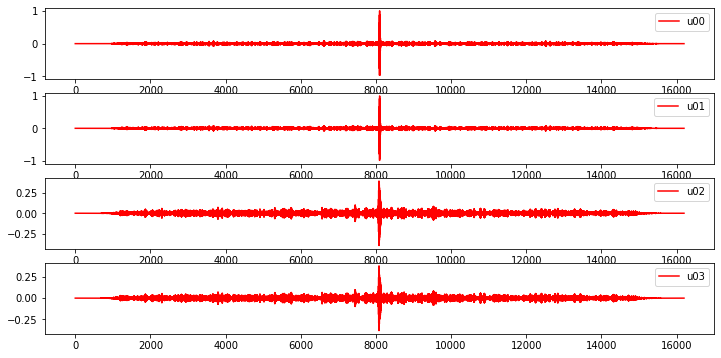

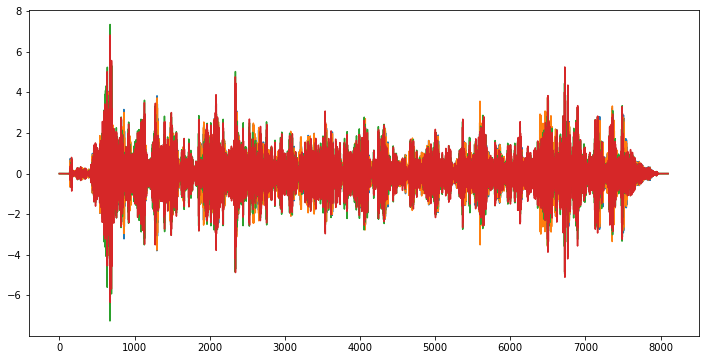

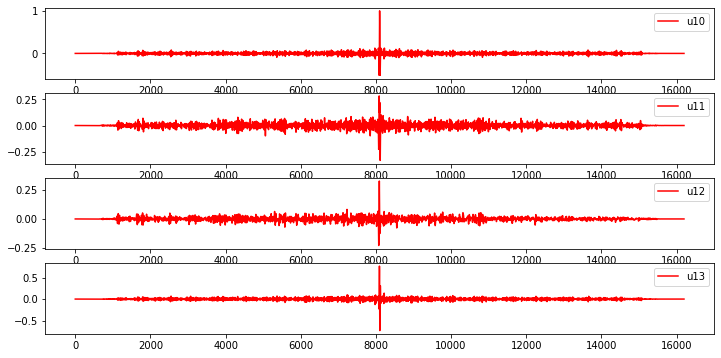

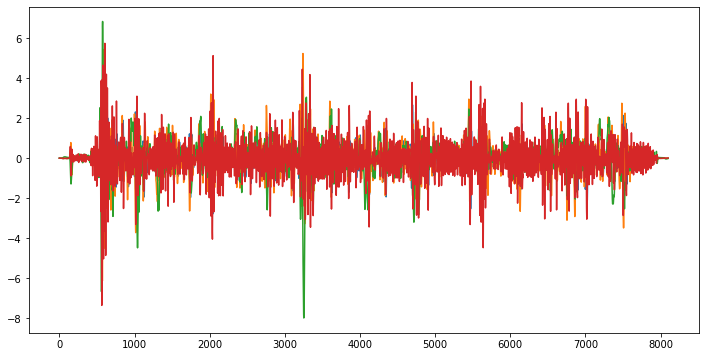

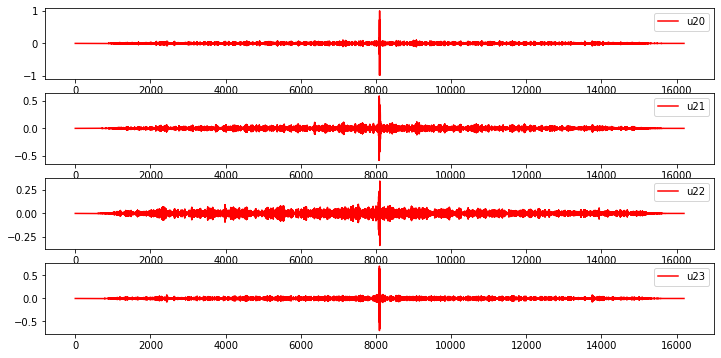

...

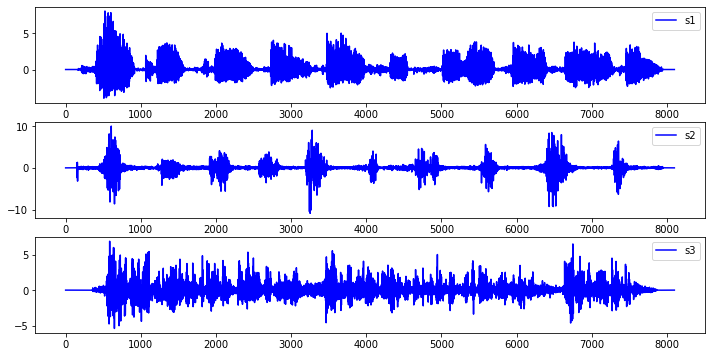

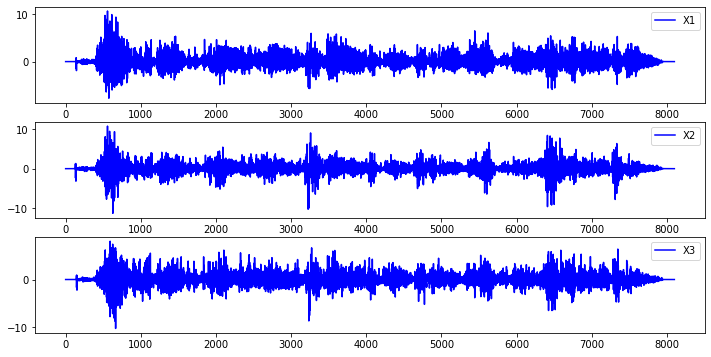

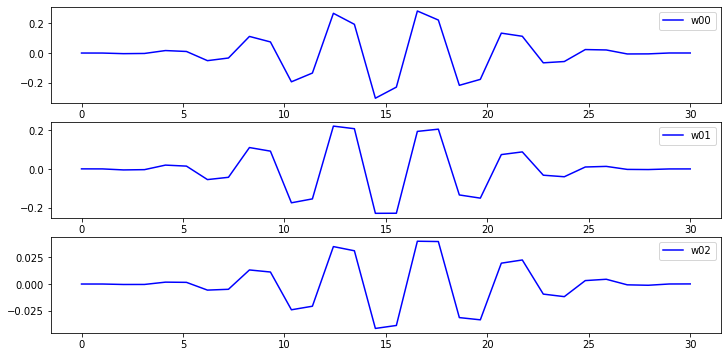

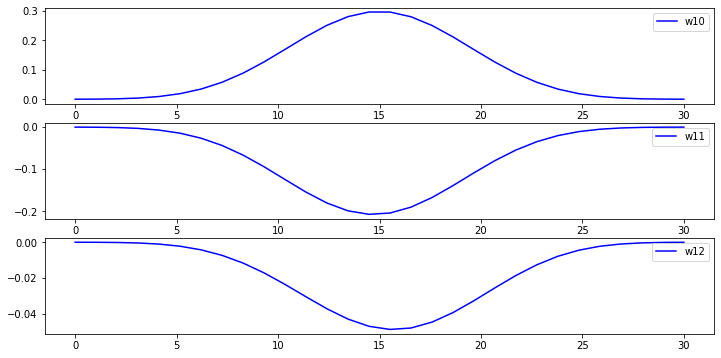

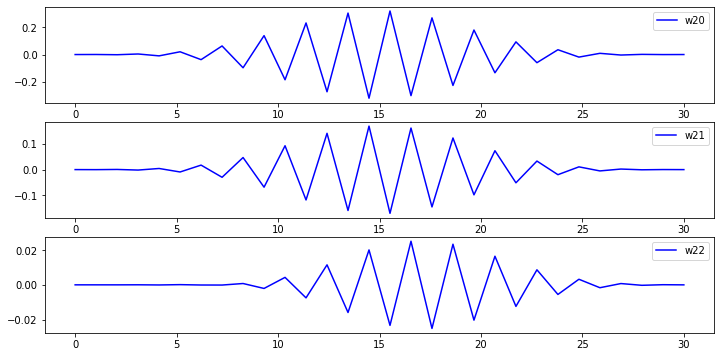

In [10]:
X =X_sim
R=200
M=30
lda1=0.0
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0

#W=TimeDelayDecorrelation4(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K,alpha=alpha)
W=decorrelation3(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()
        


In [262]:
for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))

w 0 0  max index :  1
w 0 1  max index :  24
w 0 2  max index :  17
w 1 0  max index :  1
w 1 1  max index :  24
w 1 2  max index :  21
w 2 0  max index :  1
w 2 1  max index :  11
w 2 2  max index :  13


In [6]:
#就输出波行角度来看错公式那个反而计算的比没看错的要好，这是怎么回事？----->约束增加之后产生的影响，
#但是为什么，在其他方法中增加正则没有这么大影响呢?--->但是延时就不对了。
#找到同一个波形，并且不再下降。

def decorrelation3(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    Rs =np.zeros((2*R+1,p*M,p*M),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i:i+M,j],axis=0)
        
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    #XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    
    for i in range(N):
        for l in range(2*R+1):
            Rs[l,:,:] =Rs[l,:,:]+XX[R+i,:][:,np.newaxis]@XX[R+i+l-R][np.newaxis,:]
    Rs =Rs/N
    
    
    for i in range(p):
        for j in range(p):
            W[j*M,i]=1.0
        #W[:,i] =np.random.normal(loc=0.0,scale=1.0,size=(p*M,))
        W[:,i]=W[:,i]/np.linalg.norm(W[:,i])
    W_last =np.zeros((p*M,p),dtype=float)
    Rr = XX.T@XX/N
    Rr =Rs[M,:,:]
    print('det(Rr) ',np.linalg.det(Rr))
    Rr_inv =np.linalg.inv(Rr)
    maxiters =50
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    F  =np.zeros((p*M-2,p*M),dtype=float)     #使得权向量光滑曲率小
    Z  =np.zeros((p*M-1,p*M),dtype=float)
    for i in range(p*M-1):
        Z[i,i]=1.0;Z[i,i+1]=-1.0;
    for i in range(p*M-2):
        F[i,i]=1.0;F[i,i+1]=-2.0;F[i,i+2]=1.0;
    D  =np.zeros((N+2*R-1,N+2*R),dtype=float) #使输出信号光滑  lda=10,5,似乎得到结果不错 Q=50,R=50,不白化 
                                              #d1 =5  d2 =10  d3 =15
    for i in range(N-1+2*R):
        D[i,i]=-1.0;D[i,i+1]=1.0;
    D = D@XX
    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))
        if(np.linalg.norm(W-W_last)==2.0):
            print('W ',W-W_last)
        W_last =W.copy()
        #np.random.shuffle(order)
        #W[:,:]=W[:,order]
        for i in range(p):
            B =B*0.0
            G =G*0.0
            #print('mask ',mask)
            mask[:]=True
            mask[i]=False
            
            
            """
            #公式写错了
            Y =np.square((XX@W)[:,mask])
            
            #print('Y shape ',Y.shape)
            y =np.zeros((N,),dtype=float)
            for j in range(N):
                y[j]=np.sum(Y[j:j+2*R+1,:])
            
            
            G=(np.multiply(y[:,np.newaxis],XX[R:N+R]).T)@XX[R:N+R]/N +lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            """
            
            
            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q=Q+W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            G =np.zeros((p*M,p*M),dtype=float)
            for l in range(2*R+1):
                G =G +Rs[l]@Q@Rs[2*R-l]
                print('R[',l-R,'] ',W[:,i][np.newaxis,:]@(Rs[l,:,:]@Q@Rs[2*R-l,:,:])@W[:,i][:,np.newaxis])
            G =G +lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            
            
    
            #print('G shape ',G.shape)
            #print('Rr shape ',Rr.shape)
            
            #[eig_w,eig_v] =np.linalg.eig(Rr_inv@G)    #输出信号总能量约束
            [eig_w,eig_v] =np.linalg.eig(G)            #输出权重约束

            #print('eig_v shape ',eig_v.shape)
            min_index =np.argmin(np.real(eig_w))
            #print('eig min ',eig_w[min_index])
            #print(min_index)
            #W[:,i]=W[:,i]+eta*(1.0/(1.0+k/t0))*eig_v[:,min_index]
            #W[:,i]=(alpha)*W[:,i]+(1.0-alpha)*eig_v[:,min_index]
            alpha=0
            if(np.sum(W[:,i]*eig_v[:,min_index])>0):
                W[:,i]=(alpha)*W_last[:,i]+(1.0-alpha)*eig_v[:,min_index]
            else:
                W[:,i]=(alpha)*W_last[:,i]-(1.0-alpha)*eig_v[:,min_index]
            
            
            for j in range(p*M):
                if(np.abs(W[j,i])>lda4):
                    W[j,i] =np.sign(W[j,i])*(np.abs(W[j,i]-lda4))
                else:
                    W[j,i]=0.0
            
            W[:,i]=W[:,i]/np.linalg.norm(W[:,i])
            E[k,i] =(W[:,i][np.newaxis,:]@G@W[:,i][:,np.newaxis])[0][0]
            
            if(k==(maxiters-2)):
                T=4
                index =np.argsort(eig_w)
                plt.subplots(figsize=(12,6))
                YY =XX[R:N+R]@eig_v[:,index[0:T]]
                for j in range(T):
                    plt.subplot(T,1,j+1)
                    tt =np.correlate(YY[:,j],YY[:,0],"full")/(np.linalg.norm(YY[:,0])*np.linalg.norm(YY[:,j]))
                    print('tt shape ',tt.shape)
                    plt.plot(np.linspace(0,tt.shape[0],tt.shape[0]),tt,'-r',label='u'+str(i)+str(j))
                    plt.legend()
                    print('signal corr[',0,'][',j,']',np.sum(YY[:,0]*YY[:,j])/(np.linalg.norm(YY[:,0])*np.linalg.norm(YY[:,j])))
                plt.subplots(figsize=(12,6))
                for j in range(T):
                    plt.plot(np.linspace(0,N,N),YY[:,j],label='eig_v'+str(i)+str(j))
                    print('eig corr[',0,'][',j,']',np.sum(eig_v[:,0]*eig_v[:,j]))
            
            
            print('rank(Rr_inv)@G ',np.linalg.matrix_rank(Rr_inv@G))
            print('det(Rr_inv)@G ',np.linalg.det(Rr_inv@G))
            print(np.sort(eig_w))
            
        H[k] =np.sum(E[k,:])
        

        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='E')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    for i in range(p):
        for j in range(i+1,p):
            print('w',i,'.T@G[0]@w',j,W[:,i][np.newaxis,:]@Rs[M,:,:]@W[:,j][:,np.newaxis])
            print('recover corr[',i,'][',j,']',np.sum(y[:,i]*y[:,j])/(np.linalg.norm(y[:,i])*np.linalg.norm(y[:,j])))
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@y
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    
    for m in range(20):
        W =Ws[maxiters-1-m,:,:]
        y =XX[R:N+R]@W
        plt.subplots(figsize=(12,6))
        for i in range(p):
            plt.subplot(p,1,i+1)
            plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
            plt.legend()
            
        
    
    return W

In [93]:
#变成AR-MA模型，直接求信号，而不是滤波过后的信号。---->太复杂了行不通。
def TimeDelayDecorrelation5(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0,alpha=1.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    y =np.zeros((N,p),dtype=float)
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    U  =np.zeros((N+2*R,p),dtype=float)
    UU =np.zeros((N+2*R,M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    D =np.zeros((M,p),dtype=float)
    Rs =np.zeros((2*M+1,(p+1)*M,(p+1)*M),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    
    maxiters =200
    k =-1
    tol=1e-14
    W =np.random.normal(loc=0,scale=1.0,size=(p*M,p))
    D =np.random.normal(loc=0,scale=1.0,size=(M,p))
    W_last =np.random.normal(loc=0,scale=1.0,size=(p*M,p))
    D_last =np.random.normal(loc=0,scale=1.0,size=(M,p))
    
    
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    
    while(np.linalg.norm(W-W_last)>tol or np.linalg.norm(D-D_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
            
        print('k ',k,' ',np.linalg.norm(W-W_last)+np.linalg.norm(D-D_last))
        
        W_last =W.copy()
        D_last =D.copy()
        
        
        
        #求u的值
        for i in range(N):
            U[R+i,:] = (W_last.T@XX[R+i,:][:,np.newaxis])[:,0] +np.sum(np.multiply(np.flip(U[i:R+i,:],axis=0),D_last),axis=0)
        
        #求D和W
        Wd =np.r_[D_last,W_last]
        
        for i in range(p):
            
            for j in range(N):
                UU[R+j,:] =np.flip(U[j:j+M,i],axis=0)
            
            Xs =np.c_[UU,XX]
            
            #这里是错的。弄太复杂了。
            for j in range(N):
                for l in range(2*M+1):
                    Rs[l,:,:] =Rs[l,:,:] +Xs[R+i,:][:,np.newaxis]@Xs[R+i+l-M,:][np.newaxis,:]
            Rs =Rs/N
            
            Q =np.zeros(((p+1)*M,(p+1)*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +Wd[:,j][:,np.newaxis]@Wd[:,j][np.newaxis,:]
            
            
            #Rr_inv =np.linalg.inv(Rs[M,:,:])
            G =np.zeros(((p+1)*M,(p+1)*M),dtype=float)
            for l in range(2*M+1):
                G =G +Rs[l,:,:]@Q@Rs[2*M-l,:,:]
                
            #[eig_w,eig_v] =np.linalg.eig(Rr_inv@G)    #输出信号总能量约束
            #[eig_w,eig_v] =np.linalg.eig(G)            #输出权重约束

            #print('eig_v shape ',eig_v.shape)
            min_index =np.argmin(np.real(eig_w))

            if(np.sum(Wd[:,i]*eig_v[:,min_index])>0):
                D[:,i]=eig_v[:,min_index][0:M]
                W[:,i]=eig_v[:,min_index][M:(p+1)*M]
                Wd[:,i] =eig_v[:,min_index]
            else:
                D[:,i]=-1.0*eig_v[:,min_index][0:M]
                W[:,i]=-1.0*eig_v[:,min_index][M:(p+1)*M]
                Wd[:,i] =-1.0*eig_v[:,min_index]
            
            E[k,i] =(Wd[:,i][np.newaxis,:]@G@Wd[:,i][:,np.newaxis])[0][0]
            y[:,i] =(Xs@Wd[:,i][:,np.newaxis])[R:N+R,0]
        
        H[k] =np.sum(E[k,:])
        
 
        
    E[0,:]=0.0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='H')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,D.shape[0],D.shape[0]),D[:,i],'-b',label=('d'+str(i)))
        plt.legend()
    
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    
    for i in range(p):
        for j in range(i+1,p):
            print('corr[',i,',',j,'] ',np.sum(y[:,i]*y[:,j])/(np.linalg.norm(y[:,i])*np.linalg.norm(y[:,j])))
        
    #这段代码什么意思，都忘了。
    
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@X
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    
    return W
    

k  0   38.49297304105954


/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:45: RuntimeWarning: overflow encountered in multiply
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:84: ComplexWarning: Casting complex values to real discards the imaginary part
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:86: ComplexWarning: Casting complex values to real discards the imaginary part
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in matmul
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:80: ComplexWarning: Casting complex values to real discards the imaginary part
/root/anaconda3/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:81: ComplexWarning: Casting complex values 

k  1   26.443758361668046
k  2   2.8505071850003834
k  3   1.627920246451391
k  4   2.103925757362288
k  5   0.9693214979870013
k  6   3.4563954218976383
k  7   1.5271882590510466
k  8   3.2359477559101846
k  9   3.4069685660049354
k  10   2.961090710895256
k  11   2.8646335945113437
k  12   3.060187117250371
k  13   2.325387358312714
k  14   1.8361282052934924
k  15   1.5979116172052028
k  16   1.2338425559608752
k  17   2.8199403181932174
k  18   2.730075782131465
k  19   2.7318279979246385
k  20   0.9205853374814393
k  21   1.60229032238778
k  22   3.1772130114820785
k  23   1.9982960919224795
k  24   2.7801701033683424
k  25   2.5162429121721255
k  26   2.3301366815706226
k  27   1.7929330587418242
k  28   1.5693367630642974
k  29   2.468608359551819
k  30   2.9665293011149467
k  31   1.6032630772509873
k  32   3.0044795004451776
k  33   2.2814809044944484
k  34   3.0999364031963204
k  35   2.877335228930773
k  36   2.1025534522854787
k  37   3.0873819300670373
k  38   2.5500438146

w 0 0  max index :  0
w 0 1  max index :  0
w 0 2  max index :  0
w 1 0  max index :  0
w 1 1  max index :  0
w 1 2  max index :  0
w 2 0  max index :  0
w 2 1  max index :  0
w 2 2  max index :  0


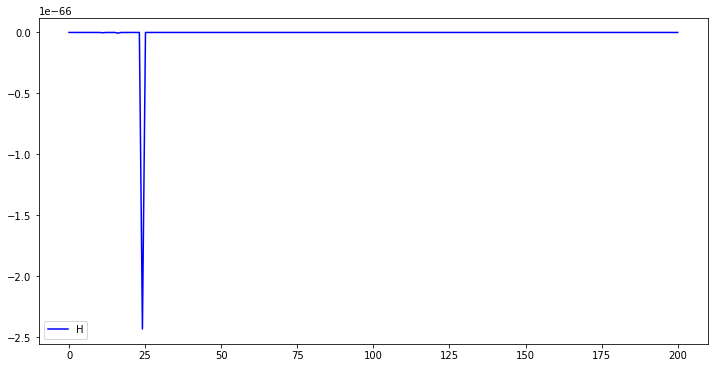

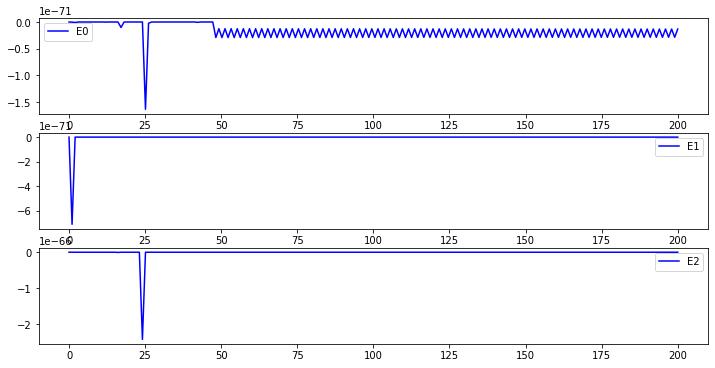

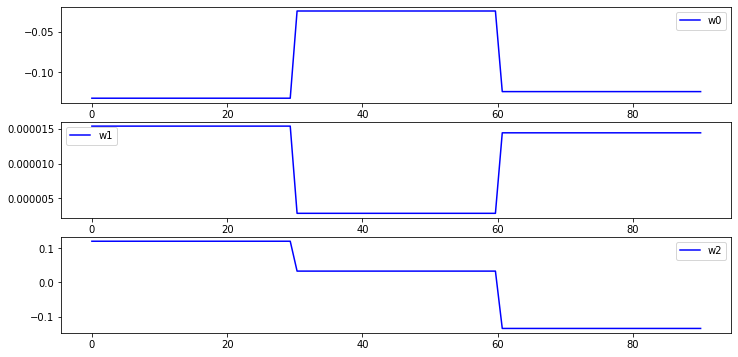

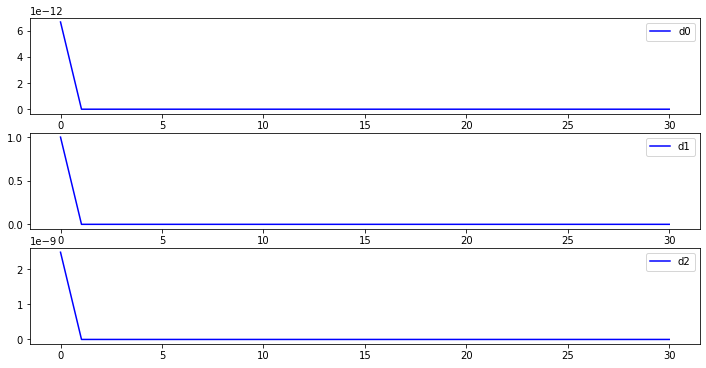

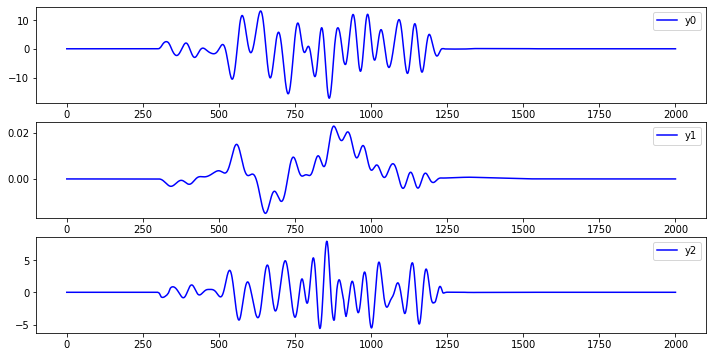

...

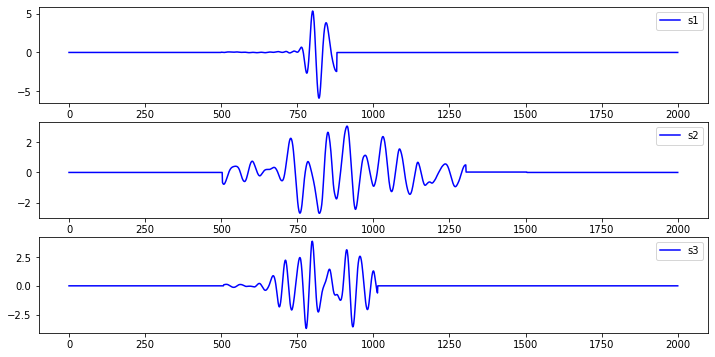

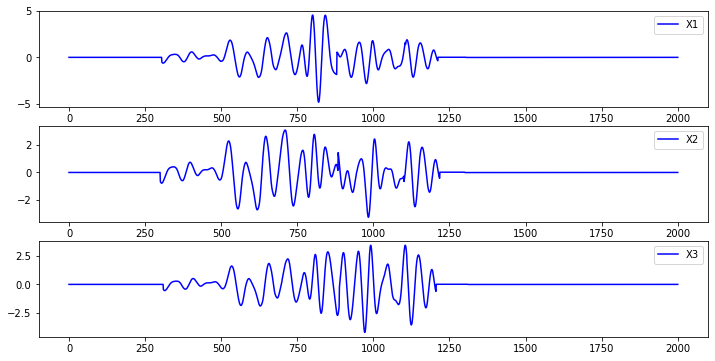

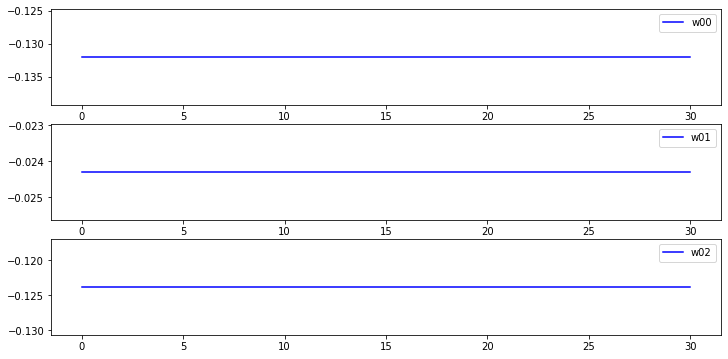

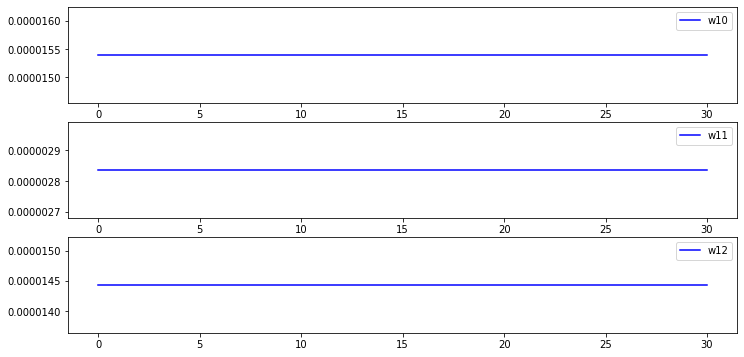

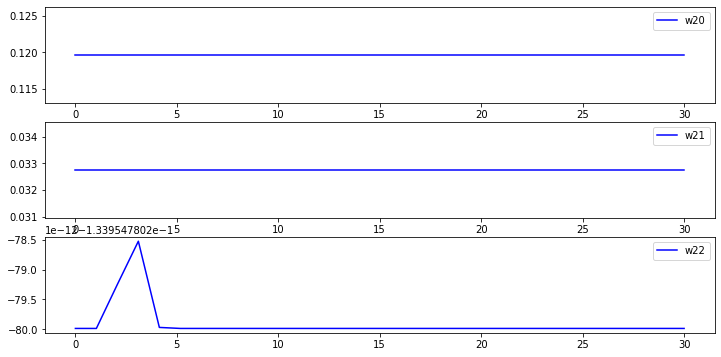

In [94]:
X =X_sim
R=30
M=30
lda1=0.01
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0
alpha=0.0
W=TimeDelayDecorrelation5(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K,alpha=alpha)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()
        
for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))

In [64]:
#增加约束，可预见性，加在原来的优化问题中。
#实际问题时，并不是优化到0的时候最好。
def TimeDelayDecorrelation6(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0,alpha=1.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    for i in range(p):
        for j in range(p):
            W[j*M,i]=1.0
        
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*M+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*M+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-M,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =50
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    H1 =np.zeros((maxiters,),dtype=float)
    E1 =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    
    F  =np.zeros((p*M-2,p*M),dtype=float)     #使得权向量光滑曲率小
    Z  =np.zeros((p*M-1,p*M),dtype=float)
    for i in range(p*M-1):
        Z[i,i]=1.0;Z[i,i+1]=-1.0;
    for i in range(p*M-2):
        F[i,i]=1.0;F[i,i+1]=-2.0;F[i,i+2]=1.0;
    D  =np.zeros((N+2*R-1,N+2*R),dtype=float) #使输出信号光滑  lda=10,5,似乎得到结果不错 Q=50,R=50,不白化 
                                              #d1 =5  d2 =10  d3 =15
    for i in range(N-1+2*R):
        D[i,i]=-1.0;D[i,i+1]=1.0;
    D = D@XX

    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()
        
        R1= R//4
        YY =XX@W_last
        Yx =np.zeros((p,N,R1),dtype=float)
        Yy =YY[R1:N+R1,:]
        for i in range(N):
            for j in range(p):
                Yx[j,i,:] =YY[i:R1+i,j]
        a =np.zeros((p,R1),dtype=float)
        for i in range(p):
            a[i,:] =(np.linalg.pinv(Yx[i,:,:])@(Yy[:,i][:,np.newaxis]))[:,0]
        
        
        Hn =np.zeros((p,p*M,p*M),dtype=float)
        for i in range(N):
            for j in range(p):
                Xy   =XX[R+i,:] -np.sum(np.multiply(XX[R-R1+i:R+i,:],a[j,:][:,np.newaxis]),axis=0)
                Hn[j,:,:] =Hn[j,:,:] + Xy[:,np.newaxis]@Xy[np.newaxis,:]
        Hn =Hn/N
        

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            G =np.zeros((p*M,p*M),dtype=float)+lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            for l in range(2*M+1):
                G =G +Rs[l,:,:]@Q@Rs[2*M-l,:,:]
            
            G =G+lda1*D.T@D+lda2*F.T@F+lda3*Z.T@Z
            print('norm(G-G.T) ',np.linalg.norm(G-G.T))  #是对称矩阵
            
            ww =np.zeros((p*M,1),dtype=float)
            ww[0,0]=1.0
            
            Gn =np.zeros((p*M,p*M),dtype=float)
            index12=0
            index21=0
            index22=0
            
            for m in range(p):
                for n in range(p):
                    if(m==i and n==i):
                        Gn[0:M,0:M] =G[m*M:(m+1)*M,n*M:(n+1)*M]
                    elif(m==i and n!=i):
                        c =index12%(p-1)
                        Gn[0:M,(c+1)*M:(c+2)*M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index12 =index12+1
                    elif(m!=i and n==i):
                        r =index21%(p-1)
                        Gn[(r+1)*M:(r+2)*M,0:M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index21 =index21+1
                    else:
                        r =index22//(p-1)
                        c =index22%(p-1)
                        Gn[(r+1)*M:(r+2)*M,(c+1)*M:(c+2)*M]=G[m*M:(m+1)*M,n*M:(n+1)*M]
                        index22 =index22+1
            
            G11=Gn[0,0];         H11=10*Hn[i,0,0];
            G12=Gn[0,1:p*M];     H12=10*Hn[i,0,1:p*M];
            G21=Gn[1:p*M,0];     H21=10*Hn[i,1:p*M,0];  
            G22=Gn[1:p*M,1:p*M]; H22=10*Hn[i,1:p*M,1:p*M]
            
            
            """
            ww_last =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            ww_last[0,0]=1.0
            tol =1e-5
            eps =1e-16
            eta =0.0005  #学习率设置问题，太大太小，影响收敛
            b=0
            b0 =40
            mu =0.5*np.eye(p*M-1)
            while(np.linalg.norm(ww-ww_last)>tol):
                b =b +1
                print('norm(w-w_last) ',np.linalg.norm(ww-ww_last))
                ww_last[1:p*M,0]=ww[1:p*M,0].copy()
                dww =2*G21+(2*G22@(ww_last[1:p*M]))[:,0]+2*alpha*(np.linalg.norm(ww_last[1:p*M,0],ord=1)-1.0)*\
                (ww_last[1:p*M,0]/(eps+abs(ww_last[1:p*M,0])))
                ww[1:p*M,0] =ww_last[1:p*M,0]-eta*(1.0/(1+b/b0))*dww
                dww
            print('ww ',ww)
            """
            
                
                
            
            ww[1:p*M,0] =(-1.0*np.linalg.inv(G22+H22)@((G21+H21)[:,np.newaxis]))[:,0]
            index0 =0
            
            for j in range(p):
                if(j==i):
                    W[i*M:(i+1)*M,i]=ww[0:M,0]*1.0
                else:
                    W[j*M:(j+1)*M,i]=ww[(index0+1)*M:(index0+2)*M,0]*1.0
                    index0 =index0+1
            
                
                    
                        
            
            
          
            
        
            E[k,i] =(W[:,i][np.newaxis,:]@G@W[:,i][:,np.newaxis])[0][0]
            E1[k,i] =(W[:,i][np.newaxis,:]@Hn[i,:,:]@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        H1[k] =np.sum(E1[k,:])
        
        for j in range(p):
            E[k,j]=np.linalg.norm(W[:,j]-W_last[:,j])
        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='err1')
    plt.plot(np.linspace(0,maxiters,maxiters),H1,'-r',label='err2')
    plt.legend()
    
    
    E[0,:]=0
    H[0]=0
    
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='E')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@y
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    
    
    
        
    
    return W

before rank(XX)  180
after  rank(XX)  180
k  0   3.0
norm(G-G.T)  1.2988090209904443e-13
norm(G-G.T)  1.7843873893813137e-13
norm(G-G.T)  1.7261510321172136e-13
H  192.7028609487002
E  [2.86640018 1.4851205  1.40376103]
k  1   3.520280942640048
norm(G-G.T)  1.3546725379676195e-13
norm(G-G.T)  1.321849048121313e-13
norm(G-G.T)  1.366492388226496e-13
H  140.9048047098718
E  [2.29045861 0.1296654  0.04120939]
k  2   2.294496015916559
norm(G-G.T)  1.329377954844064e-13
norm(G-G.T)  1.3160857739406334e-13
norm(G-G.T)  1.3305177541704745e-13
H  140.8635237857062
E  [0.22350162 0.02310414 0.00427223]
k  3   0.22473323527371245
norm(G-G.T)  1.3400775732884296e-13
norm(G-G.T)  1.3127309718322792e-13
norm(G-G.T)  1.3436782531629722e-13
H  140.84419802538574
E  [0.08016027 0.00890473 0.00176173]
k  4   0.08067259052851004
norm(G-G.T)  1.3282028377999178e-13
norm(G-G.T)  1.3401022020384394e-13
norm(G-G.T)  1.3225302143371449e-13
H  140.84032457182172
E  [0.02299455 0.00261092 0.00056544]
k  5   0.

norm(G-G.T)  1.3509513084628438e-13
norm(G-G.T)  1.3297905716979838e-13
norm(G-G.T)  1.3313594682094766e-13
H  140.83947902501302
E  [4.47773298e-14 2.11891974e-15 5.29708398e-16]
k  41   4.4830566270933144e-14
norm(G-G.T)  1.3579743470332108e-13
norm(G-G.T)  1.3245615985532216e-13
norm(G-G.T)  1.3271211788413977e-13
H  140.83947902501302
E  [2.62645980e-14 1.43585682e-15 3.29314682e-16]
k  42   2.6305878427117167e-14
norm(G-G.T)  1.3530216286086027e-13
norm(G-G.T)  1.32325308095231e-13
norm(G-G.T)  1.321672459267217e-13
H  140.83947902501302
E  [1.56211494e-14 7.13761509e-16 2.63453060e-16]
k  43   1.563966658725308e-14
norm(G-G.T)  1.353281595966272e-13
norm(G-G.T)  1.3147860855842366e-13
norm(G-G.T)  1.3327983575364835e-13
H  140.83947902501302
E  [1.04339049e-14 5.95633554e-16 1.62752616e-16]
k  44   1.0452159557170116e-14
norm(G-G.T)  1.357553802902209e-13
norm(G-G.T)  1.3220858752410978e-13
norm(G-G.T)  1.325898009552794e-13
H  140.83947902501302
E  [5.89364818e-15 6.44257462e-16

w 0 0  max index :  0
w 0 1  max index :  26
w 0 2  max index :  18
w 1 0  max index :  59
w 1 1  max index :  0
w 1 2  max index :  14
w 2 0  max index :  55
w 2 1  max index :  59
w 2 2  max index :  0


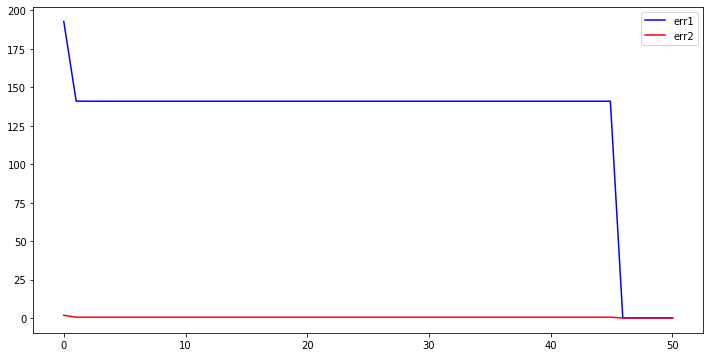

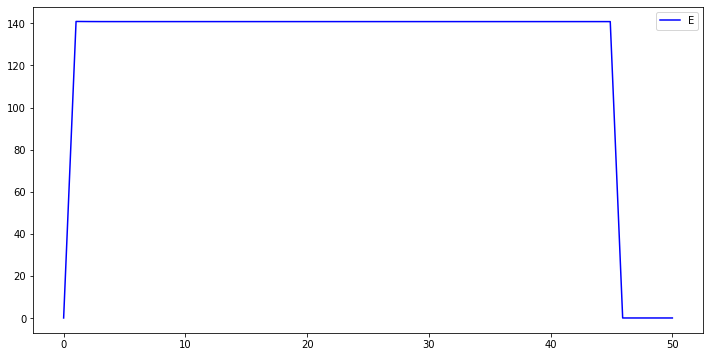

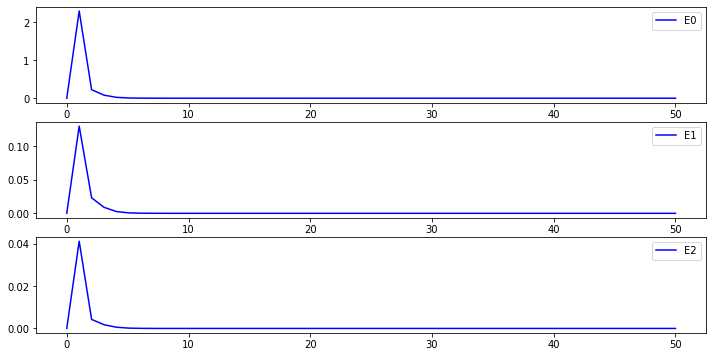

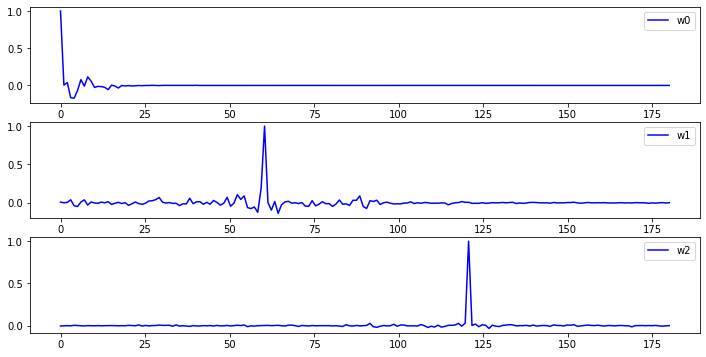

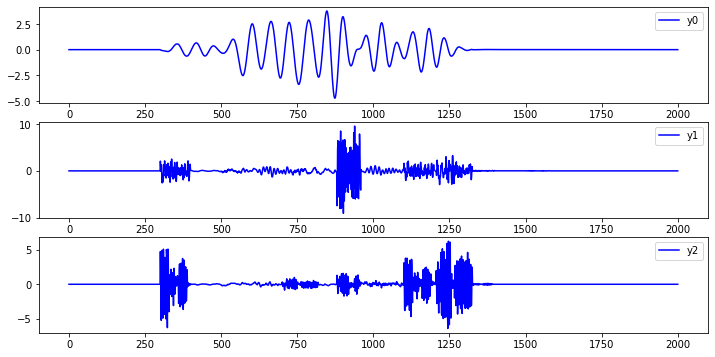

...

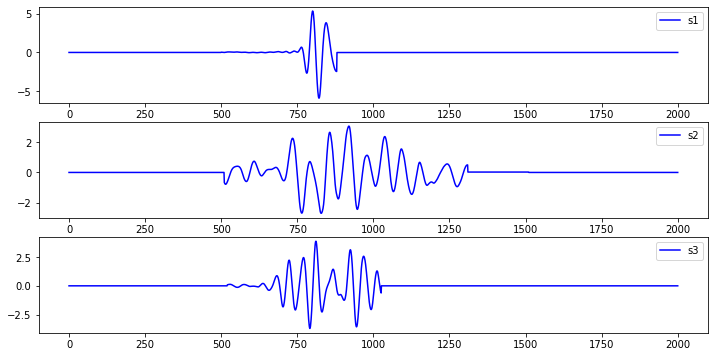

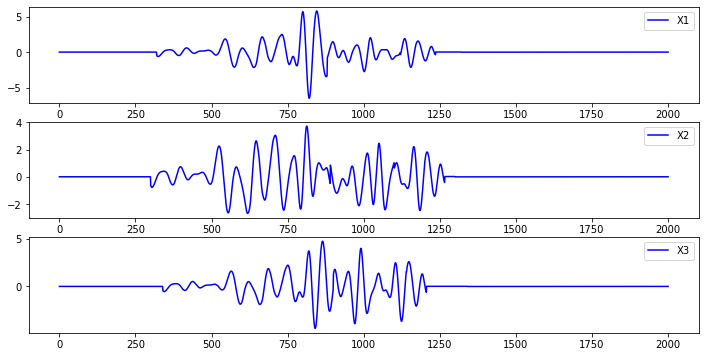

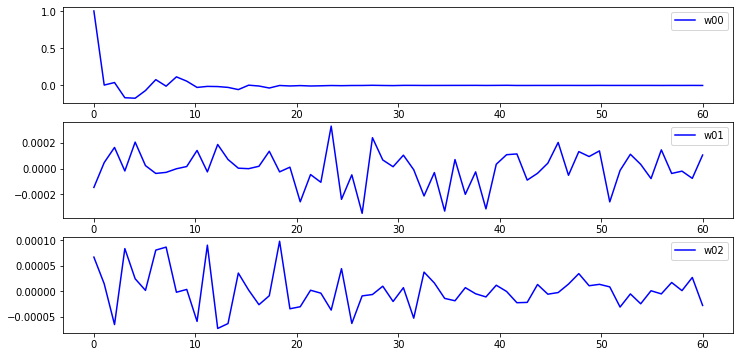

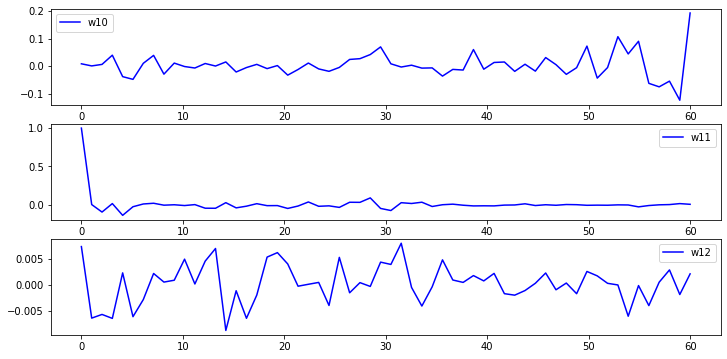

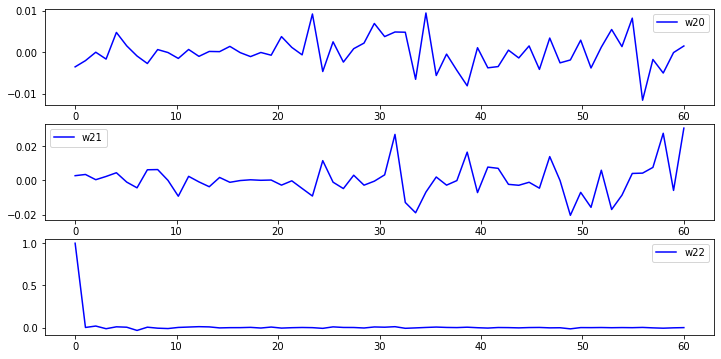

In [65]:
X =X_sim
R=60
M=60
lda1=0.01
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0
alpha=1.0
W=TimeDelayDecorrelation6(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K,alpha=alpha)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()

for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))

In [192]:
#是可以严格保证稀疏，但是波形生成的还是一样这里怎么弄？
def TimeDelayDecorrelation7(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0,alpha=1.0,l1_norm=2.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    XX_n =np.zeros((N+2*R,p*M),dtype=float)
    XX_n[R,:] =XX[R,:]
    W =np.zeros((p*M,p),dtype=float)
    lbd =0.9
    for i in range(N):
        XX_n[R+i,:] =lbd*XX_n[R+i-1,:] +(1-lbd)*XX[R+i-1,:]
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    
    XX_n =XX_n -XX
    U =(XX_n[R:N+R,:].T@XX_n[R:N+R,:])/N
    print('U shape ',U.shape)
    for i in range(p):
        for j in range(p):
            if(j==i):
                W[j*M,i]=1.0
    W =np.random.normal(loc=0,scale=1.0,size=(p*M,p))    
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*R+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*R+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-R,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =500
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    
    F  =np.zeros((p*M-2,p*M),dtype=float)     #使得权向量光滑曲率小
    Z  =np.zeros((p*M-1,p*M),dtype=float)
    for i in range(p*M-1):
        Z[i,i]=1.0;Z[i,i+1]=-1.0;
    for i in range(p*M-2):
        F[i,i]=1.0;F[i,i+1]=-2.0;F[i,i+2]=1.0;
    
    #D可以修改
    D  =np.zeros((N+2*R-1,N+2*R),dtype=float) #使输出信号光滑  lda=10,5,似乎得到结果不错 Q=50,R=50,不白化 
                                              #d1 =5  d2 =10  d3 =15
    for i in range(N-1+2*R):
        D[i,i]=-1.0;D[i,i+1]=1.0;
    D = D@XX

    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            G =np.zeros((2*R+1,p*M,p*M),dtype=float)
            for l in range(2*R+1):
                G[l,:,:] =Rs[l,:,:]@Q@Rs[2*R-l,:,:]
                print('R[',l-R,'] ',W[:,i][np.newaxis,:]@G[l,:,:]@W[:,i][:,np.newaxis])
            
                        
            b_max =100
            b0 =0
            tol2 =1e-15
            eps =1e-16
            f =np.zeros((2*R+1+p,1),dtype=float)
            J =np.zeros((2*R+1+p,p*M),dtype=float)
            f_new =np.zeros((2*R+1+p,1),dtype=float)
            J_new =np.zeros((2*R+1+p,p*M),dtype=float)
            ep =np.random.normal(loc=0,scale=1.0,size=(2*R+1+p,1))
            g  =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            dir_xk =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            mu =2
            u=0
            tau =0.001
            xk =(W[:,i][:,np.newaxis]).copy()
            I =np.eye(p*M)
            
            for l in range(2*R+1):
                f[l,0]=(xk.T@G[l,:,:]@xk)[0][0]
                J[l,:] =((G[l,:,:]+G[l,:,:].T)@xk)[:,0]
            for j in range(p):
                f[2*R+1+j,0] =alpha*(np.linalg.norm(xk[j*M:(j+1)*M,0],ord=1)-(l1_norm))
                J[2*R+1+j,j*M:(j+1)*M] =alpha*(xk[j*M:(j+1)*M,0]/(eps+np.abs(xk[j*M:(j+1)*M,0])))
            #print('f shape ',f.shape)
            #print(2*R+1+p)
            #f[2*R+1+p,0]=beta*(xk.T@U@xk)[0][0]
            #J[2*R+1+p,:]=beta*((U+U.T)@xk)[:,0]
            ep =-1.0*f
            g =J.T@ep
            A =J.T@J
            u =tau*np.max(np.diag(A))
            
            while(b0<b_max):
                if(np.max(np.abs(g))<tol2 or np.max(np.abs(dir_xk))<tol2):
                    break
                if(np.max(np.abs(g))<tol2 or np.sum(np.square(ep))<tol2):
                    break
                b0 =b0+1
                while(1):
                    dir_xk =np.linalg.pinv(A+u*I)@g
                    if(np.max(np.abs(dir_xk))<tol2):
                        break
                    else:
                        xk_new =xk+dir_xk
                        for l in range(2*R+1):
                            f_new[l,0]=(xk_new.T@G[l,:,:]@xk_new)[0][0]
                            J_new[l,:] =((G[l,:,:]+G[l,:,:].T)@xk_new)[:,0]
                        for j in range(p):
                            f_new[2*R+1+j,0] =alpha*(np.linalg.norm(xk_new[j*M:(j+1)*M,0],ord=1)-(l1_norm))
                            J_new[2*R+1+j,j*M:(j+1)*M] =alpha*(xk_new[j*M:(j+1)*M,0]/(eps+np.abs(xk_new[j*M:(j+1)*M,0])))
                        
                        #f_new[2*R+1+p,0]=beta*(xk_new.T@U@xk_new)[0][0]
                        #J_new[2*R+1+p,:]=beta*((U+U.T)@xk_new)[:,0]
                        ep_new =-1.0*f_new
                        rou =(np.sum(np.square(ep))-np.sum(np.square(ep_new)))/((dir_xk.T@(u*dir_xk+g))[0][0])
                        if(rou>0):
                            xk =xk_new
                            A =J_new.T@J_new
                            ep =ep_new
                            g =J_new.T@ep

                            u =u*max(1.0/3,1-np.power((2*rou-1),3))
                            mu =2
                            if(np.max(np.abs(g))<tol2 or np.sum(np.square(ep))<tol2):
                                break
                        else:
                            u =mu*u
                            mu =2*mu
                    
                    if(rou>0):
                        break
            W[:,i]=xk[:,0]
            for j in range(p):
                print('w',j,i,' l1: ',np.linalg.norm(W[j*M:(j+1)*M,i],ord=1))
                        
                        
                    
                
                
                
                
                
                
            E[k,i] =(W[:,i][np.newaxis,:]@(np.sum(G,axis=0))@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        

        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0.0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='H')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    #print('w.T@R0@w ',np.square(np.mean(y[:,0]*y[:,1]))+np.square(np.mean(y[:,0]*y[:,2])))
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    
    for i in range(p):
        for j in range(i+1,p):
            print('corr[',i,',',j,'] ',np.sum(y[:,i]*y[:,j])/(np.linalg.norm(y[:,i])*np.linalg.norm(y[:,j])))
        
    #这段代码什么意思，都忘了。
    
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@X
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    

    
        
    
    return W

In [9]:
X =X_sim
R=200
M=28
lda1=0.00
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0
alpha=0.002

l1_norm =1.0
W=TimeDelayDecorrelation7(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K,alpha=alpha,l1_norm=l1_norm)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()

for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))

NameError: name 'TimeDelayDecorrelation7' is not defined

In [189]:
def TimeDelayDecorrelation8(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0,alpha=1.0,l1_norm=2.0):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    XX_n =np.zeros((N+2*R,p*M),dtype=float)
    XX_n[R,:] =XX[R,:]
    W =np.zeros((p*M,p),dtype=float)
    lbd =0.9
    for i in range(N):
        XX_n[R+i,:] =lbd*XX_n[R+i-1,:] +(1-lbd)*XX[R+i-1,:]
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    #XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    
    XX_n =XX_n -XX
    U =(XX_n[R:N+R,:].T@XX_n[R:N+R,:])/N
    print('U shape ',U.shape)
    for i in range(p):
        for j in range(p):
            if(j==i):
                W[j*M,i]=1.0
    W =np.random.normal(loc=0,scale=1.0,size=(p*M,p))    
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*R+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*R+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-R,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =500
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    
    F  =np.zeros((p*M-2,p*M),dtype=float)     #使得权向量光滑曲率小
    Z  =np.zeros((p*M-1,p*M),dtype=float)
    for i in range(p*M-1):
        Z[i,i]=1.0;Z[i,i+1]=-1.0;
    for i in range(p*M-2):
        F[i,i]=1.0;F[i,i+1]=-2.0;F[i,i+2]=1.0;
    
    #D可以修改
    D  =np.zeros((N+2*R-1,N+2*R),dtype=float) #使输出信号光滑  lda=10,5,似乎得到结果不错 Q=50,R=50,不白化 
                                              #d1 =5  d2 =10  d3 =15
    for i in range(N-1+2*R):
        D[i,i]=-1.0;D[i,i+1]=1.0;
    D = D@XX

    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            G =np.zeros((2*R+1,p*M,p*M),dtype=float)
            for l in range(2*R+1):
                G[l,:,:] =Rs[l,:,:]@Q@Rs[2*R-l,:,:]
                print('R[',l-R,'] ',W[:,i][np.newaxis,:]@G[l,:,:]@W[:,i][:,np.newaxis])
            
                        
            b_max =100
            b0 =0
            tol2 =1e-15
            eps =1e-16
            f =np.zeros((2*R+1+1,1),dtype=float)
            J =np.zeros((2*R+1+1,p*M),dtype=float)
            f_new =np.zeros((2*R+1+1,1),dtype=float)
            J_new =np.zeros((2*R+1+1,p*M),dtype=float)
            ep =np.random.normal(loc=0,scale=1.0,size=(2*R+1+1,1))
            g  =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            dir_xk =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            mu =2
            u=0
            tau =0.001
            xk =(W[:,i][:,np.newaxis]).copy()
            I =np.eye(p*M)
            
            for l in range(2*R+1):
                f[l,0]=(xk.T@G[l,:,:]@xk)[0][0]
                J[l,:] =((G[l,:,:]+G[l,:,:].T)@xk)[:,0]
            
            f[2*R+1,0] =alpha*(np.square(np.linalg.norm(xk[:,0],ord=1))-(l1_norm))
            J[2*R+1,:] =2*alpha*(np.linalg.norm(xk[:,0],ord=1))*(xk[:,0]/(eps+np.abs(xk[:,0])))
            #print('f shape ',f.shape)
            #print(2*R+1+p)
            #f[2*R+1+p,0]=beta*(xk.T@U@xk)[0][0]
            #J[2*R+1+p,:]=beta*((U+U.T)@xk)[:,0]
            ep =-1.0*f
            g =J.T@ep
            A =J.T@J
            u =tau*np.max(np.diag(A))
            
            while(b0<b_max):
                if(np.max(np.abs(g))<tol2 or np.max(np.abs(dir_xk))<tol2):
                    break
                if(np.max(np.abs(g))<tol2 or np.sum(np.square(ep))<tol2):
                    break
                b0 =b0+1
                while(1):
                    dir_xk =np.linalg.pinv(A+u*I)@g
                    if(np.max(np.abs(dir_xk))<tol2):
                        break
                    else:
                        xk_new =xk+dir_xk
                        for l in range(2*R+1):
                            f_new[l,0]=(xk_new.T@G[l,:,:]@xk_new)[0][0]
                            J_new[l,:] =((G[l,:,:]+G[l,:,:].T)@xk_new)[:,0]
                        
                        f_new[2*R+1,0] =alpha*(np.square(np.linalg.norm(xk_new[:,0],ord=1))-(l1_norm))
                        J_new[2*R+1,:] =2*alpha*(np.linalg.norm(xk_new[:,0],ord=1))*(xk_new[:,0]/(eps+np.abs(xk_new[:,0])))
                        
                        #f_new[2*R+1+p,0]=beta*(xk_new.T@U@xk_new)[0][0]
                        #J_new[2*R+1+p,:]=beta*((U+U.T)@xk_new)[:,0]
                        ep_new =-1.0*f_new
                        rou =(np.sum(np.square(ep))-np.sum(np.square(ep_new)))/((dir_xk.T@(u*dir_xk+g))[0][0])
                        if(rou>0):
                            xk =xk_new
                            A =J_new.T@J_new
                            ep =ep_new
                            g =J_new.T@ep

                            u =u*max(1.0/3,1-np.power((2*rou-1),3))
                            mu =2
                            if(np.max(np.abs(g))<tol2 or np.sum(np.square(ep))<tol2):
                                break
                        else:
                            u =mu*u
                            mu =2*mu
                    
                    if(rou>0):
                        break
            W[:,i]=xk[:,0]
            for j in range(p):
                print('w',j,i,' l1: ',np.linalg.norm(W[j*M:(j+1)*M,i],ord=1))
                        
                        
                    
                
                
                
                
                
                
            E[k,i] =(W[:,i][np.newaxis,:]@(np.sum(G,axis=0))@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        

        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0.0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='H')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    #print('w.T@R0@w ',np.square(np.mean(y[:,0]*y[:,1]))+np.square(np.mean(y[:,0]*y[:,2])))
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    
    for i in range(p):
        for j in range(i+1,p):
            print('corr[',i,',',j,'] ',np.sum(y[:,i]*y[:,j])/(np.linalg.norm(y[:,i])*np.linalg.norm(y[:,j])))
        
    #这段代码什么意思，都忘了。
    
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@X
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    

    
        
    
    return W


In [228]:
X =X_sim
R=200
M=100
lda1=0.00
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0
alpha=0.001

l1_norm =1.0
W=TimeDelayDecorrelation8(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K,alpha=alpha,l1_norm=l1_norm)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()

for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))

before rank(XX)  300
after  rank(XX)  300
U shape  (300, 300)
k  0   29.3651024150838
R[ -200 ]  [[43.06019728]]
R[ -199 ]  [[14.20952786]]
R[ -198 ]  [[109.12227868]]
R[ -197 ]  [[29.20648351]]
R[ -196 ]  [[7.69698242]]
R[ -195 ]  [[68.95330158]]
R[ -194 ]  [[151.11600292]]
R[ -193 ]  [[160.95711247]]
R[ -192 ]  [[20.29696111]]
R[ -191 ]  [[14.80338227]]
R[ -190 ]  [[5.49987409]]
R[ -189 ]  [[5.26533814]]
R[ -188 ]  [[84.5094276]]
R[ -187 ]  [[35.79183741]]
R[ -186 ]  [[34.3832198]]
R[ -185 ]  [[27.32062194]]
R[ -184 ]  [[47.62240755]]
R[ -183 ]  [[8.14471802]]
R[ -182 ]  [[8.07711783]]
R[ -181 ]  [[55.87121644]]
R[ -180 ]  [[2.62140527]]
R[ -179 ]  [[28.988729]]
R[ -178 ]  [[20.92220471]]
R[ -177 ]  [[9.46069898]]
R[ -176 ]  [[33.65151753]]
R[ -175 ]  [[0.54045495]]
R[ -174 ]  [[9.16522307]]
R[ -173 ]  [[80.17954372]]
R[ -172 ]  [[90.47611223]]
R[ -171 ]  [[52.37776431]]
R[ -170 ]  [[84.44732656]]
R[ -169 ]  [[41.5392217]]
R[ -168 ]  [[38.20255723]]
R[ -167 ]  [[72.54199569]]
R[ -166

R[ 127 ]  [[26.76788408]]
R[ 128 ]  [[2.10060706]]
R[ 129 ]  [[3.18957329]]
R[ 130 ]  [[50.28868181]]
R[ 131 ]  [[26.0890129]]
R[ 132 ]  [[8.9629909]]
R[ 133 ]  [[16.49798915]]
R[ 134 ]  [[14.53068721]]
R[ 135 ]  [[2.87569205]]
R[ 136 ]  [[1.13170345]]
R[ 137 ]  [[44.75816789]]
R[ 138 ]  [[2.21980791]]
R[ 139 ]  [[6.69550975]]
R[ 140 ]  [[11.27575787]]
R[ 141 ]  [[2.75820999]]
R[ 142 ]  [[4.08186555]]
R[ 143 ]  [[24.20164331]]
R[ 144 ]  [[65.65949709]]
R[ 145 ]  [[85.24147553]]
R[ 146 ]  [[17.35524103]]
R[ 147 ]  [[24.00666716]]
R[ 148 ]  [[6.27948771]]
R[ 149 ]  [[22.23500275]]
R[ 150 ]  [[20.51493325]]
R[ 151 ]  [[1.80627596]]
R[ 152 ]  [[50.51971945]]
R[ 153 ]  [[3.66686646]]
R[ 154 ]  [[6.8630923]]
R[ 155 ]  [[25.13715046]]
R[ 156 ]  [[5.93118325]]
R[ 157 ]  [[13.61279526]]
R[ 158 ]  [[7.37038742]]
R[ 159 ]  [[20.22032105]]
R[ 160 ]  [[15.0412673]]
R[ 161 ]  [[6.37756228]]
R[ 162 ]  [[2.62055285]]
R[ 163 ]  [[3.07273596]]
R[ 164 ]  [[5.04963733]]
R[ 165 ]  [[14.05433865]]
R[ 166 ] 

R[ 55 ]  [[186.7449723]]
R[ 56 ]  [[100.28170206]]
R[ 57 ]  [[323.37876592]]
R[ 58 ]  [[353.33496628]]
R[ 59 ]  [[15.3858318]]
R[ 60 ]  [[916.84163536]]
R[ 61 ]  [[84.8227649]]
R[ 62 ]  [[6.31755411]]
R[ 63 ]  [[282.9567247]]
R[ 64 ]  [[501.96774464]]
R[ 65 ]  [[1096.62803976]]
R[ 66 ]  [[259.66231529]]
R[ 67 ]  [[69.18797555]]
R[ 68 ]  [[70.61263746]]
R[ 69 ]  [[363.83948992]]
R[ 70 ]  [[94.32116353]]
R[ 71 ]  [[123.41114508]]
R[ 72 ]  [[38.21054789]]
R[ 73 ]  [[33.17456727]]
R[ 74 ]  [[90.30527452]]
R[ 75 ]  [[604.27964118]]
R[ 76 ]  [[46.59607212]]
R[ 77 ]  [[551.00101976]]
R[ 78 ]  [[303.6333332]]
R[ 79 ]  [[14.98132571]]
R[ 80 ]  [[84.50752135]]
R[ 81 ]  [[2.42919926]]
R[ 82 ]  [[411.48368345]]
R[ 83 ]  [[205.81926098]]
R[ 84 ]  [[17.90889168]]
R[ 85 ]  [[68.62806141]]
R[ 86 ]  [[8.32522532]]
R[ 87 ]  [[0.43284099]]
R[ 88 ]  [[28.02788778]]
R[ 89 ]  [[101.31856082]]
R[ 90 ]  [[399.3095415]]
R[ 91 ]  [[0.19637092]]
R[ 92 ]  [[136.00577794]]
R[ 93 ]  [[112.42153003]]
R[ 94 ]  [[116.

R[ -25 ]  [[7.04156687e-05]]
R[ -24 ]  [[0.00633298]]
R[ -23 ]  [[0.00222588]]
R[ -22 ]  [[0.00360924]]
R[ -21 ]  [[0.00101297]]
R[ -20 ]  [[0.00098798]]
R[ -19 ]  [[0.00311834]]
R[ -18 ]  [[0.0028358]]
R[ -17 ]  [[0.00384154]]
R[ -16 ]  [[0.00234501]]
R[ -15 ]  [[0.00147355]]
R[ -14 ]  [[0.00295491]]
R[ -13 ]  [[0.00265485]]
R[ -12 ]  [[0.00210839]]
R[ -11 ]  [[0.00474639]]
R[ -10 ]  [[0.00118692]]
R[ -9 ]  [[0.00057051]]
R[ -8 ]  [[0.00078239]]
R[ -7 ]  [[0.00029122]]
R[ -6 ]  [[0.00640567]]
R[ -5 ]  [[0.00107115]]
R[ -4 ]  [[0.00121624]]
R[ -3 ]  [[0.00014992]]
R[ -2 ]  [[8.65461625e-05]]
R[ -1 ]  [[0.00049109]]
R[ 0 ]  [[0.00019363]]
R[ 1 ]  [[0.00135616]]
R[ 2 ]  [[0.00010785]]
R[ 3 ]  [[0.00389288]]
R[ 4 ]  [[0.00063259]]
R[ 5 ]  [[0.00307306]]
R[ 6 ]  [[0.00030195]]
R[ 7 ]  [[0.00254296]]
R[ 8 ]  [[0.00461573]]
R[ 9 ]  [[0.00228848]]
R[ 10 ]  [[2.53915625e-05]]
R[ 11 ]  [[0.00013865]]
R[ 12 ]  [[0.00084057]]
R[ 13 ]  [[0.00633542]]
R[ 14 ]  [[0.00091806]]
R[ 15 ]  [[0.00163206]]

R[ -108 ]  [[3.35716013e-07]]
R[ -107 ]  [[2.7494886e-06]]
R[ -106 ]  [[7.13140733e-07]]
R[ -105 ]  [[9.03122364e-07]]
R[ -104 ]  [[2.91420963e-08]]
R[ -103 ]  [[8.25528345e-08]]
R[ -102 ]  [[2.28800701e-06]]
R[ -101 ]  [[6.71201878e-08]]
R[ -100 ]  [[1.78642436e-06]]
R[ -99 ]  [[1.98302417e-06]]
R[ -98 ]  [[5.41518465e-07]]
R[ -97 ]  [[3.40537152e-07]]
R[ -96 ]  [[2.97522482e-07]]
R[ -95 ]  [[5.99196511e-07]]
R[ -94 ]  [[1.21464061e-07]]
R[ -93 ]  [[9.12708237e-07]]
R[ -92 ]  [[3.18261419e-06]]
R[ -91 ]  [[6.6454246e-07]]
R[ -90 ]  [[7.26328614e-07]]
R[ -89 ]  [[1.24075703e-07]]
R[ -88 ]  [[4.80251019e-08]]
R[ -87 ]  [[5.08281146e-07]]
R[ -86 ]  [[7.64439436e-07]]
R[ -85 ]  [[6.12658512e-07]]
R[ -84 ]  [[2.28124024e-06]]
R[ -83 ]  [[1.38651221e-06]]
R[ -82 ]  [[7.63675453e-09]]
R[ -81 ]  [[9.04482977e-07]]
R[ -80 ]  [[8.84552902e-07]]
R[ -79 ]  [[7.42463688e-07]]
R[ -78 ]  [[2.14570387e-08]]
R[ -77 ]  [[5.22363279e-06]]
R[ -76 ]  [[5.92229034e-09]]
R[ -75 ]  [[1.54038342e-06]]
R[ -74 

w 0 0  l1:  0.3788532232369434
w 1 0  l1:  0.3150571443959971
w 2 0  l1:  0.3060896311299764
R[ -200 ]  [[2.01509256e-05]]
R[ -199 ]  [[2.85374197e-05]]
R[ -198 ]  [[5.1694068e-06]]
R[ -197 ]  [[5.37322549e-07]]
R[ -196 ]  [[1.93077903e-05]]
R[ -195 ]  [[3.71435845e-05]]
R[ -194 ]  [[1.26327717e-05]]
R[ -193 ]  [[1.33713494e-05]]
R[ -192 ]  [[6.07346914e-07]]
R[ -191 ]  [[8.2207472e-06]]
R[ -190 ]  [[2.31062762e-06]]
R[ -189 ]  [[7.7730172e-06]]
R[ -188 ]  [[1.49839303e-05]]
R[ -187 ]  [[1.64952544e-05]]
R[ -186 ]  [[3.67721554e-05]]
R[ -185 ]  [[6.69229124e-06]]
R[ -184 ]  [[2.65913451e-06]]
R[ -183 ]  [[2.91229974e-06]]
R[ -182 ]  [[6.32104915e-08]]
R[ -181 ]  [[4.08901843e-05]]
R[ -180 ]  [[2.13405614e-05]]
R[ -179 ]  [[6.01040759e-07]]
R[ -178 ]  [[4.39384137e-06]]
R[ -177 ]  [[1.47353333e-05]]
R[ -176 ]  [[1.72006751e-05]]
R[ -175 ]  [[8.36325807e-06]]
R[ -174 ]  [[2.94676686e-05]]
R[ -173 ]  [[3.64737668e-07]]
R[ -172 ]  [[1.78391729e-05]]
R[ -171 ]  [[4.15941072e-07]]
R[ -170 ] 

R[ 116 ]  [[4.1830015e-05]]
R[ 117 ]  [[4.89247147e-08]]
R[ 118 ]  [[3.87756604e-06]]
R[ 119 ]  [[6.07623512e-07]]
R[ 120 ]  [[2.80872388e-06]]
R[ 121 ]  [[3.14541935e-06]]
R[ 122 ]  [[8.41649591e-06]]
R[ 123 ]  [[8.90267807e-06]]
R[ 124 ]  [[2.84764895e-07]]
R[ 125 ]  [[1.17465084e-05]]
R[ 126 ]  [[2.48143888e-06]]
R[ 127 ]  [[1.67905545e-05]]
R[ 128 ]  [[2.76901755e-05]]
R[ 129 ]  [[7.39716195e-06]]
R[ 130 ]  [[2.76585694e-08]]
R[ 131 ]  [[2.19843653e-06]]
R[ 132 ]  [[1.91740169e-06]]
R[ 133 ]  [[4.67831511e-06]]
R[ 134 ]  [[1.79797176e-06]]
R[ 135 ]  [[2.98426027e-05]]
R[ 136 ]  [[8.51906836e-07]]
R[ 137 ]  [[2.63718167e-07]]
R[ 138 ]  [[6.07643931e-07]]
R[ 139 ]  [[1.1381821e-05]]
R[ 140 ]  [[4.10791304e-06]]
R[ 141 ]  [[2.59840149e-06]]
R[ 142 ]  [[2.98794942e-06]]
R[ 143 ]  [[6.79578726e-06]]
R[ 144 ]  [[5.86099811e-07]]
R[ 145 ]  [[6.06390579e-07]]
R[ 146 ]  [[2.71559677e-06]]
R[ 147 ]  [[2.88777219e-06]]
R[ 148 ]  [[5.85868006e-06]]
R[ 149 ]  [[3.28913125e-06]]
R[ 150 ]  [[8.32

R[ -2 ]  [[5.75863452e-05]]
R[ -1 ]  [[4.3682928e-06]]
R[ 0 ]  [[0.00016685]]
R[ 1 ]  [[0.00035343]]
R[ 2 ]  [[3.62832038e-05]]
R[ 3 ]  [[0.00013921]]
R[ 4 ]  [[7.04214637e-05]]
R[ 5 ]  [[0.00041566]]
R[ 6 ]  [[6.2472142e-07]]
R[ 7 ]  [[2.11305257e-05]]
R[ 8 ]  [[0.00026819]]
R[ 9 ]  [[0.00010767]]
R[ 10 ]  [[3.89352438e-05]]
R[ 11 ]  [[0.00036317]]
R[ 12 ]  [[1.0905094e-07]]
R[ 13 ]  [[8.41116062e-05]]
R[ 14 ]  [[0.00027433]]
R[ 15 ]  [[0.00011149]]
R[ 16 ]  [[0.00018493]]
R[ 17 ]  [[1.64536472e-05]]
R[ 18 ]  [[7.05009042e-06]]
R[ 19 ]  [[7.62320331e-05]]
R[ 20 ]  [[0.00019015]]
R[ 21 ]  [[3.93138848e-05]]
R[ 22 ]  [[4.41786968e-05]]
R[ 23 ]  [[2.56249696e-05]]
R[ 24 ]  [[6.97647655e-05]]
R[ 25 ]  [[0.00042995]]
R[ 26 ]  [[4.44656907e-05]]
R[ 27 ]  [[0.00010844]]
R[ 28 ]  [[1.65718797e-07]]
R[ 29 ]  [[2.5603049e-05]]
R[ 30 ]  [[3.50770544e-06]]
R[ 31 ]  [[0.00025111]]
R[ 32 ]  [[1.45413791e-05]]
R[ 33 ]  [[5.27595919e-05]]
R[ 34 ]  [[0.00026746]]
R[ 35 ]  [[6.02424766e-05]]
R[ 36 ]  [

R[ -114 ]  [[1.6367642e-07]]
R[ -113 ]  [[2.537691e-07]]
R[ -112 ]  [[8.31748229e-08]]
R[ -111 ]  [[1.59685191e-07]]
R[ -110 ]  [[3.47378758e-08]]
R[ -109 ]  [[1.84778873e-07]]
R[ -108 ]  [[6.60192924e-08]]
R[ -107 ]  [[8.38881808e-08]]
R[ -106 ]  [[4.27206908e-07]]
R[ -105 ]  [[2.50569844e-07]]
R[ -104 ]  [[1.31390182e-07]]
R[ -103 ]  [[2.29694703e-07]]
R[ -102 ]  [[5.49975519e-07]]
R[ -101 ]  [[1.63943427e-07]]
R[ -100 ]  [[4.04547706e-07]]
R[ -99 ]  [[8.18835213e-08]]
R[ -98 ]  [[1.88886871e-07]]
R[ -97 ]  [[2.52102393e-07]]
R[ -96 ]  [[3.70332141e-08]]
R[ -95 ]  [[1.89290786e-07]]
R[ -94 ]  [[3.76079372e-08]]
R[ -93 ]  [[1.16220897e-08]]
R[ -92 ]  [[2.98086515e-07]]
R[ -91 ]  [[8.13955445e-08]]
R[ -90 ]  [[2.56763764e-07]]
R[ -89 ]  [[1.54375545e-07]]
R[ -88 ]  [[2.12724506e-07]]
R[ -87 ]  [[1.13464991e-07]]
R[ -86 ]  [[2.73980514e-08]]
R[ -85 ]  [[2.00681777e-07]]
R[ -84 ]  [[4.09266947e-08]]
R[ -83 ]  [[1.12703242e-07]]
R[ -82 ]  [[1.00445343e-08]]
R[ -81 ]  [[1.10576751e-08]]
R[

R[ 197 ]  [[2.31520414e-07]]
R[ 198 ]  [[9.36899043e-08]]
R[ 199 ]  [[2.73363177e-07]]
R[ 200 ]  [[6.17692666e-08]]
w 0 0  l1:  0.37998088459841495
w 1 0  l1:  0.30932890536968993
w 2 0  l1:  0.31069020937592123
R[ -200 ]  [[2.01126315e-05]]
R[ -199 ]  [[2.85479163e-05]]
R[ -198 ]  [[5.1662646e-06]]
R[ -197 ]  [[5.41065477e-07]]
R[ -196 ]  [[1.92041239e-05]]
R[ -195 ]  [[3.7070406e-05]]
R[ -194 ]  [[1.26196344e-05]]
R[ -193 ]  [[1.34057104e-05]]
R[ -192 ]  [[6.16092562e-07]]
R[ -191 ]  [[8.21532391e-06]]
R[ -190 ]  [[2.30572589e-06]]
R[ -189 ]  [[7.81082498e-06]]
R[ -188 ]  [[1.49598177e-05]]
R[ -187 ]  [[1.64717805e-05]]
R[ -186 ]  [[3.66907458e-05]]
R[ -185 ]  [[6.72204975e-06]]
R[ -184 ]  [[2.63594462e-06]]
R[ -183 ]  [[2.9108291e-06]]
R[ -182 ]  [[6.32913274e-08]]
R[ -181 ]  [[4.08147167e-05]]
R[ -180 ]  [[2.13354024e-05]]
R[ -179 ]  [[6.17941991e-07]]
R[ -178 ]  [[4.38208761e-06]]
R[ -177 ]  [[1.48334477e-05]]
R[ -176 ]  [[1.72070355e-05]]
R[ -175 ]  [[8.3895124e-06]]
R[ -174 ]  [

R[ 111 ]  [[2.91302214e-06]]
R[ 112 ]  [[2.68323485e-05]]
R[ 113 ]  [[3.50817617e-06]]
R[ 114 ]  [[1.43828444e-05]]
R[ 115 ]  [[1.23041423e-05]]
R[ 116 ]  [[4.1962862e-05]]
R[ 117 ]  [[5.10598544e-08]]
R[ 118 ]  [[3.8846385e-06]]
R[ 119 ]  [[6.03414703e-07]]
R[ 120 ]  [[2.76855235e-06]]
R[ 121 ]  [[3.20172567e-06]]
R[ 122 ]  [[8.32485279e-06]]
R[ 123 ]  [[8.92760127e-06]]
R[ 124 ]  [[2.85829719e-07]]
R[ 125 ]  [[1.17372171e-05]]
R[ 126 ]  [[2.47076472e-06]]
R[ 127 ]  [[1.68277029e-05]]
R[ 128 ]  [[2.75021027e-05]]
R[ 129 ]  [[7.46816636e-06]]
R[ 130 ]  [[2.44967716e-08]]
R[ 131 ]  [[2.18367071e-06]]
R[ 132 ]  [[1.91823343e-06]]
R[ 133 ]  [[4.72275557e-06]]
R[ 134 ]  [[1.78026395e-06]]
R[ 135 ]  [[2.98112152e-05]]
R[ 136 ]  [[8.56128166e-07]]
R[ 137 ]  [[2.66796063e-07]]
R[ 138 ]  [[6.10729681e-07]]
R[ 139 ]  [[1.14007211e-05]]
R[ 140 ]  [[4.16428911e-06]]
R[ 141 ]  [[2.58719539e-06]]
R[ 142 ]  [[2.97229686e-06]]
R[ 143 ]  [[6.80298725e-06]]
R[ 144 ]  [[5.8516731e-07]]
R[ 145 ]  [[6.001

R[ 28 ]  [[9.79764794e-08]]
R[ 29 ]  [[2.55341137e-05]]
R[ 30 ]  [[3.41991765e-06]]
R[ 31 ]  [[0.00025099]]
R[ 32 ]  [[1.45074867e-05]]
R[ 33 ]  [[5.27366858e-05]]
R[ 34 ]  [[0.00026744]]
R[ 35 ]  [[6.02466867e-05]]
R[ 36 ]  [[0.00017743]]
R[ 37 ]  [[0.00014937]]
R[ 38 ]  [[0.00015392]]
R[ 39 ]  [[5.2700945e-05]]
R[ 40 ]  [[0.00014021]]
R[ 41 ]  [[3.27461907e-05]]
R[ 42 ]  [[2.02063668e-05]]
R[ 43 ]  [[0.00038302]]
R[ 44 ]  [[1.76084376e-05]]
R[ 45 ]  [[5.80212461e-06]]
R[ 46 ]  [[6.06860022e-05]]
R[ 47 ]  [[4.09157288e-07]]
R[ 48 ]  [[3.89217365e-05]]
R[ 49 ]  [[5.73943593e-05]]
R[ 50 ]  [[4.45598466e-05]]
R[ 51 ]  [[9.43271916e-06]]
R[ 52 ]  [[0.00011478]]
R[ 53 ]  [[2.5500156e-06]]
R[ 54 ]  [[6.17056115e-07]]
R[ 55 ]  [[5.63303354e-05]]
R[ 56 ]  [[4.53720166e-08]]
R[ 57 ]  [[2.57776054e-06]]
R[ 58 ]  [[5.37171059e-05]]
R[ 59 ]  [[6.15907747e-05]]
R[ 60 ]  [[1.87837955e-05]]
R[ 61 ]  [[2.08274392e-05]]
R[ 62 ]  [[1.29086896e-05]]
R[ 63 ]  [[5.15308138e-05]]
R[ 64 ]  [[2.39545731e-06]

R[ -65 ]  [[1.13945226e-07]]
R[ -64 ]  [[3.24585815e-08]]
R[ -63 ]  [[5.48215285e-08]]
R[ -62 ]  [[9.13953168e-09]]
R[ -61 ]  [[5.42299743e-08]]
R[ -60 ]  [[1.21206444e-08]]
R[ -59 ]  [[4.66849095e-08]]
R[ -58 ]  [[1.45691236e-07]]
R[ -57 ]  [[9.60542715e-08]]
R[ -56 ]  [[2.78397262e-08]]
R[ -55 ]  [[1.2985366e-07]]
R[ -54 ]  [[1.2032356e-07]]
R[ -53 ]  [[2.13941893e-08]]
R[ -52 ]  [[1.02846176e-07]]
R[ -51 ]  [[1.83917511e-08]]
R[ -50 ]  [[9.47358822e-08]]
R[ -49 ]  [[1.99133946e-07]]
R[ -48 ]  [[1.29874277e-07]]
R[ -47 ]  [[6.34274719e-08]]
R[ -46 ]  [[5.12107588e-08]]
R[ -45 ]  [[8.7797478e-08]]
R[ -44 ]  [[1.22316079e-07]]
R[ -43 ]  [[9.42806591e-08]]
R[ -42 ]  [[7.36003769e-08]]
R[ -41 ]  [[2.65193632e-08]]
R[ -40 ]  [[7.97512279e-08]]
R[ -39 ]  [[6.75590405e-07]]
R[ -38 ]  [[1.24702737e-07]]
R[ -37 ]  [[8.50152203e-08]]
R[ -36 ]  [[1.03226322e-07]]
R[ -35 ]  [[1.28191479e-07]]
R[ -34 ]  [[1.11025602e-07]]
R[ -33 ]  [[4.82994702e-08]]
R[ -32 ]  [[7.94659374e-08]]
R[ -31 ]  [[6.008

R[ -167 ]  [[6.20900297e-07]]
R[ -166 ]  [[5.37739253e-05]]
R[ -165 ]  [[3.97992851e-06]]
R[ -164 ]  [[1.70445843e-05]]
R[ -163 ]  [[2.28507074e-06]]
R[ -162 ]  [[1.00936514e-06]]
R[ -161 ]  [[5.97456499e-06]]
R[ -160 ]  [[9.89091339e-06]]
R[ -159 ]  [[3.56064089e-06]]
R[ -158 ]  [[8.76506465e-06]]
R[ -157 ]  [[5.04166819e-06]]
R[ -156 ]  [[1.73718673e-06]]
R[ -155 ]  [[8.63675229e-07]]
R[ -154 ]  [[6.87046844e-08]]
R[ -153 ]  [[2.1459479e-05]]
R[ -152 ]  [[4.35619154e-05]]
R[ -151 ]  [[4.76787215e-06]]
R[ -150 ]  [[4.45310274e-06]]
R[ -149 ]  [[1.96954007e-05]]
R[ -148 ]  [[1.07132458e-05]]
R[ -147 ]  [[4.38664584e-06]]
R[ -146 ]  [[9.20969068e-07]]
R[ -145 ]  [[4.93488878e-05]]
R[ -144 ]  [[3.10270702e-05]]
R[ -143 ]  [[4.52783856e-05]]
R[ -142 ]  [[8.78408036e-06]]
R[ -141 ]  [[3.80726925e-08]]
R[ -140 ]  [[4.46057258e-06]]
R[ -139 ]  [[6.16088931e-06]]
R[ -138 ]  [[1.96520835e-06]]
R[ -137 ]  [[3.91475538e-06]]
R[ -136 ]  [[1.03877932e-05]]
R[ -135 ]  [[8.34246796e-05]]
R[ -134 ]  

R[ 145 ]  [[6.00075088e-07]]
R[ 146 ]  [[2.70661049e-06]]
R[ 147 ]  [[2.86241754e-06]]
R[ 148 ]  [[5.89731771e-06]]
R[ 149 ]  [[3.23488579e-06]]
R[ 150 ]  [[8.38135239e-06]]
R[ 151 ]  [[9.46358136e-06]]
R[ 152 ]  [[6.17819368e-06]]
R[ 153 ]  [[3.6164846e-06]]
R[ 154 ]  [[5.28584917e-06]]
R[ 155 ]  [[5.29415713e-06]]
R[ 156 ]  [[7.04161613e-06]]
R[ 157 ]  [[3.65265148e-05]]
R[ 158 ]  [[8.4254608e-07]]
R[ 159 ]  [[6.73038704e-07]]
R[ 160 ]  [[7.42919122e-06]]
R[ 161 ]  [[1.50785365e-06]]
R[ 162 ]  [[7.54996079e-06]]
R[ 163 ]  [[2.05554682e-07]]
R[ 164 ]  [[2.63558769e-06]]
R[ 165 ]  [[1.29112201e-05]]
R[ 166 ]  [[1.08196434e-06]]
R[ 167 ]  [[1.33088339e-05]]
R[ 168 ]  [[5.82367808e-06]]
R[ 169 ]  [[2.48687851e-10]]
R[ 170 ]  [[1.40966836e-05]]
R[ 171 ]  [[1.2413457e-05]]
R[ 172 ]  [[1.29782969e-05]]
R[ 173 ]  [[2.13373036e-08]]
R[ 174 ]  [[1.87994163e-05]]
R[ 175 ]  [[4.61873846e-05]]
R[ 176 ]  [[4.26681981e-06]]
R[ 177 ]  [[2.01010737e-06]]
R[ 178 ]  [[2.53286513e-07]]
R[ 179 ]  [[9.761

R[ 45 ]  [[5.79398316e-06]]
R[ 46 ]  [[6.06565302e-05]]
R[ 47 ]  [[3.9506573e-07]]
R[ 48 ]  [[3.89074472e-05]]
R[ 49 ]  [[5.73434492e-05]]
R[ 50 ]  [[4.45268513e-05]]
R[ 51 ]  [[9.43141061e-06]]
R[ 52 ]  [[0.00011478]]
R[ 53 ]  [[2.55230079e-06]]
R[ 54 ]  [[6.1026238e-07]]
R[ 55 ]  [[5.63106927e-05]]
R[ 56 ]  [[2.96817829e-08]]
R[ 57 ]  [[2.55345951e-06]]
R[ 58 ]  [[5.37098897e-05]]
R[ 59 ]  [[6.15938957e-05]]
R[ 60 ]  [[1.88022097e-05]]
R[ 61 ]  [[2.08184049e-05]]
R[ 62 ]  [[1.29092784e-05]]
R[ 63 ]  [[5.15160034e-05]]
R[ 64 ]  [[2.40090247e-06]]
R[ 65 ]  [[1.31835249e-07]]
R[ 66 ]  [[1.52505247e-06]]
R[ 67 ]  [[7.87355073e-05]]
R[ 68 ]  [[2.00156788e-06]]
R[ 69 ]  [[2.26257596e-06]]
R[ 70 ]  [[4.18093968e-05]]
R[ 71 ]  [[1.88186983e-05]]
R[ 72 ]  [[3.87890494e-05]]
R[ 73 ]  [[2.44332763e-05]]
R[ 74 ]  [[9.52585293e-05]]
R[ 75 ]  [[1.15745626e-06]]
R[ 76 ]  [[7.9488259e-05]]
R[ 77 ]  [[1.94985327e-05]]
R[ 78 ]  [[4.16895238e-06]]
R[ 79 ]  [[0.00010993]]
R[ 80 ]  [[6.43651453e-06]]
R[ 

R[ -59 ]  [[4.62782347e-08]]
R[ -58 ]  [[1.24825646e-07]]
R[ -57 ]  [[7.31430751e-08]]
R[ -56 ]  [[1.24680272e-08]]
R[ -55 ]  [[1.052135e-07]]
R[ -54 ]  [[1.00804501e-07]]
R[ -53 ]  [[2.10360478e-08]]
R[ -52 ]  [[8.78419218e-08]]
R[ -51 ]  [[1.7332206e-08]]
R[ -50 ]  [[6.07060768e-08]]
R[ -49 ]  [[1.45733142e-07]]
R[ -48 ]  [[9.91539801e-08]]
R[ -47 ]  [[4.98034249e-08]]
R[ -46 ]  [[2.31352167e-08]]
R[ -45 ]  [[6.37075408e-08]]
R[ -44 ]  [[8.78596258e-08]]
R[ -43 ]  [[8.10035247e-08]]
R[ -42 ]  [[5.96095761e-08]]
R[ -41 ]  [[3.62719759e-08]]
R[ -40 ]  [[5.76473463e-08]]
R[ -39 ]  [[5.15710278e-07]]
R[ -38 ]  [[7.72093692e-08]]
R[ -37 ]  [[5.73002465e-08]]
R[ -36 ]  [[6.15637591e-08]]
R[ -35 ]  [[1.06409785e-07]]
R[ -34 ]  [[7.81993496e-08]]
R[ -33 ]  [[2.469385e-08]]
R[ -32 ]  [[4.77915998e-08]]
R[ -31 ]  [[3.75503712e-08]]
R[ -30 ]  [[7.41147958e-08]]
R[ -29 ]  [[1.98300654e-08]]
R[ -28 ]  [[5.15243855e-08]]
R[ -27 ]  [[5.90192482e-08]]
R[ -26 ]  [[1.90629709e-07]]
R[ -25 ]  [[1.41542

R[ -161 ]  [[5.97419355e-06]]
R[ -160 ]  [[9.89092507e-06]]
R[ -159 ]  [[3.56052596e-06]]
R[ -158 ]  [[8.7650513e-06]]
R[ -157 ]  [[5.04145636e-06]]
R[ -156 ]  [[1.73683679e-06]]
R[ -155 ]  [[8.63698647e-07]]
R[ -154 ]  [[6.86927409e-08]]
R[ -153 ]  [[2.14594602e-05]]
R[ -152 ]  [[4.35619849e-05]]
R[ -151 ]  [[4.76698463e-06]]
R[ -150 ]  [[4.4524528e-06]]
R[ -149 ]  [[1.96955801e-05]]
R[ -148 ]  [[1.0713143e-05]]
R[ -147 ]  [[4.38676027e-06]]
R[ -146 ]  [[9.20981711e-07]]
R[ -145 ]  [[4.93484346e-05]]
R[ -144 ]  [[3.10269833e-05]]
R[ -143 ]  [[4.52781805e-05]]
R[ -142 ]  [[8.78396611e-06]]
R[ -141 ]  [[3.76360276e-08]]
R[ -140 ]  [[4.46033309e-06]]
R[ -139 ]  [[6.1608578e-06]]
R[ -138 ]  [[1.96518025e-06]]
R[ -137 ]  [[3.91428825e-06]]
R[ -136 ]  [[1.03877306e-05]]
R[ -135 ]  [[8.34247113e-05]]
R[ -134 ]  [[1.16870286e-05]]
R[ -133 ]  [[3.93015709e-06]]
R[ -132 ]  [[1.06140544e-06]]
R[ -131 ]  [[1.66196137e-05]]
R[ -130 ]  [[1.59530039e-06]]
R[ -129 ]  [[3.19922764e-06]]
R[ -128 ]  [[4

R[ 142 ]  [[2.97235938e-06]]
R[ 143 ]  [[6.80142979e-06]]
R[ 144 ]  [[5.85141317e-07]]
R[ 145 ]  [[6.00066744e-07]]
R[ 146 ]  [[2.70654295e-06]]
R[ 147 ]  [[2.86279051e-06]]
R[ 148 ]  [[5.89718926e-06]]
R[ 149 ]  [[3.23376188e-06]]
R[ 150 ]  [[8.38110846e-06]]
R[ 151 ]  [[9.4639074e-06]]
R[ 152 ]  [[6.17848777e-06]]
R[ 153 ]  [[3.61641935e-06]]
R[ 154 ]  [[5.28573464e-06]]
R[ 155 ]  [[5.29427222e-06]]
R[ 156 ]  [[7.0405021e-06]]
R[ 157 ]  [[3.65246479e-05]]
R[ 158 ]  [[8.42576744e-07]]
R[ 159 ]  [[6.72897368e-07]]
R[ 160 ]  [[7.42798126e-06]]
R[ 161 ]  [[1.50675867e-06]]
R[ 162 ]  [[7.5501824e-06]]
R[ 163 ]  [[2.04690698e-07]]
R[ 164 ]  [[2.63586365e-06]]
R[ 165 ]  [[1.29110251e-05]]
R[ 166 ]  [[1.0818344e-06]]
R[ 167 ]  [[1.33069983e-05]]
R[ 168 ]  [[5.82367911e-06]]
R[ 169 ]  [[4.37978652e-10]]
R[ 170 ]  [[1.40966684e-05]]
R[ 171 ]  [[1.24135697e-05]]
R[ 172 ]  [[1.29786378e-05]]
R[ 173 ]  [[2.14453209e-08]]
R[ 174 ]  [[1.879932e-05]]
R[ 175 ]  [[4.61874877e-05]]
R[ 176 ]  [[4.265741

R[ 24 ]  [[6.97249537e-05]]
R[ 25 ]  [[0.00042994]]
R[ 26 ]  [[4.44594397e-05]]
R[ 27 ]  [[0.00010841]]
R[ 28 ]  [[7.30281976e-08]]
R[ 29 ]  [[2.55431518e-05]]
R[ 30 ]  [[3.38578169e-06]]
R[ 31 ]  [[0.00025095]]
R[ 32 ]  [[1.44756726e-05]]
R[ 33 ]  [[5.27069494e-05]]
R[ 34 ]  [[0.00026741]]
R[ 35 ]  [[6.02579339e-05]]
R[ 36 ]  [[0.00017736]]
R[ 37 ]  [[0.00014932]]
R[ 38 ]  [[0.00015391]]
R[ 39 ]  [[5.2699275e-05]]
R[ 40 ]  [[0.00014018]]
R[ 41 ]  [[3.27635354e-05]]
R[ 42 ]  [[2.01705019e-05]]
R[ 43 ]  [[0.00038299]]
R[ 44 ]  [[1.75468781e-05]]
R[ 45 ]  [[5.77873555e-06]]
R[ 46 ]  [[6.06411818e-05]]
R[ 47 ]  [[3.85516638e-07]]
R[ 48 ]  [[3.88991376e-05]]
R[ 49 ]  [[5.73001426e-05]]
R[ 50 ]  [[4.45095262e-05]]
R[ 51 ]  [[9.42863696e-06]]
R[ 52 ]  [[0.00011477]]
R[ 53 ]  [[2.56328364e-06]]
R[ 54 ]  [[6.06427641e-07]]
R[ 55 ]  [[5.62953665e-05]]
R[ 56 ]  [[1.75821469e-08]]
R[ 57 ]  [[2.54032201e-06]]
R[ 58 ]  [[5.37092764e-05]]
R[ 59 ]  [[6.15994903e-05]]
R[ 60 ]  [[1.88033652e-05]]
R[ 61

R[ -90 ]  [[1.72331598e-08]]
R[ -89 ]  [[1.00781634e-07]]
R[ -88 ]  [[3.62527385e-08]]
R[ -87 ]  [[1.87992866e-08]]
R[ -86 ]  [[7.25506286e-09]]
R[ -85 ]  [[5.8058667e-08]]
R[ -84 ]  [[3.0197782e-08]]
R[ -83 ]  [[9.78699813e-08]]
R[ -82 ]  [[3.77041005e-09]]
R[ -81 ]  [[6.29181157e-08]]
R[ -80 ]  [[1.85936435e-08]]
R[ -79 ]  [[3.99932782e-08]]
R[ -78 ]  [[1.30067576e-08]]
R[ -77 ]  [[2.34288919e-08]]
R[ -76 ]  [[1.7185293e-08]]
R[ -75 ]  [[3.69481382e-08]]
R[ -74 ]  [[8.37482801e-08]]
R[ -73 ]  [[7.53472843e-08]]
R[ -72 ]  [[4.28433677e-08]]
R[ -71 ]  [[2.88984252e-08]]
R[ -70 ]  [[5.23110863e-08]]
R[ -69 ]  [[5.10732512e-08]]
R[ -68 ]  [[5.25559148e-08]]
R[ -67 ]  [[1.98564562e-08]]
R[ -66 ]  [[3.06196345e-08]]
R[ -65 ]  [[6.47191722e-08]]
R[ -64 ]  [[3.37631047e-08]]
R[ -63 ]  [[1.63979726e-08]]
R[ -62 ]  [[2.78515692e-09]]
R[ -61 ]  [[3.60080196e-08]]
R[ -60 ]  [[3.62548675e-08]]
R[ -59 ]  [[5.04332179e-08]]
R[ -58 ]  [[1.13587994e-07]]
R[ -57 ]  [[6.4382199e-08]]
R[ -56 ]  [[2.9689

w 0 0  l1:  0.3933798480852836
w 1 0  l1:  0.2927408259767698
w 2 0  l1:  0.31387932566957916
R[ -200 ]  [[2.01119874e-05]]
R[ -199 ]  [[2.85479567e-05]]
R[ -198 ]  [[5.16635099e-06]]
R[ -197 ]  [[5.40760576e-07]]
R[ -196 ]  [[1.92041403e-05]]
R[ -195 ]  [[3.70705923e-05]]
R[ -194 ]  [[1.26196768e-05]]
R[ -193 ]  [[1.34058646e-05]]
R[ -192 ]  [[6.14834554e-07]]
R[ -191 ]  [[8.21519681e-06]]
R[ -190 ]  [[2.30550777e-06]]
R[ -189 ]  [[7.81090097e-06]]
R[ -188 ]  [[1.49588293e-05]]
R[ -187 ]  [[1.6471834e-05]]
R[ -186 ]  [[3.66883127e-05]]
R[ -185 ]  [[6.71705091e-06]]
R[ -184 ]  [[2.63513716e-06]]
R[ -183 ]  [[2.91048445e-06]]
R[ -182 ]  [[6.37439664e-08]]
R[ -181 ]  [[4.08149823e-05]]
R[ -180 ]  [[2.13354806e-05]]
R[ -179 ]  [[6.17659135e-07]]
R[ -178 ]  [[4.38218121e-06]]
R[ -177 ]  [[1.48332626e-05]]
R[ -176 ]  [[1.72082412e-05]]
R[ -175 ]  [[8.38928802e-06]]
R[ -174 ]  [[2.95173446e-05]]
R[ -173 ]  [[3.54574753e-07]]
R[ -172 ]  [[1.78453576e-05]]
R[ -171 ]  [[4.16766477e-07]]
R[ -170

R[ 85 ]  [[6.04200999e-08]]
R[ 86 ]  [[6.31823264e-06]]
R[ 87 ]  [[9.14913998e-06]]
R[ 88 ]  [[1.6243684e-05]]
R[ 89 ]  [[2.39418102e-08]]
R[ 90 ]  [[1.06951599e-06]]
R[ 91 ]  [[3.89793808e-07]]
R[ 92 ]  [[5.24557036e-06]]
R[ 93 ]  [[2.82036468e-05]]
R[ 94 ]  [[1.30991499e-05]]
R[ 95 ]  [[7.07947583e-06]]
R[ 96 ]  [[1.27253192e-05]]
R[ 97 ]  [[6.6787294e-07]]
R[ 98 ]  [[1.39716674e-06]]
R[ 99 ]  [[4.47943915e-07]]
R[ 100 ]  [[1.00307136e-05]]
R[ 101 ]  [[9.93461723e-06]]
R[ 102 ]  [[1.54408435e-06]]
R[ 103 ]  [[1.18603638e-05]]
R[ 104 ]  [[2.5396996e-05]]
R[ 105 ]  [[1.04017192e-05]]
R[ 106 ]  [[8.54950449e-07]]
R[ 107 ]  [[4.98686202e-06]]
R[ 108 ]  [[9.9882028e-07]]
R[ 109 ]  [[6.92671863e-07]]
R[ 110 ]  [[7.20103221e-08]]
R[ 111 ]  [[2.91305702e-06]]
R[ 112 ]  [[2.68343274e-05]]
R[ 113 ]  [[3.50613322e-06]]
R[ 114 ]  [[1.4382385e-05]]
R[ 115 ]  [[1.23044191e-05]]
R[ 116 ]  [[4.1963022e-05]]
R[ 117 ]  [[5.08815339e-08]]
R[ 118 ]  [[3.88463142e-06]]
R[ 119 ]  [[6.02674721e-07]]
R[ 120

R[ -15 ]  [[0.00015258]]
R[ -14 ]  [[0.00026608]]
R[ -13 ]  [[0.00016682]]
R[ -12 ]  [[5.69055318e-05]]
R[ -11 ]  [[1.69290773e-05]]
R[ -10 ]  [[2.83340053e-05]]
R[ -9 ]  [[2.9065261e-05]]
R[ -8 ]  [[4.57652868e-05]]
R[ -7 ]  [[0.00036501]]
R[ -6 ]  [[3.66386005e-08]]
R[ -5 ]  [[6.10983909e-05]]
R[ -4 ]  [[3.81683788e-05]]
R[ -3 ]  [[1.27128749e-05]]
R[ -2 ]  [[5.75006597e-05]]
R[ -1 ]  [[4.40561186e-06]]
R[ 0 ]  [[0.00016682]]
R[ 1 ]  [[0.00035333]]
R[ 2 ]  [[3.63374739e-05]]
R[ 3 ]  [[0.00013919]]
R[ 4 ]  [[7.04340042e-05]]
R[ 5 ]  [[0.00041565]]
R[ 6 ]  [[5.45276735e-07]]
R[ 7 ]  [[2.10095725e-05]]
R[ 8 ]  [[0.00026817]]
R[ 9 ]  [[0.00010765]]
R[ 10 ]  [[3.89475576e-05]]
R[ 11 ]  [[0.00036312]]
R[ 12 ]  [[1.00210325e-07]]
R[ 13 ]  [[8.40369858e-05]]
R[ 14 ]  [[0.00027424]]
R[ 15 ]  [[0.0001113]]
R[ 16 ]  [[0.00018482]]
R[ 17 ]  [[1.65127417e-05]]
R[ 18 ]  [[6.96748982e-06]]
R[ 19 ]  [[7.61938671e-05]]
R[ 20 ]  [[0.00019014]]
R[ 21 ]  [[3.93235649e-05]]
R[ 22 ]  [[4.41132345e-05]]
R[

LinAlgError: SVD did not converge

In [272]:
def TimeDelayDecorrelation9(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0,alpha=1.0,l1_norm=l1_norm):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    #XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    for i in range(p):
        for j in range(p):
            W[j*M,i]=1.0
        
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*R+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*R+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-R,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =5000
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((2*R+1,p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    


    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            
            for l in range(2*R+1):
                G[l,:,:] =Rs[l,:,:]@Q@Rs[2*R-l,:,:]
            
            
           
            
            ww =np.zeros((p*M,1),dtype=float)
            ww[0,0]=1.0
            
            Gn =np.zeros((2*R+1,p*M,p*M),dtype=float)
            index12=0
            index21=0
            index22=0
            
            for m in range(p):
                for n in range(p):
                    if(m==i and n==i):
                        Gn[:,0:M,0:M] =G[:,m*M:(m+1)*M,n*M:(n+1)*M]
                        ww[0:M,0] =W[m*M:(m+1)*M,i].copy()
                    elif(m==i and n!=i):
                        c =index12%(p-1)
                        Gn[:,0:M,(c+1)*M:(c+2)*M]=G[:,m*M:(m+1)*M,n*M:(n+1)*M]
                        ww[(c+1)*M:(c+2)*M,0] =W[n*M:(n+1)*M,i].copy()
                        index12 =index12+1
                    elif(m!=i and n==i):
                        r =index21%(p-1)
                        Gn[:,(r+1)*M:(r+2)*M,0:M]=G[:,m*M:(m+1)*M,n*M:(n+1)*M]
                        index21 =index21+1
                    else:
                        r =index22//(p-1)
                        c =index22%(p-1)
                        Gn[:,(r+1)*M:(r+2)*M,(c+1)*M:(c+2)*M]=G[:,m*M:(m+1)*M,n*M:(n+1)*M]
                        index22 =index22+1
            
            G11=Gn[:,0,0]
            G12=Gn[:,0,1:p*M]
            G21=Gn[:,1:p*M,0]
            G22=Gn[:,1:p*M,1:p*M]
            
            
            """
            ww_last =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            ww_last[0,0]=1.0
            tol =1e-5
            eps =1e-16
            eta =0.0005  #学习率设置问题，太大太小，影响收敛
            b=0
            b0 =40
            mu =0.5*np.eye(p*M-1)
            while(np.linalg.norm(ww-ww_last)>tol):
                b =b +1
                print('norm(w-w_last) ',np.linalg.norm(ww-ww_last))
                ww_last[1:p*M,0]=ww[1:p*M,0].copy()
                dww =2*G21+(2*G22@(ww_last[1:p*M]))[:,0]+2*alpha*(np.linalg.norm(ww_last[1:p*M,0],ord=1)-1.0)*\
                (ww_last[1:p*M,0]/(eps+abs(ww_last[1:p*M,0])))
                ww[1:p*M,0] =ww_last[1:p*M,0]-eta*(1.0/(1+b/b0))*dww
                dww
            print('ww ',ww)
            """
            
            b_max =100
            b0 =0
            tol2 =1e-15
            eps =1e-16
            f =np.zeros((2*R+1+1,1),dtype=float)
            J =np.zeros((2*R+1+1,p*M-1),dtype=float)
            f_new =np.zeros((2*R+1+1,1),dtype=float)
            J_new =np.zeros((2*R+1+1,p*M-1),dtype=float)
            ep =np.random.normal(loc=0,scale=1.0,size=(2*R+1+1,1))
            g  =np.random.normal(loc=0,scale=1.0,size=(p*M-1,1))
            dir_xk =np.random.normal(loc=0,scale=1.0,size=(p*M-1,1))
            mu =2
            u=0
            tau =0.001
            xk =(ww[1:p*M]).copy()
            I =np.eye(p*M-1)
            
            for l in range(2*R+1):
                f[l,0]=((G11[l]+2*xk.T@G21[l][:,np.newaxis])+xk.T@G22[l]@xk)[0][0]
                J[l,:] =(2*G21[l][:,np.newaxis]+(G22[l]+G22[l].T)@xk)[:,0]
            
            f[2*R+1,0] =alpha*(np.square(np.linalg.norm(xk[:,0],ord=1))-(l1_norm))
            J[2*R+1,:] =2*alpha*(np.linalg.norm(xk[:,0],ord=1))*(xk[:,0]/(eps+np.abs(xk[:,0])))
            #print('f shape ',f.shape)
            #print(2*R+1+p)
            #f[2*R+1+p,0]=beta*(xk.T@U@xk)[0][0]
            #J[2*R+1+p,:]=beta*((U+U.T)@xk)[:,0]
            ep =-1.0*f
            g =J.T@ep
            A =J.T@J
            u =tau*np.max(np.diag(A))
            print('u ',u)
            
            while(b0<b_max):
                if(np.max(np.abs(g))<tol2 or np.max(np.abs(dir_xk))<tol2):
                    break
                if(np.max(np.abs(g))<tol2 or np.sum(np.square(ep))<tol2):
                    break
                b0 =b0+1
                while(1):
                    print('rank ',np.linalg.matrix_rank(A+u*I))
                    dir_xk =np.linalg.pinv(A+u*I)@g
                    if(np.max(np.abs(dir_xk))<tol2):
                        break
                    else:
                        xk_new =xk+dir_xk
                        for l in range(2*R+1):
                            f_new[l,0]=((G11[l]+2*xk_new.T@G21[l][:,np.newaxis])+xk_new.T@G22[l]@xk_new)[0][0]
                            J_new[l,:] =(2*G21[l][:,np.newaxis]+(G22[l]+G22[l].T)@xk_new)[:,0]
                        
                        f_new[2*R+1,0] =alpha*(np.square(np.linalg.norm(xk_new[:,0],ord=1))-(l1_norm))
                        J_new[2*R+1,:] =2*alpha*(np.linalg.norm(xk_new[:,0],ord=1))*(xk_new[:,0]/(eps+np.abs(xk_new[:,0])))
                        
                        #f_new[2*R+1+p,0]=beta*(xk_new.T@U@xk_new)[0][0]
                        #J_new[2*R+1+p,:]=beta*((U+U.T)@xk_new)[:,0]
                        ep_new =-1.0*f_new
                        rou =(np.sum(np.square(ep))-np.sum(np.square(ep_new)))/((dir_xk.T@(u*dir_xk+g))[0][0])
                        if(rou>0):
                            xk =xk_new
                            A =J_new.T@J_new
                            ep =ep_new
                            g =J_new.T@ep

                            u =u*max(1.0/3,1-np.power((2*rou-1),3))
                            mu =2
                            if(np.max(np.abs(g))<tol2 or np.sum(np.square(ep))<tol2):
                                break
                        else:
                            u =mu*u
                            mu =2*mu
                    
                    if(rou>0):
                        break
            ww[1:p*M,0]=xk[:,0].copy()
            
            
            
            
            
                
                
            
            
            
            
            index0 =0
            for j in range(p):
                if(j==i):
                    W[j*M:(j+1)*M,i]=ww[0:M,0]*1.0
                else:
                    W[j*M:(j+1)*M,i]=ww[(index0+1)*M:(index0+2)*M,0]*1.0
                    index0 =index0+1
            print('w',i,' l1: ',np.linalg.norm(W[:,i],ord=1))
                
                    
                        
            
            
          
            
        
            E[k,i] =(W[:,i][np.newaxis,:]@np.sum(G,axis=0)@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        
       
        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='H')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@y
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    
    
    
        
    
    return W

before rank(XX)  90
after  rank(XX)  90
k  0   3.0
u  0.1328462085043086
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508315309256
u  0.0003552445391362882
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773035757
E  [0.67784282 0.68890218 1.03157378]
k  10   1.4233511615274523e-12
u  0.00032360973802168786
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750831423343
u  0.00035524453913706583
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431825793
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773075645
E  [0.67784282 0.68890218 1.03157378]
k  16   1.4305920872520385e-12
u  0.0003236097380362816
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508313645733
u  0.00035524453913748997
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498543180115
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  

u  0.0003552445391382639
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854317560124
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187731873477
E  [0.67784282 0.68890218 1.03157378]
k  33   1.3993256961606602e-12
u  0.00032360973807714767
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508311983916
u  0.00035524453913868525
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431731445
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187732266735
E  [0.67784282 0.68890218 1.03157378]
k  39   1.413544880141957e-12
u  0.00032360973809153454
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750831139714
u  0.00035524453913910766
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187733001463
E  [0.67784282 0.68890218 1.03157378]
k  50   1.4545353273640318e-12
u  0.00032360973811841495
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508310284693
u  0.0003552445391399087
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431660186
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187733407547
E  [0.67784282 0.68890218 1.03157378]
k  56   1.4423129708356336e-12
u  0.00032360973813327053
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750830968148
u  0.00035524453914034267
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431634886
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508309080523
u  0.000

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431588819
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773454987
E  [0.67784282 0.68890218 1.03157378]
k  73   1.389915405833765e-12
u  0.0003236097381750612
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508307987703
u  0.00035524453914156196
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431563846
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187734949754
E  [0.67784282 0.68890218 1.03157378]
k  79   1.43598807048382e-12
u  0.0003236097381896898
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508307378506
u  0.00035524453914200047
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431517242
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773569568
E  [0.67784282 0.68890218 1.03157378]
k  90   1.4588213425882876e-12
u  0.000323609738216979
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750830627659
u  0.0003552445391427933
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854314920726
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187736098563
E  [0.67784282 0.68890218 1.03157378]
k  96   1.469724417996049e-12
u  0.00032360973823171793
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750830567569
u  0.00035524453914322627
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498543

rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773684029
E  [0.67784282 0.68890218 1.03157378]
k  107   1.449456522393085e-12
u  0.00032360973825885177
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750830457817
u  0.0003552445391440177
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431420837
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187737238785
E  [0.67784282 0.68890218 1.03157378]
k  113   1.3716928671975844e-12
u  0.0003236097382734307
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508303980016
u  0.00035524453914444675
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854313957477
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773764041
E  [0.67784282 0.68890

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508303373754
u  0.0003552445391448831
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854313491086
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773838711
E  [0.67784282 0.68890218 1.03157378]
k  130   1.4625760366231285e-12
u  0.0003236097383154415
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475083022633
u  0.00035524453914568226
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498543132375
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773879302
E  [0.67784282 0.68890218 1.03157378]
k  136   1.4665660686968727e-12
u  0.00032360973833029337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508301655724
u  0.0003552445391461199
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431277172
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318773953843
E  [0.67784282 0.68890218 1.03157378]
k  147   1.4553606948588275e-12
u  0.00032360973835756187
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750830055061
u  0.0003552445391469159
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854312519104
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187739942924
E  [0.67784282 0.68890218 1.03157378]
k  153   1.4542233350410565e-12
u  0.00032360973837235993
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508299954414
u  0.00035524453914734494
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431205993
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187740677803
E  [0.67784282 0.68890218 1.03157378]
k  164   1.4145136982235888e-12
u  0.0003236097383992447
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508298844337
u  0.00035524453914814334
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431180338
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187741088394
E  [0.67784282 0.68890218 1.03157378]
k  170   1.4797544192743935e-12
u  0.00032360973841426846
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750829824012
u  0.00035524453914857854
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187741830507
E  [0.67784282 0.68890218 1.03157378]
k  181   1.452272674869079e-12
u  0.0003236097384414152
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750829714224
u  0.000355244539149369
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431108961
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187742231267
E  [0.67784282 0.68890218 1.03157378]
k  187   1.461410900199247e-12
u  0.0003236097384560775
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508296531485
u  0.0003552445391498085
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431083349
rank  89
r

rank  89
w 2  l1:  2.981028570080627
H  2.39831877429821
E  [0.67784282 0.68890218 1.03157378]
k  198   1.4800955077575053e-12
u  0.00032360973848354654
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750829543271
u  0.00035524453915060014
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854310372617
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318774337893
E  [0.67784282 0.68890218 1.03157378]
k  204   1.412970840333074e-12
u  0.00032360973849806363
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508294829815
u  0.00035524453915103225
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985431011964
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187743783705
E  [

rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318774412023
E  [0.67784282 0.68890218 1.03157378]
k  215   1.4497108639367883e-12
u  0.00032360973852518603
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750829372479
u  0.00035524453915182773
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854309656133
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187744525596
E  [0.67784282 0.68890218 1.03157378]
k  221   1.4397430679911535e-12
u  0.0003236097385400151
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750829312175
u  0.0003552445391522623
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.74224026

u  0.0002624985430919374
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187745265795
E  [0.67784282 0.68890218 1.03157378]
k  232   1.4341412659266194e-12
u  0.00032360973856709505
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750829202206
u  0.00035524453915305396
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854308942045
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187745668846
E  [0.67784282 0.68890218 1.03157378]
k  238   1.4302925575709992e-12
u  0.00032360973858183787
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750829141325
u  0.00035524453915349225
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318774641321
E  [0.67784282 0.68890218 1.03157378]
k  249   1.4673111377138116e-12
u  0.00032360973860907417
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750829031048
u  0.00035524453915428524
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430822415
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318774681793
E  [0.67784282 0.68890218 1.03157378]
k  255   1.4491732546284902e-12
u  0.00032360973862388096
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750828970839
u  0.00035524453915471984
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430776383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187747554724
E  [0.67784282 0.68890218 1.03157378]
k  266   1.424255582062042e-12
u  0.00032360973865083764
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750828861175
u  0.000355244539155508
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854307511684
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187747958405
E  [0.67784282 0.68890218 1.03157378]
k  272   1.4682814585854686e-12
u  0.00032360973866560615
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508288009715
u  0.00035524453915594163
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.0002624985430704905
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187748698898
E  [0.67784282 0.68890218 1.03157378]
k  283   1.4645453587763726e-12
u  0.00032360973869269613
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475082869097
u  0.00035524453915673337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430679782
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187749101185
E  [0.67784282 0.68890218 1.03157378]
k  289   1.4578095824291025e-12
u  0.00032360973870741103
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508286305754
u  0.00035524453915716884
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854306330446
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187749849266
E  [0.67784282 0.68890218 1.03157378]
k  300   1.4814249536802202e-12
u  0.0003236097387347808
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508285188363
u  0.0003552445391579735
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854306075766
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187750256754
E  [0.67784282 0.68890218 1.03157378]
k  306   1.4421096298724244e-12
u  0.00032360973874969107
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508284585055
u  0.0003552445391584064
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430582277
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318775099844
E  [0.67784282 0.68890218 1.03157378]
k  317   1.4288278237938859e-12
u  0.00032360973877682697
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750828348577
u  0.00035524453915919787
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854305361657
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187751399866
E  [0.67784282 0.68890218 1.03157378]
k  323   1.4295142199641937e-12
u  0.00032360973879151113
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508282881426
u  0.0003552445391596328
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854305108224
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508

rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508281778886
u  0.00035524453916042665
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498543046458
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187752545847
E  [0.67784282 0.68890218 1.03157378]
k  340   1.4354875974807982e-12
u  0.00032360973883343485
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750828117415
u  0.00035524453916086163
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430439211
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318775295188
E  [0.67784282 0.68890218 1.03157378]
k  346   1.4510598610069915e-12
u  0.0003236097388482898
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508280576523
u  0.000355244539

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430392957
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187753692454
E  [0.67784282 0.68890218 1.03157378]
k  357   1.4639744332304863e-12
u  0.000323609738875379
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508279471874
u  0.00035524453916208683
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854303678124
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187754094746
E  [0.67784282 0.68890218 1.03157378]
k  363   1.43571575503533e-12
u  0.00032360973889009883
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750827887061
u  0.00035524453916251965
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854303214557
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318775483677
E  [0.67784282 0.68890218 1.03157378]
k  374   1.4081386178546896e-12
u  0.0003236097389172488
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508277765403
u  0.00035524453916331605
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854302962366
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318775524041
E  [0.67784282 0.68890218 1.03157378]
k  380   1.4383423313937952e-12
u  0.00032360973893201625
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508277161024
u  0.0003552445391637511
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.0003552445391641091
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430250018
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187755980384
E  [0.67784282 0.68890218 1.03157378]
k  391   1.4352537059392064e-12
u  0.000323609738959085
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750827606286
u  0.00035524453916454136
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854302248354
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187756383506
E  [0.67784282 0.68890217 1.03157378]
k  397   1.4393506630045017e-12
u  0.0003236097389738337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

u  0.00032360973898610233
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508274956335
u  0.0003552445391653359
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430178429
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187757126436
E  [0.67784282 0.68890217 1.03157378]
k  408   1.483704366048207e-12
u  0.00032360973900101174
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508274359834
u  0.00035524453916576705
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498543015341
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187757526925
E  [0.67784282 0.68890217 1.03157378]
k  414   1.442770855339759e-12
u  0.0003236097390156635
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750827376004
u  0.00035524453916619834
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498543010718
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318775826695
E  [0.67784282 0.68890217 1.03157378]
k  425   1.4439929330434876e-12
u  0.00032360973904273693
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750827265339
u  0.0003552445391669954
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854300818405
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318775867254
E  [0.67784282 0.68890217 1.03157378]
k  431   1.4267500921264393e-12
u  0.00032360973905757787
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508272063156
u  0.00035524453916742046
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985430035883
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318775940824
E  [0.67784282 0.68890217 1.03157378]
k  442   1.446884920453127e-12
u  0.00032360973908448934
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508270951742
u  0.0003552445391682207
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854300104675
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187759815
E  [0.67784282 0.68890217 1.03157378]
k  448   1.4623183713321758e-12
u  0.0003236097390993726
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750827034853
u  0.00035524453916865525
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429985173
rank  89
r

rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429964224
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776055536
E  [0.67784282 0.68890217 1.03157378]
k  459   1.4214282210530367e-12
u  0.00032360973912645723
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475082692443
u  0.0003552445391694487
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854299388527
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776096135
E  [0.67784282 0.68890217 1.03157378]
k  465   1.4591356093376252e-12
u  0.0003236097391413144
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508268638073
u  0.00035524453916988496
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854298926543
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187761700924
E  [0.67784282 0.68890217 1.03157378]
k  476   1.4350069157915685e-12
u  0.00032360973916836815
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508267542026
u  0.000355244539170675
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429867454
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776210419
E  [0.67784282 0.68890217 1.03157378]
k  482   1.4510768093626393e-12
u  0.00032360973918312236
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750826694843
u  0.0003552445391711025
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429842557
rank  89
rank  89
ra

rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776284156
E  [0.67784282 0.68890217 1.03157378]
k  493   1.4339482400136778e-12
u  0.0003236097392100946
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750826584041
u  0.00035524453917190027
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429796085
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776324664
E  [0.67784282 0.68890217 1.03157378]
k  499   1.433995187757333e-12
u  0.0003236097392249141
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750826523555
u  0.00035524453917233525
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854297707195
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187763652816
E  [0.67784282 0.68890

rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776399031
E  [0.67784282 0.68890217 1.03157378]
k  510   1.4267014600038644e-12
u  0.0003236097392521203
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750826413244
u  0.0003552445391731291
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429724454
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776439331
E  [0.67784282 0.68890217 1.03157378]
k  516   1.4627051475168542e-12
u  0.00032360973926686873
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750826352396
u  0.0003552445391735666
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854296989393
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187765143152
E  [0.67784282 0.68890217 1.03157378]
k  527   1.4617374902283142e-12
u  0.0003236097392942988
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508262410943
u  0.00035524453917436835
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854296522525
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776554915
E  [0.67784282 0.68890217 1.03157378]
k  533   1.4432950155499703e-12
u  0.0003236097393091492
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508261808985
u  0.00035524453917480154
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429627008
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776595

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750826120475
u  0.0003552445391

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854295806
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187766696092
E  [0.67784282 0.68890217 1.03157378]
k  550   1.4288471312447304e-12
u  0.00032360973935111043
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750826010738
u  0.0003552445391760259
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429555637
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187767095755
E  [0.67784282 0.68890217 1.03157378]
k  556   1.4345643000188125e-12
u  0.0003236097393657297
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508259504943
u  0.00035524453917645983
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429530371
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187767839125
E  [0.67784282 0.68890217 1.03157378]
k  567   1.455073758777205e-12
u  0.00032360973939292827
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508258393646
u  0.00035524453917725997
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429483758
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776824633
E  [0.67784282 0.68890217 1.03157378]
k  573   1.4288675084930427e-12
u  0.00032360973940782385
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750825778535
u  0.0003552445391776979
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429458254
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318776898506
E  [0.67784282 0.68890217 1.03157378]
k  584   1.4459371128012332e-12
u  0.0003236097394348501
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508256692393
u  0.00035524453917848523
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429412406
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831877693885
E  [0.67784282 0.68890217 1.03157378]
k  590   1.463627989998857e-12
u  0.00032360973944960976
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475082560901
u  0.000355244539178918
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429387142
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank

u  0.00032360973947672306
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.00035524453917971775
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854293405276
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187770539054
E  [0.67784282 0.68890217 1.03157378]
k  607   1.4489808872220417e-12
u  0.0003236097394917025
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475082543706
u  0.000355244539180156
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429315017
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187770947345
E  [0.67784282 0.68890217 1.03157378]
k  613   1.458007868079053e-12
u  0.0003236097395066417
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508253769127
u  0.0003552445391805886
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854292684124
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187771693366
E  [0.67784282 0.68890217 1.03157378]
k  624   1.464631613464377e-12
u  0.0003236097395339336
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508252655414
u  0.0003552445391813896
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429243083
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187772098855
E  [0.67784282 0.68890217 1.03157378]
k  630   1.4503250978316463e-12
u  0.0003236097395487709
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508252049
u  0.00035524453918182674
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429196555
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318777284361
E  [0.67784282 0.68890217 1.03157378]
k  641   1.455592258192191e-12
u  0.000323609739576016
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750825094191
u  0.00035524453918262406
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429171213
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318777324927
E  [0.67784282 0.68890217 1.03157378]
k  647   1.4724975695392348e-12
u  0.0003236097395908555
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508250339666
u  0.00035524453918305704
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429124936
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318777399016
E  [0.67784282 0.68890217 1.03157378]
k  658   1.4458071750954764e-12
u  0.00032360973961795893
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508249230376
u  0.0003552445391838561
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854290994243
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187774398402
E  [0.67784282 0.68890217 1.03157378]
k  664   1.459301067173465e-12
u  0.0003236097396328934
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750824863067
u  0.00035524453918428777
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429074274
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831877751379
E  [0.67784282 0.68890217 1.03157378]
k  675   1.4613759530712455e-12
u  0.0003236097396599516
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475082475269
u  0.00035524453918508173
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854290279787
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318777554199
E  [0.67784282 0.68890217 1.03157378]
k  681   1.4099422786985825e-12
u  0.000323609739674737
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508246928577
u  0.0003552445391855116
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985429002886
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w

u  0.0003236097397016416
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508245821542
u  0.0003552445391863089
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854289564425
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318777668692
E  [0.67784282 0.68890217 1.03157378]
k  698   1.4386728026742527e-12
u  0.00032360973971662274
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508245220183
u  0.0003552445391867408
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854289312293
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318777709072
E  [0.67784282 0.68890217 1.03157378]
k  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750824461416
u  0.0003552445391871792
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187777835915
E  [0.67784282 0.68890217 1.03157378]
k  715   1.451280567528543e-12
u  0.00032360973975865395
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508243504596
u  0.0003552445391879772
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854288592784
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187778242576
E  [0.67784282 0.68890217 1.03157378]
k  721   1.4617093369070384e-12
u  0.00032360973977353045
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750824290038
u  0.0003552445391884128
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854288339374
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.00026249854288128166
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318777898627
E  [0.67784282 0.68890217 1.03157378]
k  732   1.4560691496974884e-12
u  0.0003236097398007359
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508241792947
u  0.00035524453918920983
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428787486
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318777939169
E  [0.67784282 0.68890217 1.03157378]
k  738   1.4483258037921485e-12
u  0.0003236097398155702
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508241185904
u  0.00035524453918964573
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240

u  0.0002624985428741087
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187780134445
E  [0.67784282 0.68890217 1.03157378]
k  749   1.4144518180708311e-12
u  0.0003236097398427449
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750824008146
u  0.0003552445391904412
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542871571
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318778054075
E  [0.67784282 0.68890217 1.03157378]
k  755   1.4648036483721827e-12
u  0.0003236097398576093
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508239479424
u  0.0003552445391908751
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854286904616
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831877812827
E  [0.67784282 0.68890217 1.03157378]
k  766   1.4308599881314076e-12
u  0.0003236097398847491
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508238374157
u  0.00035524453919167054
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854286441006
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318778168708
E  [0.67784282 0.68890217 1.03157378]
k  772   1.4026881626372222e-12
u  0.00032360973989954326
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750823777537
u  0.00035524453919210194
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428618987
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187782426683
E  [0.67784282 0.68890217 1.03157378]
k  783   1.4384041126447743e-12
u  0.00032360973992660093
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750823667563
u  0.0003552445391928932
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428572861
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187782827473
E  [0.67784282 0.68890217 1.03157378]
k  789   1.4339427203473506e-12
u  0.00032360973994126596
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508236069636
u  0.0003552445391933292
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854285474375
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508

rank  89
w 0  l1:  3.104750823496367
u  0.00035524453919412495
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428501054
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318778397682
E  [0.67784283 0.68890217 1.03157378]
k  806   1.477860676504644e-12
u  0.00032360973998331056
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508234355674
u  0.0003552445391945635
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428475557
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187784385036
E  [0.67784283 0.68890217 1.03157378]
k  812   1.450536961772447e-12
u  0.0003236097399982451
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750823375086
u  0.0003552445391949985
rank  89
rank  89
rank  89
rank  89
ra

u  0.0003552445391953607
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854284291055
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318778512856
E  [0.67784283 0.68890217 1.03157378]
k  823   1.4465243419809178e-12
u  0.0003236097400254443
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508232649252
u  0.0003552445391957911
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854284039807
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318778553068
E  [0.67784283 0.68890217 1.03157378]
k  829   1.4257592319759713e-12
u  0.00032360974004015647
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508232049057
u  0.00035524453919622256
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428357773
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831877862703
E  [0.67784283 0.68890217 1.03157378]
k  840   1.4776313306744022e-12
u  0.00032360974006721745
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508230941165
u  0.00035524453919702037
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428332341
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187786677425
E  [0.67784283 0.68890217 1.03157378]
k  846   1.4410197894052077e-12
u  0.0003236097400821111
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750823033871
u  0.0003552445391974548
rank  89
rank  89
rank  89
ra

u  0.0003552445391978159
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854282860006
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187787419222
E  [0.67784283 0.68890217 1.03157378]
k  857   1.4474213039773011e-12
u  0.00032360974010924953
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508229235015
u  0.0003552445391982497
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428260778
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318778782298
E  [0.67784283 0.68890217 1.03157378]
k  863   1.427016551115137e-12
u  0.00032360974012401973
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508228630103
u  0.00035524453919868397
rank  89
rank  89
rank  89
rank  89


rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854282142497
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187788567806
E  [0.67784283 0.68890217 1.03157378]
k  874   1.4608718747266528e-12
u  0.00032360974015126963
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508227520493
u  0.0003552445391994836
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854281888723
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187788974023
E  [0.67784283 0.68890217 1.03157378]
k  880   1.4401820159098269e-12
u  0.0003236097401661302
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508226917393
u  0.0003552445391999174
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416

rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854281426707
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187789713605
E  [0.67784283 0.68890217 1.03157378]
k  891   1.462615840394748e-12
u  0.00032360974019318684
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750822581875
u  0.00035524453920070796
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854281174955
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187790116522
E  [0.67784283 0.68890217 1.03157378]
k  897   1.4288188988341141e-12
u  0.00032360974020793
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750822521257
u  0.0003552445392011434
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985428092071
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187790859577
E  [0.67784283 0.68890217 1.03157378]
k  908   1.4462699396969122e-12
u  0.0003236097402351133
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750822410113
u  0.0003552445392019436
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542804545
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779126974
E  [0.67784283 0.68890217 1.03157378]
k  914   1.4444703702151546e-12
u  0.0003236097402501192
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750822349611
u  0.0003552445392023806
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854280200767
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779167596
E  [0.

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508222890414
u  0.000355244539202816
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854279735964
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187792419844
E  [0.67784283 0.68890217 1.03157378]
k  931   1.441513682164672e-12
u  0.0003236097402921947
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750822177865
u  0.00035524453920361557
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854279480434
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779282901
E  [0.67784283 0.68890217 1.03157378]
k  937   1.4873282439249815e-12
u  0.000323609740307165
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750822118281
u  0.00035524453920404464
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854279020737
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187793564764
E  [0.67784283 0.68890217 1.03157378]
k  948   1.4336274728096023e-12
u  0.00032360974033408097
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750822007587
u  0.0003552445392048421
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854278766183
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779397221
E  [0.67784283 0.68890217 1.03157378]
k  954   1.4502826515359335e-12
u  0.0003236097403489852
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750821947061
u  0.0003552445392052781
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854278303456
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779471294
E  [0.67784283 0.68890217 1.03157378]
k  965   1.4305198611850247e-12
u  0.0003236097403760821
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508218368502
u  0.00035524453920607037
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427805008
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779511854
E  [0.67784283 0.68890217 1.03157378]
k  971   1.4608614159862316e-12
u  0.0003236097403909224
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508217763276
u  0.0003552445392065061
rank  89
rank  89
rank  89
r

u  0.000355244539206867
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427758648
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187795860705
E  [0.67784283 0.68890217 1.03157378]
k  982   1.4158677672377287e-12
u  0.00032360974041807346
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475082166611
u  0.0003552445392073001
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854277334033
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779626482
E  [0.67784283 0.68890217 1.03157378]
k  988   1.4337225067495053e-12
u  0.0003236097404328571
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.00032360974044504267
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508215558177
u  0.00035524453920809316
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854276871475
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187797005336
E  [0.67784283 0.68890217 1.03157378]
k  999   1.4737887743979484e-12
u  0.0003236097404599481
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508214951822
u  0.00035524453920853026
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854276617137
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779741242
E  [0.67784283 0.68890217 1.03157378]
k  1005   1.4598795573763997e-12
u  0.0003236097404748441
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750821434751
u  0.0003552445392089655
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.000262498542761542
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187798153445
E  [0.67784283 0.68890217 1.03157378]
k  1016   1.462147128775872e-12
u  0.000323609740501954
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508213242367
u  0.00035524453920976056
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542759001
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779856011
E  [0.67784283 0.68890217 1.03157378]
k  1022   1.4467607090865887e-12
u  0.00032360974051683127
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508212635804
u  0.0003552445392101978
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427564568
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187799305012
E  [0.67784283 0.68890217 1.03157378]
k  1033   1.423802903504067e-12
u  0.0003236097405440807
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508211533286
u  0.0003552445392109915
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854275183263
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318779970754
E  [0.67784283 0.68890217 1.03157378]
k  1039   1.4194681943016679e-12
u  0.0003236097405588125
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750821092486
u  0.00035524453921142925
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187800451393
E  [0.67784283 0.68890217 1.03157378]
k  1050   1.428932396694509e-12
u  0.0003236097405860202
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750820982496
u  0.0003552445392122201
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427446684
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780085453
E  [0.67784283 0.68890217 1.03157378]
k  1056   1.4540049776281403e-12
u  0.00032360974060077194
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508209218715
u  0.00035524453921265603
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427421256
rank  89
rank  89
rank  89


u  0.0002624985427400153
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780159921
E  [0.67784283 0.68890217 1.03157378]
k  1067   1.4037826983996594e-12
u  0.00032360974062801723
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508208113475
u  0.00035524453921345167
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854273748994
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780200361
E  [0.67784283 0.68890217 1.03157378]
k  1073   1.4506884477591423e-12
u  0.0003236097406428102
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508207508336
u  0.00035524453921388844
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854273286885
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780274309
E  [0.67784283 0.68890217 1.03157378]
k  1084   1.405610599488743e-12
u  0.0003236097406698647
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508206406778
u  0.00035524453921468045
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854273033074
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187803149404
E  [0.67784283 0.68890217 1.03157378]
k  1090   1.4369710788301878e-12
u  0.0003236097406847328
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750820579994
u  0.00035524453921511706
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854272565284
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780389828
E  [0.67784283 0.68890217 1.03157378]
k  1101   1.4729142974793952e-12
u  0.00032360974071212866
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508204694862
u  0.000355244539215913
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427231507
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780429872
E  [0.67784283 0.68890217 1.03157378]
k  1107   1.4563146868416553e-12
u  0.000323609740726778
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750820409054
u  0.000355244539216348
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854271850697
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187805042023
E  [0.67784283 0.68890217 1.03157378]
k  1118   1.452556003960333e-12
u  0.000323609740753972
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508202983227
u  0.00035524453921714435
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854271597194
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187805447854
E  [0.67784283 0.68890217 1.03157378]
k  1124   1.4426661609044629e-12
u  0.0003236097407688188
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750820238786
u  0.0003552445392175732
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427113658
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187806185327
E  [0.67784283 0.68890217 1.03157378]
k  1135   1.471030634735038e-12
u  0.0003236097407957942
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750820128486
u  0.0003552445392183671
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427088489
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780658816
E  [0.67784283 0.68890217 1.03157378]
k  1141   1.4590308299602341e-12
u  0.00032360974081053486
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508200682556
u  0.000355244539218801
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427042004
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187807332076
E  [0.67784283 0.68890217 1.03157378]
k  1152   1.490529122762293e-12
u  0.0003236097408377526
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750819957402
u  0.00035524453921959796
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985427016728
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780773679
E  [0.67784283 0.68890217 1.03157378]
k  1158   1.4696805116119464e-12
u  0.0003236097408525561
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508198972658
u  0.000355244539

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426970292
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318780848002
E  [0.67784283 0.68890217 1.03157378]
k  1169   1.4822972963988921e-12
u  0.0003236097408797496
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508197865397
u  0.0003552445392208283
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426945061
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187808883932
E  [0.67784283 0.68890217 1.03157378]
k  1175   1.440792813334188e-12
u  0.0003236097408945245
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750819726178
u  0.00035524453922126253
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.00026249854268987747
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187809624726
E  [0.67784283 0.68890217 1.03157378]
k  1186   1.4575970582402358e-12
u  0.0003236097409216266
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508196157474
u  0.00035524453922205774
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426873427
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318781003058
E  [0.67784283 0.68890217 1.03157378]
k  1192   1.4800482493929574e-12
u  0.00032360974093647356
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508195556035
u  0.0003552445392224904
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854268481956
rank  89


rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318781077533
E  [0.67784283 0.68890217 1.03157378]
k  1203   1.4675744522847144e-12
u  0.00032360974096372363
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750819443608
u  0.00035524453922329585
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854268012236
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318781118629
E  [0.67784283 0.68890217 1.03157378]
k  1209   1.4735359539940407e-12
u  0.0003236097409787563
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508193832027
u  0.0003552445392237309
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854267758864
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.000262498542675468
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187811931286
E  [0.67784283 0.68890217 1.03157378]
k  1220   1.4725312113961896e-12
u  0.0003236097410060135
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508192718722
u  0.00035524453922453135
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426729193
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187812339284
E  [0.67784283 0.68890217 1.03157378]
k  1226   1.4593663254413146e-12
u  0.00032360974102093985
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508192114095
u  0.00035524453922496774
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426703838
rank  89
rank  89


u  0.00026249854266829746
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187813079225
E  [0.67784283 0.68890217 1.03157378]
k  1237   1.404885336386096e-12
u  0.0003236097410480049
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750819101611
u  0.00035524453922575904
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426657784
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187813482427
E  [0.67784283 0.68890217 1.03157378]
k  1243   1.4539075844962298e-12
u  0.00032360974106275883
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508190410142
u  0.0003552445392261948
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318781423087
E  [0.67784283 0.68890217 1.03157378]
k  1254   1.4553906278587856e-12
u  0.00032360974109013694
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508189293676
u  0.0003552445392269985
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426585543
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187814638844
E  [0.67784283 0.68890217 1.03157378]
k  1260   1.4499023970148371e-12
u  0.00032360974110506185
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750818869546
u  0.00035524453922742877
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426560443
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542653958
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318781537448
E  [0.67784283 0.68890217 1.03157378]
k  1271   1.4603872007110825e-12
u  0.0003236097411319741
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508187592787
u  0.00035524453922822295
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426514201
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878157808
E  [0.67784283 0.68890217 1.03157378]
k  1277   1.4630955923439755e-12
u  0.0003236097411468404
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508186985633
u  0.00035524453922866015
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263997341

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318781652498
E  [0.67784283 0.68890217 1.03157378]
k  1288   1.4432095667222003e-12
u  0.00032360974117406395
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508185882804
u  0.00035524453922945346
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426442479
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878169288
E  [0.67784283 0.68890217 1.03157378]
k  1294   1.40750598382998e-12
u  0.0003236097411888407
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508185283132
u  0.0003552445392298854
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854264173196
rank  89


rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187817671574
E  [0.67784283 0.68890217 1.03157378]
k  1305   1.4685726873663035e-12
u  0.00032360974121601493
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508184174393
u  0.000355244539230683
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854263708225
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318781807588
E  [0.67784283 0.68890217 1.03157378]
k  1311   1.4506813718099576e-12
u  0.00032360974123080377
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508183573167
u  0.0003552445392311164
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854263456023
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318781847

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750818297521
u  0.0003552445392315464
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854262992944
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187819220673
E  [0.67784283 0.68890217 1.03157378]
k  1328   1.4795144935609688e-12
u  0.0003236097412726894
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750818186291
u  0.00035524453923234807
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426273874
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187819627743
E  [0.67784283 0.68890217 1.03157378]
k  1334   1.4541530616638276e-12
u  0.0003236097412875817
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750818125596
u  0.0003552445392327833
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854262275164
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187820369896
E  [0.67784283 0.68890217 1.03157378]
k  1345   1.4094214680074391e-12
u  0.00032360974131473034
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508180162446
u  0.00035524453923357094
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542620255
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318782076937
E  [0.67784283 0.68890217 1.03157378]
k  1351   1.3870215092338046e-12
u  0.0003236097413293466
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508179561327
u  0.00035524453923400456
rank  89
rank  89
rank  89


u  0.0003552445392343639
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854261563575
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187821508745
E  [0.67784283 0.68890217 1.03157378]
k  1362   1.448998872635538e-12
u  0.000323609741356397
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508178460173
u  0.0003552445392347965
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426131156
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318782191227
E  [0.67784283 0.68890217 1.03157378]
k  1368   1.4455076104737001e-12
u  0.00032360974137115694
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508177850274
u  0.000355244539

u  0.00035524453923559997
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426084331
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318782266186
E  [0.67784283 0.68890217 1.03157378]
k  1379   1.4512563826926702e-12
u  0.0003236097413985797
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508176740344
u  0.00035524453923603484
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854260590195
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318782306691
E  [0.67784283 0.68890217 1.03157378]
k  1385   1.417106025381212e-12
u  0.00032360974141339903
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750817614551
u  0.00035524453923646326
rank  89
r

rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985426012949
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187823804424
E  [0.67784283 0.68890217 1.03157378]
k  1396   1.4342044295555365e-12
u  0.0003236097414403794
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508175037413
u  0.0003552445392372609
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854259875977
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187824210317
E  [0.67784283 0.68890217 1.03157378]
k  1402   1.4507206105553194e-12
u  0.0003236097414552287
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750817443368
u  0.00035524453923769476
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.0002624985425941225
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187824952554
E  [0.67784283 0.68890217 1.03157378]
k  1413   1.4562946413272947e-12
u  0.00032360974148238356
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508173327008
u  0.0003552445392384911
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854259158565
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187825358536
E  [0.67784283 0.68890217 1.03157378]
k  1419   1.4436275684195413e-12
u  0.00032360974149723887
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750817271978
u  0.000355244539238928
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854258903924
ra

rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425869376
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318782610263
E  [0.67784283 0.68890217 1.03157378]
k  1430   1.470733081171265e-12
u  0.0003236097415244596
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750817161208
u  0.00035524453923972644
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854258439317
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318782650997
E  [0.67784283 0.68890217 1.03157378]
k  1436   1.4739184234938204e-12
u  0.0003236097415393618
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508171008196
u  0.0003552445392401603
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425818598
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.00032360974156649927
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.0003552445392409514
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854257725364
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318782765271
E  [0.67784283 0.68890217 1.03157378]
k  1453   1.4360497934988536e-12
u  0.0003236097415811656
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750816930735
u  0.0003552445392413837
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854257472664
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187828057373
E  [0.67784283 0.68890217 1.03157378]
k  1459   1.4225344316114637e-12
u  0.00032360974159596973
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750816870651
u  0.00035524453924181765
r

rank  89
rank  89
rank  89
w 0  l1:  3.1047508168201547
u  0.0003552445392421804
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425700883
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187828799726
E  [0.67784283 0.68890217 1.03157378]
k  1470   1.460193008237433e-12
u  0.0003236097416231307
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750816759607
u  0.00035524453924261595
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854256754954
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187829206316
E  [0.67784283 0.68890217 1.03157378]
k  1476   1.47204140

u  0.00032360974165024023
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750816649357
u  0.0003552445392434102
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854256292374
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318782994644
E  [0.67784283 0.68890217 1.03157378]
k  1487   1.4578075653959892e-12
u  0.00032360974166508214
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508165886044
u  0.0003552445392438467
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425603758
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187830354376
E  [0.67784283 0.68890217 1.0315

u  0.00032360974169235086
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508164784277
u  0.0003552445392446402
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425557546
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318783109402
E  [0.67784283 0.68890217 1.03157378]
k  1504   1.4142532483526411e-12
u  0.000323609741707066
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750816417782
u  0.00035524453924507617
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425532107
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187831501187
E  [0.67784283 0.68890217 1.0315

w 2  l1:  2.981028570080627
H  2.3983187831842097
E  [0.67784283 0.68890217 1.03157378]
k  1515   1.4334247102398084e-12
u  0.0003236097417344347
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475081630664
u  0.0003552445392458763
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854254854977
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187832247417
E  [0.67784283 0.68890217 1.03157378]
k  1521   1.4686250554812775e-12
u  0.0003236097417492622
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508162463737
u  0.00035524453924631
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425460218
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

u  0.00026249854254391383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187832989517
E  [0.67784283 0.68890217 1.03157378]
k  1532   1.459480232685251e-12
u  0.00032360974177641247
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508161355863
u  0.00035524453924710704
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425413748
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187833395827
E  [0.67784283 0.68890217 1.03157378]
k  1538   1.476968293901489e-12
u  0.00032360974179127845
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750816075318
u  0.00035524453924754164
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854253672605
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187834140054
E  [0.67784283 0.68890217 1.03157378]
k  1549   1.455056678366506e-12
u  0.00032360974181850293
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508159643944
u  0.00035524453924834043
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425341955
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187834545197
E  [0.67784283 0.68890217 1.03157378]
k  1555   1.4390008189286883e-12
u  0.0003236097418333254
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750815904165
u  0.00035524453924877465
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425295756
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318783528468
E  [0.67784283 0.68890217 1.03157378]
k  1566   1.4687391554546103e-12
u  0.0003236097418603795
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508157939547
u  0.0003552445392495665
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854252704695
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878356895
E  [0.67784283 0.68890217 1.03157378]
k  1572   1.441234792261654e-12
u  0.000323609741875188
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508157338637

rank  89
rank  89
w 0  l1:  3.104750815683472
u  0.0003552445392503624
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542522413
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187836431243
E  [0.67784283 0.68890217 1.03157378]
k  1583   1.4374752345229902e-12
u  0.00032360974190232775
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750815623398
u  0.000355244539250795
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854251989317
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187836834503
E  [0.67784283 0.68890217 1.03157378]
k  1589   1.4578326939509116e-12
u  0.0003236097419170827
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750815562758
u  0.0003552445392512313
rank  89
ra

rank  89
w 0  l1:  3.1047508155123604
u  0.0003552445392515942
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854251523565
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187837580107
E  [0.67784283 0.68890217 1.03157378]
k  1600   1.4431906188867427e-12
u  0.00032360974194435354
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508154522507
u  0.00035524453925202655
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425127148
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318783798363
E  [0.67784283 0.68890217 1.03157378]
k  1606   1.4553630688564423e-12
u  0.0003236097419591196
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508153918097
u  0.0003552445392524618
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854250809374
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187838723374
E  [0.67784283 0.68890217 1.03157378]
k  1617   1.393682527111608e-12
u  0.000323609741986183
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750815281463
u  0.00035524453925325506
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985425055518
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187839130293
E  [0.67784283 0.68890217 1.03157378]
k  1623   1.4638402433760965e-12
u  0.000323609742001069
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.0003236097420134929
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508151707848
u  0.0003552445392540533
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854250090987
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187839873343
E  [0.67784283 0.68890217 1.03157378]
k  1634   1.4084399735909037e-12
u  0.0003236097420282519
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750815111269
u  0.0003552445392544812
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424984127
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318784027289
E  [0.67784283 0.68890217 1.03157378]
k  16

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508150504304
u  0.00035524453925491807
rank  89


w 0  l1:  3.1047508149996648
u  0.00035524453925528366
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854249373223
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318784102224
E  [0.67784283 0.68890217 1.03157378]
k  1651   1.4631217323832044e-12
u  0.0003236097420702838
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750814939351
u  0.0003552445392557175
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424912014
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318784142714
E  [0.67784283 0.68890217 1.03157378]
k  1657   1.445317506416356e-12
u  0.0003236097420850999
ra

u  0.0003236097420973166
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508148293317
u  0.00035524453925650924
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424865875
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187842165794
E  [0.67784283 0.68890217 1.03157378]
k  1668   1.4601965361170594e-12
u  0.00032360974211212266
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750814768675
u  0.0003552445392569459
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424840426
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187842572997
E  [0.67784283 0.6889021

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508147080527
u  0.000355244539

rank  89
rank  89
w 0  l1:  3.104750814658273
u  0.0003552445392577412
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424794127
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318784331419
E  [0.67784283 0.68890217 1.03157378]
k  1685   1.4306823236723107e-12
u  0.0003236097421541379
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508145978457
u  0.0003552445392581757
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854247687826
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187843719955
E  [0.67784283 0.68890217 1.03157378]
k  1691   1.4750184464563944e-12
u  0.0003236097421689808
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508144874985
u  0.0003552445392589702
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854247225034
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187844460794
E  [0.67784283 0.68890217 1.03157378]
k  1702   1.4387470034712218e-12
u  0.00032360974219608404
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508144267475
u  0.00035524453925940704
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424697031
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318784486868
E  [0.67784283 0.68890217 1.03157378]
k  1708   1.459064943038084e-12
u  0.00

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508143663136
u  0.000355244539

rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750814316007
u  0.0003552445392602048
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854246505856
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187845612175
E  [0.67784283 0.68890217 1.03157378]
k  1719   1.461226926242194e-12
u  0.0003236097422382047
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508141951963
u  0.000355244539

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854245786027
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187846764293
E  [0.67784283 0.68890217 1.03157378]
k  1736   1.4460590020559219e-12
u  0.00032360974228035777
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508140839555
u  0.00035524453926187463
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854245532486
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318784717003
E  [0.67784283 0.68890217 1.03157378]
k  1742   1.433384391692313e-12
u  0.0003236097422952028
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750814023762
u  0.0003552445392623076
rank  89
rank  89
rank  89
ra

u  0.0002624985424506747
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187847914484
E  [0.67784283 0.68890217 1.03157378]
k  1753   1.4600886529499168e-12
u  0.00032360974232243446
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750813912493
u  0.00035524453926310905
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854244813346
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187848321195
E  [0.67784283 0.68890217 1.03157378]
k  1759   1.4515036430714277e-12
u  0.00032360974233731666
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508138524473
u  0.00035524453926354176
rank  89
rank  89
rank  89


u  0.00035524453926390594
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424434958
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318784906364
E  [0.67784283 0.68890217 1.03157378]
k  1770   1.449951669279389e-12
u  0.0003236097423644765
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508137415076
u  0.0003552445392643408
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424409624
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187849469165
E  [0.67784283 0.68890217 1.03157378]
k  1776   1.4410312260575674e-12
u  0.000323609742379314
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750813681158
u  0.0003552445392

rank  89
rank  89
w 0  l1:  3.1047508136315054
u  0.00035524453926513217
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854243634845
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187850207734
E  [0.67784283 0.68890217 1.03157378]
k  1787   1.4557428764496436e-12
u  0.0003236097424063351
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750813571034
u  0.00035524453926556726
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854243381223
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318785061371
E  [0.67784283 0.68890217 1.03157378]
k  1793   1.4503520859296715e-12
u  0.0003236097424211873
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

u  0.00032360974243346674
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
w 0  l1:  3.1047508134605484
u  0.0003552445392663621
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424291777
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318785135547
E  [0.67784283 0.68890217 1.03157378]
k  1804   1.4535850725911477e-12
u  0.00032360974244832345
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508134002384
u  0.00035524453926679664
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424266476
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187851760386
E  [0.67784283 0.68890217 1.03157378]
k  1810   1.465300917988083e-12
u  0.0003236097424631399
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750813339624
u  0.0003552445392

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854242200527
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187852503596
E  [0.67784283 0.68890217 1.03157378]
k  1821   1.4489902254265453e-12
u  0.00032360974249032827
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750813229599
u  0.00035524453926802477
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854241949133
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187852906047
E  [0.67784283 0.68890217 1.03157378]
k  1827   1.4391232340581955e-12
u  0.00032360974250505195
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508131690753
u  0.00035524453926846056
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1: 

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424148347
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318785365137
E  [0.67784283 0.68890217 1.03157378]
k  1838   1.437824337648386e-12
u  0.0003236097425323189
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750813058463
u  0.0003552445392692559
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854241231364
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318785405504
E  [0.67784283 0.68890217 1.03157378]
k  1844   1.4507687815175172e-12
u  0.000323609742547085
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508129980574
u  0.00035524453926969065
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263997341

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854240772735
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187854789083
E  [0.67784283 0.68890217 1.03157378]
k  1855   1.41532784888612e-12
u  0.00032360974257394123
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508128888515
u  0.00035524453927047664
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854240519883
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187855193777
E  [0.67784283 0.68890217 1.03157378]
k  1861   1.4483507808622581e-12
u  0.0003236097425887475
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508128286743

rank  89
rank  89
rank  89
w 0  l1:  3.104750812778272
u  0.00035524453927127255
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985424005613
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318785593614
E  [0.67784283 0.68890217 1.03157378]
k  1872   1.4581355839340968e-12
u  0.00032360974261590566
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508127181156
u  0.00035524453927170536
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542398038
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187856340056
E  [0.67784283 0.68890217 1.03157378]
k  1878   1.4601390529206648e-12
u  0.0003236097426306817

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508126577505

u  0.0003552445392725016
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854239339827
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318785708264
E  [0.67784283 0.68890217 1.03157378]
k  1889   1.4686135188392377e-12
u  0.00032360974265785355
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508125479375
u  0.00035524453927293084
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423908996
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878574826
E  [0.67784283 0.68890217 1.03157378]
k  1895   1.431087181601827e-12
u  0.000323609742

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508124875507
u  0.000

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423862833
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318785822169
E  [0.67784283 0.68890217 1.03157378]
k  1906   1.4278787772130208e-12
u  0.0003236097426995206
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750812377724
u  0.00035524453927415534
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423837611
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318785862546
E  [0.67784283 0.68890217 1.03157378]
k  1912   1.4667909162712951e-12
u  0.0003236097427142908
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750812317367
u  0.00035524453927459026
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.0002624985423791189
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878593684
E  [0.67784283 0.68890217 1.03157378]
k  1923   1.448432214205794e-12
u  0.00032360974274147383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475081220689
u  0.00035524453927538585
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854237659595
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187859772386
E  [0.67784283 0.68890217 1.03157378]
k  1929   1.4460040641422138e-12
u  0.0003236097427562527
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750812146808
u  0.00035524453927581894
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786050739
E  [0.67784283 0.68890217 1.03157378]
k  1940   1.4444217291742416e-12
u  0.0003236097427831445
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475081203695
u  0.0003552445392766086
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854236946743
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187860913286
E  [0.67784283 0.68890217 1.03157378]
k  1946   1.4539827700484403e-12
u  0.00032360974279799264
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508119765816
u  0.00035524453927704387
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423669357
rank  89
rank  89


rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187861658495
E  [0.67784283 0.68890217 1.03157378]
k  1957   1.4595620155870248e-12
u  0.00032360974282525447
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750811865618
u  0.0003552445392778418
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542362282
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786206363
E  [0.67784283 0.68890217 1.03157378]
k  1963   1.4592383820269395e-12
u  0.0003236097428400763
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750811805097
u  0.00035524453927827834
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423576304
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786280801
E  [0.67784283 0.68890217 1.03157378]
k  1974   1.4699154597754083e-12
u  0.0003236097428673108
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508116946814
u  0.00035524453927907143
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854235511157
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187863211253
E  [0.67784283 0.68890217 1.03157378]
k  1980   1.4381586956042787e-12
u  0.00032360974288206287
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank 

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508116352147
u  0.0003552445392794999
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

u  0.00026249854235051796
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786394653
E  [0.67784283 0.68890217 1.03157378]
k  1991   1.4547048974162366e-12
u  0.0003236097429089643
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508115242817
u  0.00035524453928029815
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542347965
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878643552
E  [0.67784283 0.68890217 1.03157378]
k  1997   1.4756629949732288e-12
u  0.00032360974292391725
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508114640396
u  0.00035524453928073265
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854234543815

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786509705
E  [0.67784283 0.68890217 1.03157378]
k  2008   1.4306172266198533e-12
u  0.0003236097429510564
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750811353462
u  0.00035524453928152867
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423408001
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786550213
E  [0.67784283 0.68890217 1.03157378]
k  2014   1.439114814564418e-12
u  0.0003236097429658715
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508112936857
u  0.00035524453928195877
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423382933
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.0003236097429928567
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
w 0  l1:  3.1047508111832323
u  0.0003552445392827532
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423336601
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187866644933
E  [0.67784283 0.68890217 1.03157378]
k  2031   1.4460057619650906e-12
u  0.00032360974300768526
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750811122897
u  0.0003552445392831873
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854233112923
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786704994
E  [0.67784283 0.68890217 1.03157378]
k  2037   1.4

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508110626096
u  0.00035524453928362156
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423264844
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878677936
E  [0.67784283 0.68890217 1.03157378]
k  2048   1.4627454192547013e-12
u  0.00032360974304970774
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508109515483
u  0.0003552445392844204
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854232394243
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786820051
E  [0.67784283 0.68890217 1.03157378]
k  2054   1.4610537097242848e-12
u  0.00032360974306459384
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508108914266
u  0.0003552445392848537
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854232142047
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.0002624985423193089
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786894212
E  [0.67784283 0.68890217 1.03157378]
k  2065   1.4357519525225763e-12
u  0.00032360974309172437
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508107808297
u  0.00035524453928565005
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423167819
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318786934662
E  [0.67784283 0.68890217 1.03157378]
k  2071   1.4230943804796114e-12
u  0.00032360974310652525
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508107202986
u  0.00035524453928608535
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854231424305
rank  89

u  0.0002624985423121315
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187870090905
E  [0.67784283 0.68890217 1.03157378]
k  2082   1.4389934361846432e-12
u  0.00032360974313375384
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508106094015
u  0.00035524453928688387
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423095909
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187870497558
E  [0.67784283 0.68890217 1.03157378]
k  2088   1.4747644427874807e-12
u  0.00032360974314863175
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750810549111
u  0.00035524453928731706
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423070627
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878712343
E  [0.67784283 0.68890217 1.03157378]
k  2099   1.4523163060505732e-12
u  0.00032360974317558654
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508104394743
u  0.0003552445392881068
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985423024641
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187871638454
E  [0.67784283 0.68890217 1.03157378]
k  2105   1.4497231050798227e-12
u  0.00032360974319037067
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508103792736
u  0.00035524453928853977
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854229993923
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318787238106
E  [0.67784283 0.68890217 1.03157378]
k  2116   1.437135655982633e-12
u  0.0003236097432175384
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508102684556
u  0.00035524453928933785
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422952911
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187872786607
E  [0.67784283 0.68890217 1.03157378]
k  2122   1.3994467366193687e-12
u  0.0003236097432323758
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750810207921
u  0.0003552445392897722
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542290659
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187873528014
E  [0.67784283 0.68890217 1.03157378]
k  2133   1.4704968437645553e-12
u  0.00032360974325949923
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750810097907
u  0.0003552445392905642
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854228813736
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187873931637
E  [0.67784283 0.68890217 1.03157378]
k  2139   1.4176125177220614e-12
u  0.00032360974327426607
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508100374475
u  0.00035524453929100004
rank  89
rank  89
rank  89


rank  89
w 0  l1:  3.1047508099871055
u  0.0003552445392913624
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422834906
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187874675522
E  [0.67784283 0.68890217 1.03157378]
k  2150   1.4527666589408512e-12
u  0.00032360974330147884
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508099269416
u  0.0003552445392917953
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422809667
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318787507952
E  [0.67784283 0.68890217 1.03157378]
k  2156   1.4481042549734651e-12
u  0.00032360974331625803
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750809866888
u  0.0003552445392922276
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854227633
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187875821805
E  [0.67784283 0.68890217 1.03157378]
k  2167   1.4396347597614331e-12
u  0.0003236097433434117
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750809756378
u  0.0003552445392930232
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854227381256
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318787622464
E  [0.67784283 0.68890217 1.03157378]
k  2173   1.4578211017111893e-12
u  0.00032360974335815117
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508096956156
u  0.00035524453929346026
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422691807
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187876966205
E  [0.67784283 0.68890217 1.03157378]
k  2184   1.4491864553983246e-12
u  0.0003236097433852776
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750809585808
u  0.00035524453929425173
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422666591
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187877369825
E  [0.67784283 0.68890217 1.03157378]
k  2190   1.4378578615285903e-12
u  0.0003236097434000428
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

u  0.00032360974341229433
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750809475863
u  0.0003552445392950426
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854226204734
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187878107954
E  [0.67784283 0.68890217 1.03157378]
k  2201   1.4539877829547826e-12
u  0.00032360974342704896
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508094151985
u  0.0003552445392954795
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422595034
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187878515286
E  [0.67784283 0.68890217 1.0315

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508093548655
u  0.000355244539

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854225491415
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187879249783
E  [0.67784283 0.68890217 1.03157378]
k  2218   1.4227173337671782e-12
u  0.0003236097434688218
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508092458567
u  0.00035524453929669785
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422524001
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831878796522
E  [0.67784283 0.68890217 1.03157378]
k  2224   1.4260417086238886e-12
u  0.00032360974348354446
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

u  0.0003236097434959078
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
w 0  l1:  3.1047508091356875
u  0.00035524453929749127
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422477794
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318788039181
E  [0.67784283 0.68890217 1.03157378]
k  2235   1.4091160699080475e-12
u  0.00032360974351060246
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508090749147
u  0.0003552445392979283
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542245231
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187880799903
E  [0.67784283 0.68890217 1.03157378]
k  2241   1.4650469740323097e-12
u  0.0003236097435255326
rank  89
rank  89


u  0.00032360974353785556
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.0003552445392987207
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422406175
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187881538233
E  [0.67784283 0.68890217 1.03157378]
k  2252   1.4204387326014455e-12
u  0.0003236097435525449
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508089048423
u  0.0003552445392991527
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422380971
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187881941674
E  [0.67784283 0.68890217 1.03157378]
k  2258   1.4403399960598371e-12
u  0.0003236097435673056
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750808844385
u  0.00035524453929958736
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854223345796
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187882684325
E  [0.67784283 0.68890217 1.03157378]
k  2269   1.4250041940449948e-12
u  0.00032360974359447325
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750808733525
u  0.00035524453930038576
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854223091165
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187883091888
E  [0.67784283 0.68890217 1.03157378]
k  2275   1.4596434218925411e-12
u  0.00032360974360938374
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750808673909
u  0.00035524453930081505
rank  89
rank  89
rank  89
r

rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422263239
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187883826194
E  [0.67784283 0.68890217 1.03157378]
k  2286   1.4152182267270183e-12
u  0.00032360974363625103
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508085638618
u  0.00035524453930160576
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422237954
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187884230945
E  [0.67784283 0.68890217 1.03157378]
k  2292   1.4457635311128402e-12
u  0.00032360974365105625
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750808503766
u  0.00035524453930204053
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854221916383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187884972397
E  [0.67784283 0.68890217 1.03157378]
k  2303   1.467501296670687e-12
u  0.0003236097436781831
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508083936477
u  0.00035524453930283113
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854221665613
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187885373702
E  [0.67784283 0.68890217 1.03157378]
k  2309   1.4053128715171052e-12
u  0.00032360974369286633
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank 

u  0.00035524453930363094
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422119932
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187886120145
E  [0.67784283 0.68890217 1.03157378]
k  2320   1.4464447903698954e-12
u  0.0003236097437201732
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750808222249
u  0.0003552445393040647
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854220946646
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187886524515
E  [0.67784283 0.68890217 1.03157378]
k  2326   1.4568792635506451e-12
u  0.00032360974373496715
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750808161898
u  0.0003552445393

rank  89
w 0  l1:  3.1047508081112194
u  0.0003552445393048635
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985422048102
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318788726993
E  [0.67784283 0.68890217 1.03157378]
k  2337   1.4758021680376837e-12
u  0.00032360974376223966
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508080505746
u  0.0003552445393053009
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854220226676
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318788767706
E  [0.67784283 0.68890217 1.03157378]
k  2343   1.453877192373468e-12
u  0.00

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750807990511
u  0.00035524453930573343
rank  89
rank  89
rank  89
rank  89
rank  89
r

w 0  l1:  3.104750807940438
u  0.0003552445393060932
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854219764687
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318788841649
E  [0.67784283 0.68890217 1.03157378]
k  2354   1.4700783502083677e-12
u  0.0003236097438041856
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508078795563
u  0.00035524453930653097
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421950932
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187888825253
E  [0.67784283 0.68890217 1.03157378]
k  2360   1.43583500838236e-12
u  0.00032360974381914146
rank  89
rank  89
rank  89

u  0.0003236097438315387
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508077681396
u  0.00035524453930733333
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854219041974
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187889573285
E  [0.67784283 0.68890217 1.03157378]
k  2371   1.445813848474322e-12
u  0.00032360974384650765
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508077080566
u  0.00035524453930776636
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854218790005
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318788997669
E  [0.67784283 0.68890217 1.03157378]
k  2377   1.4255187080163542e-12
u  0.000323609

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750807647892
u  0.0003552445393

rank  89
rank  89
w 0  l1:  3.1047508075975085
u  0.0003552445393085613
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854218326335
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187890718867
E  [0.67784283 0.68890217 1.03157378]
k  2388   1.4522995260067252e-12
u  0.0003236097438884178
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475080753664
u  0.0003552445393089993
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854218071006
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187891127478
E  [0.67784283 0.68890217 1.03157378]
k  2394   1.4741073111323743e-12
u  0.00032360974390336706
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750807475924
u  0.0003552445393

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421760654
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187891870936
E  [0.67784283 0.68890217 1.03157378]
k  2405   1.4564886346682114e-12
u  0.0003236097439305677
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508073658303
u  0.0003552445393102289
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421735458
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318789227429
E  [0.67784283 0.68890217 1.03157378]
k  2411   1.4534628167848581e-12
u  0.0003236097439453224
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750807306305
u  0.0003552445393106588
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421710498
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
w 2  l1:  2.981028570080627
H  2.398318789301148
E  [0.67784283 0.68890217 1.03157378]
k  2422   1.4657597173143184e-12
u  0.0003236097439722918
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750807195291
u  0.00035524453931145693
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854216639333
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187893419324
E  [0.67784283 0.68890217 1.03157378]
k  2428   1.4448059030843005e-12
u  0.00032360974398721064
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508071347205
u  0.000355244539311894
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854216385266
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.00032360974401440324
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750807023934
u  0.00035524453931269
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854215920583
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187894569733
E  [0.67784283 0.68890217 1.03157378]
k  2445   1.408999381658733e-12
u  0.00032360974402929936
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508069640135
u  0.00035524453931312243
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854215669286
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.98102

u  0.00032360974405640474
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750806852476
u  0.00035524453931392414
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421520143
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187895720954
E  [0.67784283 0.68890217 1.03157378]
k  2462   1.484671182189338e-12
u  0.00032360974407141606
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750806792306
u  0.000355244539314358
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854214949105
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318789646485
E  [0.67784283 0.68890217 1.03157378]
k  2473   1.4595500675490402e-12
u  0.00032360974409862943
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750806681424
u  0.00035524453931515574
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421448405
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318789686927
E  [0.67784283 0.68890217 1.03157378]
k  2479   1.4311679217734502e-12
u  0.0003236097441134257
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750806621537
u  0.00035524453931558704
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854214232903
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318789727141
E  [0.67784283 0.68890217 1.03157378]
k  2485   1.431762484

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750806561102
u  0.0003552445393160207
rank  89
rank  89
rank  89
ra

rank  89
w 0  l1:  3.104750806510886
u  0.00035524453931638317
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854213768767
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187898014267
E  [0.67784283 0.68890217 1.03157378]
k  2496   1.4179965041210661e-12
u  0.0003236097441553138
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508064501996
u  0.00035524453931682
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854213514185
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318789842171
E  [0.67784283 0.68890217 1.03157378]
k  2502   1.4723908565511142e-12
u  0.0003236097441702216
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508063901366
u  0.0003552445393172526
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421305147
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187899162384
E  [0.67784283 0.68890217 1.03157378]
k  2513   1.4634287660160122e-12
u  0.00032360974419731893
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508062791853
u  0.00035524453931804997
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421279687
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187899569858
E  [0.67784283 0.68890217 1.03157378]
k  2519   1.467805078274928e-12
u  0.0003236097442122278
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750806218895
u  0.00035524453931848424
rank  89
r

rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854212334107
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831879003105
E  [0.67784283 0.68890217 1.03157378]
k  2530   1.4376424401013707e-12
u  0.0003236097442393229
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475080610885
u  0.0003552445393192759
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421208237
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187900713485
E  [0.67784283 0.68890217 1.03157378]
k  2536   1.4394045206517e-12
u  0.0003236097442540647
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508060486098
u  0.0003552445393197098
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.00026249854211618203
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318790145653
E  [0.67784283 0.68890217 1.03157378]
k  2547   1.449592386223396e-12
u  0.0003236097442812507
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508059376416
u  0.0003552445393205095
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421136428
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831879018629
E  [0.67784283 0.68890217 1.03157378]
k  2553   1.4768502533008566e-12
u  0.00032360974429611827
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508058781177
u  0.0003552445393209367
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542111147
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187902262557
E  [0.

u  0.0003236097443230617
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

u  0.0003552445393217337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542106505
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187903005407
E  [0.67784283 0.68890217 1.03157378]
k  2570   1.4495557741877413e-12
u  0.0003236097443379132
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750805706757
u  0.0003552445393221717
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985421039591
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318790341309
E  [0.67784283 0.68890217 1.03157378]
k  2576   1.470928880240636e-12
u  0.0003236097443528269
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508056465394
u  0.00035524453932260367
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00

rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420993521
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187904150354
E  [0.67784283 0.68890217 1.03157378]
k  2587   1.4177433843759809e-12
u  0.0003236097443798025
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508055363493
u  0.0003552445393233974
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420968117
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187904557144
E  [0.67784283 0.68890217 1.03157378]
k  2593   1.4750875702085043e-12
u  0.00032360974439468417
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508054769377
u  0.0003552445393238257
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854209219763
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318790529581
E  [0.67784283 0.68890217 1.03157378]
k  2604   1.4631363040395893e-12
u  0.00032360974442170764
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508053660366
u  0.000355244539324623
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854208966787
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187905700523
E  [0.67784283 0.68890217 1.03157378]
k  2610   1.4611010716084477e-12
u  0.0003236097444365156
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750805305187
u  0.0003552445393250595
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416


u  0.000262498542085019
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187906444803
E  [0.67784283 0.68890217 1.03157378]
k  2621   1.4415785769022801e-12
u  0.00032360974446374313
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508051944654
u  0.0003552445393258585
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420824728
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187906852477
E  [0.67784283 0.68890217 1.03157378]
k  2627   1.4561798960091182e-12
u  0.0003236097444786587
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750805134605
u  0.00035524453932628833
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854207996165
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187907592165
E  [0.67784283 0.68890217 1.03157378]
k  2638   1.4560172696559545e-12
u  0.0003236097445057176
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508050238917
u  0.0003552445393270856
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854207531845
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187907997685
E  [0.67784283 0.68890217 1.03157379]
k  2644   1.4328755550562854e-12
u  0.00032360974452055365
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508049633663
u  0.0003552445393275207
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854207277914
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187908742662
E  [0.67784283 0.68890217 1.03157379]
k  2655   1.4475057756958864e-12
u  0.00032360974454780805
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508048528036
u  0.0003552445393283171
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854206814195
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187909146313
E  [0.67784283 0.68890217 1.03157379]
k  2661   1.4382681207271741e-12
u  0.0003236097445625776
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508047928853
u  0.00035524453932874936
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420635639
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187909879238
E  [0.67784283 0.68890217 1.03157379]
k  2672   1.455680351087525e-12
u  0.0003236097445893917
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750804682783
u  0.000355244539329541
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420610119
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318791028781
E  [0.67784283 0.68890217 1.03157379]
k  2678   1.447340928371412e-12
u  0.00032360974460433743
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.0003236097446165617
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508045725984
u  0.000355244539330335
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854205638974
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187911027573
E  [0.67784283 0.68890217 1.03157379]
k  2689   1.4477531035792256e-12
u  0.0003236097446313977
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475080451249
u  0.00035524453933076744
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420538689
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318791143115
E  [0.67784283 0.68890217 1.03157379]
k  2695   1.4219473334894795e-12

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508044520797
u  0.0003552445393312021
rank  89
r

u  0.0003552445393315626
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420492266
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187912174304
E  [0.67784283 0.68890217 1.03157379]
k  2706   1.440118000592238e-12
u  0.00032360974467335384
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508043412444
u  0.00035524453933200045
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498542046686
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318791258082
E  [0.67784283 0.68890217 1.03157379]
k  2712   1.4754341747282236e-12
u  0.00032360974468822914
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750804279898
u  0.0003552445393324411
ra

u  0.00035524453933281056
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420419566
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187913337867
E  [0.67784283 0.68890217 1.03157379]
k  2723   1.4740235223611642e-12
u  0.0003236097447159231
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750804167045
u  0.0003552445393332532
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420393791
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187913750346
E  [0.67784283 0.68890217 1.03157379]
k  2729   1.498974624209311e-12
u  0.00032360974473101496
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508041056546
u  0.0003552445393336949
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508040540412
u  0.00035524453933406645
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420346394
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187914509116
E  [0.67784283 0.68890217 1.03157379]
k  2740   1.4872285898654822e-12
u  0.00032360974475877216
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750803992356
u  0.0003552445393345104
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420320522
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187914923203
E  [0.67784283 0.68890217 1.03157

u  0.00032360974478604494
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508038813594
u  0.000355244539335309
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854202739617
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187915668402
E  [0.67784283 0.68890217 1.03157379]
k  2757   1.4889619382405929e-12
u  0.00032360974480118414
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750803819742
u  0.00035524453933575217
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420248121
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187916082067
E  [0

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508037067617
u  0.00035524453933656646
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854202007336
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318791684065
E  [0.67784283 0.68890217 1.03157379]
k  2774   1.499137579588296e-12
u  0.0003236097448440733
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750803645166
u  0.0003552445393370092
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985420174901
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187917254285
E  [0.

u  0.0003236097448717065
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750803532992
u  0.000355244539337818
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854201278487
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187918007314
E  [0.67784283 0.68890217 1.03157379]
k  2791   1.463227155654988e-12
u  0.00032360974488675236
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750803471603
u  0.0003552445393382588
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854201021043
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.9810285

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187918763926
E  [0.67784283 0.68890217 1.03157379]
k  2802   1.4834392575890228e-12
u  0.00032360974491443345
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750803359084
u  0.00035524453933906885
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854200549073
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318791917492
E  [0.67784283 0.68890217 1.03157379]
k  2808   1.4870587371082864e-12
u  0.0003236097449294682
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750803297787
u  0.00035524453933951
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u 

rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854200079034
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318791992727
E  [0.67784283 0.68890217 1.03157379]
k  2819   1.4717457322687402e-12
u  0.00032360974495699565
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508031860915
u  0.00035524453934031346
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854199823504
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792033635
E  [0.67784283 0.68890217 1.03157379]
k  2825   1.4396837961063168e-12
u  0.0003236097449719613
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508031241775
u  0.00035524453934075744
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854199350927
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792109286
E  [0.67784283 0.68890217 1.03157379]
k  2836   1.4666593848856294e-12
u  0.00032360974499963835
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508030117132
u  0.00035524453934156826
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419909209
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187921507123
E  [0.67784283 0.68890217 1.03157379]
k  2842   1.4873679653836922e-12
u  0.00032360974501479143
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508029505346
u  0.000355244539

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854198621416
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187922260436
E  [0.67784283 0.68890217 1.03157379]
k  2853   1.4678572147687458e-12
u  0.00032360974504234996
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508028381405
u  0.00035524453934281813
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419836409
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792267239
E  [0.67784283 0.68890217 1.03157379]
k  2859   1.4655178840042174e-12
u  0.00032360974505742156
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508027769357
u  0.0003552445393432581
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854197889466
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792343207
E  [0.67784283 0.68890217 1.03157379]
k  2870   1.5097111959329532e-12
u  0.00032360974508521324
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508026637245
u  0.0003552445393440733
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419763259
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187923843396
E  [0.67784283 0.68890217 1.03157379]
k  2876   1.4602495640330253e-12
u  0.00032360974510026457
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508026019623
u  0.000355244539

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854197160383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187924599285
E  [0.67784283 0.68890217 1.03157379]
k  2887   1.4484531603952038e-12
u  0.0003236097451279155
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508024899826
u  0.0003552445393453243
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419690394
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792500993
E  [0.67784283 0.68890217 1.03157379]
k  2893   1.469292413134643e-12
u  0.0003236097451429372
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508024287818
u  0.0003552445393457653
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854196432526
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187925764318
E  [0.67784283 0.68890217 1.03157379]
k  2904   1.457513265523877e-12
u  0.0003236097451705383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750802316647
u  0.00035524453934657164
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419617683
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792617366
E  [0.67784283 0.68890217 1.03157379]
k  2910   1.5090061023243816e-12
u  0.00032360974518551376
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508022552575
u  0.0003552445393470137
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541957059
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792692737
E  [0.67784283 0.68890217 1.03157379]
k  2921   1.4768249021133479e-12
u  0.00032360974521308957
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750802143059
u  0.0003552445393478203
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419544871
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792733908
E  [0.67784283 0.68890217 1.03157379]
k  2927   1.4469500915681678e-12
u  0.0003236097452281511
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750802081695
u  0.00035524453934826267
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541

rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541949768
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792809449
E  [0.67784283 0.68890217 1.03157379]
k  2938   1.4480101526419693e-12
u  0.00032360974525578686
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508019691166
u  0.0003552445393490724
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541947191
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187928506844
E  [0.67784283 0.68890217 1.03157379]
k  2944   1.4724984488528002e-12
u  0.0003236097452708725
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508019075165
u  0.0003552445393495163
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854194249387
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792925882
E  [0.67784283 0.68890217 1.03157379]
k  2955   1.4437891160250675e-12
u  0.0003236097452983847
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750801795823
u  0.00035524453935031945
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854193992334
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318792967031
E  [0.67784283 0.68890217 1.03157379]
k  2961   1.4794387574137073e-12
u  0.0003236097453134389
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508017344656
u  0.00035524453935076246
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419351905
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187930427903
E  [0.67784283 0.68890217 1.03157379]
k  2972   1.4617028306965487e-12
u  0.0003236097453411537
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750801621928
u  0.0003552445393515721
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419326295
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187930837797
E  [0.67784283 0.68890217 1.03157379]
k  2978   1.4741727848138612e-12
u  0.00032360974535615016
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750801561099
u  0.0003552445393

u  0.0003552445393523772
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419279383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793158878
E  [0.67784283 0.68890217 1.03157379]
k  2989   1.4860759353811271e-12
u  0.00032360974538362205
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508014494465
u  0.00035524453935281437
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854192539503
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831879319959
E  [0.67784283 0.68890217 1.03157379]
k  2995   1.4963589137395757e-12
u  0.0003236097453985146
rank  89
rank  89

u  0.00032360974541108137
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508013367215
u  0.0003552445393536253
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419206678
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187932752696
E  [0.67784283 0.68890217 1.03157379]
k  3006   1.4986352449936255e-12
u  0.00032360974542620127
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750801275768
u  0.00035524453935406385
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854191811163
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793316193
E  [0.67784283 0.68890217 1.03157379]
k  3012   1.4694674076924496e-12
u  0.0003236097

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750801215086
u  0.0003552445393545004
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419134249
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187933912022
E  [0.67784283 0.68890217 1.03157379]
k  3023   1.463521456456693e-12
u  0.00032360974546861326
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508011024743
u  0.00035524453935531145
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419108427
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793432538
E  [0.67784283 0.68890217 1.03157379]
k  3029   1.5073173520616963e-12
u  0.00032360974548373793
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

u  0.0003236097454962323
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750800989915
u  0.0003552445393561217
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419061209
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187935081087
E  [0.67784283 0.68890217 1.03157379]
k  3040   1.4583562037621488e-12
u  0.0003236097455113829
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750800928465
u  0.0003552445393565649
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985419035446
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793549373
E  [0.67784283 0.68890217 1.03157379]
k  30

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418988318
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793624808
E  [0.67784283 0.68890217 1.03157379]
k  3057   1.480212101747859e-12
u  0.0003236097455540765
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750800754463
u  0.0003552445393578177
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418962474
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793666188
E  [0.67784283 0.68890217 1.03157379]
k  3063   1.4898415717672909e-12
u  0.000323609745569215
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508006931657
u  0.00035524453935825836
rank  89
rank  89


u  0.0003552445393586248
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418915344
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831879374161
E  [0.67784283 0.68890217 1.03157379]
k  3074   1.4818152103192297e-12
u  0.0003236097455968118
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508005801814
u  0.00035524453935907135
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541888937
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793783195
E  [0.67784283 0.68890217 1.03157379]
k  3080   1.4824692406060107e-12
u  0.0003236097456120242
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750800518205
u  0.00035524453935951696
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418841744
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793859434
E  [0.67784283 0.68890217 1.03157379]
k  3091   1.4845447378552312e-12
u  0.0003236097456399144
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750800404936
u  0.0003552445393603332
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854188158675
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187939008532
E  [0.67784283 0.68890217 1.03157379]
k  3097   1.4723397958744495e-12
u  0.0003236097456550644
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750800343584
u  0.0003552445393607747
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318793976345
E  [0.67784283 0.68890217 1.03157379]
k  3108   1.4789451081220055e-12
u  0.0003236097456826825
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508002308954
u  0.0003552445393615856
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418742874
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187940176998
E  [0.67784283 0.68890217 1.03157379]
k  3114   1.4777335499161436e-12
u  0.00032360974569781365
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047508001698367
u  0.0003552445393620244
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854187172594
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187940930737
E  [0.67784283 0.68890217 1.03157379]
k  3125   1.4755885104780565e-12
u  0.00032360974572539114
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750800057527
u  0.0003552445393628333
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418670159
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187941340987
E  [0.67784283 0.68890217 1.03157379]
k  3131   1.4579406348096222e-12
u  0.00032360974574039845
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507999963533
u  0.0003552445393632734
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854186445007
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187942096515
E  [0.67784283 0.68890217 1.03157379]
k  3142   1.47030119913541e-12
u  0.0003236097457680371
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750799883963
u  0.00035524453936408297
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854185973596
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318794250617
E  [0.67784283 0.68890217 1.03157379]
k  3148   1.4621241588685733e-12
u  0.00032360974578302874
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507998227517
u  0.00035524453936452337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418571689
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187943263546
E  [0.67784283 0.68890217 1.03157379]
k  3159   1.4849039830717693e-12
u  0.0003236097458107338
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750799710129
u  0.00035524453936533387
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854185244514
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318794367337
E  [0.67784283 0.68890217 1.03157379]
k  3165   1.4467809600395621e-12
u  0.00032360974582572706
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750799648787
u  0.0003552445393657763
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418498722
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187944085165
E  [0.67784283 0.68890217 1.03157379]
k  3171   1.4686250494

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507995878507
u  0.00035524453936621456
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.0002624985418452337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187944827704
E  [0.67784283 0.68890217 1.03157379]
k  3182   1.4250766117449011e-12
u  0.000323609745867958
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750799477757
u  0.00035524453936700695
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418426983
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318794523342
E  [0.67784283 0.68890217 1.03157379]
k  3188   1.4749179709967673e-12
u  0.00032360974588279903
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750799416402
u  0.0003552445393674479
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854184012556
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187945989837
E  [0.67784283 0.68890217 1.03157379]
k  3199   1.4704521020711981e-12
u  0.0003236097459104744
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507993038024
u  0.0003552445393682584
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854183540283
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187946401383
E  [0.67784283 0.68890217 1.03157379]
k  3205   1.4566533003534058e-12
u  0.0003236097459255283
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750799243017
u  0.0003552445393686956
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854183285306
rank  89
rank  89
rank  89
rank  89
r

rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854183073176
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318794714908
E  [0.67784283 0.68890217 1.03157379]
k  3216   1.4572428427485094e-12
u  0.0003236097459528836
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750799131254
u  0.0003552445393695007
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418281652
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318794755974
E  [0.67784283 0.68890217 1.03157379]
k  3222   1.4934866831319983e-12
u  0.0003236097459679074
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507990702408
u  0.00035524453936994
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418256064
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

u  0.0003236097459954706
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
w 0  l1:  3.104750798957673
u  0.0003552445393707493
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854182088537
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187948725186
E  [0.67784283 0.68890217 1.03157379]
k  3239   1.4338939271505116e-12
u  0.00032360974601054754
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507988959433
u  0.0003552445393711949
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854181829613
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187949139615
E  [0.67784283 0.68890217 1.03157379]
k  3245   1.4952765442532537e

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507988346394
u  0.0003552445393716371
r

rank  89
w 0  l1:  3.104750798783674
u  0.00035524453937200225
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854181358733
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318794989339
E  [0.67784283 0.68890217 1.03157379]
k  3256   1.4846889561146005e-12
u  0.0003236097460532833
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507987218634
u  0.00035524453937244786
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854181099457
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187950308382
E  [0.67784283 0.68890217 1.03157379]
k  3262   1.4552047732362385e-12
u  0.00032360

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507986598584
u  0.000

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854180624896
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318795106797
E  [0.67784283 0.68890217 1.03157379]
k  3273   1.4675779561347147e-12
u  0.00032360974609625356
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750798546686
u  0.00035524453937370835
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985418036471
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318795148448
E  [0.67784283 0.68890217 1.03157379]
k  3279   1.4868461198609537e-12
u  0.0003236097461114931
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507984854885
u  0.00035524453937414957
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854180107954
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

u  0.00026249854179895196
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318795223614
E  [0.67784283 0.68890217 1.03157379]
k  3290   1.4692862312508501e-12
u  0.0003236097461389869
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750798373112
u  0.0003552445393749582
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541796367
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831879526498
E  [0.67784283 0.68890217 1.03157379]
k  3296   1.469504887119469e-12
u  0.00032360974615412344
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507983116014
u  0.0003552445393754015
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854179164584
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318795340559
E  [0.67784283 0.68890217 1.03157379]
k  3307   1.481430783667571e-12
u  0.00032360974618176903
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507981996936
u  0.00035524453937620635
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854178909385
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187953814156
E  [0.67784283 0.68890217 1.03157379]
k  3313   1.42384094604734e-12
u  0.00032360974619671643
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507981383076
u  0.0003552445393766484
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541784377
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318795456901
E  [0.67784283 0.68890217 1.03157379]
k  3324   1.5112906757600898e-12
u  0.00032360974622433405
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750798025424
u  0.0003552445393774602
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417817839
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318795498416
E  [0.67784283 0.68890217 1.03157379]
k  3330   1.4851671721340167e-12
u  0.00032360974623952074
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507979644826
u  0.000355244539

rank  89
w 0  l1:  3.1047507979134594
u  0.00035524453937826753
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854177708853
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187955735916
E  [0.67784283 0.68890217 1.03157379]
k  3341   1.4856447966157229e-12
u  0.00032360974626702326
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank 

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507978519593
u  0.0003552445393787098
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854177450845
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318795614876
E  [0.67784283 0.68890217 1.03157379]
k  3347   1.462360292

u  0.00032360974629462954
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750797739398
u  0.0003552445393795198
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417697874
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187956904546
E  [0.67784283 0.68890217 1.03157379]
k  3358   1.485282091804013e-12
u  0.0003236097463097772
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507976776716
u  0.00035524453937996366
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417671986
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187957318925
E  [0.67784283 0.68890217 1.03157379]
k  3364   1.4842725964376061e-12
u  0.0003236097463249391
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750797616901
u  0.0003552445393804009
rank  89
rank  89
rank  89
ra

rank  89
rank  89
w 0  l1:  3.104750797565825
u  0.0003552445393807688
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854176250726
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187958069854
E  [0.67784283 0.68890217 1.03157379]
k  3375   1.471916623656127e-12
u  0.00032360974635241177
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507975053015
u  0.00035524453938120474
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417599684
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187958476124
E  [0.67784283 0.68890217 1.03157379]
k  3381   1.448858749759807e-12
u  0.00032360974636727656
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507974441175
u  0.0003552445393816449
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187959228722
E  [0.67784283 0.68890217 1.03157379]
k  3392   1.437904484802928e-12
u  0.00032360974639481145
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750797331579
u  0.0003552445393824536
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417526824
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187959642485
E  [0.67784283 0.68890217 1.03157379]
k  3398   1.480799306867247e-12
u  0.00032360974640994913
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507972699386
u  0.00035524453938289783
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417500971
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187960056336
E  [

H  2.398318796039831
E  [0.67784283 0.68890217 1.03157379]
k  3409   1.4785275369140142e-12
u  0.00032360974643760106
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507971575663
u  0.0003552445393837069
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854174538413
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318796081079
E  [0.67784283 0.68890217 1.03157379]
k  3415   1.4710355983971e-12
u  0.0003236097464526879
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507970965342
u  0.0003552445393841465
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417428242
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318796122056
E  [0.67784283 0.68890217 1.03157379]
k  3421   1.4

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507970356922
u  0.0003552445393845837
rank  89
r

u  0.000355244539384954
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417381151
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318796197441
E  [0.67784283 0.68890217 1.03157379]
k  3432   1.493453068428727e-12
u  0.0003236097464952606
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750796923304
u  0.00035524453938539334
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854173555795
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187962383545
E  [0.67784283 0.68890217 1.03157379]
k  3438   1.4488235096769441e-12
u  0.0003236097465102284
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507968618495

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417308751
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318796313327
E  [0.67784283 0.68890217 1.03157379]
k  3449   1.4222019551198738e-12
u  0.00032360974653765714
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507967505994
u  0.0003552445393866363
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854172831483
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187963543044
E  [0.67784283 0.68890217 1.03157379]
k  3455   1.4503116844184827e-12
u  0.00032360974655264987
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750796689105
u  0.0003552445393870794
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854172358657
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187964299946
E  [0.67784283 0.68890217 1.03157379]
k  3466   1.4369631419149977e-12
u  0.00032360974658033725
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507965762677
u  0.0003552445393878902
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854172100264
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187964713473
E  [0.67784283 0.68890217 1.03157379]
k  3472   1.4413223722948039e-12
u  0.0003236097465954672
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507965146464
u  0.00035524453938833315
rank  89
rank  89


rank  89
rank  89
w 0  l1:  3.1047507964635086
u  0.0003552445393887026
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854171627314
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318796547054
E  [0.67784283 0.68890217 1.03157379]
k  3483   1.4705087336776396e-12
u  0.00032360974662316296
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507964025205
u  0.0003552445393891413
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417137153
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187965880015
E  [0.67784283 0.68890217 1.03157379]
k  3489   1.4634949918478753e-12
u  0.000323609746638145
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507963412913
u  0.000

w 0  l1:  3.104750796289739
u  0.000355244539389953
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985417089847
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187966637214
E  [0.67784283 0.68890217 1.03157379]
k  3500   1.487952103160652e-12
u  0.0003236097466658484
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507962282013
u  0.00035524453939039596
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854170640327
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318796705036
E  [0.67784283 0.68890217 1.03157379]
k  3506   1.4734619517488248e-12
u  0.00032360974668096097
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507961674388

u  0.00035524453939120233
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854170170206
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318796780294
E  [0.67784283 0.68890217 1.03157379]
k  3517   1.4748106056865095e-12
u  0.0003236097467084944
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507960548746
u  0.00035524453939164344
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854169913445
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187968214033
E  [0.67784283 0.68890217 1.03157379]
k  3523   1.4711872535872841e-12
u  0.00032360974672353347
rank  89
rank  89
rank  89
rank  89
rank  89
rank 

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507959936897
u  0.0003552445393920849
rank  89
r

u  0.00035524453939245247
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416944199
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187968968736
E  [0.67784283 0.68890217 1.03157379]
k  3534   1.5122888774436135e-12
u  0.0003236097467511449
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507958813507
u  0.00035524453939289325
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854169185647
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187969379087
E  [0.67784283 0.68890217 1.03157379]
k  3540   1.470360627361401e-12
u  0.00032360974676615394
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507958205016
u  0.00035524453939333154
rank  89
rank  89
rank  89
rank  89


w 0  l1:  3.104750795768921
u  0.00035524453939370153
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854168714057
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318797013394
E  [0.67784283 0.68890217 1.03157379]
k  3551   1.4997472256260402e-12
u  0.0003236097467937721
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507957073663
u  0.0003552445393941449
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416845586
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318797054714
E  [0.67784283 0.68890217 1.03157379]
k  3557   1.487208655995594e-12
u  0.00032360974680888967
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507956464773
u  0.000355244539

u  0.00035524453939494966
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416798731
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187971297197
E  [0.67784283 0.68890217 1.03157379]
k  3568   1.4801301274226298e-12
u  0.000323609746836328
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750795533882
u  0.0003552445393953938
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854167728246
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318797171189
E  [0.67784283 0.68890217 1.03157379]
k  3574   1.4732938835525084e-12
u  0.0003236097468514992
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750795472894
u  0.0003552445393958324
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416725788
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187972464695
E  [0.67784283 0.68890217 1.03157379]
k  3585   1.489432233803583e-12
u  0.00032360974687904064
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750795360134
u  0.0003552445393966442
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854166999467
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318797287834
E  [0.67784283 0.68890217 1.03157379]
k  3591   1.4485419963458934e-12
u  0.00032360974689417627
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750795299133
u  0.0003552445393970837
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416


rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854166533764
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318797362385
E  [0.67784283 0.68890217 1.03157379]
k  3602   1.4649442362030204e-12
u  0.0003236097469214507
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750795187621
u  0.0003552445393978857
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854166275865
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318797403661
E  [0.67784283 0.68890217 1.03157379]
k  3608   1.4677769112767175e-12
u  0.00032360974693655095
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750795126439
u  0.0003552445393983267
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.0002624985416580421
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187974791575
E  [0.67784283 0.68890217 1.03157379]
k  3619   1.4673210910438522e-12
u  0.0003236097469641702
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507950136244
u  0.00035524453939913826
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416554606
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187975204805
E  [0.67784283 0.68890217 1.03157379]
k  3625   1.5053003850223227e-12
u  0.00032360974697928673
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507949519377
u  0.0003552445393995827
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831879759621
E  [0.67784283 0.68890217 1.03157379]
k  3636   1.4701456560535081e-12
u  0.00032360974700699325
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507948398088
u  0.0003552445394003892
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416481702
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187976371747
E  [0.67784283 0.68890217 1.03157379]
k  3642   1.4611296315896841e-12
u  0.0003236097470219783
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507947789454
u  0.0003552445394008277
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854164561725
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.00026249854164348625
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318797712153
E  [0.67784283 0.68890217 1.03157379]
k  3653   1.4573776900325383e-12
u  0.0003236097470494108
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507946665602
u  0.0003552445394016361
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854164090406
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187977534897
E  [0.67784283 0.68890217 1.03157379]
k  3659   1.509861694881685e-12
u  0.00032360974706453045
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507946052257
u  0.0003552445394020774
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

u  0.00026249854163619055
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187978289395
E  [0.67784283 0.68890217 1.03157379]
k  3670   1.4935160878560094e-12
u  0.00032360974709213337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750794492862
u  0.00035524453940288635
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416336179
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187978701106
E  [0.67784283 0.68890217 1.03157379]
k  3676   1.4766021050217493e-12
u  0.0003236097471071952
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750794431533
u  0.0003552445394033286
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416289076
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187979455165
E  [0.67784283 0.68890217 1.03157379]
k  3687   1.4761258214112342e-12
u  0.0003236097471347813
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507943189823
u  0.00035524453940413806
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854162632496
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187979868514
E  [0.67784283 0.68890217 1.03157379]
k  3693   1.47874717513807e-12
u  0.00032360974714990383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507942575447
u  0.0003552445394045809
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416216166
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187980622187
E  [0.67784283 0.68890217 1.03157379]
k  3704   1.4671922606558414e-12
u  0.000323609747177478
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750794145881
u  0.00035524453940538505
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854161906465
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187981030722
E  [0.67784283 0.68890217 1.03157379]
k  3710   1.4619593689878245e-12
u  0.0003236097471924219
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507940845516
u  0.00035524453940582605
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187981784937
E  [0.67784283 0.68890217 1.03157379]
k  3721   1.4544187065326617e-12
u  0.000323609747220014
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750793972229
u  0.0003552445394066344
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985416117819
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187982196554
E  [0.67784283 0.68890217 1.03157379]
k  3727   1.4709054652612905e-12
u  0.000323609747235072
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750793910918
u  0.000355244539407076
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854160921
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318798260818
E  [0.67784283 0.68

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507938495538
u  0.00035524453940751654
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541604511
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187983360357
E  [0.67784284 0.68890217 1.03157379]
k  3744   1.4547089938622443e-12
u  0.0003236097472776507
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507937376966
u  0.0003552445394083228
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.000262498541601945
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187983771224
E  [0.67784284 0.68890217 1.03157379]
k  3750   1.4645901881532847e-12
u  0.00032360974729268036
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507936761254
u  0.00035524453940876635
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263997341

u  0.0002624985415972287
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318798452612
E  [0.67784284 0.68890217 1.03157379]
k  3761   1.4825249054928333e-12
u  0.00032360974732029786
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507935640657
u  0.0003552445394095723
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854159466224
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318798493687
E  [0.67784284 0.68890217 1.03157379]
k  3767   1.465698541060001e-12
u  0.00032360974733532815
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475079350243
u  0.00035524453941001573
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985415920769
rank  89
ra

rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187985694494
E  [0.67784284 0.68890217 1.03157379]
k  3778   1.4302453788384414e-12
u  0.0003236097473630438
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507933898246
u  0.0003552445394108276
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854158735396
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187986106698
E  [0.67784284 0.68890217 1.03157379]
k  3784   1.4630380847885e-12
u  0.0003236097473781244
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475079332863
u  0.00035524453941126625
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.00026249854158478777
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187986863292
E  [0.67784284 0.68890217 1.03157379]
k  3795   1.4957925155188842e-12
u  0.00032360974740580655
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750793215684
u  0.0003552445394120803
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639973416
u  0.0002624985415800505
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187987275887
E  [0.67784284 0.68890217 1.03157379]
k  3801   1.4804042245271833e-12
u  0.000323609747420899
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507931546585
u  0.0003552445394125256
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263997278
u  0.0002624985415774998
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.00026249854157538914
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318798802498
E  [0.67784284 0.68890217 1.03157379]
k  3812   1.4577121850918554e-12
u  0.00032360974744828847
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750793043489
u  0.00035524453941333616
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639972163
u  0.00026249854157284403
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318798843248
E  [0.67784284 0.68890217 1.03157379]
k  3818   1.476284108005531e-12
u  0.00032360974746319717
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507929827853
u  0.00035524453941377184
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639972163
u  0.0002624985415702981
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318798918371
E  [0.67784284 0.68890217 1.03157379]
k  3829   1.486913899185115e-12
u  0.0003236097474906822
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750792871506
u  0.00035524453941457334
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639972163
u  0.0002624985415656306
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187989587123
E  [0.67784284 0.68890217 1.03157379]
k  3835   1.4630877018587577e-12
u  0.00032360974750544224
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750792809696
u  0.00035524453941501824
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639972163
u  0.00026249854156089585
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318799034498
E  [0.67784284 0.68890217 1.03157379]
k  3846   1.4872241726311668e-12
u  0.0003236097475331674
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507926968265
u  0.0003552445394158301
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639972163
u  0.0002624985415583038
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187990759935
E  [0.67784284 0.68890217 1.03157379]
k  3852   1.4866190156148203e-12
u  0.00032360974754834905
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750792635266
u  0.00035524453941627304
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639971457
u  0.00026249854155358676
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187991516637
E  [0.67784284 0.68890217 1.03157379]
k  3863   1.4950847674882338e-12
u  0.0003236097475760242
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507925223994
u  0.0003552445394171017
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639970884
u  0.0002624985415510031
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318799193155
E  [0.67784284 0.68890217 1.03157379]
k  3869   1.4855034449341196e-12
u  0.0003236097475911975
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750792460826
u  0.0003552445394175465
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996887
u  0.00026249854154628975
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187992690906
E  [0.67784284 0.68890217 1.03157379]
k  3880   1.4857921258071078e-12
u  0.00032360974761895
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750792347739
u  0.00035524453941839304
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639967896
u  0.00026249854154371455
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187993105615
E  [0.67784284 0.68890217 1.03157379]
k  3886   1.4814933187662896e-12
u  0.00032360974763410354
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

u  0.0003236097476466673
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507922352735
u  0.00035524453941922343
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996629
u  0.00026249854153901785
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318799386135
E  [0.67784284 0.68890217 1.03157379]
k  3897   1.4754420087224557e-12
u  0.00032360974766173605
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750792173899
u  0.0003552445394196862
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639964667
u  0.0002624985415364638
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507921127138
u  0.000

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996442
u  0.0002624985415317667
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187995026407
E  [0.67784284 0.68890217 1.03157379]
k  3914   1.4596349913624722e-12
u  0.00032360974770433577
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507920008393
u  0.00035524453942094417
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639963686
u  0.00026249854152921725
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318799543635
E  [0.67784284 0.68890217 1.03157379]
k  3920   1.4455459735174065e-12
u  0.00032360974771932334
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507

rank  89
rank  89
w 0  l1:  3.104750791887881
u  0.00035524453942176794
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996312
u  0.000262498541524486
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187996194992
E  [0.67784284 0.68890217 1.03157379]
k  3931   1.4812476839841603e-12
u  0.0003236097477470702
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750791826929
u  0.0003552445394222071
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996312
u  0.0002624985415219298
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187996604194
E  [0.67784284 0.68890217 1.03157379]
k  3937   1.4572908571143682e-12
u  0.0003236097477620406
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750791765348
u  0.0003552445394

rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996312
u  0.00026249854151720126
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187997361073
E  [0.67784284 0.68890217 1.03157379]
k  3948   1.457675690732501e-12
u  0.0003236097477897337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507916533923
u  0.0003552445394234559
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996312
u  0.0002624985415146507
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187997769257
E  [0.67784284 0.68890217 1.03157379]
k  3954   1.4384589500726577e-12
u  0.00032360974780466664
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507915923402
u  0.00035524453942389515
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996312
u  0.0002624985415099489
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318799852185
E  [0.67784284 0.68890217 1.03157379]
k  3965   1.4656435734649772e-12
u  0.0003236097478322007
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507914800003
u  0.000355244539424704
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263996312
u  0.0002624985415073785
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318799893336
E  [0.67784284 0.68890217 1.03157379]
k  3971   1.4936376261226514e-12
u  0.0003236097478472535
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507914189416
u  0.000355244539

u  0.00035524453942553945
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639960777
u  0.00026249854150270445
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983187999687337
E  [0.67784284 0.68890217 1.03157379]
k  3982   1.4617157427309427e-12
u  0.00032360974787480585
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507913070906
u  0.00035524453942599655
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240263995933
u  0.00026249854150017397
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318800009603
E  [0.67784284 0.68890217 1.03157379]
k  3988   1.477685356001202e-12
u  0.0003236097478897374
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507912463477
u  0.0003552445394264587
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750791195521
u  0.000355244539426843
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414955347
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188000846485
E  [0.67784284 0.68890217 1.03157379]
k  3999   1.4744291912356185e-12
u  0.00032360974791715126
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507911341086
u  0.0003552445394272841
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854149295926
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188001258764
E  [0.67784284 0.68890217 1.031

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750791072973
u  0.00035524453942772574
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414882378
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188002014484
E  [0.67784284 0.68890217 1.03157379]
k  4016   1.4805029142184427e-12
u  0.00032360974795988374
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750790960217
u  0.00035524453942853716
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414856652
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318800242624
E  [0.67784284 0.68890217 1.03157379]
k  4022   1.484644200443187e-12
u  0.0003236097479749475
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507908989207
u  0.0003552445394289788
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854148095876
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188003179783
E  [0.67784284 0.68890217 1.03157379]
k  4033   1.4391395943317576e-12
u  0.00032360974800251375
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507907866305
u  0.0003552445394297875
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854147838536
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318800359173
E  [0.67784284 0.68890217 1.03157379]
k  4039   1.4531467416729758e-12
u  0.0003236097480175845
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507907260377
u  0.00035524453943022293


u  0.00035524453943058955
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854147370475
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188004340805
E  [0.67784284 0.68890217 1.03157379]
k  4050   1.473611991430708e-12
u  0.00032360974804498895
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507906136596
u  0.0003552445394310313
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414711295
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188004753004
E  [0.67784284 0.68890217 1.03157379]
k  4056   1.4321373191330275e-12
u  0.00032360974806007134
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507905523584
u  0.000355244539

u  0.0003552445394318361
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854146643853
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188005503786
E  [0.67784284 0.68890217 1.03157379]
k  4067   1.4729878313581807e-12
u  0.00032360974808753656
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750790441071
u  0.0003552445394322736
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414638906
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188005911713
E  [0.67784284 0.68890217 1.03157379]
k  4073   1.4444609703961902e-12
u  0.00032360974810245996
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750790379778
u  0.0003552445394327141
rank  89
rank  89
rank  89
ra

u  0.00035524453943308214
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854145917915
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318800666588
E  [0.67784284 0.68890217 1.03157379]
k  4084   1.4970418176305543e-12
u  0.00032360974813005317
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507902671256
u  0.00035524453943352503
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414565952
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188007079512
E  [0.67784284 0.68890217 1.03157379]
k  4090   1.4902300498025858e-12
u  0.0003236097481451836
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750790205542
u  0.0003552445394339686
ra

u  0.00035524453943433553
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854145187537
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318800783524
E  [0.67784284 0.68890217 1.03157379]
k  4101   1.4985624267049802e-12
u  0.00032360974817283053
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507900930946
u  0.0003552445394347776
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854144929643
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188008247933
E  [0.67784284 0.68890217 1.03157379]
k  4107   1.448191876425179e-12
u  0.0003236097481879296
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

u  0.00032360974820038157
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
w 0  l1:  3.1047507899814684
u  0.0003552445394355819
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854144461474
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188008997316
E  [0.67784284 0.68890217 1.03157379]
k  4118   1.4797498552347145e-12
u  0.000323609748215346
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507899209745
u  0.0003552445394360177
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414420773
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188009403538
E  [0.67784284 0.68890217 1.03157379]
k  4124   1.4533773060368783e-12
u  0.000323609748230209


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507898600775
u  0.0003552445394364561
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854143739417
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318801015328
E  [0.67784284 0.68890217 1.03157379]
k  4135   1.458656672884857e-12
u  0.0003236097482576375
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507897476168
u  0.0003552445394372651
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414348073
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188010567478
E  [0.67784284 0.68890217 1.03157379]
k  4141   1.4853452864156636e-12
u  0.0003236097482727864
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750789686051
u  0.00035524453943770935
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854143009656
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188011321523
E  [0.67784284 0.68890217 1.03157379]
k  4152   1.4899856210154214e-12
u  0.0003236097483003737
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750789573769
u  0.00035524453943851664
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414275147
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188011734633
E  [0.67784284 0.68890217 1.03157379]
k  4158   1.4960996896021599e-12
u  0.00032360974831548834
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507895120905
u  0.00035524453943895943
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414249275
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.0002624985414227862
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318801249138
E  [0.67784284 0.68890217 1.03157379]
k  4169   1.4541723456183021e-12
u  0.00032360974834317577
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750789400413
u  0.00035524453943976397
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414202439
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188012898493
E  [0.67784284 0.68890217 1.03157379]
k  4175   1.4667642759596064e-12
u  0.0003236097483580688
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750789339801
u  0.0003552445394401998
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025


rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854141553904
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188013651455
E  [0.67784284 0.68890217 1.03157379]
k  4186   1.4815343468136566e-12
u  0.00032360974838561605
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750789226996
u  0.0003552445394410119
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414129697
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188014062784
E  [0.67784284 0.68890217 1.03157379]
k  4192   1.469179306764655e-12
u  0.0003236097484006631
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750789165458
u  0.00035524453944145494
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854140825087
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318801481816
E  [0.67784284 0.68890217 1.03157379]
k  4203   1.4653877414342362e-12
u  0.0003236097484282974
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507890529
u  0.00035524453944226446
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414056678
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188015231627
E  [0.67784284 0.68890217 1.03157379]
k  4209   1.4769490548921066e-12
u  0.00032360974844342164
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507889919133
u  0.0003552445394427038
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985414009643
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188015984362
E  [0.67784284 0.68890217 1.03157379]
k  4220   1.479197383769056e-12
u  0.0003236097484709635
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507888793495
u  0.0003552445394435143
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413983881
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188016396735
E  [0.67784284 0.68890217 1.03157379]
k  4226   1.4720284838008122e-12
u  0.0003236097484860495
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507888183214
u  0.00035524453944395256
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413958289
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028

rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318801715102
E  [0.67784284 0.68890217 1.03157379]
k  4237   1.432656248747589e-12
u  0.0003236097485136414
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750788705782
u  0.00035524453944476425
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413911095
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188017562105
E  [0.67784284 0.68890217 1.03157379]
k  4243   1.4811306121483967e-12
u  0.0003236097485286813
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475078864517
u  0.0003552445394452003
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413885668
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318801831357
E  [0.67784284 0.68890217 1.03157379]
k  4254   1.4946891450471423e-12
u  0.00032360974855617395
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750788532411
u  0.0003552445394460119
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854138383653
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188018726054
E  [0.67784284 0.68890217 1.03157379]
k  4260   1.4760365833927761e-12
u  0.0003236097485712667
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507884709007
u  0.0003552445394464544
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854138125667
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028

u  0.0003236097485989909
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507883582326
u  0.0003552445394472656
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854137653107
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318801989552
E  [0.67784284 0.68890217 1.03157379]
k  4277   1.468616335060841e-12
u  0.0003236097486140467
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750788296713
u  0.0003552445394477079
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413739514
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188020308512
E  [0.67784284 0.68890217 1.03157379]
k  4283   1.4916166669844312e-12
u  0.00032360974862915724
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

u  0.0003236097486417265
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

u  0.0003552445394485178
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.000262498541369234
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188021063637
E  [0.67784284 0.68890217 1.03157379]
k  4294   1.4612536671056473e-12
u  0.0003236097486567803
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750788124576
u  0.000355244539448948
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854136673167
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318802146423
E  [0.67784284 0.68890217 1.03157379]
k  4300   1.4328403093108619e-12
u  0.0003236097486714351
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750788063932
u  0.00035524453944938344
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188022213637
E  [0.67784284 0.68890217 1.03157379]
k  4311   1.4843087783418921e-12
u  0.00032360974869885534
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750787952297
u  0.0003552445394501876
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854135950606
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188022620903
E  [0.67784284 0.68890217 1.03157379]
k  4317   1.4529870503344277e-12
u  0.00032360974871375184
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750787890887
u  0.0003552445394506303
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413569302
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318802337933
E  [0.67784284 0.68890217 1.03157379]
k  4328   1.485155059783227e-12
u  0.00032360974874149804
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750787777757
u  0.00035524453945144456
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413521846
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318802379272
E  [0.67784284 0.68890217 1.03157379]
k  4334   1.4927919397370862e-12
u  0.00032360974875662163
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507877160814
u  0.0003552445394518886
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854134959835
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
w 2  l1:  2.981028570080627
H  2.398318802454847
E  [0.67784284 0.68890217 1.03157379]
k  4345   1.473567230505967e-12
u  0.0003236097487842674
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.10475078760402
u  0.00035524453945269503
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413448984
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318802495919
E  [0.67784284 0.68890217 1.03157379]
k  4351   1.4748603041167469e-12
u  0.00032360974879929404
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507875426494
u  0.00035524453945313744
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413423242
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318802537115
E  [0.67784284 0.688902

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750787481056
u  0.00035524453945358055
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507874302585
u  0.0003552445394539452
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.000262498541337611
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188026125775
E  [0.67784284 0.68890217 1.03157379]
k  4368   1.4615180803578733e-12
u  0.00032360974884197463
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750787368504
u  0.000355244539454391
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854133502044
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188026540354
E  [0.67784284 0.68890217 1.03157379]
k  4374   1.4939095522232323e-12
u  0.0003236097488571411
rank  89
rank  89
rank  89


u  0.0003236097488696681
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507872568985
u  0.00035524453945519395
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413303397
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188027289657
E  [0.67784284 0.68890217 1.03157379]
k  4385   1.4323049899610529e-12
u  0.0003236097488845539
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750787196072
u  0.00035524453945563153
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413277877
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507871352007

rank  89
w 0  l1:  3.1047507870844666
u  0.0003552445394564346
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854132310673
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318802844743
E  [0.67784284 0.68890217 1.03157379]
k  4402   1.4737301999158347e-12
u  0.0003236097489269078
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750787023115
u  0.00035524453945687625
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854132053316
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188028859286
E  [0.67784284 0.68890217 1.03157379]
k  4408   1.4515817340786838e-12
u  0.00032360974894197456
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507869617212

rank  89
rank  89
rank  89
w 0  l1:  3.1047507869106323
u  0.00035524453945768566
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854131581553
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188029614504
E  [0.67784284 0.68890217 1.03157379]
k  4419   1.4747037309011203e-12
u  0.000323609748969606
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507868493205
u  0.0003552445394581272
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854131324337
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318803002609
E  [0.67784284 0.68890217 1.03157379]
k  4425   1.4599565273955966e-12
u  0.00032360974898466404
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507867878505
u  0.0003552445394585689
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985413085459
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188030778138
E  [0.67784284 0.68890217 1.03157379]
k  4436   1.488590112737779e-12
u  0.00032360974901217876
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507866758823
u  0.00035524453945937583
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854130596886
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188031190537
E  [0.67784284 0.68890217 1.03157379]
k  4442   1.4803477427618544e-12
u  0.0003236097490272672
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507866152397
u  0.0003552445394598103
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854130342505
rank  89


u  0.0002624985413012947
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188031938694
E  [0.67784284 0.68890217 1.03157379]
k  4453   1.4915378779581904e-12
u  0.00032360974905463606
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507865036574
u  0.0003552445394606146
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854129874585
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831880323468
E  [0.67784284 0.68890217 1.03157379]
k  4459   1.4550664173102006e-12
u  0.0003236097490695641
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507864423447
u  0.00035524453946105585
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.742240

rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412940276
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188033102087
E  [0.67784284 0.68890217 1.03157379]
k  4470   1.468122828281713e-12
u  0.00032360974909719615
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507863302535
u  0.00035524453946186385
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412914727
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188033511054
E  [0.67784284 0.68890217 1.03157379]
k  4476   1.4604911116441546e-12
u  0.00032360974911215727
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507862689625
u  0.0003552445394623037
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412867631
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188034264846
E  [0.67784284 0.68890217 1.03157379]
k  4487   1.4575722750667233e-12
u  0.0003236097491397356
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507861568087
u  0.00035524453946311177
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854128419743
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188034675464
E  [0.67784284 0.68890217 1.03157379]
k  4493   1.4650928854346783e-12
u  0.00032360974915475823
rank  89
rank  89
rank  89
rank  89
rank  89
rank 

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507860952157
u  0.0003552445394635555
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412794473
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318803543587
E  [0.67784284 0.68890217 1.03157379]
k  4504   1.4940072320533713e-12
u  0.000323609749182577
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507859829335
u  0.00035524453946436294
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412769048
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318803584285
E  [0.67784284 0.68890217 1.03157379]
k  4510   1.450348826550407e-12
u  0.0003236097491974656
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507859215986
u  0.0003552445394648045
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854127218317
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188036598615
E  [0.67784284 0.68890217 1.03157379]
k  4521   1.4715011638522584e-12
u  0.00032360974922511363
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507858095194
u  0.0003552445394656111
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412696311
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188037007084
E  [0.67784284 0.68890217 1.03157379]
k  4527   1.4572102174556517e-12
u  0.0003236097492400605
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507857486294
u  0.00035524453946604936
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854126707674
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318803775864
E  [0.67784284 0.68890217 1.03157379]
k  4538   1.4606671219962812e-12
u  0.00032360974926755727
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507856357086
u  0.0003552445394668625
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412623401
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188038174026
E  [0.67784284 0.68890217 1.03157379]
k  4544   1.4961479930945063e-12
u  0.0003236097492827525
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507855740135
u  0.0003552445394673067
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412597532
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  0.0002624985412576007
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188038932797
E  [0.67784284 0.68890217 1.03157379]
k  4555   1.4825044705287188e-12
u  0.00032360974931051103
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507854608702
u  0.00035524453946812095
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854125500767
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188039347905
E  [0.67784284 0.68890217 1.03157379]
k  4561   1.487650690991596e-12
u  0.0003236097493256963
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507853999554
u  0.0003552445394685597
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412524536
rank  89
rank  89
rank  89
rank  89
r

u  0.00026249854125029264
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804010253
E  [0.67784284 0.68890217 1.03157379]
k  4572   1.490652184250347e-12
u  0.0003236097493533052
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750785286742
u  0.00035524453946937434
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854124770383
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188040516943
E  [0.67784284 0.68890217 1.03157379]
k  4578   1.4579268563685157e-12
u  0.0003236097493684656
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507852254843
u  0.00035524453946981393
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.0003552445394701777
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854124302436
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188041265997
E  [0.67784284 0.68890217 1.03157379]
k  4589   1.4648700714278185e-12
u  0.00032360974939587314
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507851141325
u  0.00035524453947061597
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412404645
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188041675847
E  [0.67784284 0.68890217 1.03157379]
k  4595   1.4645985431889777e-12
u  0.00032360974941086375
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507850524823
u  0.00035524453947106006
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412357198
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188042435337
E  [0.67784284 0.68890217 1.03157379]
k  4606   1.4851968813551682e-12
u  0.0003236097494386467
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507849398936
u  0.0003552445394718712
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854123315655
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804284563
E  [0.67784284 0.68890217 1.03157379]
k  4612   1.4800860975767671e-12
u  0.0003236097494536564
rank  89
rank  89
rank  89
rank  89
rank  89

u  0.0003236097494663509
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507848262215
u  0.00035524453947268923
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854122838937
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188043608834
E  [0.67784284 0.68890217 1.03157379]
k  4623   1.4842902618180351e-12
u  0.0003236097494815774
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507847650357
u  0.0003552445394731294
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412258222
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831880440196
E  [0.67784284 0.68890217 1.03157379]
k  4629   1.468903115723149e-12
u  0.00032360974949660664
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507847034095
u  0.000355244539

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985412210931
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804477657
E  [0.67784284 0.68890217 1.03157379]
k  4640   1.4746054558582839e-12
u  0.00032360974952430003
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507845911073
u  0.0003552445394743816
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854121852774
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188045187323
E  [0.67784284 0.68890217 1.03157379]
k  4646   1.4701311090263162e-12
u  0.000323609749539327
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750784529545
u  0.00035524453947482506
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854121594484
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188045945307
E  [0.67784284 0.68890217 1.03157379]
k  4657   1.4671568090758571e-12
u  0.0003236097495670537
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750784417051
u  0.00035524453947563463
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854121122726
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804635588
E  [0.67784284 0.68890217 1.03157379]
k  4663   1.446339890554017e-12
u  0.0003236097495820759
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507843552453
u  0.0003552445394760796
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.000262498541206481
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804711556
E  [0.67784284 0.68890217 1.03157379]
k  4674   1.4880787105907883e-12
u  0.0003236097496098711
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507842423965
u  0.0003552445394768925
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854120390147
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804752854
E  [0.67784284 0.68890217 1.03157379]
k  4680   1.4833291196691655e-12
u  0.00032360974962497796
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750784181887
u  0.0003552445394

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411992385
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188048274937
E  [0.67784284 0.68890217 1.03157379]
k  4691   1.4341156043807114e-12
u  0.0003236097496522867
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507840698834
u  0.00035524453947813334
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854119666567
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804868671
E  [0.67784284 0.68890217 1.03157379]
k  4697   1.4768994254015117e-12
u  0.0003236097496673519
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507840083326
u  0.0003552445394785759
rank  89
rank  89
rank  89
r

u  0.0003552445394789475
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854119191827
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804944676
E  [0.67784284 0.68890217 1.03157379]
k  4708   1.4553292417329219e-12
u  0.00032360974969515685
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507838950597
u  0.0003552445394793908
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854118933305
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318804986048
E  [0.67784284 0.68890217 1.03157379]
k  4714   1.4736895060562096e-12
u  0.00032360974971029134
rank  89
rank  89
rank  89
rank  89
rank  8

u  0.0003236097497228786
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507837825896
u  0.00035524453948020053
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411846161
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188050615545
E  [0.67784284 0.68890217 1.03157379]
k  4725   1.4907646095775818e-12
u  0.00032360974973791713
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507837225266
u  0.0003552445394806332
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411820969
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805101879
E  [0.67784284 0.68890217 1.03157379]
k  4731   1.4496854596342863e-12
u  0.0003236097497526701
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507836609287
u  0.000355244539

w 0  l1:  3.1047507836101995
u  0.00035524453948144113
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854117738503
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188051772943
E  [0.67784284 0.68890217 1.03157379]
k  4742   1.4431023320716433e-12
u  0.0003236097497802626
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750783549185
u  0.0003552445394818802
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854117482593
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805218256
E  [0.67784284 0.68890217 1.03157379]
k  4748   1.4683183943845817e-12
u  0.0003236097497952487
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507834882935
u  0.00035524453948231836
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411701242
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805293514
E  [0.67784284 0.68890217 1.03157379]
k  4759   1.4780266272640543e-12
u  0.00032360974982278105
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750783376203
u  0.00035524453948312517
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411675706
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188053343936
E  [0.67784284 0.68890217 1.03157379]
k  4765   1.4360384942572079e-12
u  0.0003236097498377363
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507833153785
u  0.00035524453948356313
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411629082
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188054090103
E  [0.67784284 0.68890217 1.03157379]
k  4776   1.421870445239912e-12
u  0.00032360974986503165
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750783203795
u  0.00035524453948436577
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411603389
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805450143
E  [0.67784284 0.68890217 1.03157379]
k  4782   1.4723580280698e-12
u  0.000323609749880083
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507831432264
u  0.0003552445394848021
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
w 0  l1:  3.1047507830925665
u  0.00035524453948516607
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854115567334
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805524822
E  [0.67784284 0.68890217 1.03157379]
k  4793   1.435440700547888e-12
u  0.00032360974990740276
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507830309855
u  0.00035524453948560956
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411530905
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805566169
E  [0.67784284 0.68890217 1.03157379]
k  4799   1.4552217571908587e-12
u  0.0003236097499225288
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507829702545
u  0.0003552445394860461
r

w 0  l1:  3.1047507829197136
u  0.0003552445394864106
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.000262498541148423
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805640868
E  [0.67784284 0.68890217 1.03157379]
k  4810   1.4612126815259372e-12
u  0.0003236097499498584
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750782858775
u  0.00035524453948684853
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.000262498541145868
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805681791
E  [0.67784284 0.68890217 1.03157379]
k  4816   1.4680603369816388e-12

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507827969976
u  0.000355244539487294
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

u  0.0003552445394876608
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854114113934
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805757463
E  [0.67784284 0.68890217 1.03157379]
k  4827   1.4813454673838789e-12
u  0.0003236097499925104
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507826844893
u  0.0003552445394881034
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.000262498541138558
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805798798
E  [0.67784284 0.68890217 1.03157379]
k  4833   1.4928302925286343e-12
u  0.00032360975000763324
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750782623037
u  0.0003552445394

u  0.0003552445394889153
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411338339
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188058744256
E  [0.67784284 0.68890217 1.03157379]
k  4844   1.4803155074498442e-12
u  0.00032360975003530024
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750782510151
u  0.0003552445394893588
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854113124626
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188059158485
E  [0.67784284 0.68890217 1.03157379]
k  4850   1.5010900452975296e-12
u  0.00032360975005045364
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750782448414
u  0.0003552445394898031
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411264899
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318805991997
E  [0.67784284 0.68890217 1.03157379]
k  4861   1.4647388147169264e-12
u  0.0003236097500783101
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507823359726
u  0.0003552445394906135
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854112394064
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188060327927
E  [0.67784284 0.68890217 1.03157379]
k  4867   1.4584537956004128e-12
u  0.00032360975009323355
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750782274626
u  0.00035524453949105556
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854111922967
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188061082066
E  [0.67784284 0.68890217 1.03157379]
k  4878   1.4895588901524664e-12
u  0.00032360975012082357
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750782162366
u  0.0003552445394918634
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854111665903
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188061493443
E  [0.67784284 0.68890217 1.03157379]
k  4884   1.4839635348922421e-12
u  0.0003236097501358749
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507821010263
u  0.0003552445394923057
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985411140868
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188062246894
E  [0.67784284 0.68890217 1.03157379]
k  4895   1.4622493550281831e-12
u  0.00032360975016343943
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507819890456
u  0.00035524453949311116
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854110939005
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188062657095
E  [0.67784284 0.68890217 1.03157379]
k  4901   1.4843086863655818e-12
u  0.0003236097501784464
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507819282214
u  0.0003552445394935492
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025

rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854110470125
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188063407646
E  [0.67784284 0.68890217 1.03157379]
k  4912   1.4710760673838234e-12
u  0.0003236097502059028
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750781816714
u  0.00035524453949435176
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854110216135
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188063814165
E  [0.67784284 0.68890217 1.03157379]
k  4918   1.473070767258919e-12
u  0.0003236097502207746
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750781755101
u  0.00035524453949479476
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985410995782
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318806456766
E  [0.67784284 0.68890217 1.03157379]
k  4929   1.4692687191765791e-12
u  0.00032360975024834233
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507816433177
u  0.00035524453949559935
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985410948887
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188064978194
E  [0.67784284 0.68890217 1.03157379]
k  4935   1.4319795508129688e-12
u  0.00032360975026336433
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750781582474
u  0.00035524453949603655
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854109233647
rank  89
rank  89
rank  89
rank  89
rank  89


u  0.0002624985410901894
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188065730427
E  [0.67784284 0.68890217 1.03157379]
k  4946   1.466474398996644e-12
u  0.0003236097502908838
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507814696593
u  0.0003552445394968496
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985410876045
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188066144185
E  [0.67784284 0.68890217 1.03157379]
k  4952   1.4842936331622332e-12
u  0.00032360975030601966
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507814091504
u  0.0003552445394972834
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854108292294
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.3983188066893653
E  [0.67784284 0.68890217 1.03157379]
k  4963   1.4627391437417928e-12
u  0.0003236097503334378
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.104750781296494
u  0.00035524453949809464
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854108034145
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.39831880673068
E  [0.67784284 0.68890217 1.03157379]
k  4969   1.4899125815695934e-12
u  0.00032360975034855503
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507812348667
u  0.00035524453949853884
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.0002624985410756277
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318806806141
E  [0.67784284 0.68890217 1.03157379]
k  4980   1.4650542386023205e-12
u  0.0003236097503761621
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507811229704
u  0.0003552445394993445
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.00026249854107306396
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318806847179
E  [0.67784284 0.68890217 1.03157379]
k  4986   1.4624989558551342e-12
u  0.00032360975039117426
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  3.1047507810621098
u  0.00035524453949978366
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  2.7422402639956025
u  0.000262498541068387
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  2.981028570080627
H  2.398318806922039
E  [0.67784284 0.68890217 1.03157379]
k  4997   1.4732533816363878e-12
u  0.00032360975041856186
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


w 0 0  max index :  0
w 0 1  max index :  7
w 0 2  max index :  12
w 1 0  max index :  2
w 1 1  max index :  0
w 1 2  max index :  0
w 2 0  max index :  0
w 2 1  max index :  0
w 2 2  max index :  0


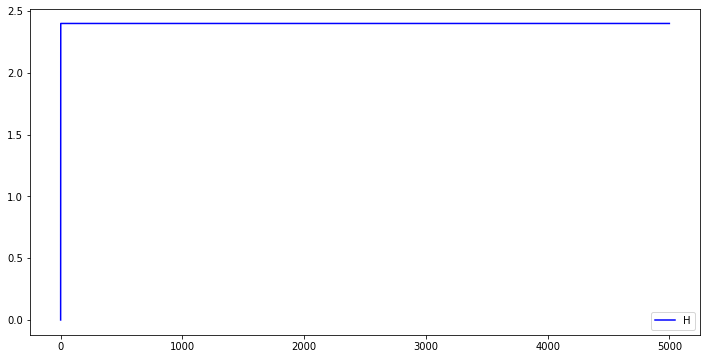

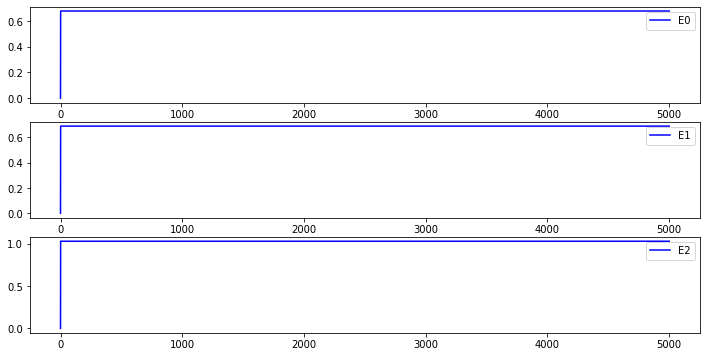

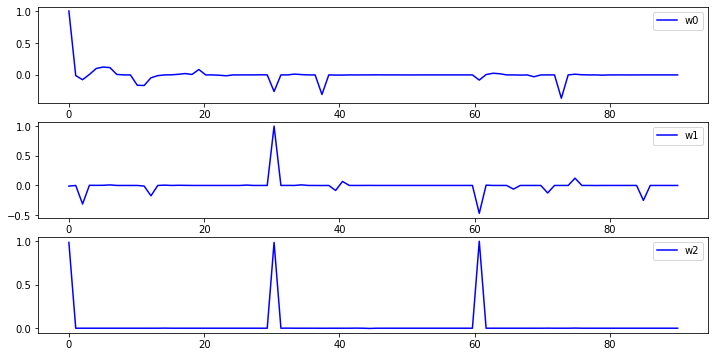

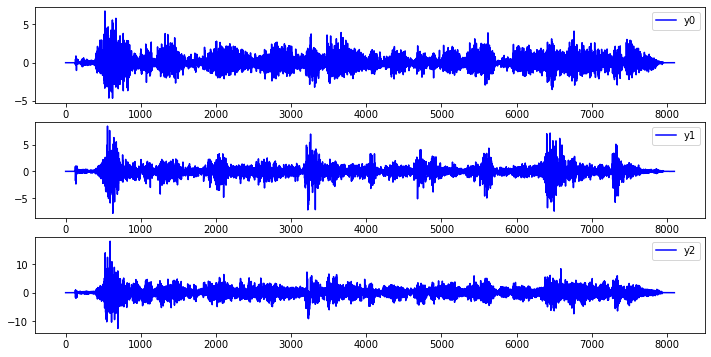

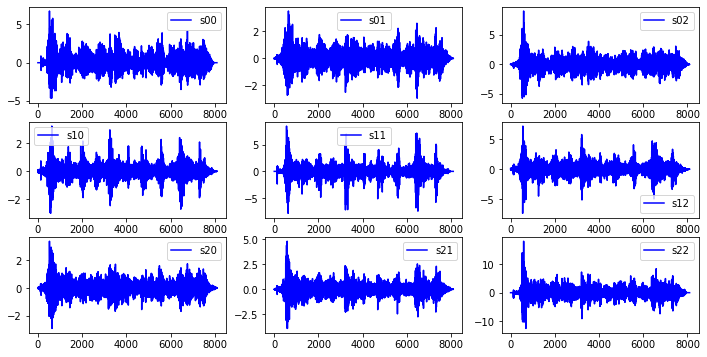

...

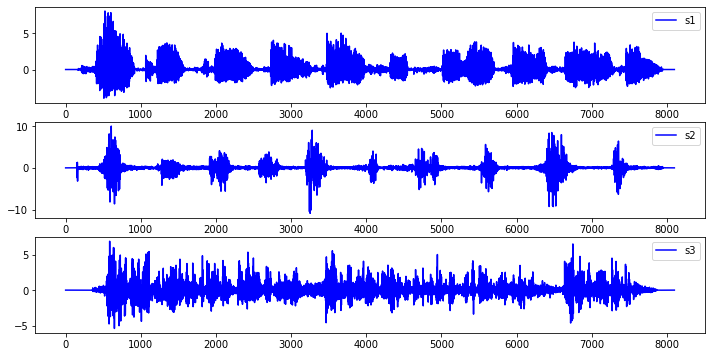

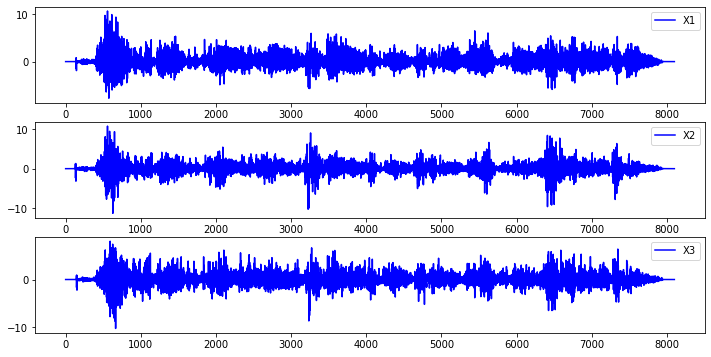

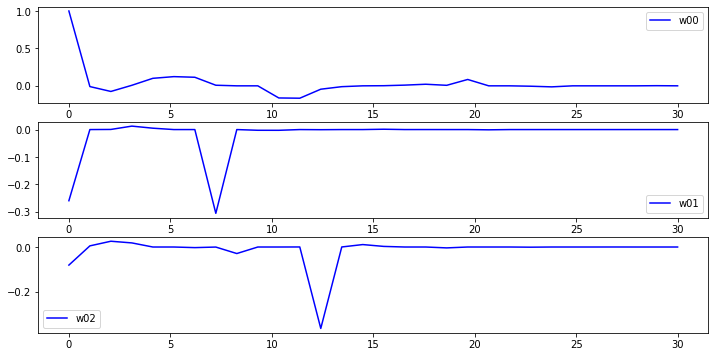

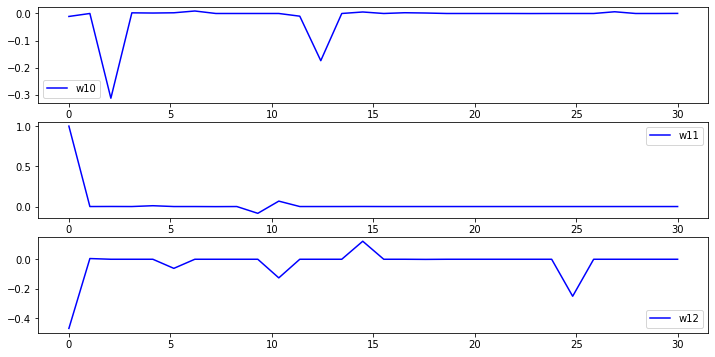

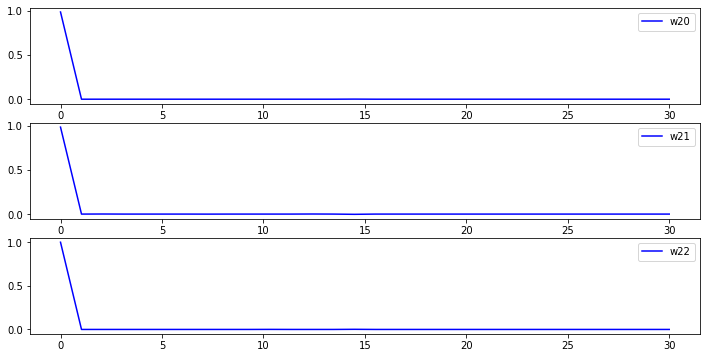

In [277]:
X =X_sim
R=100
M=30
lda1=0.00
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0
alpha=0.002

l1_norm =1.0
W=TimeDelayDecorrelation9(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K,alpha=alpha,l1_norm=l1_norm)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()

for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))

In [275]:
def TimeDelayDecorrelation10(X,M=25,R=25,lda1=0.0,lda2=0.0,lda3=0.0,lda4=0.0,K=1.0,alpha=1.0,l1_norm=l1_norm):
    [N,p]=X.shape
    X1=np.zeros((N+M,p),dtype=float)
    X1[M:N+M,:]=X.copy()
    X1 =(X1-np.mean(X1,axis=0))/np.std(X1,axis=0)
    XX =np.zeros((N+2*R,p*M),dtype=float)
    W =np.zeros((p*M,p),dtype=float)
    for i in range(N):
        for j in range(p):
            XX[R+i,j*M:(j+1)*M]=np.flip(X1[i+1:i+1+M,j],axis=0)
    print('before rank(XX) ',np.linalg.matrix_rank(XX))   #计算出来白化前后矩阵是满列秩的，这和我之前想的不一样啊
    #XX[R:R+N,:]=whiten(XX[R:R+N,:])    #需要白化。
    print('after  rank(XX) ',np.linalg.matrix_rank(XX))
    for i in range(p):
        for j in range(p):
            W[j*M,i]=1.0
        
    W_last =np.zeros((p*M,p),dtype=float)
    
    Rs =np.zeros((2*R+1,p*M,p*M),dtype=float)
    for i in range(N):
        for l in range(2*R+1):
            Rs[l,:,:] =Rs[l,:,:] +XX[R+i,:][:,np.newaxis]@XX[R+i+l-R,:][np.newaxis,:]
    Rs =Rs/N
    
    maxiters =5000
    k =-1
    tol=1e-14
    eta =0.01
    alpha=0.05
    t0 =maxiters/20
    H =np.zeros((maxiters,),dtype=float)
    E =np.zeros((maxiters,p),dtype=float)
    B=np.zeros((p*M,p*M),dtype=float)
    G=np.zeros((2*R+1,p*M,p*M),dtype=float)
    mask =np.zeros((p,),dtype=bool)
    order =np.arange(p)
    Ws =np.zeros((maxiters,p*M,p),dtype=float)
    
    


    while(np.linalg.norm(W-W_last)>tol):
        if(k==(maxiters-1)):
            break
        else:
            k =k +1
        print('k ',k,' ',np.linalg.norm(W-W_last))

        W_last =W.copy()

        for i in range(p):

            Q =np.zeros((p*M,p*M),dtype=float)
            for j in range(p):
                if(j!=i):
                    Q =Q +W[:,j][:,np.newaxis]@W[:,j][np.newaxis,:]
            
            
            for l in range(2*R+1):
                G[l,:,:] =Rs[l,:,:]@Q@Rs[2*R-l,:,:]
            
            
           
            
            ww =np.zeros((p*M,1),dtype=float)
            ww[0,0]=1.0
            
            Gn =np.zeros((2*R+1,p*M,p*M),dtype=float)
            index12=0
            index21=0
            index22=0
            
            for m in range(p):
                for n in range(p):
                    if(m==i and n==i):
                        Gn[:,0:M,0:M] =G[:,m*M:(m+1)*M,n*M:(n+1)*M]
                        ww[0:M,0] =W[m*M:(m+1)*M,i].copy()
                    elif(m==i and n!=i):
                        c =index12%(p-1)
                        Gn[:,0:M,(c+1)*M:(c+2)*M]=G[:,m*M:(m+1)*M,n*M:(n+1)*M]
                        ww[(c+1)*M:(c+2)*M,0] =W[n*M:(n+1)*M,i].copy()
                        index12 =index12+1
                    elif(m!=i and n==i):
                        r =index21%(p-1)
                        Gn[:,(r+1)*M:(r+2)*M,0:M]=G[:,m*M:(m+1)*M,n*M:(n+1)*M]
                        index21 =index21+1
                    else:
                        r =index22//(p-1)
                        c =index22%(p-1)
                        Gn[:,(r+1)*M:(r+2)*M,(c+1)*M:(c+2)*M]=G[:,m*M:(m+1)*M,n*M:(n+1)*M]
                        index22 =index22+1
            
            G11=Gn[:,0,0]
            G12=Gn[:,0,1:p*M]
            G21=Gn[:,1:p*M,0]
            G22=Gn[:,1:p*M,1:p*M]
            
            
            """
            ww_last =np.random.normal(loc=0,scale=1.0,size=(p*M,1))
            ww_last[0,0]=1.0
            tol =1e-5
            eps =1e-16
            eta =0.0005  #学习率设置问题，太大太小，影响收敛
            b=0
            b0 =40
            mu =0.5*np.eye(p*M-1)
            while(np.linalg.norm(ww-ww_last)>tol):
                b =b +1
                print('norm(w-w_last) ',np.linalg.norm(ww-ww_last))
                ww_last[1:p*M,0]=ww[1:p*M,0].copy()
                dww =2*G21+(2*G22@(ww_last[1:p*M]))[:,0]+2*alpha*(np.linalg.norm(ww_last[1:p*M,0],ord=1)-1.0)*\
                (ww_last[1:p*M,0]/(eps+abs(ww_last[1:p*M,0])))
                ww[1:p*M,0] =ww_last[1:p*M,0]-eta*(1.0/(1+b/b0))*dww
                dww
            print('ww ',ww)
            """
            
            b_max =100
            b0 =0
            tol2 =1e-15
            eps =1e-16
            f =np.zeros((2*R+1,1),dtype=float)
            J =np.zeros((2*R+1,p*M-1),dtype=float)
            f_new =np.zeros((2*R+1,1),dtype=float)
            J_new =np.zeros((2*R+1,p*M-1),dtype=float)
            ep =np.random.normal(loc=0,scale=1.0,size=(2*R+1,1))
            g  =np.random.normal(loc=0,scale=1.0,size=(p*M-1,1))
            dir_xk =np.random.normal(loc=0,scale=1.0,size=(p*M-1,1))
            mu =2
            u=0
            tau =0.001
            xk =(ww[1:p*M]).copy()
            I =np.eye(p*M-1)
            
            for l in range(2*R+1):
                f[l,0]=((G11[l]+2*xk.T@G21[l][:,np.newaxis])+xk.T@G22[l]@xk)[0][0]
                J[l,:] =(2*G21[l][:,np.newaxis]+(G22[l]+G22[l].T)@xk)[:,0]
            
            #f[2*R+1,0] =alpha*(np.square(np.linalg.norm(xk[:,0],ord=1))-(l1_norm))
            #J[2*R+1,:] =2*alpha*(np.linalg.norm(xk[:,0],ord=1))*(xk[:,0]/(eps+np.abs(xk[:,0])))
            #print('f shape ',f.shape)
            #print(2*R+1+p)
            #f[2*R+1+p,0]=beta*(xk.T@U@xk)[0][0]
            #J[2*R+1+p,:]=beta*((U+U.T)@xk)[:,0]
            ep =-1.0*f
            g =J.T@ep
            A =J.T@J
            u =tau*np.max(np.diag(A))
            print('u ',u)
            
            while(b0<b_max):
                if(np.max(np.abs(g))<tol2 or np.max(np.abs(dir_xk))<tol2):
                    break
                if(np.max(np.abs(g))<tol2 or np.sum(np.square(ep))<tol2):
                    break
                b0 =b0+1
                while(1):
                    print('rank ',np.linalg.matrix_rank(A+u*I))
                    dir_xk =np.linalg.pinv(A+u*I)@g
                    if(np.max(np.abs(dir_xk))<tol2):
                        break
                    else:
                        xk_new =xk+dir_xk
                        for l in range(2*R+1):
                            f_new[l,0]=((G11[l]+2*xk_new.T@G21[l][:,np.newaxis])+xk_new.T@G22[l]@xk_new)[0][0]
                            J_new[l,:] =(2*G21[l][:,np.newaxis]+(G22[l]+G22[l].T)@xk_new)[:,0]
                        
                        #f_new[2*R+1,0] =alpha*(np.square(np.linalg.norm(xk_new[:,0],ord=1))-(l1_norm))
                        #J_new[2*R+1,:] =2*alpha*(np.linalg.norm(xk_new[:,0],ord=1))*(xk_new[:,0]/(eps+np.abs(xk_new[:,0])))
                        
                        #f_new[2*R+1+p,0]=beta*(xk_new.T@U@xk_new)[0][0]
                        #J_new[2*R+1+p,:]=beta*((U+U.T)@xk_new)[:,0]
                        ep_new =-1.0*f_new
                        rou =(np.sum(np.square(ep))-np.sum(np.square(ep_new)))/((dir_xk.T@(u*dir_xk+g))[0][0])
                        if(rou>0):
                            xk =xk_new
                            A =J_new.T@J_new
                            ep =ep_new
                            g =J_new.T@ep

                            u =u*max(1.0/3,1-np.power((2*rou-1),3))
                            mu =2
                            if(np.max(np.abs(g))<tol2 or np.sum(np.square(ep))<tol2):
                                break
                        else:
                            u =mu*u
                            mu =2*mu
                    
                    if(rou>0):
                        break
            ww[1:p*M,0]=xk[:,0].copy()
            
            
            
            
            
                
                
            
            
            
            
            index0 =0
            for j in range(p):
                if(j==i):
                    W[j*M:(j+1)*M,i]=ww[0:M,0]*1.0
                else:
                    W[j*M:(j+1)*M,i]=ww[(index0+1)*M:(index0+2)*M,0]*1.0
                    index0 =index0+1
            print('w',i,' l1: ',np.linalg.norm(W[:,i],ord=1))
                
                    
                        
            
            
          
            
        
            E[k,i] =(W[:,i][np.newaxis,:]@np.sum(G,axis=0)@W[:,i][:,np.newaxis])[0][0]
            

            
        H[k] =np.sum(E[k,:])
        
       
        Ws[k,:,:]=W.copy()
        print('H ',H[k])
        print('E ',E[k,:])
        
    E[0,:]=0
    H[0]=0
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),H,'-b',label='H')
    plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,maxiters,maxiters),E[:,i],'-b',label=('E'+str(i)))
        plt.legend()
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,W.shape[0],W.shape[0]),W[:,i],'-b',label=('w'+str(i)))
        plt.legend()
    
    y =XX[R:N+R]@W
    
    plt.subplots(figsize=(12,6))
    for i in range(p):
        plt.subplot(p,1,i+1)
        plt.plot(np.linspace(0,y.shape[0],y.shape[0]),y[:,i],'-b',label=('y'+str(i)))
        plt.legend()
        
    Xy =np.zeros((N+4*R,4*R+1),dtype=float)
    yy =np.zeros((N,p*p),dtype=float)
    for i in range(p):
        Xy =0*Xy
        for j in range(4*R+1):
            Xy[j:N+j,j]=y[:,i]
        beta =np.linalg.pinv(Xy[2*R:N+2*R,:])@y
        yy[:,i*p:(i+1)*p] =Xy[2*R:N+2*R,:]@beta
    
    plt.subplots(figsize=(12,6))
    for i in range(p*p):
        plt.subplot(p,p,i+1)
        plt.plot(np.linspace(0,N,N),yy[:,i],'-b',label=('s'+str(int(i/3))+str(int(i%3))))
        plt.legend()
    
    dist =np.zeros((maxiters,),dtype=float)
    for i in range(maxiters):
        dist[i]=np.linalg.norm(Ws[i]-W)
    
    plt.subplots(figsize=(12,6))
    plt.plot(np.linspace(0,maxiters,maxiters),dist,'-b',label='dist')
    plt.legend()
    
    
    
        
    
    return W

In [276]:
X =X_sim
R=60
M=30
lda1=0.00
lda2=0.0
lda3=0.0
lda4=0.000
K=1.0
alpha=0.000

l1_norm =1.0
W=TimeDelayDecorrelation10(X=X,R=R,M=M,lda1=lda1,lda2=lda2,lda3=lda3,lda4=lda4,K=K,alpha=alpha,l1_norm=l1_norm)
print('W ',W)
print('shape(X) ',X.shape)
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,x11.shape[0],x11.shape[0]),x11,'-b',label='s1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,x22.shape[0],x22.shape[0]),x22,'-b',label='s2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,x33.shape[0],x33.shape[0]),x33,'-b',label='s3')
plt.legend()
plt.subplots(figsize=(12,6))
plt.subplot(3,1,1)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,0],'-b',label='X1')
plt.legend()
plt.subplot(3,1,2)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,1],'-b',label='X2')
plt.legend()
plt.subplot(3,1,3)
plt.plot(np.linspace(0,X.shape[0],X.shape[0]),X[:,2],'-b',label='X3')
plt.legend()
for i in range(X.shape[1]):
    plt.subplots(figsize=(12,6))
    for j in range(X.shape[1]):
        plt.subplot(X.shape[1],1,j+1)
        plt.plot(np.linspace(0,M,M),W[j*M:(j+1)*M,i],'-b',label='w'+str(i)+str(j))
        plt.legend()

for i in range(X.shape[1]):
    for j in range(X.shape[1]):
        print('w',i,j,' max index : ',np.argmax(abs(W[j*M:(j+1)*M,i])))

before rank(XX)  90
after  rank(XX)  90
k  0   3.0
u  0.13279565089154885
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.35244280560087
u  0.025370025731521178
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  10.422845032079906
u  6.292625374764871e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  12.97616055175887
H  0.061962623118294244
E  [0.02130683 0.02153871 0.01911708]
k  5   0.24126759197884085
u  1.1251453879780158e-06
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
w 0  l1:  12.729786124753346
u  5.583703446493105e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
w 1  l1:  9.561713486374764
u  1.2901106309569819e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  12.2489955795859
u  3.55490400515616e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  10.3629866334162
u  1.0543419012686054e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  14.80558324164734
H  0.02332955777066486
E  [0.00863741 0.00750385 0.00718829]
k  17   0.09140174613411209
u  4.2423181676787815e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  12.317630544775684
u  3.89726365690198e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  11.162663863691057
u  9.890879611317357e-08
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  11.483125192075121
u  8.984470977032175e-08
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  16.880162306715466
H  0.02032330362657791
E  [0.00764768 0.00666615 0.00600947]
k  29   0.05608964931509018
u  4.54956564089982e-07
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  12.859216257344315
u  3.809378388061708e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  11.743823383489538
u  9.292112702404548e-08
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  18.1687188918202
H  0.01927698086535965
E  [0.00718687 0.00633295 0.00575716]
k  36   0.060093385793874396
u  4.5262572151673736e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  13.627809720545681
u  3.717972425591844e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
w 1  l1:  11.897715669288646
u  1.0297878871855272e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  11.964447440353366
u  1.0448020034992361e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  19.637023167547284
H  0.017749396881279314
E  [0.006629  0.0054979 0.0056225]
k  48   0.05310057550411172
u  4.9063297645327e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  15.662757955983768
u  3.292514676276555e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  12.23716687290693
u  1.0431190447479747e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  12.465230937812406
u  1.0379928263157322e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  20.285583255084212
H  0.017187494225676562
E  [0.00631804 0.00537273 0.00549673]
k  60   0.044752551004206116
u  4.770965001633055e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  17.475836122902663
u  3.3545582468080507e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  20.243422784518515
H  0.016879523021

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  17.757253163752807
u  3.4698968471125804e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  13.26905233107054
u  9.132258083105796e-08
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  13.728805316786525
u  8.600192043290957e-08
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  20.218656732777156
H  0.015594133406731176
E  [0.00549402 0.00524824 0.00485187]
k  77   0.05030706049201505
u  3.738562123874355e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.060126759866996
u  2.841980536510907e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  14.457995560281011
u  9.129504558659213e-08
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  20.32843001455899
H  0.015025575522997353
E  [0.00526127 0.00516482 0.00459948]
k  84   0.051841123444410345
u  3.5279861870337785e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.343515689219153
u  2.7547230305709495e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  15.106513810141243
u  9.022937662456118e-08
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  20.476756083547023
H  0.014722200549410657
E  [0.00512293 0.00513423 0.00446504]
k  91   0.03261651826116241
u  3.480370561710606e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.686086288491257
u  2.6356502541184397e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  15.48046717843437
u  9.659726712748382e-08
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  20.78833119254112
H  0.01450400988073998
E  [0.00509046 0.00507488 0.00433867]
k  98   0.028128233713185853
u  3.465849448423728e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.90952381062743
u  2.592535023814505e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  15.753526086939466
u  9.87872920483844e-08
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.993778464306814
u  2.645543153640352e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  15.933954321822412
u  1.012401857210044e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  21.36267214738031
H  0.014199032109032873
E  [0.00502108 0.00497509 0.00420287]
k  110   0.022931465879570127
u  3.38577703665518e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  21.566176117530347
H  0.014141324989102848
E  [0.00499752 0.00494255 0.00420126]
k  115   0.01887713879866535
u  3.33

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  19.097589742607564
u  2.799929268522962e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  16.271772315267018
u  1.0701445477806758e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  21.746762315777893
H  0.01412630106476355
E  [0.00496918 0.00492745 0.00422968]
k  122   0.016139497956890406
u  3.273381059788105e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  19.04958584700385
u  2.831994368663896e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  16.37158264542053
u  1.1028111880909786e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  21.850101315551306
H  0.014168916078893274
E  [0.00495926 0.00493554 0.00427411]
k  129   0.013991380515555102
u  3.2916617487631527e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.964766459908123
u  2.8137933104399733e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  16.423123839852973
u  1.145452204621479e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  21.89669545406535
H  0.014240926390566098
E  [0.00495733 0.004959   0.0043246 ]
k  136   0.012816628945958955
u  3.3788142469132143e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.906893860179913
u  2.7958176385845747e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  16.478949973807733
u  1.1934298085571347e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  21.914520777406402
H  0.0142960111658737
E  [0.00494922 0.00498226 0.00436453]
k  143   0.013301705413361023
u  3.481662308396097e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.861222997579517
u  2.7565011635254465e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  16.54233651915332
u  1.2414580105547433e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  3.550794241304413e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  16.60158951933471


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  21.926500609089533
H  0.014370871633450556
E  [0.00494257 0.0050101  0.0044182 ]
k  155   0.013325785139677996
u  3.5739212789787937e-0

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  16.720640256203616
u  1.3189572793366506e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  21.955775593642556
H  0.014454337408327177
E  [0.00495897 0.00503471 0.00446067]
k  162   0.01506575305616613
u  3.624315903896932e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.80078718631181
u  2.744044379121821e-07
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  16.894364895378533
u  1.3856449952086981e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  22.067544385666476
H  0.01457753779278868
E  [0.00498962 0.00507305 0.00451486]
k  169   0.014604517352862134
u  3.6984309427362884e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.816432054728388
u  2.806526385164332e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  17.12464903953023
u  1.452439383712239e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  22.29044154003761
H  0.014749071846046083
E  [0.0050362  0.0051327  0.00458018]
k  176   0.014713244638588191
u  3.7999548201876907e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.843419279409705
u  2.891311918393398e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  17.37290867938543
u  1.5060000053106931e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.858113074129356
u  2.953896584703189e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  17.580649724186074
u  1.5382051907370035e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  22.798564093753694
H  0.015105624392964933
E  [0.00514585 0.00527286 0.00468692]
k  188   0.014653236483974348
u  3.9616726223084676e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  8

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.89510650318094
u  3.0263701805534857e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  17.838397395173175
u  1.573209911749393e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  18.951689335453057
u  3.0790899050689427e-07
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  18.02522006816356
u  1.5970630843143419e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  23.40361761454254
H  0.015506416501964375
E  [0.00530393 0.00543133 0.00477116]
k  200   0.018003222725393255
u  4.2290716221604687e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  18.199901468489024
u  1.619121860823416e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  23.673071885527612
H  0.01565974547155468
E  [0.00539047 0.00549035 0.00477892]
k  205   0.02074317017048341
u  4.384140007927319e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  19.213159921371386
u  3.1528617937618186e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  1.6403522586249211e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  19.354163810528103
u  3.143210272791732e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  18.746839263268384
u  1.6398878844943573e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  24.32714545280494
H  0.016019784598568555
E  [0.0056601  0.00556162 0.00479806]
k  217   0.023384273815179605
u  4.6865566343273416e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  19.56770636184382
u  3.1248759751526886e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  19.06778816508674
u  1.634879954843556e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

w 2  l1:  24.692978099392384
H  0.01622131039666979
E  [0.00580509 0.00557352 0.00484271]
k  224   0.02691061024517091
u  5.044920791203348e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  19.82463226896375
u  3.114167767927747e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  19.38974159478215
u  1.6275092364831114e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  25.031483775903816
H  0.016398488429337804
E  [0.00592837 0.00558686 0.00488326]
k  231   0.03394459510414028
u  5.28261345163318e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  20.062907270618325
u  3.128772164957259e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  19.69151712273005
u  1.6070937946945402e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  25.328078632443578
H  0.016583752770418046
E  [0.00603724 0.0056177  0.00492882]
k  238   0.028706645187613487
u  5.47906686168084e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  20.349830093670196
u  3.201119101698022e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  19.969184910212903
u  1.5898164629944603e-07
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  5.626641053282788e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  20.645114383905714
u  3.3171582563158673e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  20.377098461637875
u  1.6340831242736724e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  25.94526691314569
H  0.016897450278752883
E  [0.00617741 0.00572361 0.00499643]
k  254   0.01757197772949447
u  5.719775796606599e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  20.86547876934043
u  3.455567680303189e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  20.571535823736916
u  1.6925565201872647e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.148485445597238
H  0.01691728423316099
E  [0.00614534 0.0057711  0.00500084]
k  261   0.015035331203145102
u  5.733526062200655e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  21.104936262684475
u  3.6350041851371916e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  20.8004162580656
u  1.770038519030805e-07
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.296805102615593
H  0.016871983518009465
E  [0.00607653 0.00580267 0.00499279]
k  268   0.01911184085017396
u  5.74223988761

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  21.081155687538615
u  1.8231058370570417e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.388879462400023
H  0.016664679273964284
E  [0.00595318 0.00579077 0.00492073]
k  277   0.014947177856720924
u  5.650684024500808e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  21.727941619425028
u  3.995227084190839e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  21.23989591253021
u  1.8189521420606944e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.409477824092107
H  0.016412473405614407
E  [0.00584699 0.00574193 0.00482355]
k  284   0.013752553261306297
u  5.519108971826028e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  22.008412893162657
u  4.0382180500361525e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  21.401721763277045
u  1.7865982774751054e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.426436307267174
H  0.016095197123930437
E  [0.00573

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  22.419654734331754
u  4.0470136590588225e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  21.699708378736467
u  1.7258045557555765e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.457473361197682
H  0.01568044618031994
E  [0.00560778 0.00552951 0.00454316]
k  300   0.016240605196581784
u  5.179205415023935e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  22.691656810939914
u  4.0005556808402034e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  22.054630448676818
u  1.6611828014027995e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.48666360156787
H  0.015274995712943043
E  [0.00549301 0.00539826 0.00438373]
k  309   0.014804162805241114
u  5.030867362154328e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  23.010101526280124
u  3.939946890360408e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  22.41540069621263
u  1.6131435591721405e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.530564807030064
H  0.014889315003351052
E  [0.00537695 0.00526207 0.00425029]
k  318   0.018626755888317807
u  4.936500010495418e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  23.29623344792919
u  3.877388381080873e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  22.895282307142967
u  1.5671968085502464e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.6624628703145
H  0.014596799756988594
E  [0.00527357 0.00515676 0.00416647]
k  327   0.013827919865207237
u  4.96539930773121e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  23.510606523391207
u  3.8845981120147915e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  23.408413438113502
u  1.5315066992433763e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.75651436809356
H  0.01440331134491301
E  [0.00519949 0.00509045 0.00411337]
k  334   0.01499962229505122
u  4.985658735010353e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  23.644977860723735
u  3.887604541068284e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  23.87156804242383
u  1.5638534954914822e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.85793598575615
H  0.014235018920743792
E  [0.005128

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  23.83360772584509
u  3.9204857908819503e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  24.499767510670964
u  1.5920452669823533e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.00284901397645
H  0.01407967193428119
E  [0.00505831 0.00500333 0.00401803]
k  350   0.015962807857320627
u  4.983566639663117e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  23.980848016436955
u  3.9630416006152135e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.12074481140928
H  0.013973701176713657
E  [0.00500005 0.0049943  0.00397935]
k  359   0.016829968863590082
u  5.133935386886117e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  24.206286303109835
u  4.114150750508906e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  25.64746447089435
u  1.5810136892623217e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.259467830827763
H  0.013854086853421696
E  [0.00494157 0.00495856 0.00395395]
k  366   0.023182048403816415
u  5.3100273486

u  5.344023951159893e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  24.475313795614827
u  4.267534110822339e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  26.42182625177732
u  1.5028381311547683e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.364513806977815
H  0.013408316596019288
E  [0.00478836 0.00474063 0.00387932]
k  375   0.02477230550899471
u  5.269198084220115e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  24.714181299494864
u  4.208052259709889e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  27.00145229746842
u  1.4698907181380312e-07
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.51804595640499
H  0.012532701609327304
E  [0.00455751 0.00434231 0.00363288]
k  391   0.019345441642138427
u  5.215230162180789e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.10234054456098
u  4.0501311046627624e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  28.053357517405974
u  1.8175248030691685e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.50729236409122
H  0.01233411263558323
E  [0.00450511 0.00428494 0.00354406]
k  398   0.019590961350689697
u  5.211515135696435e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.255053520871236
u  4.0204640432426995e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  28.56875553440886
u  1.870607082370154e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.51373796382002
H  0.012053406137337337
E  [0.00440663 0.00419812 0.00344865]
k  407   0.01887972979877012
u  5.157783684808663e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.416075386566337
u  3.9085919433269907e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  28.928035203879038
u  1.8465923130742992e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.53279890988815
H  0.011834316323934767
E  [0.00431748 0.00412261 0.00339423]
k  414   0.016272252239693363
u  5.210056466765421e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.507016445869766
u  3.7974384255588655e-07


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.528339189717165
u  3.7599304375814557e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  29.36808260968801
u  1.8113527611668356e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.529087953770023
H  0.011608909902584829
E  [0.00421903 0.00403565 0.00335423]
k  423   0.014822879964130422
u  5.373987281452278e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.597557137600894
u  3.6723485484683375e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  29.697461336119897
u  1.789333209584021e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.489880282950853
H  0.011484322163365892
E  [0.00416955 0.00397715 0.00333762]
k  430   0.01596490624214154
u  5.488835251846138e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.649760359455847
u  3.6318061243060704e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  29.98237660396464
u  1.7820

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.405255872974735
H  0.01141015539029508
E  [0.00414193 0.00393004 0.00

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

u  1.8182993893344182e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

w 2  l1:  27.2624723183716
H  0.01138017263139303
E  [0.00413079 0.00388998 0.0033594 ]
k  446   0.010393735388463783
u  5.740801026586928e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.70785325403897
u  3.549025520012839e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  30.594358027376597
u  1.8590704860700235e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.143636045565263
H  0.011402756611906933
E  [0.00413384 0.00387146 0.00339746]
k  453   0.015158920598071649
u  5.815586791320271e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.72145020759057
u  3.6615098477824747e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  30.851014743489735
u  1.8921629884717997e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.04987152725651
H  0.011452257781501989
E  [0.00413953 0.00385964 0.00345309]
k  460   0.01210602225997569
u  5.90686115879114e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.727715132104922
u  3.7687729167108916e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  31.104286271731233
u  1.941350408272448e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.979208124402653
H  0.011518485398336244
E  [0.00415006 0.00385167 0.00351676]
k  467   0.01428974602063129
u  5.998066347639744e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.721362334687242
u  3.871665982207068e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  31.38923377010784
u  1.9820103688187653e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.949353831649688
H  0.0115868025669257
E  [0.00416261 0.00384432 0.00357987]
k  474   0.011062796019677579
u  6.248982686722561e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.70108031054832
u  3.9516812686086133e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  31.678036214553792
u  2.025138958284477e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  26.969400061370198
H  0.01165956293135168
E  [0.00418336 0.00383742 0.00363878]
k  481   0.008837278018944482
u  6.491649737367958e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.661457117253786
u  4.001766681732792e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  31.951924544563205
u  2.0588406468157947e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


u  6.711877848100731e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.045562808686697
H  0.011788119027448871
E  [0.00423452 0.00382421 0.00372939]
k  495   0.00951018026179914
u  6.921996026003186e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.53155184457473
u  4.0046346664941995e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  32.53929989425653
u  2.1325619556575176e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.090598599356927
H  0.011834555974189682
E  [0.00426361 0.00381256 0.00375838]
k  502   0.00873546467022837
u  7.117880484221205e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.49009423444511
u  3.95949582165556e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  32.819291877302504
u  2.1663503411633426e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.128895233294394
H  0.011865795227004717
E  [0.0042953  0.00379583 0.00377466]
k  509   0.007819574524576963
u  7.282161719458221e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.44054620957862
u  3.8780548055634304e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  33.020474058075685
u  2.2063556684630493e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.172300937906254
H  0.011891103788055852
E  [0.00432901 0.00377825 0.00378385]
k  516   0.008323839691248587
u  7.426278297537826e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.383401657487372
u  3.7686605520582905e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  33.20593658107559
u  2.22574176835537e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ran

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.21046679313651
H  0.011907873940085984
E  [0.00436094 0.00375783 0.00378911]
k  523   0.0073232362393760965
u  7.56631990858598e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.31492537623246
u  3.634732262921152e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  33.368041950461944
u  2.2420968865247927e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89


rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.24284422359504
H  0.01191699716386109
E  [0.0043903

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.246683715246807
H  0.011920142831069933
E  [0.00439714 0.00373223 0.00379077]
k  532   0.01028770036805616
u  7.74417349079646e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.227387501350332
u  3.447515636771794e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  33.58254733971039
u  2.294128180009897e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.26543795024998
H  0.0119244089752501
E  [0.00441598 0.00371952 0.00378891]
k  539   0.005930450653649125
u  7.8583018366017

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.2669931058182
H  0.011939174423470218
E  [0.0044325  0.00371836 0.00378831]
k  548   0.006643886517459581
u  7.939624535869679e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.122820219471986
u  3.172354635686027e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  33.87565209812075
u  2.4311637007273253e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.246615599765974
H  0.011962761593581128
E  [0.00444086 0.00372825 0.00379365]
k  555   0.005397540041457185
u  7.986396765917989e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.106175722650434
u  3.086367726250473e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 1  l1:  33.97730806654354
u  2.484957025610715e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
ra

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 2  l1:  27.226636937467585
H  0.011987126767697809
E  [0.00444691 0.00374297 0.00379725]
k  562   

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
w 0  l1:  25.08106884424803
u  3.1566266097278263e-07
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
rank  89
r

rank  89


KeyboardInterrupt: 

In [8]:
dataS.shape

(8000, 3)